In [1]:
# imports
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import re
import math
from operator import itemgetter
from astropy.modeling.models import BlackBody
import astropy.units as u
from dust_extinction.parameter_averages import F99
from extinction import ccm89, apply
from matplotlib.ticker import MaxNLocator

# general plot formatting
plt.rcParams.update({
    "lines.color": "black",
    "patch.edgecolor": "black",
    "text.color": "black",
    "axes.facecolor": "white",
    "axes.edgecolor": "black",
    "axes.labelcolor": "black",
    "xtick.color": "black",
    "ytick.color": "black",
    "grid.color": "white",
    "figure.facecolor": "white",
    "figure.edgecolor": "black",
    "savefig.facecolor": "white",
    "savefig.edgecolor": "black"})
font = 24
font1 = 24 # used to be 12
plt.rcParams["font.family"] = "serif"
#plt.rcParams["font.family"] = "arial"
#plt.rcParams.update({
#    "text.usetex": True,
#    "font.family": "serif",
#    "font.serif": ["Computer Modern Roman"]})
plt.rcParams.update({'font.size': font})

## <a id='0'>Jump to:</a> 
- [Importing Model Data](#1)
- [Importing Observational Data](#2)
- [Importing Photometric Data](#3)
- [Applying Spectrophotometry/ColorColor Functions](#20)
- [Applying Reddening](#4)
- [Plotting Model Time Series](#5)
    - [Figure 43a: Flux Comparisons (Dessart Model 05cs+06bp+12aw)](#5a)
- [Plotting Observed Time Series](#6)
    - [Figure 43b: Flux Comparisons (Observations of SN2013ej+SN2012aw+SN2021yja)](#6a)
- [Time Series](#16)
    - [Figure 44: Time Series Plot](#16a)
- [Figure 1: Contamination](#18)
- [Model vs. Observation](#7)
    - [Figure 42a: SN2005cs](#7a)
    - [SN2006bp](#7b)
    - [Figure 42b: SN2012aw](#7c)
- [Color-color diagrams based on UV Photometry](#8)
- [U-V Color-color diagrams based on spectra](#9)
    - [Figure 46a: Color Comparisons](#9a)
- [Photometry Check](#10)
- [Normalized Model Plots](#11)
- [Normalized Day _ plots for all IIPs](#12)
- [Epoch Plots](#13)
    - [Figure 45: Epoch Comparisons](#13a)
    - [Figure 46b: Color Matched Comparions](#13b)
- [All SNe plots](#14)
    - [IIbs](#14a) ( [SN2011dh](#14a1),[SN2013df](#14a2),[SN2016gkg](#14a3) )
    - [IIns](#14b) ( [SN2007pk](#14b1),[SN2010jl](#14b2),[SN2011ht](#14b3),[SN2013L](#14b4),[SN2015bf](#14b5),[SN2016cvk](#14b6) )
    - [IIP/Ls](#14c) ( [SN2005cs](#14c1),[SN2006bp](#14c2),[SN2007od](#14c3),[SN2008aw](#14c4),[SN2008M](#14c5),[SN2012aw](#14c6),[SN2013ab](#14c7),[SN2013ej](#14c8),[ASASSN-14ha](#14c9),[SN2017eaw](#14c10) )
    - [Misc CC SNe](#14d) ( [SN2006jc: Type Ibn](#14d1),[SN2017egm: Type SLSN-I](#14d2) )
- [TRUVOT Corrected Spectra](#15)
    - [Type IIPs](#15a)
    - [Type IIns](#15b)
    - [Type IIbs](#15c)
    - [Type II_s](#15d)
    - [Type IIs](#15f)
    - [Type Ibns](#15e)
- [Spectrophotometry](#19)
    - [IIbs](#19a) ( [SN2011dh](#19a1),[SN2013df](#19a2),[SN2016gkg](#19a3) )
    - [IIns](#19b) ( [SN2007pk](#19b1),[SN2010jl](#19b2),[SN2011ht](#19b3),[SN2013L](#19b4),[SN2015bf](#19b5),[SN2016cvk](#19b6) )
    - [IIP/Ls](#19c) ( [SN2005cs](#19c1),[SN2006bp](#19c2),[SN2007od](#19c3),[SN2008aw](#19c4),[SN2008M](#19c5),[SN2012aw](#19c6),[SN2013ab](#19c7),[SN2013ej](#19c8),[ASASSN-14ha](#19c9),[SN2017eaw](#19c10) )
    - [Misc CC SNe](#19d) ( [SN2006jc: Type Ibn](#19d1),[SN2017egm: Type SLSN-I](#19d2) )
- [Extra Code](#17)

# <a id='1'>Importing Model Data</a> 
[Table of Contents](#0)

In [3]:
# Importing SN2006bp Dessart model data
SN06bp_1half_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/sn06bp_spec/tst_n20_5_B.fl"
SN06bp_1half_wave_m, SN06bp_1half_flux_m = np.loadtxt(SN06bp_1half_m, unpack=True)
SN06bp_2half_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/sn06bp_spec/tst_n20_6_v1.fl"
SN06bp_2half_wave_m, SN06bp_2half_flux_m = np.loadtxt(SN06bp_2half_m, unpack=True)
SN06bp_7half_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/sn06bp_spec/n7_j20b_v4_s1_l3_v2.fl"
SN06bp_7half_wave_m, SN06bp_7half_flux_m = np.loadtxt(SN06bp_7half_m, unpack=True)
SN06bp_9half_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/sn06bp_spec/n7_j16b_v4_s1_l3_v1_B.fl"
SN06bp_9half_wave_m, SN06bp_9half_flux_m = np.loadtxt(SN06bp_9half_m, unpack=True)
SN06bp_11_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/sn06bp_spec/n7_j12b_v4_s1_l3_v1_B.fl"
SN06bp_11_wave_m, SN06bp_11_flux_m = np.loadtxt(SN06bp_11_m, unpack=True)
SN06bp_14half_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/sn06bp_spec/n16_n10_s0_v1_B_new2.fl"
SN06bp_14half_wave_m, SN06bp_14half_flux_m = np.loadtxt(SN06bp_14half_m, unpack=True)
SN06bp_15half_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/sn06bp_spec/n16_n10_s0_v1_B_new2_3.fl"
SN06bp_15half_wave_m, SN06bp_15half_flux_m = np.loadtxt(SN06bp_15half_m, unpack=True)
SN06bp_20half_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/sn06bp_spec/n16_n10_s0_v1_B_new6.fl"
SN06bp_20half_wave_m, SN06bp_20half_flux_m = np.loadtxt(SN06bp_20half_m, unpack=True)
SN06bp_22_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/sn06bp_spec/n16_n10_s0_v1_B_new5.fl"
SN06bp_22_wave_m, SN06bp_22_flux_m = np.loadtxt(SN06bp_22_m, unpack=True)
SN06bp_24_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/sn06bp_spec/n16_n10_s0_v1_B_new4.fl"
SN06bp_24_wave_m, SN06bp_24_flux_m = np.loadtxt(SN06bp_24_m, unpack=True)
SN06bp_30_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/sn06bp_spec/nj4_1v1_new3_abund.fl"
SN06bp_30_wave_m, SN06bp_30_flux_m = np.loadtxt(SN06bp_30_m, unpack=True)
SN06bp_41half_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/sn06bp_spec/nj4_1v1_new2_abund.fl"
SN06bp_41half_wave_m, SN06bp_41half_flux_m = np.loadtxt(SN06bp_41half_m, unpack=True)
SN06bp_56half_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/sn06bp_spec/nj4_1v1_new1_abund.fl"
SN06bp_56half_wave_m, SN06bp_56half_flux_m = np.loadtxt(SN06bp_56half_m, unpack=True)
SN06bp_72half_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/sn06bp_spec/nj4_1v1_new_abund.fl"
SN06bp_72half_wave_m, SN06bp_72half_flux_m = np.loadtxt(SN06bp_72half_m, unpack=True)

# Importing SN2005cs Dessart model data
SN05cs_3_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/sn05cs/cs0_1_l1b1_rho_v1_B.fl"
SN05cs_3_wave_m, SN05cs_3_flux_m = np.loadtxt(SN05cs_3_m, unpack=True)
SN05cs_4_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/sn05cs/cs0_1_l1b1_rho3_B_v1.fl"
SN05cs_4_wave_m, SN05cs_4_flux_m = np.loadtxt(SN05cs_4_m, unpack=True)
SN05cs_5_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/sn05cs/cs0_1_l1b1_rho3_B.fl"
SN05cs_5_wave_m, SN05cs_5_flux_m = np.loadtxt(SN05cs_5_m, unpack=True)
SN05cs_6_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/sn05cs/cs0_1_l1b_B1_v1.fl"
SN05cs_6_wave_m, SN05cs_6_flux_m = np.loadtxt(SN05cs_6_m, unpack=True)
SN05cs_7_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/sn05cs/cs0_1_l1b_B1_v1_2.fl"
SN05cs_7_wave_m, SN05cs_7_flux_m = np.loadtxt(SN05cs_7_m, unpack=True)
SN05cs_8_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/sn05cs/cs0_1_l1b_B1_v1_5.fl"
SN05cs_8_wave_m, SN05cs_8_flux_m = np.loadtxt(SN05cs_8_m, unpack=True)
SN05cs_9_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/sn05cs/cs1_7_abund.fl"
SN05cs_9_wave_m, SN05cs_9_flux_m = np.loadtxt(SN05cs_9_m, unpack=True)
SN05cs_12_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/sn05cs/r3_ba.fl"
SN05cs_12_wave_m, SN05cs_12_flux_m = np.loadtxt(SN05cs_12_m, unpack=True)
SN05cs_13_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/sn05cs/cs3_5.fl"
SN05cs_13_wave_m, SN05cs_13_flux_m = np.loadtxt(SN05cs_13_m, unpack=True)
SN05cs_14_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/sn05cs/r3_e_abund.fl"
SN05cs_14_wave_m, SN05cs_14_flux_m = np.loadtxt(SN05cs_14_m, unpack=True)
SN05cs_15_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/sn05cs/r3_abund.fl"
SN05cs_15_wave_m, SN05cs_15_flux_m = np.loadtxt(SN05cs_15_m, unpack=True)
SN05cs_17_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/sn05cs/r3_g_abund.fl"
SN05cs_17_wave_m, SN05cs_17_flux_m = np.loadtxt(SN05cs_17_m, unpack=True)

# Importing SN2012aw Dessart model data
SN12aw_10_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_1.fl"
SN12aw_10_wave_m, SN12aw_10_flux_m = np.loadtxt(SN12aw_10_m, unpack=True)
SN12aw_11_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_2.fl"
SN12aw_11_wave_m, SN12aw_11_flux_m = np.loadtxt(SN12aw_11_m, unpack=True)
SN12aw_12_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_3.fl"
SN12aw_12_wave_m, SN12aw_12_flux_m = np.loadtxt(SN12aw_12_m, unpack=True)
SN12aw_13_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_4.fl"
SN12aw_13_wave_m, SN12aw_13_flux_m = np.loadtxt(SN12aw_13_m, unpack=True)
SN12aw_14_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_5.fl"
SN12aw_14_wave_m, SN12aw_14_flux_m = np.loadtxt(SN12aw_14_m, unpack=True)
SN12aw_16_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_6.fl"
SN12aw_16_wave_m, SN12aw_16_flux_m = np.loadtxt(SN12aw_16_m, unpack=True)
SN12aw_17_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_7.fl"
SN12aw_17_wave_m, SN12aw_17_flux_m = np.loadtxt(SN12aw_17_m, unpack=True)
SN12aw_19_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_8.fl"
SN12aw_19_wave_m, SN12aw_19_flux_m = np.loadtxt(SN12aw_19_m, unpack=True)
SN12aw_21_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_9.fl"
SN12aw_21_wave_m, SN12aw_21_flux_m = np.loadtxt(SN12aw_21_m, unpack=True)
SN12aw_23_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_10.fl"
SN12aw_23_wave_m, SN12aw_23_flux_m = np.loadtxt(SN12aw_23_m, unpack=True)
SN12aw_26_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_11.fl"
SN12aw_26_wave_m, SN12aw_26_flux_m = np.loadtxt(SN12aw_26_m, unpack=True)
SN12aw_28_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_12.fl"
SN12aw_28_wave_m, SN12aw_28_flux_m = np.loadtxt(SN12aw_28_m, unpack=True)
SN12aw_31_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_13.fl"
SN12aw_31_wave_m, SN12aw_31_flux_m = np.loadtxt(SN12aw_31_m, unpack=True)
SN12aw_34_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_14.fl"
SN12aw_34_wave_m, SN12aw_34_flux_m = np.loadtxt(SN12aw_34_m, unpack=True)
SN12aw_38_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_15.fl"
SN12aw_38_wave_m, SN12aw_38_flux_m = np.loadtxt(SN12aw_38_m, unpack=True)
SN12aw_42_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_16.fl"
SN12aw_42_wave_m, SN12aw_42_flux_m = np.loadtxt(SN12aw_42_m, unpack=True)
SN12aw_46_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_17.fl"
SN12aw_46_wave_m, SN12aw_46_flux_m = np.loadtxt(SN12aw_46_m, unpack=True)
SN12aw_50_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_18.fl"
SN12aw_50_wave_m, SN12aw_50_flux_m = np.loadtxt(SN12aw_50_m, unpack=True)
SN12aw_55_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_19.fl"
SN12aw_55_wave_m, SN12aw_55_flux_m = np.loadtxt(SN12aw_55_m, unpack=True)
SN12aw_61_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_20.fl"
SN12aw_61_wave_m, SN12aw_61_flux_m = np.loadtxt(SN12aw_61_m, unpack=True)
SN12aw_67_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_21.fl"
SN12aw_67_wave_m, SN12aw_67_flux_m = np.loadtxt(SN12aw_67_m, unpack=True)
SN12aw_74_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_22.fl"
SN12aw_74_wave_m, SN12aw_74_flux_m = np.loadtxt(SN12aw_74_m, unpack=True)
SN12aw_81_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_23.fl"
SN12aw_81_wave_m, SN12aw_81_flux_m = np.loadtxt(SN12aw_81_m, unpack=True)
SN12aw_89_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_24.fl"
SN12aw_89_wave_m, SN12aw_89_flux_m = np.loadtxt(SN12aw_89_m, unpack=True)
SN12aw_98_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_25.fl"
SN12aw_98_wave_m, SN12aw_98_flux_m = np.loadtxt(SN12aw_98_m, unpack=True)
SN12aw_108_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_26.fl"
SN12aw_108_wave_m, SN12aw_108_flux_m = np.loadtxt(SN12aw_108_m, unpack=True)
SN12aw_119_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_27.fl"
SN12aw_119_wave_m, SN12aw_119_flux_m = np.loadtxt(SN12aw_119_m, unpack=True)
SN12aw_121_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_28.fl"
SN12aw_121_wave_m, SN12aw_121_flux_m = np.loadtxt(SN12aw_121_m, unpack=True)
SN12aw_124_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_29.fl"
SN12aw_124_wave_m, SN12aw_124_flux_m = np.loadtxt(SN12aw_124_m, unpack=True)
SN12aw_126_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_30.fl"
SN12aw_126_wave_m, SN12aw_126_flux_m = np.loadtxt(SN12aw_126_m, unpack=True)
SN12aw_129_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_31.fl"
SN12aw_129_wave_m, SN12aw_129_flux_m = np.loadtxt(SN12aw_129_m, unpack=True)
SN12aw_131_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_32.fl"
SN12aw_131_wave_m, SN12aw_131_flux_m = np.loadtxt(SN12aw_131_m, unpack=True)
SN12aw_134_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_33.fl"
SN12aw_134_wave_m, SN12aw_134_flux_m = np.loadtxt(SN12aw_134_m, unpack=True)
SN12aw_137_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_34.fl"
SN12aw_137_wave_m, SN12aw_137_flux_m = np.loadtxt(SN12aw_137_m, unpack=True)
SN12aw_139_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_35.fl"
SN12aw_139_wave_m, SN12aw_139_flux_m = np.loadtxt(SN12aw_139_m, unpack=True)
SN12aw_142_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_36.fl"
SN12aw_142_wave_m, SN12aw_142_flux_m = np.loadtxt(SN12aw_142_m, unpack=True)
SN12aw_145_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_37.fl"
SN12aw_145_wave_m, SN12aw_145_flux_m = np.loadtxt(SN12aw_145_m, unpack=True)
SN12aw_148_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_38.fl"
SN12aw_148_wave_m, SN12aw_148_flux_m = np.loadtxt(SN12aw_148_m, unpack=True)
SN12aw_151_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_39.fl"
SN12aw_151_wave_m, SN12aw_151_flux_m = np.loadtxt(SN12aw_151_m, unpack=True)
SN12aw_154_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_40.fl"
SN12aw_154_wave_m, SN12aw_154_flux_m = np.loadtxt(SN12aw_154_m, unpack=True)
SN12aw_157_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_41.fl"
SN12aw_157_wave_m, SN12aw_157_flux_m = np.loadtxt(SN12aw_157_m, unpack=True)
SN12aw_160_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_42.fl"
SN12aw_160_wave_m, SN12aw_160_flux_m = np.loadtxt(SN12aw_160_m, unpack=True)
SN12aw_163_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_43.fl"
SN12aw_163_wave_m, SN12aw_163_flux_m = np.loadtxt(SN12aw_163_m, unpack=True)
SN12aw_166_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_44.fl"
SN12aw_166_wave_m, SN12aw_166_flux_m = np.loadtxt(SN12aw_166_m, unpack=True)
SN12aw_175_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_45.fl"
SN12aw_175_wave_m, SN12aw_175_flux_m = np.loadtxt(SN12aw_175_m, unpack=True)
SN12aw_187_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_46.fl"
SN12aw_187_wave_m, SN12aw_187_flux_m = np.loadtxt(SN12aw_187_m, unpack=True)
SN12aw_200_m = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/12aw/15M_mdot1p5_47.fl"
SN12aw_200_wave_m, SN12aw_200_flux_m = np.loadtxt(SN12aw_200_m, unpack=True)

# <a id='2'>Importing Observational Data</a> 
[Table of Contents](#0)

In [4]:
# Importing SN2013ej Swift data - explosion is July 24, 2013 from https://arxiv.org/pdf/1605.06117.pdf
SN13ej_7_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891003sumspectrum.txt"
SN13ej_7_wave_o, SN13ej_7_flux_o, SN13ej_7_fluxerr_o = np.loadtxt(SN13ej_7_o, usecols=(0,1,2), unpack=True)
SN13ej_9_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891006sumspectrum.txt"
SN13ej_9_wave_o, SN13ej_9_flux_o, SN13ej_9_fluxerr_o = np.loadtxt(SN13ej_9_o, usecols=(0,1,2), unpack=True)
SN13ej_11_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891009sumspectrum.txt"
SN13ej_11_wave_o, SN13ej_11_flux_o, SN13ej_11_fluxerr_o = np.loadtxt(SN13ej_11_o, usecols=(0,1,2), unpack=True)
SN13ej_14_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891011sumspectrum.txt"
SN13ej_14_wave_o, SN13ej_14_flux_o, SN13ej_14_fluxerr_o = np.loadtxt(SN13ej_14_o, usecols=(0,1,2), unpack=True)
SN13ej_15_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891014sumspectrum.txt"
SN13ej_15_wave_o, SN13ej_15_flux_o, SN13ej_15_fluxerr_o = np.loadtxt(SN13ej_15_o, usecols=(0,1,2), unpack=True)
SN13ej_16_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891016sumspectrum.txt"
SN13ej_16_wave_o, SN13ej_16_flux_o, SN13ej_16_fluxerr_o = np.loadtxt(SN13ej_16_o, usecols=(0,1,2), unpack=True)

# Importing SN2012aw Swift data - Explosion is March 16, 2012 from https://arxiv.org/pdf/1204.1523.pdf
SN12aw_5_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319001sumspectrum.txt"
SN12aw_5_wave_o, SN12aw_5_flux_o, SN12aw_5_fluxerr_o = np.loadtxt(SN12aw_5_o, usecols=(0,1,2), unpack=True)
SN12aw_7_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319002sumspectrum.txt"
SN12aw_7_wave_o, SN12aw_7_flux_o, SN12aw_7_fluxerr_o = np.loadtxt(SN12aw_7_o, usecols=(0,1,2), unpack=True)
SN12aw_9_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319003sumspectrum.txt"
SN12aw_9_wave_o, SN12aw_9_flux_o, SN12aw_9_fluxerr_o = np.loadtxt(SN12aw_9_o, usecols=(0,1,2), unpack=True)
SN12aw_12_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319004sumspectrum.txt"
SN12aw_12_wave_o, SN12aw_12_flux_o, SN12aw_12_fluxerr_o = np.loadtxt(SN12aw_12_o, usecols=(0,1,2), unpack=True)
SN12aw_14_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319005sumspectrum.txt"
SN12aw_14_wave_o, SN12aw_14_flux_o, SN12aw_14_fluxerr_o = np.loadtxt(SN12aw_14_o, usecols=(0,1,2), unpack=True)
SN12aw_16_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319006sumspectrum.txt"
SN12aw_16_wave_o, SN12aw_16_flux_o, SN12aw_16_fluxerr_o = np.loadtxt(SN12aw_16_o, usecols=(0,1,2), unpack=True)
SN12aw_42_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032315020sumspectrum.txt"
SN12aw_42_wave_o, SN12aw_42_flux_o, SN12aw_26_fluxerr_o = np.loadtxt(SN12aw_42_o, usecols=(0,1,2), unpack=True)
SN12aw_43_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032315022sumspectrum.txt"
SN12aw_43_wave_o, SN12aw_43_flux_o, SN12aw_27_fluxerr_o = np.loadtxt(SN12aw_43_o, usecols=(0,1,2), unpack=True)
SN12aw_45_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032315024sumspectrum.txt"
SN12aw_45_wave_o, SN12aw_45_flux_o, SN12aw_29_fluxerr_o = np.loadtxt(SN12aw_45_o, usecols=(0,1,2), unpack=True)
SN12aw_46_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032315026sumspectrum.txt"
SN12aw_46_wave_o, SN12aw_46_flux_o, SN12aw_30_fluxerr_o = np.loadtxt(SN12aw_46_o, usecols=(0,1,2), unpack=True)

# Importing SN2021yja Swift data - Explosion is September 7.5, 2021 from https://arxiv.org/pdf/2203.08001.pdf
SN21yja_5_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/4SN2021yja/SN2021yja_uvotspectra/SN2021yja_20210912_sum.dat"
SN21yja_5_wave_o, SN21yja_5_flux_o, SN21yja_5_fluxerr_o = np.loadtxt(SN21yja_5_o, usecols=(0,1,2), unpack=True)
SN21yja_6_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/4SN2021yja/SN2021yja_uvotspectra/SN2021yja_20210913_23.dat"
SN21yja_6_wave_o, SN21yja_6_flux_o, SN21yja_6_fluxerr_o = np.loadtxt(SN21yja_6_o, usecols=(0,1,2), unpack=True)
SN21yja_7_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/4SN2021yja/SN2021yja_uvotspectra/SN2021yja_20210914_sum.dat"
SN21yja_7_wave_o, SN21yja_7_flux_o, SN21yja_7_fluxerr_o = np.loadtxt(SN21yja_7_o, usecols=(0,1,2), unpack=True)
SN21yja_9_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/4SN2021yja/2021yja_hst_stis_final/21yja_epoch1_09_16_21.dat"
SN21yja_9_wave_o, SN21yja_9_flux_o = np.loadtxt(SN21yja_9_o, usecols=(0,1), unpack=True)
SN21yja_14_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/4SN2021yja/2021yja_hst_stis_final/21yja_epoch2_09_21_21.dat"
SN21yja_14_wave_o, SN21yja_14_flux_o = np.loadtxt(SN21yja_14_o, usecols=(0,1), unpack=True)
SN21yja_21_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/4SN2021yja/2021yja_hst_stis_final/21yja_epoch3_09_28_21.dat"
SN21yja_21_wave_o, SN21yja_21_flux_o = np.loadtxt(SN21yja_21_o, usecols=(0,1), unpack=True)

# Importing SN2005cs Swift data - explosion date is June 27, 2005 12:00:00 = 2005-06-27T12:00:00 from http://adsabs.harvard.edu/abs/2006MNRAS.370.1752P
SN05cs_7_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083008e1spectrum.txt"
SN05cs_7_wave_o, SN05cs_7_flux_o, SN05cs_7_fluxerr_o = np.loadtxt(SN05cs_7_o, usecols=(0,1,2), unpack=True)
SN05cs_10_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083012e1spectrum.txt"
SN05cs_10_wave_o, SN05cs_10_flux_o, SN05cs_10_fluxerr_o = np.loadtxt(SN05cs_10_o, usecols=(0,1,2), unpack=True)
SN05cs_12_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083017e1spectrum.txt"
SN05cs_12_wave_o, SN05cs_12_flux_o, SN05cs_12_fluxerr_o = np.loadtxt(SN05cs_12_o, usecols=(0,1,2), unpack=True)
SN05cs_15_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083023e1spectrum.txt"
SN05cs_15_wave_o, SN05cs_15_flux_o, SN05cs_15_fluxerr_o = np.loadtxt(SN05cs_15_o, usecols=(0,1,2), unpack=True)
SN05cs_17_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083027e1spectrum.txt"
SN05cs_17_wave_o, SN05cs_17_flux_o, SN05cs_17_fluxerr_o = np.loadtxt(SN05cs_17_o, usecols=(0,1,2), unpack=True)
SN05cs_23_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083035e1spectrum.txt"
SN05cs_23_wave_o, SN05cs_23_flux_o, SN05cs_23_fluxerr_o = np.loadtxt(SN05cs_23_o, usecols=(0,1,2), unpack=True)

# Importing SN2006bp Swift data - explosion date is April 7, 2006 = 2006-04-09 from http://adsabs.harvard.edu/abs/2008ApJ...675..644D
SN06bp_5_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390005sumspectrum.txt"
SN06bp_5_wave_o, SN06bp_5_flux_o, SN06bp_5_fluxerr_o = np.loadtxt(SN06bp_5_o, usecols=(0,1,2), unpack=True)
SN06bp_7_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390007sumspectrum.txt"
SN06bp_7_wave_o, SN06bp_7_flux_o, SN06bp_7_fluxerr_o = np.loadtxt(SN06bp_7_o, usecols=(0,1,2), unpack=True)
SN06bp_8_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390008sumspectrum.txt"
SN06bp_8_wave_o, SN06bp_8_flux_o, SN06bp_8_fluxerr_o = np.loadtxt(SN06bp_8_o, usecols=(0,1,2), unpack=True)
SN06bp_9_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390015sumspectrum.txt"
SN06bp_9_wave_o, SN06bp_9_flux_o, SN06bp_9_fluxerr_o = np.loadtxt(SN06bp_9_o, usecols=(0,1,2), unpack=True)
SN06bp_10_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390016sumspectrum.txt"
SN06bp_10_wave_o, SN06bp_10_flux_o, SN06bp_10_fluxerr_o = np.loadtxt(SN06bp_10_o, usecols=(0,1,2), unpack=True)
SN06bp_11_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390020sumspectrum.txt"
SN06bp_11_wave_o, SN06bp_11_flux_o, SN06bp_11_fluxerr_o = np.loadtxt(SN06bp_11_o, usecols=(0,1,2), unpack=True)
SN06bp_16_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390026sumspectrum.txt"
SN06bp_16_wave_o, SN06bp_16_flux_o, SN06bp_16_fluxerr_o = np.loadtxt(SN06bp_16_o, usecols=(0,1,2), unpack=True)

# Importing SN2011dh Swift data - explosion data is 2011 May 31 from https://iopscience.iop.org/article/10.1088/2041-8205/742/2/L18/pdf
SN11dh_5_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017005sumspectrum.txt"
SN11dh_5_wave_o, SN11dh_5_flux_o, SN11dh_5_fluxerr_o = np.loadtxt(SN11dh_5_o, usecols=(0,1,2), unpack=True)
SN11dh_7_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017013sumspectrum.txt"
SN11dh_7_wave_o, SN11dh_7_flux_o, SN11dh_7_fluxerr_o = np.loadtxt(SN11dh_7_o, usecols=(0,1,2), unpack=True)
SN11dh_8_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017017sumspectrum.txt"
SN11dh_8_wave_o, SN11dh_8_flux_o, SN11dh_8_fluxerr_o = np.loadtxt(SN11dh_8_o, usecols=(0,1,2), unpack=True)
SN11dh_9_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017020sumspectrum.txt"
SN11dh_9_wave_o, SN11dh_9_flux_o, SN11dh_9_fluxerr_o = np.loadtxt(SN11dh_9_o, usecols=(0,1,2), unpack=True)
SN11dh_10_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017023sumspectrum.txt"
SN11dh_10_wave_o, SN11dh_10_flux_o, SN11dh_10_fluxerr_o = np.loadtxt(SN11dh_10_o, usecols=(0,1,2), unpack=True)
SN11dh_11_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017026sumspectrum.txt"
SN11dh_11_wave_o, SN11dh_11_flux_o, SN11dh_11_fluxerr_o = np.loadtxt(SN11dh_11_o, usecols=(0,1,2), unpack=True)

# Importing SN2017egm Swift data
SN17egm_16_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/10SN2017egm/00010154001e1spectrum.txt"
SN17egm_16_wave_o, SN17egm_16_flux_o, SN17egm_16_fluxerr_o = np.loadtxt(SN17egm_16_o, usecols=(0,1,2), unpack=True)



# Importing SN2011dh Swift data
SN11dh_5_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017005sumspectrum.txt"
SN11dh_7_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017013sumspectrum.txt"
SN11dh_8_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017017sumspectrum.txt"
SN11dh_9_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017020sumspectrum.txt"
SN11dh_10_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017023sumspectrum.txt"
SN11dh_11_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017026sumspectrum.txt"

# Importing SN2013df Swift data
SN13df_14_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/1SN2013df/00032862006sumspectrum.txt"
SN13df_15_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/1SN2013df/00032862009sumspectrum.txt"

# Importing SN2016gkg Swift data
SN16gkg_2_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/8SN2016gkg/00034737001sumspectrum.txt"
SN16gkg_5_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/8SN2016gkg/00034737003sumspectrum.txt"

# Importing SN2007pk Swift data
SN07pk_13_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII_/1SN2007pk/00031014008sumspectrum.txt"

# Importing SN2010jl Swift data - explosion is October 1, 2010 from https://arxiv.org/pdf/1012.3461.pdf
SN10jl_35_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/1SN2010jl/00031858002sumspectrum.txt"
SN10jl_36_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/1SN2010jl/00031858004sumspectrum.txt"
SN10jl_42_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/1SN2010jl/00031858014sumspectrum.txt"

# Importing SN2011ht Swift data
SN11ht_3_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/2SN2011ht/00032150001sumspectrum.txt"
SN11ht_14_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/2SN2011ht/00032150003sumspectrum.txt"

# Importing SN2013L Swift data
SN13L_23_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/4SN2013L/00032693003sumspectrum.txt"

# Importing SN2015bf Swift data
SN15bf_4_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/6SN2015bf/00034221002sumspectrum.txt"
SN15bf_4half_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/6SN2015bf/00034221003sumspectrum.txt"

# Importing SN2016cvk Swift data
# can't do 002 without detector image
SN16cvk_89d_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/5SN2016cvk/00034712004sumspectrum.txt"
SN16cvk_93d_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/5SN2016cvk/00034712006sumspectrum.txt"

# Importing SN2005cs Swift data
SN05cs_7_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083008e1spectrum.txt"
SN05cs_10_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083012e1spectrum.txt"
SN05cs_12_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083017e1spectrum.txt"
SN05cs_15_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083023e1spectrum.txt"
SN05cs_17_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083027e1spectrum.txt"
SN05cs_23_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083035e1spectrum.txt"

# Importing SN2006bp Swift data
SN06bp_7_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390007sumspectrum.txt"
SN06bp_7half_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390008sumspectrum.txt"
SN06bp_9_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390015sumspectrum.txt"
SN06bp_9half_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390016sumspectrum.txt"
SN06bp_11_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390020sumspectrum.txt"
SN06bp_16_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390026sumspectrum.txt"

# Importing SN2007od Swift data
SN07od_10_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/1SN2007od/00031003004sumspectrum.txt"

# Importing SN2008aw Swift data
SN08aw_13_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/3SN2008aw/00031153003sumspectrum.txt"
SN08aw_15_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/3SN2008aw/00031153005sumspectrum.txt"

# Importing SN2008M Swift data
SN08M_24_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/2SN2008M/00031102003sumspectrum.txt"

# Importing SN2012aw Swift data
SN12aw_5_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319001sumspectrum.txt"
SN12aw_7_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319002sumspectrum.txt"
SN12aw_9_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319003sumspectrum.txt"
SN12aw_12_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319004sumspectrum.txt"
SN12aw_14_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319005sumspectrum.txt"
SN12aw_16_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319006sumspectrum.txt"
SN12aw_26_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032315020sumspectrum.txt"
SN12aw_27_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032315022sumspectrum.txt"
SN12aw_29_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032315024sumspectrum.txt"
SN12aw_30_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032315026sumspectrum.txt"

# Importing SN2013ab Swift data
SN13ab_5_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/3SN2013ab/00032725002sumspectrum.txt"
SN13ab_10_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/3SN2013ab/00032725005sumspectrum.txt"

# Importing SN2013ej Swift data
SN13ej_7_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891003sumspectrum.txt"
SN13ej_9_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891006sumspectrum.txt"
SN13ej_11_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891009sumspectrum.txt"
SN13ej_14_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891011sumspectrum.txt"
SN13ej_15_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891014sumspectrum.txt"
SN13ej_16_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891016sumspectrum.txt"

# Importing ASASSN14-ha Swift data
ASASSN14ha_1399d_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/11ASASSN-14ha/00035880006e1spectrum.txt"
ASASSN14ha_1406d_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/11ASASSN-14ha/00035880008e1spectrum.txt"
ASASSN14ha_1413d_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/11ASASSN-14ha/00035880010e1spectrum.txt"

# Importing SN2017eaw Swift data
SN17eaw_2_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/9SN2017eaw/00010130004sumspectrum.txt"
SN17eaw_9_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/9SN2017eaw/00010130008sumspectrum.txt"

# Importing SN2006jc Swift data
SN06jc_22_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIbn/1SN2006jc/00030810004sumspectrum.txt"
SN06jc_25_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIbn/1SN2006jc/00030810007sumspectrum.txt"

# Importing SN2017egm Swift data
SN17egm_23_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/10SN2017egm/0001015400_sumspectrum.txt"
SN17egm_36_o = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/10SN2017egm/00010150014sumspectrum.txt"

# <a id='3'>Importing Photometric Data</a> 
[Table of Contents](#0)

In [5]:
# Importing SN2011dh photometric data
SN2011dh_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2011dh_uvotB15.1.dat"

# Importing SN2013df photometric data
SN2013df_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2013df_uvotB15.1.dat"

# Importing SN2016gkg photometric data
SN2016gkg_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2016gkg_uvotB15.1.dat"

# Importing SN2007pk photometric data
SN2007pk_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2007pk_uvotB15.1.dat"

# Importing SN2010jl photometric data
SN2010jl_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2010jl_uvotB20.0.dat"

# Importing SN2011ht photometric data
SN2011ht_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2011ht_uvotB15.1.dat"

# Importing SN2013L photometric data
SN2013L_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2013L_uvotB15.1.dat"

# Importing SN2015bf photometric data
SN2015bf_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2015bf_uvotB15.1.dat"

# Importing SN2016cvk photometric data
SN2016cvk_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2016cvk_uvotB15.1.dat"

# Importing SN2005cs photometric data
SN2005cs_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2005cs_uvotB15.1.dat"

# Importing SN2006bp photometric data
SN2006bp_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2006bp_uvotB15.1.dat"

# Importing SN2007od photometric data
SN2007od_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2007od_uvotB15.1.dat"

# Importing SN2008aw photometric data
SN2008aw_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2008aw_uvotB15.1.dat"

# Importing SN2008M photometric data
SN2008M_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2008M_uvotB15.1.dat"

# Importing SN2012aw photometric data
SN2012aw_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2012aw_uvotB15.1.dat"

# Importing SN2013ab photometric data
SN2013ab_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2013ab_uvotB15.1.dat"

# Importing SN2013ej photometric data
SN2013ej_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2013ej_uvotB15.1.dat"

# Importing ASASSN-14ha photometric data
ASASSN14ha_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/ASASSN-14ha_uvotB15.1.dat"

# Importing SN2017eaw photometric data
SN2017eaw_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2017eaw_uvotB15.1.dat"

# Importing SN2006jc photometric data
SN2006jc_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2006jc_uvotB15.1.dat"

# Importing SN2017egm photometric data
SN2017egm_phot = "/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/Photometry/SN2017egm_uvotB15.1.dat"

# <a id='20'>Applying Spectrophotometry/ColorColor Functions</a> 
[Table of Contents](#0)

### Importing Aggienova Spectrophotometric Magnitude code for all of the different filters & testing with Vega

In [5]:
# What this function does is the desired spectrophotometry and spits out the calculated magnitudes 
#in order w2,m2,w1,u,b,v. So I just recommend running the function with inputs and copy and paste the result into
#a new array if you plan to do anything else with the magnitudes.

####### I edited it to only output the magnitudes and not the counts also

#Vega for reference#
vega_wave,vega_flux = np.loadtxt('UVOTspecphot/vega.dat',dtype=float,usecols=(0,1),unpack=True)

def specin_countsout(wavez,fluxz):
    ###################### define variables
    h = 6.6260755e-27
    c = 2.99792458e18
    hc = h*c
    ###################### import filter files and use them
    files = ['UVOTspecphot/UVW2_2010.txt','UVOTspecphot/UVM2_2010.txt','UVOTspecphot/UVW1_2010.txt','UVOTspecphot/U_UVOT.txt','UVOTspecphot/B_UVOT.txt', 'UVOTspecphot/V_UVOT.txt']
    filter_WL = []
    filter_A = []
    for item in files:
        # Necessary to have "../" when running in /python/ directory
        f = open(item,'r')
#	print(item)
        filter_lambda = []
        filter_area = []
        for line in f:
               	line = line.rstrip()
                column = line.split()
#		print(column)
                wavelen = column[0]
                area = column[1]
                filter_lambda.append(float(wavelen))
                filter_area.append(float(area))
        filter_lambda = np.asarray(filter_lambda,dtype=float)
        filter_area = np.asarray(filter_area,dtype=float)
        nonzero = np.where(filter_area > 0.0)
        filter_lambda = filter_lambda[nonzero]
        filter_area = filter_area[nonzero]
        filter_WL.append(filter_lambda)
        filter_A.append(filter_area)
        f.close()
    ##########################################
    filtercurves = ['UVW2_2010','UVM2_2010','UVW1_2010','U_UVOT','B_UVOT','V_UVOT'] ### STRING LIST
    zeropoints = [17.38, 16.85, 17.44, 18.34, 19.11, 17.89] ### PHOTOMETRIC ZEROPOINTS BASED ON VEGA
    filtereffwavelength=[2030,2231,2634,3501,4329,5402] ### EFFECTIVE VEGA WAVELENGTH FOR EACH FILTER (IN SAME ORDER)
    mag_array = np.zeros(len(filtercurves))
    counts_array = np.zeros(len(filtercurves))
    filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
    filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
    ###################### calculate magnitudes for each filter
    for x in range(len(filtercurves)):
        sp_ea = np.interp(wavez,filter_wave[x],filter_array[x]) ### spectrum effective area
        counts_array[x] = np.trapz(sp_ea*fluxz*wavez/hc,wavez) ### Integrating under the curve using numpy
        mag_array[x] = -2.5*np.log10(counts_array[x])+zeropoints[x] ### Calculated magnitudes
    return mag_array

'''
NOTE on mag_array: mag_array has 6 components, one for each filter used. This means that the first
component is the calculated w2 magnitude, the second component is the m2 calculated magnitude, all
the way to v band calculated magnitude. The order of the magnitude reflects the order of filtercurves.
'''

test_vega = specin_countsout(vega_wave,vega_flux)

print(test_vega)

[-0.02638884 -0.00799111 -0.00969662 -0.00582901  0.00782633  0.00256982]


<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])


### Spectrophotometric Magnitude code with Error

In [6]:
#Vega for reference#
vega_wave,vega_flux = np.loadtxt('UVOTspecphot/vega.dat',dtype=float,usecols=(0,1),unpack=True)

def specin_countsnerrout(wavez,fluxz,fluxerrz):
    ###################### define variables
    h = 6.6260755e-27
    c = 2.99792458e18
    hc = h*c
    ###################### import filter files and use them
    files = ['UVOTspecphot/UVW2_2010.txt','UVOTspecphot/UVM2_2010.txt','UVOTspecphot/UVW1_2010.txt','UVOTspecphot/U_UVOT.txt','UVOTspecphot/B_UVOT.txt', 'UVOTspecphot/V_UVOT.txt']
    filter_WL = []
    filter_A = []
    for item in files:
        # Necessary to have "../" when running in /python/ directory
        f = open(item,'r')
#	print(item)
        filter_lambda = []
        filter_area = []
        for line in f:
               	line = line.rstrip()
                column = line.split()
#		print(column)
                wavelen = column[0]
                area = column[1]
                filter_lambda.append(float(wavelen))
                filter_area.append(float(area))
        filter_lambda = np.asarray(filter_lambda,dtype=float)
        filter_area = np.asarray(filter_area,dtype=float)
        nonzero = np.where(filter_area > 0.0)
        filter_lambda = filter_lambda[nonzero]
        filter_area = filter_area[nonzero]
        filter_WL.append(filter_lambda)
        filter_A.append(filter_area)
        f.close()
    ##########################################
    filtercurves = ['UVW2_2010','UVM2_2010','UVW1_2010','U_UVOT','B_UVOT','V_UVOT'] ### STRING LIST
    zeropoints = [17.38, 16.85, 17.44, 18.34, 19.11, 17.89] ### PHOTOMETRIC ZEROPOINTS BASED ON VEGA
    filtereffwavelength=[2030,2231,2634,3501,4329,5402] ### EFFECTIVE VEGA WAVELENGTH FOR EACH FILTER (IN SAME ORDER)
    mag_array = np.zeros(len(filtercurves))
    magpluserr_array = np.zeros(len(filtercurves))
    magerr_array = np.zeros(len(filtercurves))
    error = np.zeros(len(filtercurves))
    counts_array = np.zeros(len(filtercurves))
    countserr_array = np.zeros(len(filtercurves))
    filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
    filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
    ###################### calculate magnitudes for each filter
    for x in range(len(filtercurves)):
        sp_ea = np.interp(wavez,filter_wave[x],filter_array[x]) ### spectrum effective area
        counts_array[x] = np.trapz(sp_ea*fluxz*wavez/hc,wavez) ### Integrating under the curve (it's photon counting - that's why u need hc)
        mag_array[x] = -2.5*np.log10(counts_array[x])+zeropoints[x] ### Calculated magnitudes
        error[x] = np.sqrt(counts_array[x]) ### sqrt the counts to get count error
        countserr_array[x] = counts_array[x]+error[x]
        magpluserr_array[x] = -2.5*np.log10(countserr_array[x])+zeropoints[x] ### Calculated magnitudes with error
        magerr_array[x] = mag_array[x]-magpluserr_array[x] ### magnitude error
    return mag_array, magerr_array

test, testerr = specin_countsnerrout(SN12aw_5_wave_o, SN12aw_5_flux_o, SN12aw_5_fluxerr_o)
print(test)
print(testerr)

[12.96351837 11.7531982  11.69079572 11.58944585 12.53092969 12.18142696]
[0.13349224 0.09916971 0.07429172 0.04743426 0.05124148 0.07564713]


<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-6-65b11001ecfb>:46: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])


### Making the SP code more general

In [7]:
############### inputs are the observational or model data file
def specphot_filters(sndata):
    # load in data
    wave_sn, flux_sn = np.loadtxt(sndata,usecols=(0,1),unpack=True)
    # run it through the specphot function
    specmags = specin_countsout(wave_sn,flux_sn)
    return specmags

def specphotmodel_filters(sndata,sndistance):
    # load in data
    wave_sn, flux_sn = np.loadtxt(sndata,usecols=(0,1),unpack=True)
    ###################### correcting for distance
    modeld = 1000 # distance for Dessart Model in pc
    scalefactor = (modeld**2)/(sndistance**2) # sndistance must be in pc
    flux_sn = flux_sn*scalefactor
    # run it through the specphot function
    specmags = specin_countsout(wave_sn,flux_sn)
    return specmags

def specphoterr_filters(sndata):
    # load in data
    df = pd.read_csv(sndata,delim_whitespace=True)
    if len(df.columns) == 2:
        wave_sn, flux_sn = np.loadtxt(sndata,usecols=(0,1),unpack=True)
        # run it through the specphot function
        specmags = specin_countsout(wave_sn,flux_sn)
        return np.zeros((6,))
    else:
        wave_sn, flux_sn, err_sn = np.loadtxt(sndata,usecols=(0,1,2),unpack=True)
        # run it through the specphot function
        specmags, specmagserr = specin_countsnerrout(wave_sn,flux_sn,err_sn)
        return specmagserr

spectest = specphot_filters(SN21yja_9_o)
specerrtest = specphoterr_filters(SN21yja_9_o)
print(spectest)
print(specerrtest)

[14.07585633 13.76712466 13.52613502 13.42090536 14.49503472 14.43700386]
[0. 0. 0. 0. 0. 0.]


<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])


### Function to output date, color (from Photometry Check originally)

In [8]:
# function with outputs colorseries and dateseries
def create_lc(df, filter1):

    # creates copy of dataframe
    func_df = df.copy()

    # removes unnecessary filters
    # resets index of dataframe for later lines
    # loc is a filtering function for pandas dataframes
    # .isin is a function that checks equality for more than one value (filter1 and filter2 for us)
    func_df = func_df.loc[func_df['filter'].isin([filter1])].reset_index(drop=True)
    
    # taking out the NaN values in the data
    # for the opposite of a function, use the tilde df.loc[~df.index.isin(t)]
    func_df = func_df.loc[func_df['mag'].notnull()].reset_index(drop=True)
    
    # returns two columns for color and date
    return func_df['mjd'], func_df['filter'], func_df['mag']

# <a id='4'>Applying Reddening</a> 
[Table of Contents](#0)

In [6]:
# make extinguishing function
def ext(wave_m,flux_m,sndistance,rv,ebv):
    ###################### cut the model data for the extinction model limits
    wavecut_m = []
    fluxcut_m = []
    for w in range(len(wave_m)):
        if wave_m[w] <= 30000:
            wavecut_m.append(wave_m[w])
            fluxcut_m.append(flux_m[w])
    wavecut_m = wavecut_m * u.AA
    fluxcut_m = fluxcut_m * u.erg / (u.cm ** 2 * u.AA * u.s * u.sr)
    # define the model
    ext = F99(Rv=rv)
    # extinguish (redden) the model spectrum
    extflux_m = fluxcut_m*ext.extinguish(wavecut_m, Ebv=ebv)
    ###################### correcting for distance
    modeld = 1000 # distance for Dessart Model in pc
    scalefactor = (modeld**2)/(sndistance**2) # sndistance must be in pc
    extflux_m = extflux_m*scalefactor
    return wavecut_m, extflux_m

# extinguish what you need to

#06bp dust extinguish
SN06bp_1half_wave_mext, SN06bp_1half_flux_mext = ext(SN06bp_1half_wave_m, SN06bp_1half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_2half_wave_mext, SN06bp_2half_flux_mext = ext(SN06bp_2half_wave_m, SN06bp_2half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_7half_wave_mext, SN06bp_7half_flux_mext = ext(SN06bp_7half_wave_m, SN06bp_7half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_9half_wave_mext, SN06bp_9half_flux_mext = ext(SN06bp_9half_wave_m, SN06bp_9half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_11_wave_mext, SN06bp_11_flux_mext = ext(SN06bp_11_wave_m, SN06bp_11_flux_m,17.5*10**6,3.1,0.4)
SN06bp_14half_wave_mext, SN06bp_14half_flux_mext = ext(SN06bp_14half_wave_m, SN06bp_14half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_15half_wave_mext, SN06bp_15half_flux_mext = ext(SN06bp_15half_wave_m, SN06bp_15half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_20half_wave_mext, SN06bp_20half_flux_mext = ext(SN06bp_20half_wave_m, SN06bp_20half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_22_wave_mext, SN06bp_22_flux_mext = ext(SN06bp_22_wave_m, SN06bp_22_flux_m,17.5*10**6,3.1,0.4)
SN06bp_24_wave_mext, SN06bp_24_flux_mext = ext(SN06bp_24_wave_m, SN06bp_24_flux_m,17.5*10**6,3.1,0.4)
SN06bp_30_wave_mext, SN06bp_30_flux_mext = ext(SN06bp_30_wave_m, SN06bp_30_flux_m,17.5*10**6,3.1,0.4)
SN06bp_41half_wave_mext, SN06bp_41half_flux_mext = ext(SN06bp_41half_wave_m, SN06bp_41half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_56half_wave_mext, SN06bp_56half_flux_mext = ext(SN06bp_56half_wave_m, SN06bp_56half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_72half_wave_mext, SN06bp_72half_flux_mext = ext(SN06bp_72half_wave_m, SN06bp_72half_flux_m,17.5*10**6,3.1,0.4)

# make Cardelli, Clayton & Mathis (1989) reddening function https://extinction.readthedocs.io/en/latest/api/extinction.ccm89.html

def red(wave_m,flux_m,sndistance,rv,ebv):
    ###################### reddening the model spectrum
    av = ebv*rv
    redflux_m = apply(ccm89(wave_m, av, rv, unit='aa', out=None), flux_m)
    ###################### correcting for distance
    modeld = 1000 # distance for Dessart Model in pc
    scalefactor = (modeld**2)/(sndistance**2) # sndistance must be in pc
    redflux_m = redflux_m*scalefactor
    return wave_m, redflux_m

#06bp redden with rv=3.1
SN06bp_1half_wave_mred3, SN06bp_1half_flux_mred3 = red(SN06bp_1half_wave_m, SN06bp_1half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_2half_wave_mred3, SN06bp_2half_flux_mred3 = red(SN06bp_2half_wave_m, SN06bp_2half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_7half_wave_mred3, SN06bp_7half_flux_mred3 = red(SN06bp_7half_wave_m, SN06bp_7half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_9half_wave_mred3, SN06bp_9half_flux_mred3 = red(SN06bp_9half_wave_m, SN06bp_9half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_11_wave_mred3, SN06bp_11_flux_mred3 = red(SN06bp_11_wave_m, SN06bp_11_flux_m,17.5*10**6,3.1,0.4)
SN06bp_14half_wave_mred3, SN06bp_14half_flux_mred3 = red(SN06bp_14half_wave_m, SN06bp_14half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_15half_wave_mred3, SN06bp_15half_flux_mred3 = red(SN06bp_15half_wave_m, SN06bp_15half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_20half_wave_mred3, SN06bp_20half_flux_mred3 = red(SN06bp_20half_wave_m, SN06bp_20half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_22_wave_mred3, SN06bp_22_flux_mred3 = red(SN06bp_22_wave_m, SN06bp_22_flux_m,17.5*10**6,3.1,0.4)
SN06bp_24_wave_mred3, SN06bp_24_flux_mred3 = red(SN06bp_24_wave_m, SN06bp_24_flux_m,17.5*10**6,3.1,0.4)
SN06bp_30_wave_mred3, SN06bp_30_flux_mred3 = red(SN06bp_30_wave_m, SN06bp_30_flux_m,17.5*10**6,3.1,0.4)
SN06bp_41half_wave_mred3, SN06bp_41half_flux_mred3 = red(SN06bp_41half_wave_m, SN06bp_41half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_56half_wave_mred3, SN06bp_56half_flux_mred3 = red(SN06bp_56half_wave_m, SN06bp_56half_flux_m,17.5*10**6,3.1,0.4)
SN06bp_72half_wave_mred3, SN06bp_72half_flux_mred3 = red(SN06bp_72half_wave_m, SN06bp_72half_flux_m,17.5*10**6,3.1,0.4)

#06bp redden with rv=1.6
SN06bp_1half_wave_mred, SN06bp_1half_flux_mred = red(SN06bp_1half_wave_m, SN06bp_1half_flux_m,17.5*10**6,1.6,0.4)
SN06bp_2half_wave_mred, SN06bp_2half_flux_mred = red(SN06bp_2half_wave_m, SN06bp_2half_flux_m,17.5*10**6,1.6,0.4)
SN06bp_7half_wave_mred, SN06bp_7half_flux_mred = red(SN06bp_7half_wave_m, SN06bp_7half_flux_m,17.5*10**6,1.6,0.4)
SN06bp_9half_wave_mred, SN06bp_9half_flux_mred = red(SN06bp_9half_wave_m, SN06bp_9half_flux_m,17.5*10**6,1.6,0.4)
SN06bp_11_wave_mred, SN06bp_11_flux_mred = red(SN06bp_11_wave_m, SN06bp_11_flux_m,17.5*10**6,1.6,0.4)
SN06bp_14half_wave_mred, SN06bp_14half_flux_mred = red(SN06bp_14half_wave_m, SN06bp_14half_flux_m,17.5*10**6,1.6,0.4)
SN06bp_15half_wave_mred, SN06bp_15half_flux_mred = red(SN06bp_15half_wave_m, SN06bp_15half_flux_m,17.5*10**6,1.6,0.4)
SN06bp_20half_wave_mred, SN06bp_20half_flux_mred = red(SN06bp_20half_wave_m, SN06bp_20half_flux_m,17.5*10**6,1.6,0.4)
SN06bp_22_wave_mred, SN06bp_22_flux_mred = red(SN06bp_22_wave_m, SN06bp_22_flux_m,17.5*10**6,1.6,0.4)
SN06bp_24_wave_mred, SN06bp_24_flux_mred = red(SN06bp_24_wave_m, SN06bp_24_flux_m,17.5*10**6,1.6,0.4)
SN06bp_30_wave_mred, SN06bp_30_flux_mred = red(SN06bp_30_wave_m, SN06bp_30_flux_m,17.5*10**6,1.6,0.4)
SN06bp_41half_wave_mred, SN06bp_41half_flux_mred = red(SN06bp_41half_wave_m, SN06bp_41half_flux_m,17.5*10**6,1.6,0.4)
SN06bp_56half_wave_mred, SN06bp_56half_flux_mred = red(SN06bp_56half_wave_m, SN06bp_56half_flux_m,17.5*10**6,1.6,0.4)
SN06bp_72half_wave_mred, SN06bp_72half_flux_mred = red(SN06bp_72half_wave_m, SN06bp_72half_flux_m,17.5*10**6,1.6,0.4)

# <a id='5'>Plotting Model Time Series</a> 
[Table of Contents](#0)

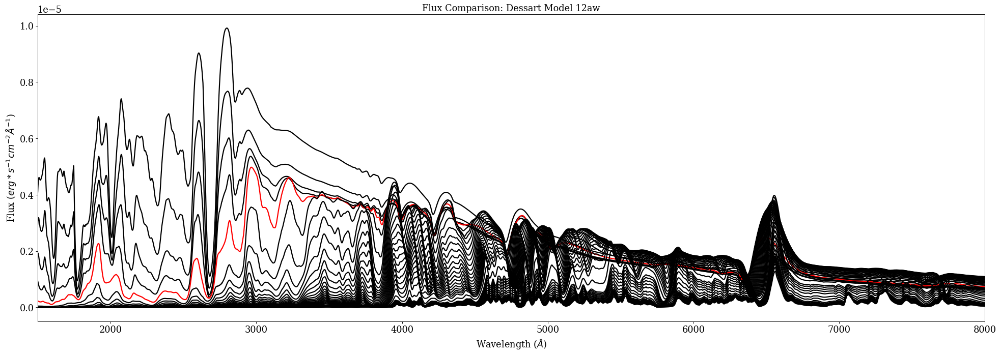

In [7]:
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Flux Comparison: Dessart Model 12aw',fontsize=font)
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_11_wave_m,SN12aw_11_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_12_wave_m,SN12aw_12_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_13_wave_m,SN12aw_13_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_14_wave_m,SN12aw_14_flux_m,linewidth=2,c='red')
plt.plot(SN12aw_16_wave_m,SN12aw_16_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_17_wave_m,SN12aw_17_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_19_wave_m,SN12aw_19_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_21_wave_m,SN12aw_21_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_23_wave_m,SN12aw_23_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_26_wave_m,SN12aw_26_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_28_wave_m,SN12aw_28_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_31_wave_m,SN12aw_31_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_34_wave_m,SN12aw_34_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_38_wave_m,SN12aw_38_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_42_wave_m,SN12aw_42_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_46_wave_m,SN12aw_46_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_50_wave_m,SN12aw_50_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_55_wave_m,SN12aw_55_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_61_wave_m,SN12aw_61_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_67_wave_m,SN12aw_67_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_74_wave_m,SN12aw_74_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_81_wave_m,SN12aw_81_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_89_wave_m,SN12aw_89_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_98_wave_m,SN12aw_98_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_108_wave_m,SN12aw_108_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_119_wave_m,SN12aw_119_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_121_wave_m,SN12aw_121_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_124_wave_m,SN12aw_124_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_126_wave_m,SN12aw_126_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_129_wave_m,SN12aw_129_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_131_wave_m,SN12aw_131_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_134_wave_m,SN12aw_134_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_137_wave_m,SN12aw_137_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_139_wave_m,SN12aw_139_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_142_wave_m,SN12aw_142_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_145_wave_m,SN12aw_145_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_148_wave_m,SN12aw_148_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_151_wave_m,SN12aw_151_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_154_wave_m,SN12aw_154_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_157_wave_m,SN12aw_157_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_160_wave_m,SN12aw_160_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_163_wave_m,SN12aw_163_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_166_wave_m,SN12aw_166_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_175_wave_m,SN12aw_175_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_187_wave_m,SN12aw_187_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_200_wave_m,SN12aw_200_flux_m,linewidth=2,c='black')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.show()
# 3d plot maybe to visualize?

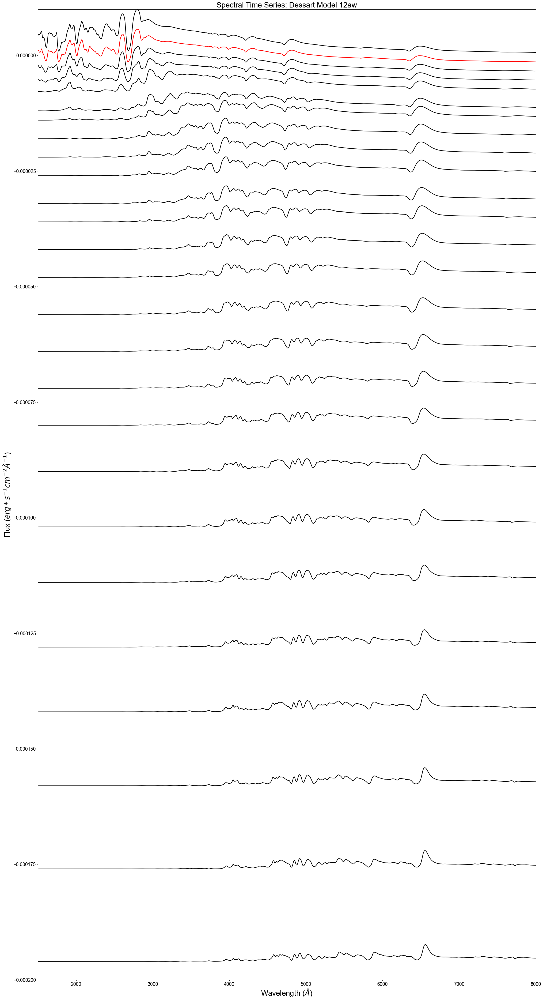

In [9]:
# every 0.00002 is 1 day
fig = plt.figure(figsize=(30, 60), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 12aw',fontsize=font)
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_11_wave_m,SN12aw_11_flux_m-0.000002,linewidth=2,c='red')
plt.plot(SN12aw_12_wave_m,SN12aw_12_flux_m-0.000004,linewidth=2,c='black')
plt.plot(SN12aw_13_wave_m,SN12aw_13_flux_m-0.000006,linewidth=2,c='black')
plt.plot(SN12aw_14_wave_m,SN12aw_14_flux_m-0.000008,linewidth=2,c='black')
plt.plot(SN12aw_16_wave_m,SN12aw_16_flux_m-0.000012,linewidth=2,c='black')
plt.plot(SN12aw_17_wave_m,SN12aw_17_flux_m-0.000014,linewidth=2,c='black')
plt.plot(SN12aw_19_wave_m,SN12aw_19_flux_m-0.000018,linewidth=2,c='black')
plt.plot(SN12aw_21_wave_m,SN12aw_21_flux_m-0.000022,linewidth=2,c='black')
plt.plot(SN12aw_23_wave_m,SN12aw_23_flux_m-0.000026,linewidth=2,c='black')
plt.plot(SN12aw_26_wave_m,SN12aw_26_flux_m-0.000032,linewidth=2,c='black')
plt.plot(SN12aw_28_wave_m,SN12aw_28_flux_m-0.000036,linewidth=2,c='black')
plt.plot(SN12aw_31_wave_m,SN12aw_31_flux_m-0.000042,linewidth=2,c='black')
plt.plot(SN12aw_34_wave_m,SN12aw_34_flux_m-0.000048,linewidth=2,c='black')
plt.plot(SN12aw_38_wave_m,SN12aw_38_flux_m-0.000056,linewidth=2,c='black')
plt.plot(SN12aw_42_wave_m,SN12aw_42_flux_m-0.000064,linewidth=2,c='black')
plt.plot(SN12aw_46_wave_m,SN12aw_46_flux_m-0.000072,linewidth=2,c='black')
plt.plot(SN12aw_50_wave_m,SN12aw_50_flux_m-0.000080,linewidth=2,c='black')
plt.plot(SN12aw_55_wave_m,SN12aw_55_flux_m-0.000090,linewidth=2,c='black')
plt.plot(SN12aw_61_wave_m,SN12aw_61_flux_m-0.000102,linewidth=2,c='black')
plt.plot(SN12aw_67_wave_m,SN12aw_67_flux_m-0.000114,linewidth=2,c='black')
plt.plot(SN12aw_74_wave_m,SN12aw_74_flux_m-0.000128,linewidth=2,c='black')
plt.plot(SN12aw_81_wave_m,SN12aw_81_flux_m-0.000142,linewidth=2,c='black')
plt.plot(SN12aw_89_wave_m,SN12aw_89_flux_m-0.000158,linewidth=2,c='black')
plt.plot(SN12aw_98_wave_m,SN12aw_98_flux_m-0.000176,linewidth=2,c='black')
plt.plot(SN12aw_108_wave_m,SN12aw_108_flux_m-0.000196,linewidth=2,c='black')
plt.plot(SN12aw_119_wave_m,SN12aw_119_flux_m-0.000218,linewidth=2,c='black')
plt.plot(SN12aw_121_wave_m,SN12aw_121_flux_m-0.000222,linewidth=2,c='black')
plt.plot(SN12aw_124_wave_m,SN12aw_124_flux_m-0.000228,linewidth=2,c='black')
plt.plot(SN12aw_126_wave_m,SN12aw_126_flux_m-0.000232,linewidth=2,c='black')
plt.plot(SN12aw_129_wave_m,SN12aw_129_flux_m-0.000238,linewidth=2,c='black')
plt.plot(SN12aw_131_wave_m,SN12aw_131_flux_m-0.000242,linewidth=2,c='black')
plt.plot(SN12aw_134_wave_m,SN12aw_134_flux_m-0.000248,linewidth=2,c='black')
plt.plot(SN12aw_137_wave_m,SN12aw_137_flux_m-0.000254,linewidth=2,c='black')
plt.plot(SN12aw_139_wave_m,SN12aw_139_flux_m-0.000258,linewidth=2,c='black')
plt.plot(SN12aw_142_wave_m,SN12aw_142_flux_m-0.000264,linewidth=2,c='black')
plt.plot(SN12aw_145_wave_m,SN12aw_145_flux_m-0.000270,linewidth=2,c='black')
plt.plot(SN12aw_148_wave_m,SN12aw_148_flux_m-0.000276,linewidth=2,c='black')
plt.plot(SN12aw_151_wave_m,SN12aw_151_flux_m-0.000282,linewidth=2,c='black')
plt.plot(SN12aw_154_wave_m,SN12aw_154_flux_m-0.000288,linewidth=2,c='black')
plt.plot(SN12aw_157_wave_m,SN12aw_157_flux_m-0.000294,linewidth=2,c='black')
plt.plot(SN12aw_160_wave_m,SN12aw_160_flux_m-0.000300,linewidth=2,c='black')
plt.plot(SN12aw_163_wave_m,SN12aw_163_flux_m-0.000306,linewidth=2,c='black')
plt.plot(SN12aw_166_wave_m,SN12aw_166_flux_m-0.000312,linewidth=2,c='black')
plt.plot(SN12aw_175_wave_m,SN12aw_175_flux_m-0.000330,linewidth=2,c='black')
plt.plot(SN12aw_187_wave_m,SN12aw_187_flux_m-0.000354,linewidth=2,c='black')
plt.plot(SN12aw_200_wave_m,SN12aw_200_flux_m-0.000380,linewidth=2,c='black')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.000200,0.00001)
plt.show()

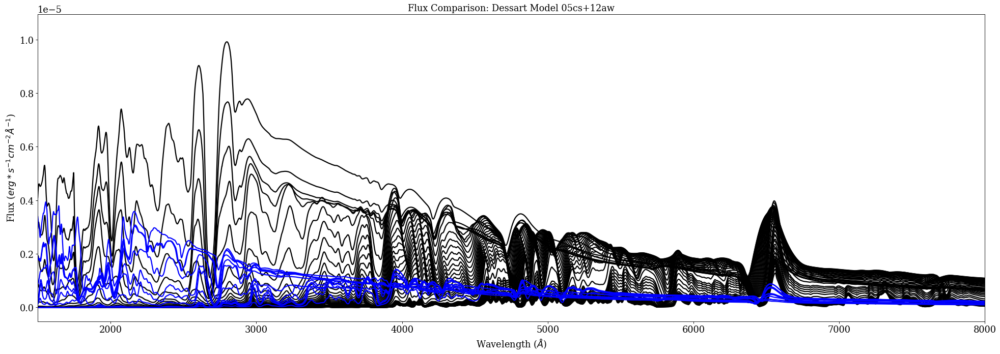

In [6]:
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Flux Comparison: Dessart Model 05cs+12aw',fontsize=font)
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_11_wave_m,SN12aw_11_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_12_wave_m,SN12aw_12_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_13_wave_m,SN12aw_13_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_14_wave_m,SN12aw_14_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_16_wave_m,SN12aw_16_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_17_wave_m,SN12aw_17_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_19_wave_m,SN12aw_19_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_21_wave_m,SN12aw_21_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_23_wave_m,SN12aw_23_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_26_wave_m,SN12aw_26_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_28_wave_m,SN12aw_28_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_31_wave_m,SN12aw_31_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_34_wave_m,SN12aw_34_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_38_wave_m,SN12aw_38_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_42_wave_m,SN12aw_42_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_46_wave_m,SN12aw_46_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_50_wave_m,SN12aw_50_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_55_wave_m,SN12aw_55_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_61_wave_m,SN12aw_61_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_67_wave_m,SN12aw_67_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_74_wave_m,SN12aw_74_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_81_wave_m,SN12aw_81_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_89_wave_m,SN12aw_89_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_98_wave_m,SN12aw_98_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_108_wave_m,SN12aw_108_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_119_wave_m,SN12aw_119_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_121_wave_m,SN12aw_121_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_124_wave_m,SN12aw_124_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_126_wave_m,SN12aw_126_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_129_wave_m,SN12aw_129_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_131_wave_m,SN12aw_131_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_134_wave_m,SN12aw_134_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_137_wave_m,SN12aw_137_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_139_wave_m,SN12aw_139_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_142_wave_m,SN12aw_142_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_145_wave_m,SN12aw_145_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_148_wave_m,SN12aw_148_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_151_wave_m,SN12aw_151_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_154_wave_m,SN12aw_154_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_157_wave_m,SN12aw_157_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_160_wave_m,SN12aw_160_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_163_wave_m,SN12aw_163_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_166_wave_m,SN12aw_166_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_175_wave_m,SN12aw_175_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_187_wave_m,SN12aw_187_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_200_wave_m,SN12aw_200_flux_m,linewidth=2,c='black')
plt.plot(SN05cs_3_wave_m, SN05cs_3_flux_m,linewidth=2,c='blue')
plt.plot(SN05cs_4_wave_m, SN05cs_4_flux_m,linewidth=2,c='blue')
plt.plot(SN05cs_5_wave_m, SN05cs_5_flux_m,linewidth=2,c='blue')
plt.plot(SN05cs_6_wave_m, SN05cs_6_flux_m,linewidth=2,c='blue')
plt.plot(SN05cs_7_wave_m, SN05cs_7_flux_m,linewidth=2,c='blue')
plt.plot(SN05cs_8_wave_m, SN05cs_8_flux_m,linewidth=2,c='blue')
plt.plot(SN05cs_9_wave_m, SN05cs_9_flux_m,linewidth=2,c='blue')
plt.plot(SN05cs_12_wave_m, SN05cs_12_flux_m,linewidth=2,c='blue')
plt.plot(SN05cs_13_wave_m, SN05cs_13_flux_m,linewidth=2,c='blue')
plt.plot(SN05cs_14_wave_m, SN05cs_14_flux_m,linewidth=2,c='blue')
plt.plot(SN05cs_15_wave_m, SN05cs_15_flux_m,linewidth=2,c='blue')
plt.plot(SN05cs_17_wave_m, SN05cs_17_flux_m,linewidth=2,c='blue')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.show()
# magnesium line for 05cs shows up a lot earlier, and overall flux level for 05cs is much lower than 12aw

### <a id='5a'>Figure 43a: Flux Comparisons (Dessart Model 05cs+06bp+12aw)</a> 
[Table of Contents](#0)

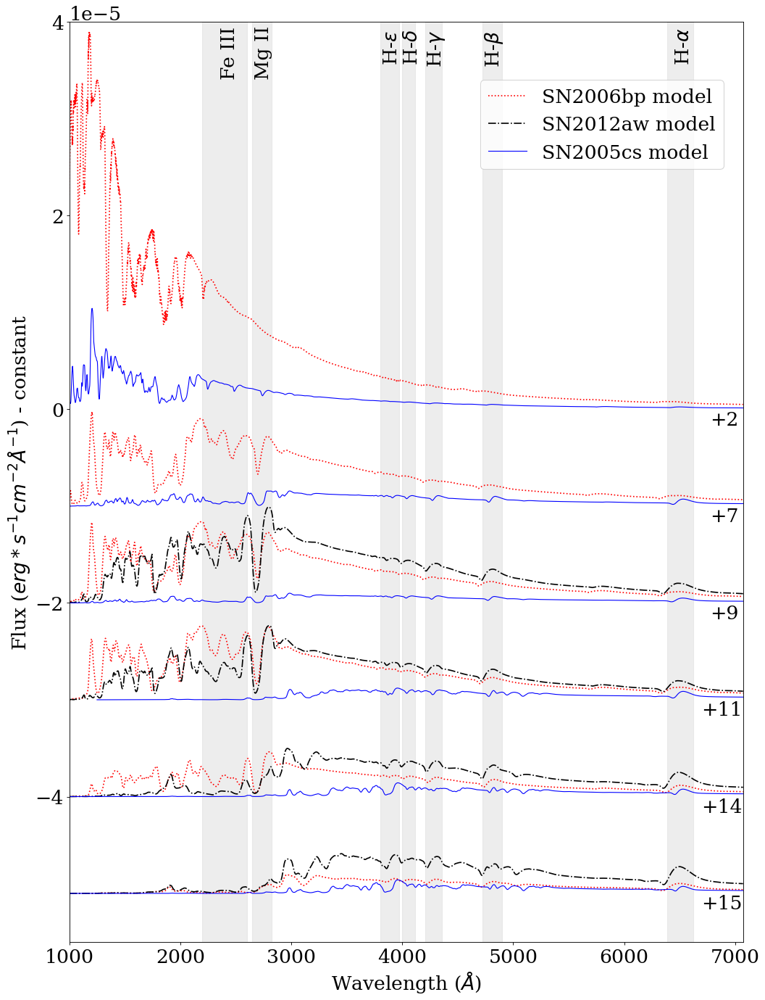

In [144]:
# model comparisons
fig = plt.figure(figsize=(15, 21), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('Flux Comparison: Dessart Model 05cs+06bp+12aw',fontsize=font)
plt.plot(SN06bp_2half_wave_m,SN06bp_2half_flux_m,linewidth=1.5,c='red',linestyle='dotted')
plt.plot(SN05cs_3_wave_m, SN05cs_3_flux_m,linewidth=1,c='blue')

plt.plot(SN06bp_7half_wave_m,SN06bp_7half_flux_m-0.00001,linewidth=1.5,c='red',linestyle='dotted')
plt.plot(SN05cs_8_wave_m, SN05cs_8_flux_m-0.00001,linewidth=1,c='blue')

plt.plot(SN06bp_9half_wave_m,SN06bp_9half_flux_m-0.00002,linewidth=1.5,c='red',linestyle='dotted')
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m-0.00002,linewidth=1.5,c='black',linestyle='dashdot')
plt.plot(SN05cs_9_wave_m, SN05cs_9_flux_m-0.00002,linewidth=1,c='blue')

plt.plot(SN06bp_11_wave_m,SN06bp_11_flux_m-0.00003,linewidth=1.5,c='red',linestyle='dotted')
plt.plot(SN12aw_11_wave_m,SN12aw_11_flux_m-0.00003,linewidth=1.5,c='black',linestyle='dashdot')
plt.plot(SN05cs_12_wave_m, SN05cs_12_flux_m-0.00003,linewidth=1,c='blue')

plt.plot(SN06bp_14half_wave_m,SN06bp_14half_flux_m-0.00004,linewidth=1.5,c='red',linestyle='dotted')
plt.plot(SN12aw_14_wave_m,SN12aw_14_flux_m-0.00004,linewidth=1.5,c='black',linestyle='dashdot')
plt.plot(SN05cs_14_wave_m, SN05cs_14_flux_m-0.00004,linewidth=1,c='blue')

plt.plot(SN06bp_15half_wave_m,SN06bp_15half_flux_m-0.00005,linewidth=1.5,c='red',linestyle='dotted',label='SN2006bp model')
plt.plot(SN12aw_16_wave_m,SN12aw_16_flux_m-0.00005,linewidth=1.5,c='black',linestyle='dashdot',label='SN2012aw model')
plt.plot(SN05cs_15_wave_m, SN05cs_15_flux_m-0.00005,linewidth=1,c='blue',label='SN2005cs model')

plt.legend(loc=(0.61,0.84),fontsize=font1)
# plotting epoch labels
plt.text(6770,-0.0000016,'+2',fontsize=font)
plt.text(6770,-0.0000116,'+7',fontsize=font)
plt.text(6770,-0.0000216,'+9',fontsize=font)
plt.text(6695,-0.0000316,'+11',fontsize=font)
plt.text(6695,-0.0000416,'+14',fontsize=font)
plt.text(6695,-0.0000516,'+15',fontsize=font)
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2360,0.0000345,'Fe III',fontsize=font1,rotation='vertical')
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2670,0.0000345,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3825,0.0000360,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4005,0.0000360,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4215,0.0000360,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4730,0.0000360,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
# H-alpha
plt.axvspan(6390, 6625, alpha=0.5, color='gainsboro')
plt.text(6455,0.0000360,"H-" r'$\alpha$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(1000,7070)
plt.ylim(-0.000055,0.00004)
plt.savefig("models_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

#### Figure 4 Caption

Comparison of Type IIP spectral models SN2005cs, SN2006bp, and SN2012aw from Dr. Luc Dessart. These models are all set at a distance of 10 Mpc. Especially evident when comparing earlier epochs, the overall flux level for SN2005cs is lower than that of SN2006bp and SN2012aw. However the MgII feature is seen in earlier epochs for SN2005cs compared to the others.

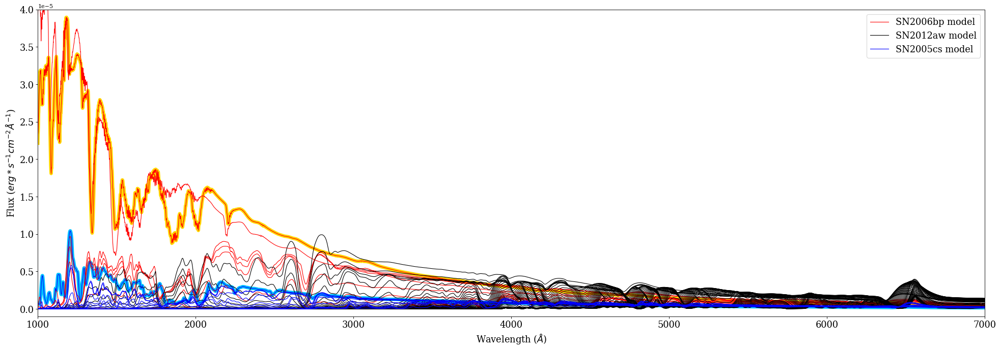

In [90]:
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('Flux Comparison: Dessart Model 05cs+06bp+12aw',fontsize=font)
plt.plot(SN06bp_2half_wave_m,SN06bp_2half_flux_m,linewidth=6,c='gold')
plt.plot(SN05cs_3_wave_m, SN05cs_3_flux_m,linewidth=6,c='deepskyblue')
plt.plot(SN06bp_1half_wave_m,SN06bp_1half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_2half_wave_m,SN06bp_2half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_7half_wave_m,SN06bp_7half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_9half_wave_m,SN06bp_9half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_11_wave_m,SN06bp_11_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_14half_wave_m,SN06bp_14half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_15half_wave_m,SN06bp_15half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_20half_wave_m,SN06bp_20half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_22_wave_m,SN06bp_22_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_24_wave_m,SN06bp_24_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_30_wave_m,SN06bp_30_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_41half_wave_m,SN06bp_41half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_56half_wave_m,SN06bp_56half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_72half_wave_m,SN06bp_72half_flux_m,linewidth=1,c='red',label='SN2006bp model')
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_11_wave_m,SN12aw_11_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_12_wave_m,SN12aw_12_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_13_wave_m,SN12aw_13_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_14_wave_m,SN12aw_14_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_16_wave_m,SN12aw_16_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_17_wave_m,SN12aw_17_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_19_wave_m,SN12aw_19_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_21_wave_m,SN12aw_21_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_23_wave_m,SN12aw_23_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_26_wave_m,SN12aw_26_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_28_wave_m,SN12aw_28_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_31_wave_m,SN12aw_31_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_34_wave_m,SN12aw_34_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_38_wave_m,SN12aw_38_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_42_wave_m,SN12aw_42_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_46_wave_m,SN12aw_46_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_50_wave_m,SN12aw_50_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_55_wave_m,SN12aw_55_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_61_wave_m,SN12aw_61_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_67_wave_m,SN12aw_67_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_74_wave_m,SN12aw_74_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_81_wave_m,SN12aw_81_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_89_wave_m,SN12aw_89_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_98_wave_m,SN12aw_98_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_108_wave_m,SN12aw_108_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_119_wave_m,SN12aw_119_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_121_wave_m,SN12aw_121_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_124_wave_m,SN12aw_124_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_126_wave_m,SN12aw_126_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_129_wave_m,SN12aw_129_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_131_wave_m,SN12aw_131_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_134_wave_m,SN12aw_134_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_137_wave_m,SN12aw_137_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_139_wave_m,SN12aw_139_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_142_wave_m,SN12aw_142_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_145_wave_m,SN12aw_145_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_148_wave_m,SN12aw_148_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_151_wave_m,SN12aw_151_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_154_wave_m,SN12aw_154_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_157_wave_m,SN12aw_157_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_160_wave_m,SN12aw_160_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_163_wave_m,SN12aw_163_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_166_wave_m,SN12aw_166_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_175_wave_m,SN12aw_175_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_187_wave_m,SN12aw_187_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_200_wave_m,SN12aw_200_flux_m,linewidth=1,c='black',label='SN2012aw model')
plt.plot(SN05cs_3_wave_m, SN05cs_3_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_4_wave_m, SN05cs_4_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_5_wave_m, SN05cs_5_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_6_wave_m, SN05cs_6_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_7_wave_m, SN05cs_7_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_8_wave_m, SN05cs_8_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_9_wave_m, SN05cs_9_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_12_wave_m, SN05cs_12_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_13_wave_m, SN05cs_13_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_14_wave_m, SN05cs_14_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_15_wave_m, SN05cs_15_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_17_wave_m, SN05cs_17_flux_m,linewidth=1,c='blue',label='SN2005cs model')
plt.legend(loc=1,fontsize=font1)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(1000,7000)
plt.ylim(-0.000001,0.00004)
plt.savefig("models_paperplot.png") # save as png
plt.show()
# magnesium line for 05cs shows up a lot earlier, and overall flux level for 05cs is much lower than 12aw

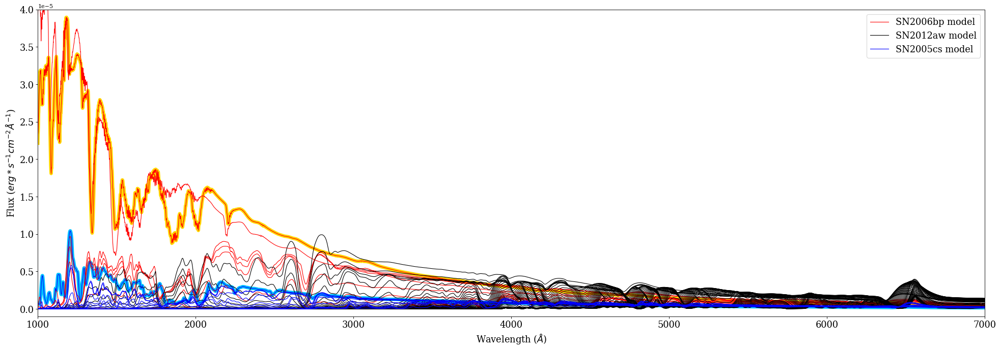

In [91]:
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('Flux Comparison: Dessart Model 05cs+06bp+12aw',fontsize=font)
plt.plot(SN06bp_2half_wave_m,SN06bp_2half_flux_m,linewidth=6,c='gold')
plt.plot(SN05cs_3_wave_m, SN05cs_3_flux_m,linewidth=6,c='deepskyblue')
plt.plot(SN06bp_1half_wave_m,SN06bp_1half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_2half_wave_m,SN06bp_2half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_7half_wave_m,SN06bp_7half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_9half_wave_m,SN06bp_9half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_11_wave_m,SN06bp_11_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_14half_wave_m,SN06bp_14half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_15half_wave_m,SN06bp_15half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_20half_wave_m,SN06bp_20half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_22_wave_m,SN06bp_22_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_24_wave_m,SN06bp_24_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_30_wave_m,SN06bp_30_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_41half_wave_m,SN06bp_41half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_56half_wave_m,SN06bp_56half_flux_m,linewidth=1,c='red')
plt.plot(SN06bp_72half_wave_m,SN06bp_72half_flux_m,linewidth=1,c='red',label='SN2006bp model')
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_11_wave_m,SN12aw_11_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_12_wave_m,SN12aw_12_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_13_wave_m,SN12aw_13_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_14_wave_m,SN12aw_14_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_16_wave_m,SN12aw_16_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_17_wave_m,SN12aw_17_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_19_wave_m,SN12aw_19_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_21_wave_m,SN12aw_21_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_23_wave_m,SN12aw_23_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_26_wave_m,SN12aw_26_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_28_wave_m,SN12aw_28_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_31_wave_m,SN12aw_31_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_34_wave_m,SN12aw_34_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_38_wave_m,SN12aw_38_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_42_wave_m,SN12aw_42_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_46_wave_m,SN12aw_46_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_50_wave_m,SN12aw_50_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_55_wave_m,SN12aw_55_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_61_wave_m,SN12aw_61_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_67_wave_m,SN12aw_67_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_74_wave_m,SN12aw_74_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_81_wave_m,SN12aw_81_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_89_wave_m,SN12aw_89_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_98_wave_m,SN12aw_98_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_108_wave_m,SN12aw_108_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_119_wave_m,SN12aw_119_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_121_wave_m,SN12aw_121_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_124_wave_m,SN12aw_124_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_126_wave_m,SN12aw_126_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_129_wave_m,SN12aw_129_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_131_wave_m,SN12aw_131_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_134_wave_m,SN12aw_134_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_137_wave_m,SN12aw_137_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_139_wave_m,SN12aw_139_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_142_wave_m,SN12aw_142_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_145_wave_m,SN12aw_145_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_148_wave_m,SN12aw_148_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_151_wave_m,SN12aw_151_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_154_wave_m,SN12aw_154_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_157_wave_m,SN12aw_157_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_160_wave_m,SN12aw_160_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_163_wave_m,SN12aw_163_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_166_wave_m,SN12aw_166_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_175_wave_m,SN12aw_175_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_187_wave_m,SN12aw_187_flux_m,linewidth=1,c='black')
plt.plot(SN12aw_200_wave_m,SN12aw_200_flux_m,linewidth=1,c='black',label='SN2012aw model')
plt.plot(SN05cs_3_wave_m, SN05cs_3_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_4_wave_m, SN05cs_4_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_5_wave_m, SN05cs_5_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_6_wave_m, SN05cs_6_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_7_wave_m, SN05cs_7_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_8_wave_m, SN05cs_8_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_9_wave_m, SN05cs_9_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_12_wave_m, SN05cs_12_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_13_wave_m, SN05cs_13_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_14_wave_m, SN05cs_14_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_15_wave_m, SN05cs_15_flux_m,linewidth=1,c='blue')
plt.plot(SN05cs_17_wave_m, SN05cs_17_flux_m,linewidth=1,c='blue',label='SN2005cs model')
plt.legend(loc=1,fontsize=font1)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(1000,7000)
plt.ylim(-0.000001,0.00004)
plt.savefig("models_paperplot.png") # save as png
plt.show()
# magnesium line for 05cs shows up a lot earlier, and overall flux level for 05cs is much lower than 12aw

#### Figure 4 Caption

Comparison of type IIP spectral models SN2005cs, SN2006bp, and SN2012aw from Dr. Luc Dessart. These models are all set at a distance of 10 Mpc. The highlighted spectra are for SN2006bp at day 2.5 and SN2005cs at day 3

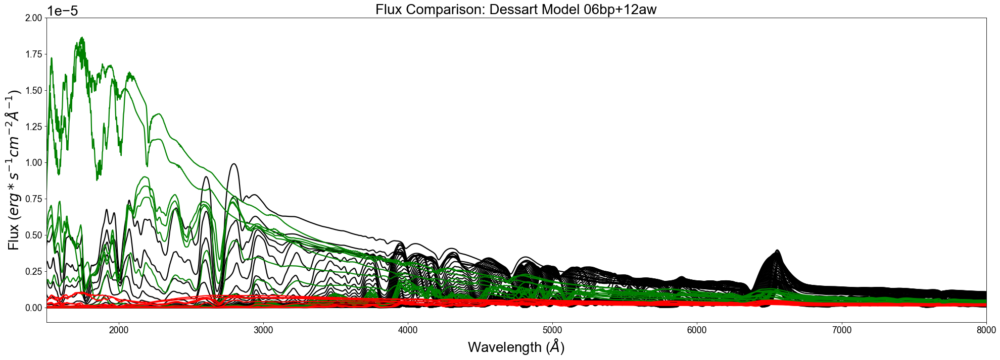

In [33]:
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Flux Comparison: Dessart Model 06bp+12aw',fontsize=font)
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_11_wave_m,SN12aw_11_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_12_wave_m,SN12aw_12_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_13_wave_m,SN12aw_13_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_14_wave_m,SN12aw_14_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_16_wave_m,SN12aw_16_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_17_wave_m,SN12aw_17_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_19_wave_m,SN12aw_19_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_21_wave_m,SN12aw_21_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_23_wave_m,SN12aw_23_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_26_wave_m,SN12aw_26_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_28_wave_m,SN12aw_28_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_31_wave_m,SN12aw_31_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_34_wave_m,SN12aw_34_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_38_wave_m,SN12aw_38_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_42_wave_m,SN12aw_42_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_46_wave_m,SN12aw_46_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_50_wave_m,SN12aw_50_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_55_wave_m,SN12aw_55_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_61_wave_m,SN12aw_61_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_67_wave_m,SN12aw_67_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_74_wave_m,SN12aw_74_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_81_wave_m,SN12aw_81_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_89_wave_m,SN12aw_89_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_98_wave_m,SN12aw_98_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_108_wave_m,SN12aw_108_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_119_wave_m,SN12aw_119_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_121_wave_m,SN12aw_121_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_124_wave_m,SN12aw_124_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_126_wave_m,SN12aw_126_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_129_wave_m,SN12aw_129_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_131_wave_m,SN12aw_131_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_134_wave_m,SN12aw_134_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_137_wave_m,SN12aw_137_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_139_wave_m,SN12aw_139_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_142_wave_m,SN12aw_142_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_145_wave_m,SN12aw_145_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_148_wave_m,SN12aw_148_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_151_wave_m,SN12aw_151_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_154_wave_m,SN12aw_154_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_157_wave_m,SN12aw_157_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_160_wave_m,SN12aw_160_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_163_wave_m,SN12aw_163_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_166_wave_m,SN12aw_166_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_175_wave_m,SN12aw_175_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_187_wave_m,SN12aw_187_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_200_wave_m,SN12aw_200_flux_m,linewidth=2,c='black')
plt.plot(SN06bp_1half_wave_m,SN06bp_1half_flux_m,linewidth=2,c='green')
plt.plot(SN06bp_2half_wave_m,SN06bp_2half_flux_m,linewidth=2,c='green')
plt.plot(SN06bp_7half_wave_m,SN06bp_7half_flux_m,linewidth=2,c='green')
plt.plot(SN06bp_9half_wave_m,SN06bp_9half_flux_m,linewidth=2,c='green')
plt.plot(SN06bp_11_wave_m,SN06bp_11_flux_m,linewidth=2,c='green')
plt.plot(SN06bp_14half_wave_m,SN06bp_14half_flux_m,linewidth=2,c='green')
plt.plot(SN06bp_15half_wave_m,SN06bp_15half_flux_m,linewidth=2,c='green')
plt.plot(SN06bp_20half_wave_m,SN06bp_20half_flux_m,linewidth=2,c='green')
plt.plot(SN06bp_22_wave_m,SN06bp_22_flux_m,linewidth=2,c='green')
plt.plot(SN06bp_24_wave_m,SN06bp_24_flux_m,linewidth=2,c='green')
plt.plot(SN06bp_30_wave_m,SN06bp_30_flux_m,linewidth=2,c='green')
plt.plot(SN06bp_41half_wave_m,SN06bp_41half_flux_m,linewidth=2,c='green')
plt.plot(SN06bp_56half_wave_m,SN06bp_56half_flux_m,linewidth=2,c='green')
plt.plot(SN06bp_72half_wave_m,SN06bp_72half_flux_m,linewidth=2,c='green')
plt.plot(SN06bp_1half_wave_mred,SN06bp_1half_flux_mred,linewidth=2,c='red')
plt.plot(SN06bp_2half_wave_mred,SN06bp_2half_flux_mred,linewidth=2,c='red')
plt.plot(SN06bp_7half_wave_mred,SN06bp_7half_flux_mred,linewidth=2,c='red')
plt.plot(SN06bp_9half_wave_mred,SN06bp_9half_flux_mred,linewidth=2,c='red')
plt.plot(SN06bp_11_wave_mred,SN06bp_11_flux_mred,linewidth=2,c='red')
plt.plot(SN06bp_14half_wave_mred,SN06bp_14half_flux_mred,linewidth=2,c='red')
plt.plot(SN06bp_15half_wave_mred,SN06bp_15half_flux_mred,linewidth=2,c='red')
plt.plot(SN06bp_20half_wave_mred,SN06bp_20half_flux_mred,linewidth=2,c='red')
plt.plot(SN06bp_22_wave_mred,SN06bp_22_flux_mred,linewidth=2,c='red')
plt.plot(SN06bp_24_wave_mred,SN06bp_24_flux_mred,linewidth=2,c='red')
plt.plot(SN06bp_30_wave_mred,SN06bp_30_flux_mred,linewidth=2,c='red')
plt.plot(SN06bp_41half_wave_mred,SN06bp_41half_flux_mred,linewidth=2,c='red')
plt.plot(SN06bp_56half_wave_mred,SN06bp_56half_flux_mred,linewidth=2,c='red')
plt.plot(SN06bp_72half_wave_mred,SN06bp_72half_flux_mred,linewidth=2,c='red')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.000001,0.00002)
plt.show()
# 06bp is much more comparable with the depth of the mg line and also overall flux level

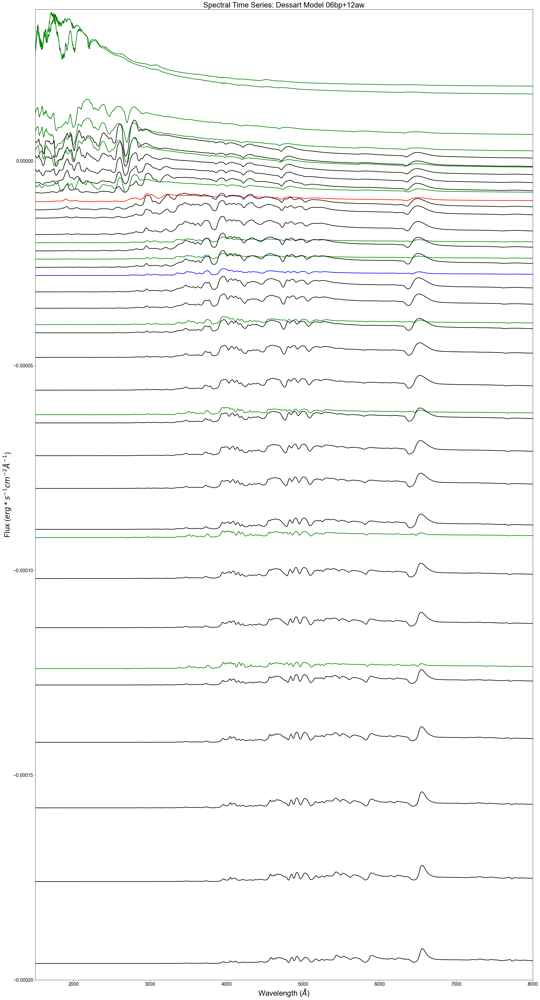

In [12]:
# every 0.00002 is 1 day
fig = plt.figure(figsize=(30, 60), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw',fontsize=font)
plt.plot(SN06bp_1half_wave_m,SN06bp_1half_flux_m+0.000018,linewidth=2,c='green')
plt.plot(SN06bp_2half_wave_m,SN06bp_2half_flux_m+0.000016,linewidth=2,c='green')
plt.plot(SN06bp_7half_wave_m,SN06bp_7half_flux_m+0.000006,linewidth=2,c='green')
plt.plot(SN06bp_9half_wave_m,SN06bp_9half_flux_m+0.000002,linewidth=2,c='green')
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m,linewidth=2,c='black')
plt.plot(SN12aw_11_wave_m,SN12aw_11_flux_m-0.000002,linewidth=2,c='black')
plt.plot(SN06bp_11_wave_m,SN06bp_11_flux_m-0.000002,linewidth=2,c='green')
plt.plot(SN12aw_12_wave_m,SN12aw_12_flux_m-0.000004,linewidth=2,c='black')
plt.plot(SN12aw_13_wave_m,SN12aw_13_flux_m-0.000006,linewidth=2,c='black')
plt.plot(SN12aw_14_wave_m,SN12aw_14_flux_m-0.000008,linewidth=2,c='black')
plt.plot(SN06bp_14half_wave_m,SN06bp_14half_flux_m-0.000008,linewidth=2,c='green')
plt.plot(SN06bp_15half_wave_m,SN06bp_15half_flux_m-0.000010,linewidth=2,c='red')
plt.plot(SN12aw_16_wave_m,SN12aw_16_flux_m-0.000012,linewidth=2,c='black')
plt.plot(SN12aw_17_wave_m,SN12aw_17_flux_m-0.000014,linewidth=2,c='black')
plt.plot(SN12aw_19_wave_m,SN12aw_19_flux_m-0.000018,linewidth=2,c='black')
plt.plot(SN06bp_20half_wave_m,SN06bp_20half_flux_m-0.000020,linewidth=2,c='green')
plt.plot(SN12aw_21_wave_m,SN12aw_21_flux_m-0.000022,linewidth=2,c='black')
plt.plot(SN06bp_22_wave_m,SN06bp_22_flux_m-0.000024,linewidth=2,c='green')
plt.plot(SN12aw_23_wave_m,SN12aw_23_flux_m-0.000026,linewidth=2,c='black')
plt.plot(SN06bp_24_wave_m,SN06bp_24_flux_m-0.000028,linewidth=2,c='blue')
plt.plot(SN12aw_26_wave_m,SN12aw_26_flux_m-0.000032,linewidth=2,c='black')
plt.plot(SN12aw_28_wave_m,SN12aw_28_flux_m-0.000036,linewidth=2,c='black')
plt.plot(SN06bp_30_wave_m,SN06bp_30_flux_m-0.000040,linewidth=2,c='green')
plt.plot(SN12aw_31_wave_m,SN12aw_31_flux_m-0.000042,linewidth=2,c='black')
plt.plot(SN12aw_34_wave_m,SN12aw_34_flux_m-0.000048,linewidth=2,c='black')
plt.plot(SN12aw_38_wave_m,SN12aw_38_flux_m-0.000056,linewidth=2,c='black')
plt.plot(SN06bp_41half_wave_m,SN06bp_41half_flux_m-0.000062,linewidth=2,c='green')
plt.plot(SN12aw_42_wave_m,SN12aw_42_flux_m-0.000064,linewidth=2,c='black')
plt.plot(SN12aw_46_wave_m,SN12aw_46_flux_m-0.000072,linewidth=2,c='black')
plt.plot(SN12aw_50_wave_m,SN12aw_50_flux_m-0.000080,linewidth=2,c='black')
plt.plot(SN12aw_55_wave_m,SN12aw_55_flux_m-0.000090,linewidth=2,c='black')
plt.plot(SN06bp_56half_wave_m,SN06bp_56half_flux_m-0.000092,linewidth=2,c='green')
plt.plot(SN12aw_61_wave_m,SN12aw_61_flux_m-0.000102,linewidth=2,c='black')
plt.plot(SN12aw_67_wave_m,SN12aw_67_flux_m-0.000114,linewidth=2,c='black')
plt.plot(SN06bp_72half_wave_m,SN06bp_72half_flux_m-0.000124,linewidth=2,c='green')
plt.plot(SN12aw_74_wave_m,SN12aw_74_flux_m-0.000128,linewidth=2,c='black')
plt.plot(SN12aw_81_wave_m,SN12aw_81_flux_m-0.000142,linewidth=2,c='black')
plt.plot(SN12aw_89_wave_m,SN12aw_89_flux_m-0.000158,linewidth=2,c='black')
plt.plot(SN12aw_98_wave_m,SN12aw_98_flux_m-0.000176,linewidth=2,c='black')
plt.plot(SN12aw_108_wave_m,SN12aw_108_flux_m-0.000196,linewidth=2,c='black')
plt.plot(SN12aw_119_wave_m,SN12aw_119_flux_m-0.000218,linewidth=2,c='black')
plt.plot(SN12aw_121_wave_m,SN12aw_121_flux_m-0.000222,linewidth=2,c='black')
plt.plot(SN12aw_124_wave_m,SN12aw_124_flux_m-0.000228,linewidth=2,c='black')
plt.plot(SN12aw_126_wave_m,SN12aw_126_flux_m-0.000232,linewidth=2,c='black')
plt.plot(SN12aw_129_wave_m,SN12aw_129_flux_m-0.000238,linewidth=2,c='black')
plt.plot(SN12aw_131_wave_m,SN12aw_131_flux_m-0.000242,linewidth=2,c='black')
plt.plot(SN12aw_134_wave_m,SN12aw_134_flux_m-0.000248,linewidth=2,c='black')
plt.plot(SN12aw_137_wave_m,SN12aw_137_flux_m-0.000254,linewidth=2,c='black')
plt.plot(SN12aw_139_wave_m,SN12aw_139_flux_m-0.000258,linewidth=2,c='black')
plt.plot(SN12aw_142_wave_m,SN12aw_142_flux_m-0.000264,linewidth=2,c='black')
plt.plot(SN12aw_145_wave_m,SN12aw_145_flux_m-0.000270,linewidth=2,c='black')
plt.plot(SN12aw_148_wave_m,SN12aw_148_flux_m-0.000276,linewidth=2,c='black')
plt.plot(SN12aw_151_wave_m,SN12aw_151_flux_m-0.000282,linewidth=2,c='black')
plt.plot(SN12aw_154_wave_m,SN12aw_154_flux_m-0.000288,linewidth=2,c='black')
plt.plot(SN12aw_157_wave_m,SN12aw_157_flux_m-0.000294,linewidth=2,c='black')
plt.plot(SN12aw_160_wave_m,SN12aw_160_flux_m-0.000300,linewidth=2,c='black')
plt.plot(SN12aw_163_wave_m,SN12aw_163_flux_m-0.000306,linewidth=2,c='black')
plt.plot(SN12aw_166_wave_m,SN12aw_166_flux_m-0.000312,linewidth=2,c='black')
plt.plot(SN12aw_175_wave_m,SN12aw_175_flux_m-0.000330,linewidth=2,c='black')
plt.plot(SN12aw_187_wave_m,SN12aw_187_flux_m-0.000354,linewidth=2,c='black')
plt.plot(SN12aw_200_wave_m,SN12aw_200_flux_m-0.000380,linewidth=2,c='black')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.000200,0.000037)
plt.show()
# depth of mg matches better across epochs as well? Could be used to help fill in the earlier times

# <a id='6'>Plotting Observed Time Series</a> 
[Table of Contents](#0)

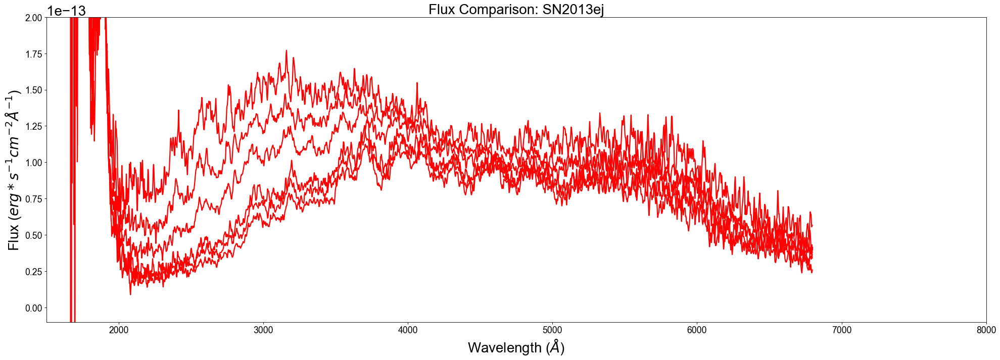

In [44]:
# 2013ej
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Flux Comparison: SN2013ej',fontsize=font)
plt.plot(SN13ej_7_wave_o,SN13ej_7_flux_o,linewidth=2,c='red')
plt.plot(SN13ej_9_wave_o,SN13ej_9_flux_o,linewidth=2,c='red')
plt.plot(SN13ej_11_wave_o,SN13ej_11_flux_o,linewidth=2,c='red')
plt.plot(SN13ej_14_wave_o,SN13ej_14_flux_o,linewidth=2,c='red')
plt.plot(SN13ej_15_wave_o,SN13ej_15_flux_o,linewidth=2,c='red')
plt.plot(SN13ej_16_wave_o,SN13ej_16_flux_o,linewidth=2,c='red')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.00000000000001,0.00000000000020)
plt.show()

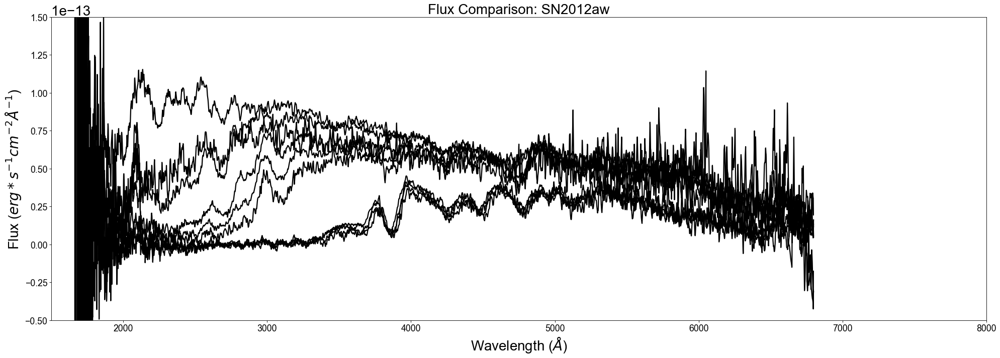

In [14]:
# 2012aw
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Flux Comparison: SN2012aw',fontsize=font)
plt.plot(SN12aw_5_wave_o,SN12aw_5_flux_o,linewidth=2,c='black')
plt.plot(SN12aw_7_wave_o,SN12aw_7_flux_o,linewidth=2,c='black')
plt.plot(SN12aw_9_wave_o,SN12aw_9_flux_o,linewidth=2,c='black')
plt.plot(SN12aw_12_wave_o,SN12aw_12_flux_o,linewidth=2,c='black')
plt.plot(SN12aw_14_wave_o,SN12aw_14_flux_o,linewidth=2,c='black')
plt.plot(SN12aw_16_wave_o,SN12aw_16_flux_o,linewidth=2,c='black')
plt.plot(SN12aw_42_wave_o,SN12aw_42_flux_o,linewidth=2,c='black')
plt.plot(SN12aw_43_wave_o,SN12aw_43_flux_o,linewidth=2,c='black')
plt.plot(SN12aw_45_wave_o,SN12aw_45_flux_o,linewidth=2,c='black')
plt.plot(SN12aw_46_wave_o,SN12aw_46_flux_o,linewidth=2,c='black')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.00000000000005,0.00000000000015)
plt.show()

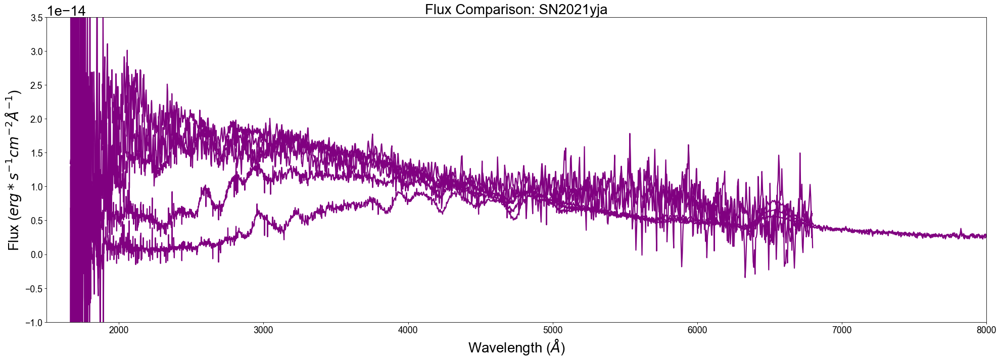

In [40]:
# 2021yja
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Flux Comparison: SN2021yja',fontsize=font)
plt.plot(SN21yja_5_wave_o,SN21yja_5_flux_o,linewidth=2,c='purple')
plt.plot(SN21yja_6_wave_o,SN21yja_6_flux_o,linewidth=2,c='purple')
plt.plot(SN21yja_7_wave_o,SN21yja_7_flux_o,linewidth=2,c='purple')
plt.plot(SN21yja_9_wave_o,SN21yja_9_flux_o,linewidth=2,c='purple')
plt.plot(SN21yja_14_wave_o,SN21yja_14_flux_o,linewidth=2,c='purple')
plt.plot(SN21yja_21_wave_o,SN21yja_21_flux_o,linewidth=2,c='purple')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.00000000000001,0.000000000000035)
plt.show()

### <a id='6a'>Figure 43b: Flux Comparisons (Observations of SN2013ej+SN2012aw+SN2021yja)</a> 
[Table of Contents](#0)

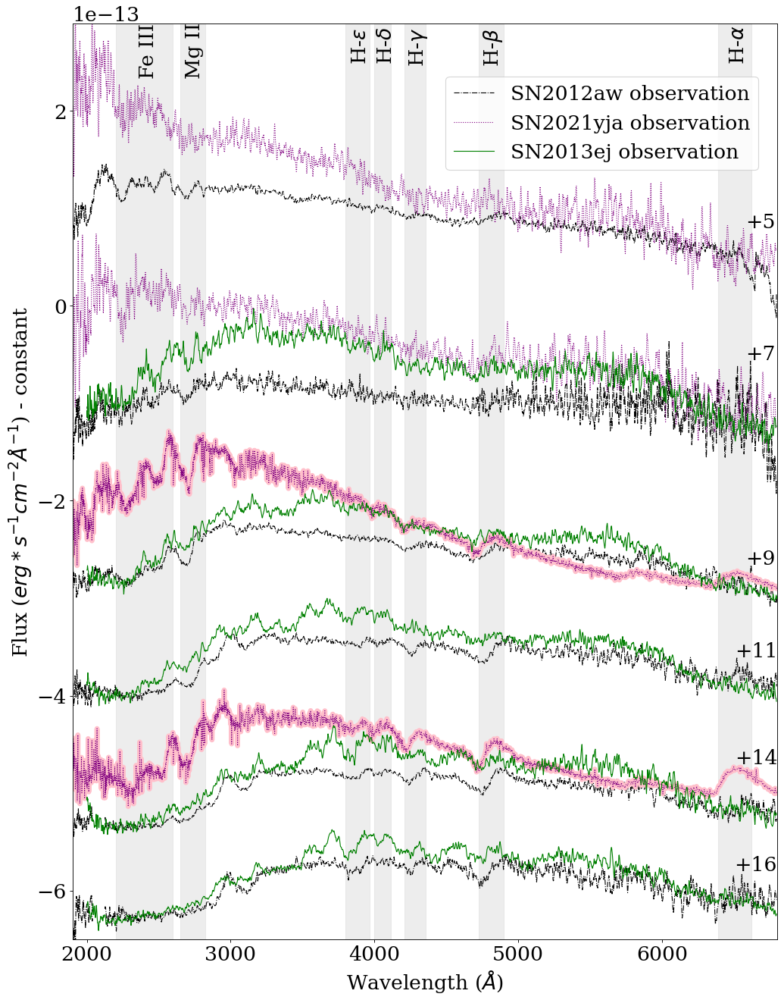

In [186]:
# observation comparisons
fig = plt.figure(figsize=(15, 20), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('Flux Comparison: SN2013ej & SN2012aw & SN2021yja observations',fontsize=font)
# removing the zeroth order stellar feature for SN2012aw days 14 and 16
SN12aw_14_wave_ol = []
SN12aw_14_flux_ol = []
SN12aw_14_wave_oh = []
SN12aw_14_flux_oh = []
for i in range(len(SN12aw_14_wave_o)):
    if SN12aw_14_wave_o[i] < 2040:
        SN12aw_14_wave_ol.append(SN12aw_14_wave_o[i])
        SN12aw_14_flux_ol.append(SN12aw_14_flux_o[i])
    if SN12aw_14_wave_o[i] > 2125:
        SN12aw_14_wave_oh.append(SN12aw_14_wave_o[i])
        SN12aw_14_flux_oh.append(SN12aw_14_flux_o[i])
SN12aw_14_wave_ol = np.array(SN12aw_14_wave_ol)
SN12aw_14_flux_ol = np.array(SN12aw_14_flux_ol)
SN12aw_14_wave_oh = np.array(SN12aw_14_wave_oh)
SN12aw_14_flux_oh = np.array(SN12aw_14_flux_oh)
SN12aw_16_wave_ol = []
SN12aw_16_flux_ol = []
SN12aw_16_wave_oh = []
SN12aw_16_flux_oh = []
for i in range(len(SN12aw_16_wave_o)):
    if SN12aw_16_wave_o[i] < 2040:
        SN12aw_16_wave_ol.append(SN12aw_16_wave_o[i])
        SN12aw_16_flux_ol.append(SN12aw_16_flux_o[i])
    if SN12aw_16_wave_o[i] > 2125:
        SN12aw_16_wave_oh.append(SN12aw_16_wave_o[i])
        SN12aw_16_flux_oh.append(SN12aw_16_flux_o[i])
SN12aw_16_wave_ol = np.array(SN12aw_16_wave_ol)
SN12aw_16_flux_ol = np.array(SN12aw_16_flux_ol)
SN12aw_16_wave_oh = np.array(SN12aw_16_wave_oh)
SN12aw_16_flux_oh = np.array(SN12aw_16_flux_oh)
# removing the parts where the sensitivity is bad for SN2013ej days 7, 9, 11, 14, and 16
SN13ej_7_wave_oh = []
SN13ej_7_flux_oh = []
SN13ej_9_wave_oh = []
SN13ej_9_flux_oh = []
SN13ej_11_wave_oh = []
SN13ej_11_flux_oh = []
SN13ej_14_wave_oh = []
SN13ej_14_flux_oh = []
SN13ej_16_wave_oh = []
SN13ej_16_flux_oh = []
for i in range(len(SN13ej_7_wave_o)):
    if SN13ej_7_wave_o[i] > 2000:
        SN13ej_7_wave_oh.append(SN13ej_7_wave_o[i])
        SN13ej_7_flux_oh.append(SN13ej_7_flux_o[i])
SN13ej_7_wave_oh = np.array(SN13ej_7_wave_oh)
SN13ej_7_flux_oh = np.array(SN13ej_7_flux_oh)
for i in range(len(SN13ej_9_wave_o)):
    if SN13ej_9_wave_o[i] > 2000:
        SN13ej_9_wave_oh.append(SN13ej_9_wave_o[i])
        SN13ej_9_flux_oh.append(SN13ej_9_flux_o[i])
SN13ej_9_wave_oh = np.array(SN13ej_9_wave_oh)
SN13ej_9_flux_oh = np.array(SN13ej_9_flux_oh)
for i in range(len(SN13ej_11_wave_o)):
    if SN13ej_11_wave_o[i] > 2000:
        SN13ej_11_wave_oh.append(SN13ej_11_wave_o[i])
        SN13ej_11_flux_oh.append(SN13ej_11_flux_o[i])
SN13ej_11_wave_oh = np.array(SN13ej_11_wave_oh)
SN13ej_11_flux_oh = np.array(SN13ej_11_flux_oh)
for i in range(len(SN13ej_14_wave_o)):
    if SN13ej_14_wave_o[i] > 2000:
        SN13ej_14_wave_oh.append(SN13ej_14_wave_o[i])
        SN13ej_14_flux_oh.append(SN13ej_14_flux_o[i])
SN13ej_14_wave_oh = np.array(SN13ej_14_wave_oh)
SN13ej_14_flux_oh = np.array(SN13ej_14_flux_oh)
for i in range(len(SN13ej_16_wave_o)):
    if SN13ej_16_wave_o[i] > 2000:
        SN13ej_16_wave_oh.append(SN13ej_16_wave_o[i])
        SN13ej_16_flux_oh.append(SN13ej_16_flux_o[i])
SN13ej_16_wave_oh = np.array(SN13ej_16_wave_oh)
SN13ej_16_flux_oh = np.array(SN13ej_16_flux_oh)

plt.plot(SN12aw_5_wave_o,SN12aw_5_flux_o+0.00000000000003,linewidth=1,c='black',linestyle='dashdot')
plt.plot(SN21yja_5_wave_o,SN21yja_5_flux_o*10,linewidth=1,c='purple',linestyle='dotted')

plt.plot(SN12aw_7_wave_o,SN12aw_7_flux_o-0.00000000000015,linewidth=1,c='black',linestyle='dashdot')
plt.plot(SN21yja_7_wave_o,SN21yja_7_flux_o*10-0.00000000000015,linewidth=1,c='purple',linestyle='dotted')
plt.plot(SN13ej_7_wave_oh,SN13ej_7_flux_oh-0.00000000000018,linewidth=1,c='green')

plt.plot(SN12aw_9_wave_o,SN12aw_9_flux_o-0.00000000000031,linewidth=1,c='black',linestyle='dashdot')
plt.plot(SN21yja_9_wave_o,SN21yja_9_flux_o*10-0.00000000000033,linewidth=6,c='pink')
plt.plot(SN21yja_9_wave_o,SN21yja_9_flux_o*10-0.00000000000033,linewidth=1,c='purple',linestyle='dotted')
plt.plot(SN13ej_9_wave_oh,SN13ej_9_flux_oh-0.00000000000034,linewidth=1,c='green')

plt.plot(SN12aw_12_wave_o,SN12aw_12_flux_o-0.00000000000041,linewidth=1,c='black',linestyle='dashdot')
plt.plot(SN13ej_11_wave_oh,SN13ej_11_flux_oh-0.00000000000044,linewidth=1,c='green')

plt.plot(SN12aw_14_wave_ol,SN12aw_14_flux_ol-0.00000000000054,linewidth=1,c='black',linestyle='dashdot')
plt.plot(SN12aw_14_wave_oh,SN12aw_14_flux_oh-0.00000000000054,linewidth=1,c='black',linestyle='dashdot',label='SN2012aw observation')
plt.plot(SN21yja_14_wave_o,SN21yja_14_flux_o*10-0.00000000000054,linewidth=6,c='pink')
plt.plot(SN21yja_14_wave_o,SN21yja_14_flux_o*10-0.00000000000054,linewidth=1,c='purple',linestyle='dotted',label='SN2021yja observation')
plt.plot(SN13ej_14_wave_oh,SN13ej_14_flux_oh-0.00000000000056,linewidth=1,c='green',label='SN2013ej observation')

plt.plot(SN12aw_16_wave_ol,SN12aw_16_flux_ol-0.00000000000063,linewidth=1,c='black',linestyle='dashdot')
plt.plot(SN12aw_16_wave_oh,SN12aw_16_flux_oh-0.00000000000063,linewidth=1,c='black',linestyle='dashdot')
plt.plot(SN13ej_16_wave_oh,SN13ej_16_flux_oh-0.00000000000065,linewidth=1,c='green')

plt.legend(loc=(0.53,0.84),fontsize=font1)
# plotting epoch labels
plt.text(6580,0.00000000000008,'+5',fontsize=font)
plt.text(6580,-0.000000000000055,'+7',fontsize=font)
plt.text(6580,-0.000000000000265,'+9',fontsize=font)
plt.text(6510,-0.00000000000036,'+11',fontsize=font)
plt.text(6510,-0.00000000000047,'+14',fontsize=font)
plt.text(6505,-0.00000000000058,'+16',fontsize=font)
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2360,0.000000000000237,'Fe III',fontsize=font1,rotation='vertical')
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2680,0.000000000000237,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3835,0.000000000000252,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4015,0.000000000000252,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4230,0.000000000000252,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4745,0.000000000000252,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
# H-alpha
plt.axvspan(6390, 6625, alpha=0.5, color='gainsboro')
plt.text(6465,0.000000000000252,"H-" r'$\alpha$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(1900,6800)
plt.ylim(-0.00000000000065,0.00000000000029)
plt.savefig("observations_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

#### Figure 5 Caption

Comparison of Type IIP observations for SN2012aw, SN2013ej, and SN2021yja. SN2012aw and SN2013ej observations are all from \textit{Swift}, but SN2021yja is comprised of both \textit{Swift} and HST observations. The HST observations are highlighted. The overall flux levels are comparable with a small scaling adjustment (a factor of 10) for SN2021yja. However for SN2021yja, the MgII feature is seen in slightly later epochs, and the UV flux stays higher for longer compared to the others.

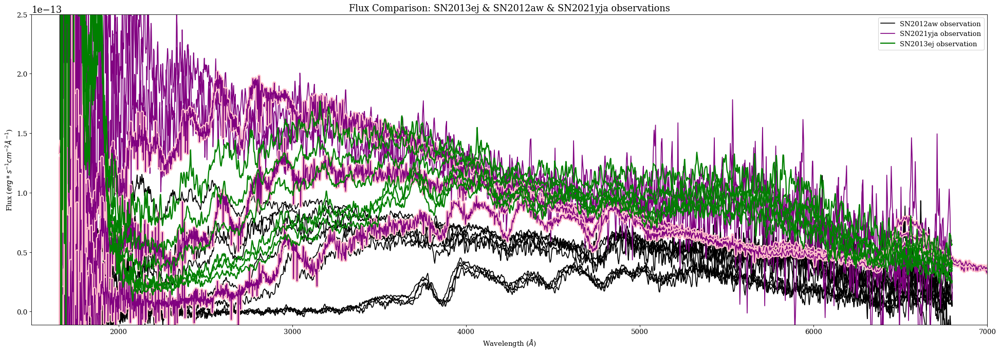

In [112]:
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Flux Comparison: SN2013ej & SN2012aw & SN2021yja observations',fontsize=font)
plt.plot(SN12aw_5_wave_o,SN12aw_5_flux_o,linewidth=1.5,c='black')
plt.plot(SN12aw_7_wave_o,SN12aw_7_flux_o,linewidth=1.5,c='black')
plt.plot(SN12aw_9_wave_o,SN12aw_9_flux_o,linewidth=1.5,c='black')
plt.plot(SN12aw_12_wave_o,SN12aw_12_flux_o,linewidth=1.5,c='black')
plt.plot(SN12aw_14_wave_o,SN12aw_14_flux_o,linewidth=1.5,c='black')
plt.plot(SN12aw_16_wave_o,SN12aw_16_flux_o,linewidth=1.5,c='black')
plt.plot(SN12aw_42_wave_o,SN12aw_42_flux_o,linewidth=1.5,c='black')
plt.plot(SN12aw_43_wave_o,SN12aw_43_flux_o,linewidth=1.5,c='black')
plt.plot(SN12aw_45_wave_o,SN12aw_45_flux_o,linewidth=1.5,c='black')
plt.plot(SN12aw_46_wave_o,SN12aw_46_flux_o,linewidth=1.5,c='black',label='SN2012aw observation')
plt.plot(SN21yja_5_wave_o,SN21yja_5_flux_o*10,linewidth=1.5,c='purple')
plt.plot(SN21yja_6_wave_o,SN21yja_6_flux_o*10,linewidth=1.5,c='purple')
plt.plot(SN21yja_7_wave_o,SN21yja_7_flux_o*10,linewidth=1.5,c='purple')
plt.plot(SN21yja_9_wave_o,SN21yja_9_flux_o*10,linewidth=6,c='pink')
plt.plot(SN21yja_9_wave_o,SN21yja_9_flux_o*10,linewidth=1.5,c='purple')
plt.plot(SN21yja_14_wave_o,SN21yja_14_flux_o*10,linewidth=6,c='pink')
plt.plot(SN21yja_14_wave_o,SN21yja_14_flux_o*10,linewidth=1.5,c='purple')
plt.plot(SN21yja_21_wave_o,SN21yja_21_flux_o*10,linewidth=6,c='pink')
plt.plot(SN21yja_21_wave_o,SN21yja_21_flux_o*10,linewidth=1.5,c='purple',label='SN2021yja observation')
plt.plot(SN13ej_7_wave_o,SN13ej_7_flux_o,linewidth=2,c='green')
plt.plot(SN13ej_9_wave_o,SN13ej_9_flux_o,linewidth=2,c='green')
plt.plot(SN13ej_11_wave_o,SN13ej_11_flux_o,linewidth=2,c='green')
plt.plot(SN13ej_14_wave_o,SN13ej_14_flux_o,linewidth=2,c='green')
plt.plot(SN13ej_15_wave_o,SN13ej_15_flux_o,linewidth=2,c='green')
plt.plot(SN13ej_16_wave_o,SN13ej_16_flux_o,linewidth=2,c='green',label='SN2013ej observation')
plt.legend(loc=1,fontsize=font1)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(1500,7000)
plt.ylim(-0.000000000000011,0.00000000000025)
plt.savefig("observations_paperplot.png")
plt.show()

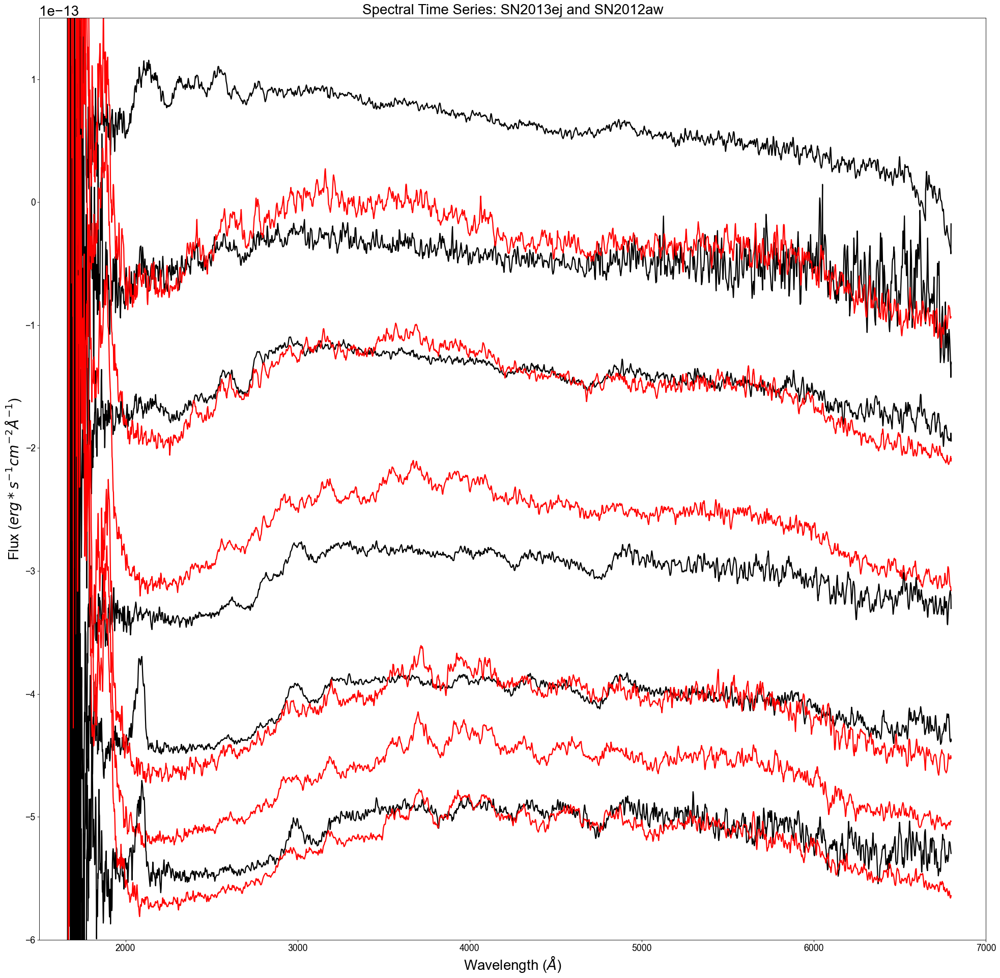

In [16]:
# every -0.00000000000005 is 1 day for 12aw and I am matching flux level for 13ej as best as possible from there (subtract additional 0.00000000000005 it seems)
# excluding last four days of 12aw for now for ease of view
fig = plt.figure(figsize=(30, 30), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: SN2013ej and SN2012aw',fontsize=font)
plt.plot(SN12aw_5_wave_o,SN12aw_5_flux_o,linewidth=2,c='black')
plt.plot(SN12aw_7_wave_o,SN12aw_7_flux_o-0.00000000000010,linewidth=2,c='black')
plt.plot(SN13ej_7_wave_o,SN13ej_7_flux_o-0.00000000000015,linewidth=2,c='red')
plt.plot(SN12aw_9_wave_o,SN12aw_9_flux_o-0.00000000000020,linewidth=2,c='black')
plt.plot(SN13ej_9_wave_o,SN13ej_9_flux_o-0.00000000000025,linewidth=2,c='red')
plt.plot(SN13ej_11_wave_o,SN13ej_11_flux_o-0.00000000000035,linewidth=2,c='red')
plt.plot(SN12aw_12_wave_o,SN12aw_12_flux_o-0.00000000000035,linewidth=2,c='black')
plt.plot(SN12aw_14_wave_o,SN12aw_14_flux_o-0.00000000000045,linewidth=2,c='black')
plt.plot(SN13ej_14_wave_o,SN13ej_14_flux_o-0.00000000000049,linewidth=2,c='red')
plt.plot(SN13ej_15_wave_o,SN13ej_15_flux_o-0.00000000000054,linewidth=2,c='red')
plt.plot(SN12aw_16_wave_o,SN12aw_16_flux_o-0.00000000000055,linewidth=2,c='black')
plt.plot(SN13ej_16_wave_o,SN13ej_16_flux_o-0.00000000000059,linewidth=2,c='red')
#plt.plot(SN12aw_42_wave_o,SN12aw_42_flux_o-0.0000000000037,linewidth=2,c='black')
#plt.plot(SN12aw_43_wave_o,SN12aw_43_flux_o-0.0000000000038,linewidth=2,c='black')
#plt.plot(SN12aw_45_wave_o,SN12aw_45_flux_o-0.0000000000040,linewidth=2,c='black')
#plt.plot(SN12aw_46_wave_o,SN12aw_46_flux_o-0.0000000000041,linewidth=2,c='black')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,7000)
plt.ylim(-0.0000000000006,0.00000000000015)
plt.show()

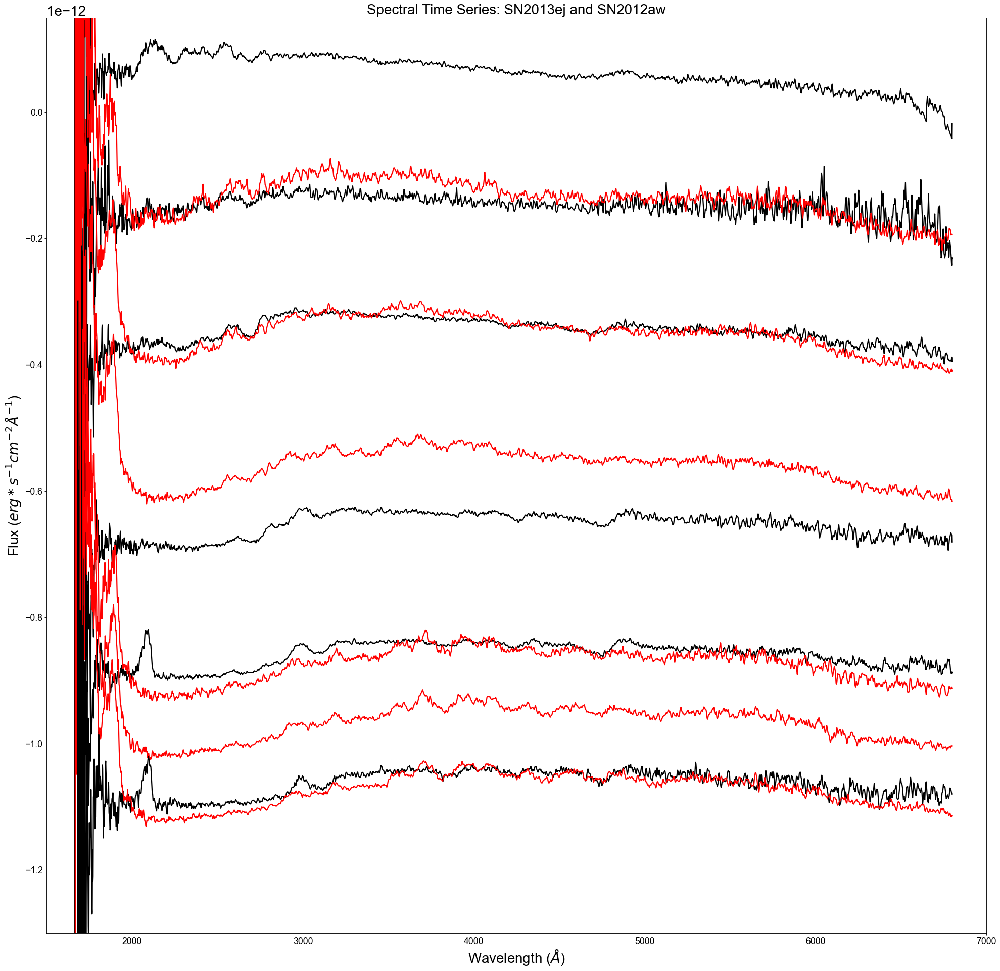

In [17]:
# every -0.00000000000010 is 1 day for 12aw and I am matching flux level for 13ej as best as possible from there (subtract additional 0.00000000000005 it seems)
# excluding last four days of 12aw for now for ease of view
fig = plt.figure(figsize=(30, 30), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: SN2013ej and SN2012aw',fontsize=font)
plt.plot(SN12aw_5_wave_o,SN12aw_5_flux_o,linewidth=2,c='black')
plt.plot(SN12aw_7_wave_o,SN12aw_7_flux_o-0.00000000000020,linewidth=2,c='black')
plt.plot(SN13ej_7_wave_o,SN13ej_7_flux_o-0.00000000000025,linewidth=2,c='red')
plt.plot(SN12aw_9_wave_o,SN12aw_9_flux_o-0.00000000000040,linewidth=2,c='black')
plt.plot(SN13ej_9_wave_o,SN13ej_9_flux_o-0.00000000000045,linewidth=2,c='red')
plt.plot(SN13ej_11_wave_o,SN13ej_11_flux_o-0.00000000000065,linewidth=2,c='red')
plt.plot(SN12aw_12_wave_o,SN12aw_12_flux_o-0.00000000000070,linewidth=2,c='black')
plt.plot(SN12aw_14_wave_o,SN12aw_14_flux_o-0.00000000000090,linewidth=2,c='black')
plt.plot(SN13ej_14_wave_o,SN13ej_14_flux_o-0.00000000000095,linewidth=2,c='red')
plt.plot(SN13ej_15_wave_o,SN13ej_15_flux_o-0.00000000000104,linewidth=2,c='red')
plt.plot(SN12aw_16_wave_o,SN12aw_16_flux_o-0.00000000000110,linewidth=2,c='black')
plt.plot(SN13ej_16_wave_o,SN13ej_16_flux_o-0.00000000000114,linewidth=2,c='red')
#plt.plot(SN12aw_42_wave_o,SN12aw_42_flux_o-0.0000000000037,linewidth=2,c='black')
#plt.plot(SN12aw_43_wave_o,SN12aw_43_flux_o-0.0000000000038,linewidth=2,c='black')
#plt.plot(SN12aw_45_wave_o,SN12aw_45_flux_o-0.0000000000040,linewidth=2,c='black')
#plt.plot(SN12aw_46_wave_o,SN12aw_46_flux_o-0.0000000000041,linewidth=2,c='black')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,7000)
plt.ylim(-0.0000000000013,0.00000000000015)
plt.show()

# <a id='16'>Time Series</a> 
[Table of Contents](#0)

## <a id='16a'>Figure 44: Time Series Plot</a> 
[Table of Contents](#0)

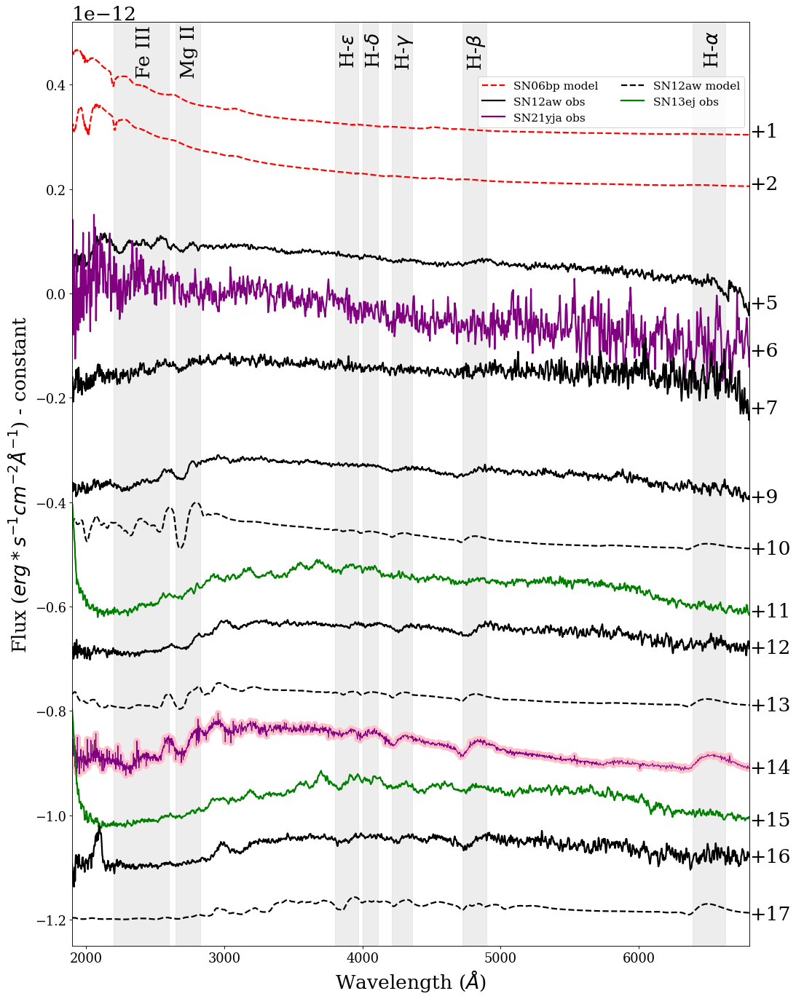

In [183]:
# every -0.00000000000010 (want -0.00000000000005) is 1 day for 12aw and I am matching flux level for 13ej as best as possible from there (subtract additional 0.00000000000005 it seems)
# excluding last four days of 12aw for ease of view
fig = plt.figure(figsize=(15, 21), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('Early UV Spectral Time Series: 12aw & 06bp Dessart Model vs. 13ej & 12aw & 21yja',fontsize=font)
plt.plot(SN06bp_1half_wave_m,(0.00000001*SN06bp_1half_flux_m)+0.00000000000030,linewidth=2,linestyle='--',c='red',label='SN06bp model')
plt.plot(SN06bp_2half_wave_m,(0.00000001*SN06bp_2half_flux_m)+0.00000000000020,linewidth=2,linestyle='--',c='red')
plt.plot(SN12aw_5_wave_o,SN12aw_5_flux_o,linewidth=2,c='black',label='SN12aw obs')
#plt.plot(SN21yja_5_wave_o,(SN21yja_5_flux_o*10)-0.00000000000005,linewidth=2,c='purple')
plt.plot(SN21yja_6_wave_o,(SN21yja_6_flux_o*10)-0.00000000000015,linewidth=2,c='purple',label='SN21yja obs')
#plt.plot(SN06bp_7half_wave_m,(0.00000001*SN06bp_7half_flux_m)-0.00000000000020,linewidth=2,linestyle='--',c='red')
plt.plot(SN12aw_7_wave_o,SN12aw_7_flux_o-0.00000000000020,linewidth=2,c='black')
#plt.plot(SN13ej_7_wave_o,SN13ej_7_flux_o-0.00000000000025,linewidth=2,c='green')
#plt.plot(SN21yja_7_wave_o,(SN21yja_7_flux_o*10)-0.00000000000025,linewidth=2,c='purple')
#plt.plot(SN06bp_9half_wave_m,(0.00000001*SN06bp_9half_flux_m)-0.00000000000040,linewidth=2,linestyle='--',c='red')
plt.plot(SN12aw_9_wave_o,SN12aw_9_flux_o-0.00000000000040,linewidth=2,c='black')
#plt.plot(SN13ej_9_wave_o,SN13ej_9_flux_o-0.00000000000045,linewidth=2,c='green')
#plt.plot(SN21yja_9_wave_o,(SN21yja_9_flux_o*10)-0.00000000000045,linewidth=2,c='purple')
plt.plot(SN12aw_10_wave_m,(0.00000001*SN12aw_10_flux_m)-0.00000000000050,linewidth=2,linestyle='--',c='black',label='SN12aw model')
#plt.plot(SN06bp_11_wave_m,(0.00000001*SN06bp_11_flux_m)-0.00000000000060,linewidth=2,linestyle='--',c='red')
#plt.plot(SN12aw_11_wave_m,(0.00000001*SN12aw_11_flux_m)-0.00000000000060,linewidth=2,linestyle='--',c='black')
plt.plot(SN13ej_11_wave_o,SN13ej_11_flux_o-0.00000000000065,linewidth=2,c='green',label='SN13ej obs')
#plt.plot(SN12aw_12_wave_m,(0.00000001*SN12aw_12_flux_m)-0.00000000000070,linewidth=2,linestyle='--',c='black')
plt.plot(SN12aw_12_wave_o,SN12aw_12_flux_o-0.00000000000070,linewidth=2,c='black')
plt.plot(SN12aw_13_wave_m,(0.00000001*SN12aw_13_flux_m)-0.00000000000080,linewidth=2,linestyle='--',c='black')
#plt.plot(SN06bp_14half_wave_m,(0.00000001*SN06bp_14half_flux_m)-0.00000000000090,linewidth=2,linestyle='--',c='red')
#plt.plot(SN12aw_14_wave_m,(0.00000001*SN12aw_14_flux_m)-0.00000000000090,linewidth=2,linestyle='--',c='black')
#plt.plot(SN12aw_14_wave_o,SN12aw_14_flux_o-0.00000000000090,linewidth=2,c='black')
#plt.plot(SN13ej_14_wave_o,SN13ej_14_flux_o-0.00000000000095,linewidth=2,c='green')
plt.plot(SN21yja_14_wave_o,(SN21yja_14_flux_o*10)-0.00000000000095,linewidth=8,c='pink')
plt.plot(SN21yja_14_wave_o,(SN21yja_14_flux_o*10)-0.00000000000095,linewidth=1,c='purple')
#plt.plot(SN06bp_15half_wave_m,(0.00000001*SN06bp_15half_flux_m)-0.00000000000100,linewidth=2,linestyle='--',c='red')
plt.plot(SN13ej_15_wave_o,SN13ej_15_flux_o-0.00000000000104,linewidth=2,c='green')
#plt.plot(SN12aw_16_wave_m,(0.00000001*SN12aw_16_flux_m)-0.00000000000110,linewidth=2,linestyle='--',c='black')
plt.plot(SN12aw_16_wave_o,SN12aw_16_flux_o-0.00000000000110,linewidth=2,c='black')
#plt.plot(SN13ej_16_wave_o,SN13ej_16_flux_o-0.00000000000114,linewidth=2,c='green')
plt.plot(SN12aw_17_wave_m,(0.00000001*SN12aw_17_flux_m)-0.00000000000120,linewidth=2,linestyle='--',c='black')
#plt.plot(SN21yja_21_wave_o,(SN21yja_21_flux_o*10)-0.00000000000165,linewidth=2,c='purple')
plt.legend(bbox_to_anchor=(0.59, 0.88),fontsize=14,ncol=2,labelcolor='black')
# plotting epoch labels
plt.text(6800,0.0000000000003,'+1',fontsize=font)
plt.text(6800,0.0000000000002,'+2',fontsize=font)
plt.text(6800,-0.00000000000003,'+5',fontsize=font)
plt.text(6800,-0.00000000000012,'+6',fontsize=font)
plt.text(6800,-0.00000000000023,'+7',fontsize=font)
plt.text(6800,-0.0000000000004,'+9',fontsize=font)
plt.text(6800,-0.0000000000005,'+10',fontsize=font)
plt.text(6800,-0.00000000000062,'+11',fontsize=font)
plt.text(6800,-0.00000000000069,'+12',fontsize=font)
plt.text(6800,-0.0000000000008,'+13',fontsize=font)
plt.text(6800,-0.00000000000092,'+14',fontsize=font)
plt.text(6800,-0.00000000000102,'+15',fontsize=font)
plt.text(6800,-0.00000000000109,'+16',fontsize=font)
plt.text(6800,-0.0000000000012,'+17',fontsize=font)
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2360,0.00000000000042,'Fe III',fontsize=font1,rotation='vertical')
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2680,0.00000000000042,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3835,0.00000000000044,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4015,0.00000000000044,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4230,0.00000000000044,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4745,0.00000000000044,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
# H-alpha
plt.axvspan(6390, 6625, alpha=0.5, color='gainsboro')
plt.text(6465,0.00000000000044,"H-" r'$\alpha$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1900,6800)
plt.ylim(-0.00000000000125,0.00000000000052)
plt.savefig("timeseries_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

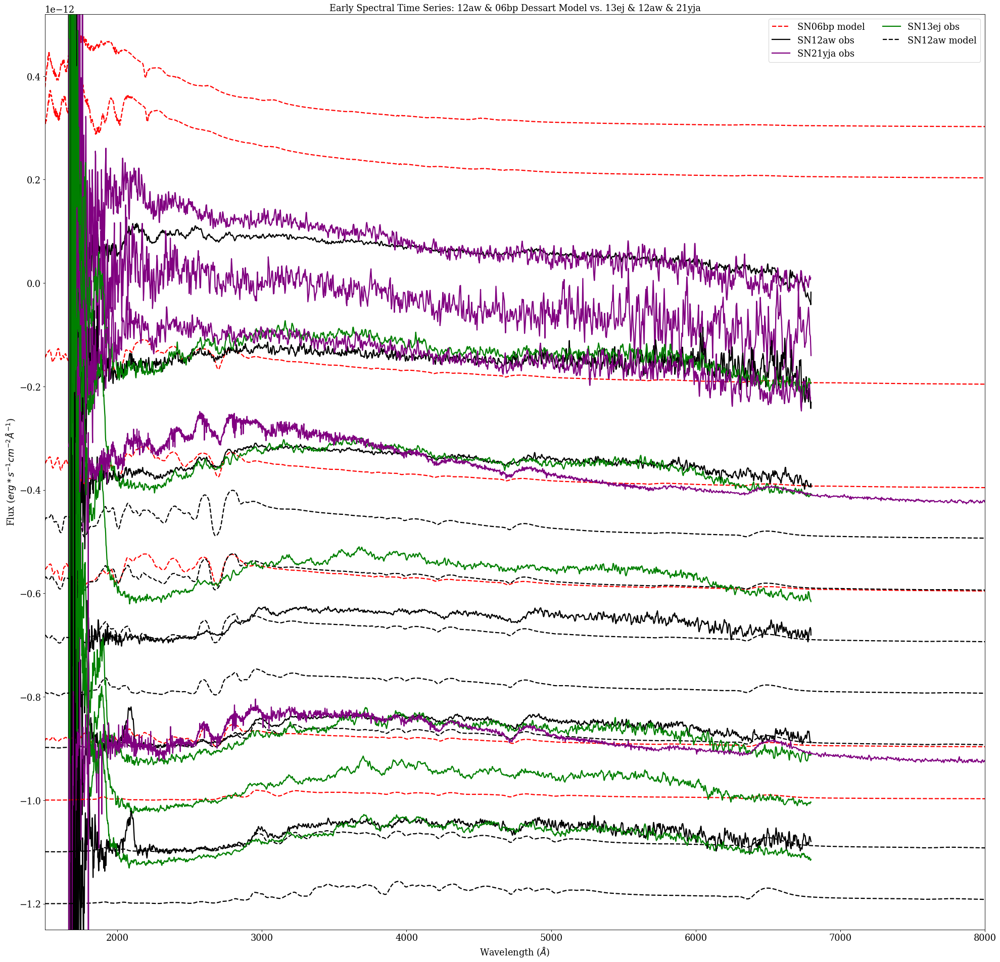

In [92]:
# every -0.00000000000010 (want -0.00000000000005) is 1 day for 12aw and I am matching flux level for 13ej as best as possible from there (subtract additional 0.00000000000005 it seems)
# excluding last four days of 12aw for ease of view
fig = plt.figure(figsize=(30, 30), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Early Spectral Time Series: 12aw & 06bp Dessart Model vs. 13ej & 12aw & 21yja',fontsize=font)
plt.plot(SN06bp_1half_wave_m,(0.00000001*SN06bp_1half_flux_m)+0.00000000000030,linewidth=2,linestyle='--',c='red',label='SN06bp model')
plt.plot(SN06bp_2half_wave_m,(0.00000001*SN06bp_2half_flux_m)+0.00000000000020,linewidth=2,linestyle='--',c='red')
plt.plot(SN12aw_5_wave_o,SN12aw_5_flux_o,linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN21yja_5_wave_o,(SN21yja_5_flux_o*10)-0.00000000000005,linewidth=2,c='purple',label='SN21yja obs')
plt.plot(SN21yja_6_wave_o,(SN21yja_6_flux_o*10)-0.00000000000015,linewidth=2,c='purple')
plt.plot(SN06bp_7half_wave_m,(0.00000001*SN06bp_7half_flux_m)-0.00000000000020,linewidth=2,linestyle='--',c='red')
plt.plot(SN12aw_7_wave_o,SN12aw_7_flux_o-0.00000000000020,linewidth=2,c='black')
plt.plot(SN13ej_7_wave_o,SN13ej_7_flux_o-0.00000000000025,linewidth=2,c='green',label='SN13ej obs')
plt.plot(SN21yja_7_wave_o,(SN21yja_7_flux_o*10)-0.00000000000025,linewidth=2,c='purple')
plt.plot(SN06bp_9half_wave_m,(0.00000001*SN06bp_9half_flux_m)-0.00000000000040,linewidth=2,linestyle='--',c='red')
plt.plot(SN12aw_9_wave_o,SN12aw_9_flux_o-0.00000000000040,linewidth=2,c='black')
plt.plot(SN13ej_9_wave_o,SN13ej_9_flux_o-0.00000000000045,linewidth=2,c='green')
plt.plot(SN21yja_9_wave_o,(SN21yja_9_flux_o*10)-0.00000000000045,linewidth=2,c='purple')
plt.plot(SN12aw_10_wave_m,(0.00000001*SN12aw_10_flux_m)-0.00000000000050,linewidth=2,linestyle='--',c='black',label='SN12aw model')
plt.plot(SN06bp_11_wave_m,(0.00000001*SN06bp_11_flux_m)-0.00000000000060,linewidth=2,linestyle='--',c='red')
plt.plot(SN12aw_11_wave_m,(0.00000001*SN12aw_11_flux_m)-0.00000000000060,linewidth=2,linestyle='--',c='black')
plt.plot(SN13ej_11_wave_o,SN13ej_11_flux_o-0.00000000000065,linewidth=2,c='green')
plt.plot(SN12aw_12_wave_m,(0.00000001*SN12aw_12_flux_m)-0.00000000000070,linewidth=2,linestyle='--',c='black')
plt.plot(SN12aw_12_wave_o,SN12aw_12_flux_o-0.00000000000070,linewidth=2,c='black')
plt.plot(SN12aw_13_wave_m,(0.00000001*SN12aw_13_flux_m)-0.00000000000080,linewidth=2,linestyle='--',c='black')
plt.plot(SN06bp_14half_wave_m,(0.00000001*SN06bp_14half_flux_m)-0.00000000000090,linewidth=2,linestyle='--',c='red')
plt.plot(SN12aw_14_wave_m,(0.00000001*SN12aw_14_flux_m)-0.00000000000090,linewidth=2,linestyle='--',c='black')
plt.plot(SN12aw_14_wave_o,SN12aw_14_flux_o-0.00000000000090,linewidth=2,c='black')
plt.plot(SN13ej_14_wave_o,SN13ej_14_flux_o-0.00000000000095,linewidth=2,c='green')
plt.plot(SN21yja_14_wave_o,(SN21yja_14_flux_o*10)-0.00000000000095,linewidth=2,c='purple')
plt.plot(SN06bp_15half_wave_m,(0.00000001*SN06bp_15half_flux_m)-0.00000000000100,linewidth=2,linestyle='--',c='red')
plt.plot(SN13ej_15_wave_o,SN13ej_15_flux_o-0.00000000000104,linewidth=2,c='green')
plt.plot(SN12aw_16_wave_m,(0.00000001*SN12aw_16_flux_m)-0.00000000000110,linewidth=2,linestyle='--',c='black')
plt.plot(SN12aw_16_wave_o,SN12aw_16_flux_o-0.00000000000110,linewidth=2,c='black')
plt.plot(SN13ej_16_wave_o,SN13ej_16_flux_o-0.00000000000114,linewidth=2,c='green')
plt.plot(SN12aw_17_wave_m,(0.00000001*SN12aw_17_flux_m)-0.00000000000120,linewidth=2,linestyle='--',c='black')
plt.plot(SN21yja_21_wave_o,(SN21yja_21_flux_o*10)-0.00000000000165,linewidth=2,c='purple')
plt.legend(loc=1,fontsize=font,ncol=2,labelcolor='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.00000000000125,0.00000000000052)
#plt.savefig("timeseries_paperplot.png",dpi=300)
plt.show()

# <a id='18'>Figure 1: Contamination</a> 
[Table of Contents](#0)

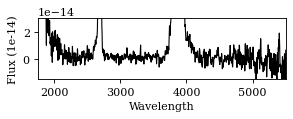

In [51]:
fontfig1 = 10
#plt.rcParams.update({'font.size': fontfig1})
fig=plt.figure(figsize=(4, 1), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2006bp Spectra: 0th Order Starlight Contamination')
plt.plot(SN06bp_10_wave_o,SN06bp_10_flux_o,linewidth=1,c='black')
plt.xlabel("Wavelength",fontsize=fontfig1)
plt.ylabel("Flux (1e-14)",fontsize=fontfig1)
plt.xticks(np.arange(1000, 7000, step=1000),fontsize=fontfig1)
plt.yticks(np.arange(0,0.00000000000003, step=0.00000000000002),fontsize=fontfig1) #,rotation=90
plt.xlim(1750,5500)
plt.ylim(-0.000000000000015,0.00000000000003)
plt.savefig("contamination1b_paperplot.png",dpi=300,bbox_inches='tight') # save as png
plt.show()

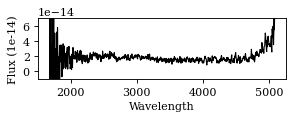

In [59]:
fig=plt.figure(figsize=(4, 1), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2017egm Spectra: Upturn Problem')
plt.plot(SN17egm_16_wave_o,SN17egm_16_flux_o,linewidth=1,c='black')
plt.xlabel("Wavelength",fontsize=fontfig1)
plt.ylabel("Flux (1e-14)",fontsize=fontfig1)
plt.xticks(np.arange(1000, 7000, step=1000),fontsize=fontfig1)
plt.yticks(np.arange(0,0.00000000000008, step=0.00000000000002),fontsize=fontfig1) #,rotation=90
plt.xlim(1500,5250)
plt.ylim(-0.00000000000001,0.00000000000007)
plt.xticks(fontsize=fontfig1)
plt.yticks(fontsize=fontfig1)
plt.savefig("contamination1d_paperplot.png",dpi=300,bbox_inches='tight') # save as png
plt.show()

# <a id='7'>Model vs. Observation</a> 
[Table of Contents](#0)

### <a id='7a'>Figure 42a: SN2005cs</a> 
[Table of Contents](#0)

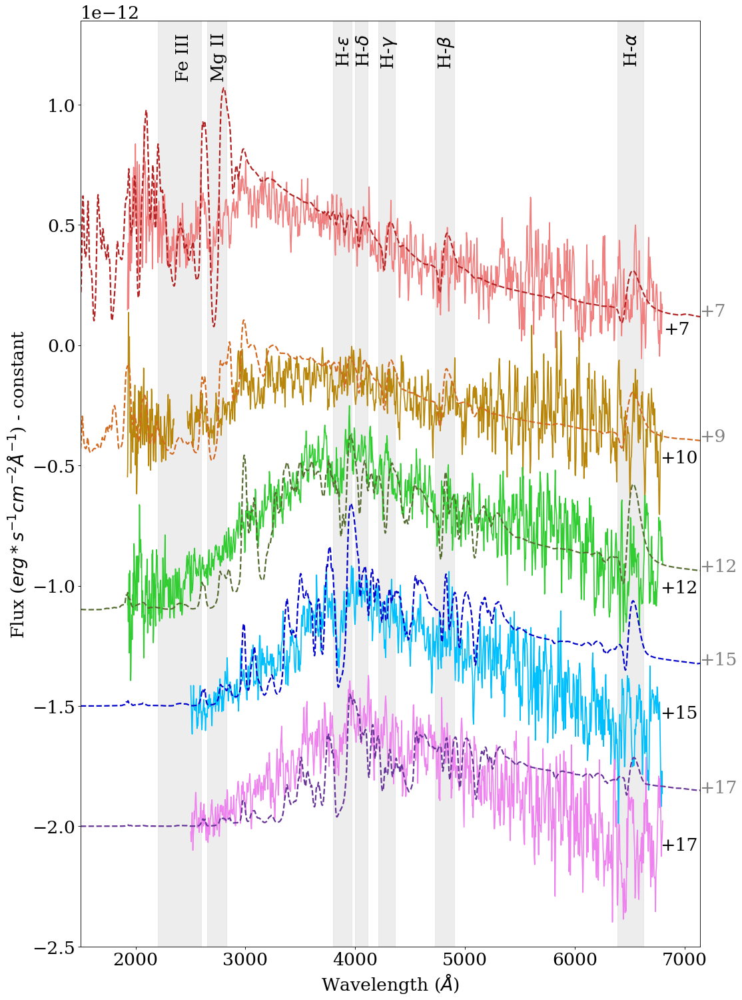

In [142]:
# SN2005cs w shaded features
fig=plt.figure(figsize=(15, 23), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2005cs Dessart Models vs Grism Spectra',fontsize=font)
# removing the zeroth order stellar feature
SN05cs_10_wave_ol = []
SN05cs_10_flux_ol = []
SN05cs_10_wave_oh = []
SN05cs_10_flux_oh = []
for i in range(len(SN05cs_10_wave_o)):
    if SN05cs_10_wave_o[i] < 2350:
        SN05cs_10_wave_ol.append(SN05cs_10_wave_o[i])
        SN05cs_10_flux_ol.append(SN05cs_10_flux_o[i])
    if SN05cs_10_wave_o[i] > 2470:
        SN05cs_10_wave_oh.append(SN05cs_10_wave_o[i])
        SN05cs_10_flux_oh.append(SN05cs_10_flux_o[i])
SN05cs_10_flux_ol = np.array(SN05cs_10_flux_ol)
SN05cs_10_flux_oh = np.array(SN05cs_10_flux_oh)
# removing the parts where the sensitivity is bad for days 7, 10, and 12
SN05cs_7_wave_oh = []
SN05cs_7_flux_oh = []
SN05cs_10_wave_oll = []
SN05cs_10_flux_oll = []
SN05cs_12_wave_oh = []
SN05cs_12_flux_oh = []
for i in range(len(SN05cs_7_wave_o)):
    if SN05cs_7_wave_o[i] > 1925:
        SN05cs_7_wave_oh.append(SN05cs_7_wave_o[i])
        SN05cs_7_flux_oh.append(SN05cs_7_flux_o[i])
SN05cs_7_wave_oh = np.array(SN05cs_7_wave_oh)
SN05cs_7_flux_oh = np.array(SN05cs_7_flux_oh)
for i in range(len(SN05cs_10_wave_ol)):
    if SN05cs_10_wave_ol[i] > 1925:
        SN05cs_10_wave_oll.append(SN05cs_10_wave_ol[i])
        SN05cs_10_flux_oll.append(SN05cs_10_flux_ol[i])
SN05cs_10_wave_oll = np.array(SN05cs_10_wave_oll)
SN05cs_10_flux_oll = np.array(SN05cs_10_flux_oll)
for i in range(len(SN05cs_12_wave_o)):
    if SN05cs_12_wave_o[i] > 1925:
        SN05cs_12_wave_oh.append(SN05cs_12_wave_o[i])
        SN05cs_12_flux_oh.append(SN05cs_12_flux_o[i])
SN05cs_12_wave_oh = np.array(SN05cs_12_wave_oh)
SN05cs_12_flux_oh = np.array(SN05cs_12_flux_oh)
# removing the parts where it starts to go negative for days 15 and 17
SN05cs_15_wave_oh = []
SN05cs_15_flux_oh = []
SN05cs_17_wave_oh = []
SN05cs_17_flux_oh = []
for i in range(len(SN05cs_15_wave_o)):
    if SN05cs_15_wave_o[i] > 2500:
        SN05cs_15_wave_oh.append(SN05cs_15_wave_o[i])
        SN05cs_15_flux_oh.append(SN05cs_15_flux_o[i])
SN05cs_15_wave_oh = np.array(SN05cs_15_wave_oh)
SN05cs_15_flux_oh = np.array(SN05cs_15_flux_oh)
for i in range(len(SN05cs_17_wave_o)):
    if SN05cs_17_wave_o[i] > 2500:
        SN05cs_17_wave_oh.append(SN05cs_17_wave_o[i])
        SN05cs_17_flux_oh.append(SN05cs_17_flux_o[i])
SN05cs_17_wave_oh = np.array(SN05cs_17_wave_oh)
SN05cs_17_flux_oh = np.array(SN05cs_17_flux_oh)
# observations
plt.plot(SN05cs_7_wave_oh,SN05cs_7_flux_oh,label='7 days after explosion',linewidth=1.5,c='lightcoral')
plt.plot(SN05cs_10_wave_oll,SN05cs_10_flux_oll-0.0000000000005,label='10 days after explosion',linewidth=1.5,c='darkgoldenrod')
plt.plot(SN05cs_10_wave_oh,SN05cs_10_flux_oh-0.0000000000005,linewidth=1.5,c='darkgoldenrod')
plt.plot(SN05cs_12_wave_oh,SN05cs_12_flux_oh-0.0000000000011,label='12 days after explosion',linewidth=1.5,c='limegreen')
plt.plot(SN05cs_15_wave_oh,SN05cs_15_flux_oh-0.0000000000017,label='15 days after explosion',linewidth=1.5,c='deepskyblue')
plt.plot(SN05cs_17_wave_oh,SN05cs_17_flux_oh-0.0000000000022,label='17 days after explosion',linewidth=1.5,c='violet')
# models
plt.plot(SN05cs_7_wave_m,SN05cs_7_flux_m*6*10**(-7),label='7 days after explosion',linewidth=2,linestyle='dashed',c='firebrick')
plt.plot(SN05cs_9_wave_m,SN05cs_9_flux_m*6*10**(-7)-0.0000000000005,label='9 days after explosion',linewidth=2,linestyle='dashed',c='chocolate')
plt.plot(SN05cs_12_wave_m,SN05cs_12_flux_m*6*10**(-7)-0.0000000000011,label='12 days after explosion',linewidth=2,linestyle='dashed',c='darkolivegreen')
plt.plot(SN05cs_15_wave_m,SN05cs_15_flux_m*6*10**(-7)-0.0000000000015,label='15 days after explosion',linewidth=2,linestyle='dashed',c='mediumblue')
plt.plot(SN05cs_17_wave_m,SN05cs_17_flux_m*6*10**(-7)-0.0000000000020,label='17 days after explosion',linewidth=2,linestyle='dashed',c='rebeccapurple')
#plt.legend(loc=4,fontsize=font,ncol=2)
# plotting epoch labels
plt.text(6807,0.000000000000045,'+7',fontsize=font)
plt.text(6775,-0.00000000000049,'+10',fontsize=font)
plt.text(6775,-0.00000000000103,'+12',fontsize=font)
plt.text(6775,-0.00000000000155,'+15',fontsize=font)
plt.text(6775,-0.00000000000210,'+17',fontsize=font)
plt.text(7135,0.00000000000012,'+7',fontsize=font,color='grey')
plt.text(7135,-0.0000000000004,'+9',fontsize=font,color='grey')
plt.text(7135,-0.00000000000094,'+12',fontsize=font,color='grey')
plt.text(7135,-0.00000000000133,'+15',fontsize=font,color='grey')
plt.text(7135,-0.00000000000186,'+17',fontsize=font,color='grey')
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2360,0.00000000000111,'Fe III',fontsize=font1,rotation='vertical')
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2680,0.00000000000111,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3825,0.00000000000117,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4005,0.00000000000117,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4220,0.00000000000117,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4735,0.00000000000117,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
# H-alpha
plt.axvspan(6390, 6625, alpha=0.5, color='gainsboro')
plt.text(6445,0.00000000000117,"H-" r'$\alpha$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.ylim(-0.0000000000025,0.00000000000135)
plt.xlim(1500,7140)
plt.savefig("OM_SN2005cs_paperplot_new.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

#### Figure 2 Caption

Comparison of SN2005cs model from Dr. Luc Dessart and Swift observations. The last observational epoch is excluded because a model epoch was unavailable for comparison. Zeroth order contamination from another object is omitted in the observed yellow spectrum from 2350-2470 $Å$. Oversubtraction/bad sensitivity areas are cut off in the observed spectra in wavelengths less than 1925 $Å$ on days +7, +10, and +12 and in wavelengths less than 2500 $Å$ on days +15 and +17. 1e-12 is the y-axis scaling. The spectral epochs on the right are days from explosion with the observational epoch in black and the model epoch in grey. The spectra are offset for presentation purposes. We use the models to look for features in the observed spectra as labeled at the top and highlighted in the grey shaded regions. Observe the over-prediction of certain features like the Mg II line in the earliest epoch.

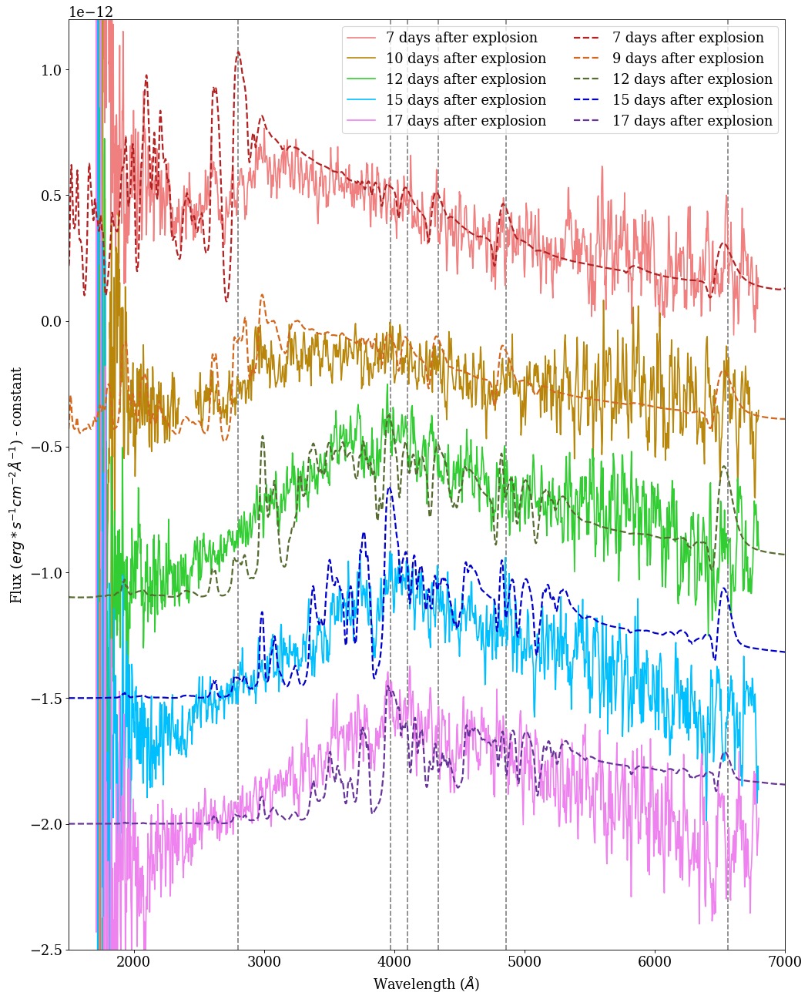

In [149]:
# SN2005cs w line features
fig=plt.figure(figsize=(15, 20), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2005cs Dessart Models vs Grism Spectra',fontsize=font)
# observations
plt.plot(SN05cs_7_wave_o,SN05cs_7_flux_o,label='7 days after explosion',linewidth=1.5,c='lightcoral')
# removing the zeroth order stellar feature
SN05cs_10_wave_ol = []
SN05cs_10_flux_ol = []
SN05cs_10_wave_oh = []
SN05cs_10_flux_oh = []
for i in range(len(SN05cs_10_wave_o)):
    if SN05cs_10_wave_o[i] < 2350:
        SN05cs_10_wave_ol.append(SN05cs_10_wave_o[i])
        SN05cs_10_flux_ol.append(SN05cs_10_flux_o[i])
    if SN05cs_10_wave_o[i] > 2470:
        SN05cs_10_wave_oh.append(SN05cs_10_wave_o[i])
        SN05cs_10_flux_oh.append(SN05cs_10_flux_o[i])
SN05cs_10_flux_ol = np.array(SN05cs_10_flux_ol)
SN05cs_10_flux_oh = np.array(SN05cs_10_flux_oh)
plt.plot(SN05cs_10_wave_ol,SN05cs_10_flux_ol-0.0000000000005,label='10 days after explosion',linewidth=1.5,c='darkgoldenrod')
plt.plot(SN05cs_10_wave_oh,SN05cs_10_flux_oh-0.0000000000005,linewidth=1.5,c='darkgoldenrod')
plt.plot(SN05cs_12_wave_o,SN05cs_12_flux_o-0.0000000000011,label='12 days after explosion',linewidth=1.5,c='limegreen')
plt.plot(SN05cs_15_wave_o,SN05cs_15_flux_o-0.0000000000017,label='15 days after explosion',linewidth=1.5,c='deepskyblue')
plt.plot(SN05cs_17_wave_o,SN05cs_17_flux_o-0.0000000000022,label='17 days after explosion',linewidth=1.5,c='violet')
# models
plt.plot(SN05cs_7_wave_m,SN05cs_7_flux_m*6*10**(-7),label='7 days after explosion',linewidth=2,linestyle='dashed',c='firebrick')
plt.plot(SN05cs_9_wave_m,SN05cs_9_flux_m*6*10**(-7)-0.0000000000005,label='9 days after explosion',linewidth=2,linestyle='dashed',c='chocolate')
plt.plot(SN05cs_12_wave_m,SN05cs_12_flux_m*6*10**(-7)-0.0000000000011,label='12 days after explosion',linewidth=2,linestyle='dashed',c='darkolivegreen')
plt.plot(SN05cs_15_wave_m,SN05cs_15_flux_m*6*10**(-7)-0.0000000000015,label='15 days after explosion',linewidth=2,linestyle='dashed',c='mediumblue')
plt.plot(SN05cs_17_wave_m,SN05cs_17_flux_m*6*10**(-7)-0.0000000000020,label='17 days after explosion',linewidth=2,linestyle='dashed',c='rebeccapurple')
plt.legend(loc=1,fontsize=font,ncol=2)
# plotting vertical lines for features
# want to point out the line blanketing from Fe III but can't do that well with the lines
# MgII, H-epsilon, H-delta, H-gamma, H-beta, H-alpha
lines = [2798,3970,4101,4340,4861,6562]
plt.vlines(lines,ymin=-0.0000000000025,ymax=0.0000000000012,colors='grey',linestyles='dashed')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.ylim(-0.0000000000025,0.0000000000012)
plt.xlim(1500,7000)
#plt.savefig("OM_SN2005cs_paperplot.png",dpi=300) # save as png
plt.show()

### <a id='7b'>SN2006bp</a> 
[Table of Contents](#0)

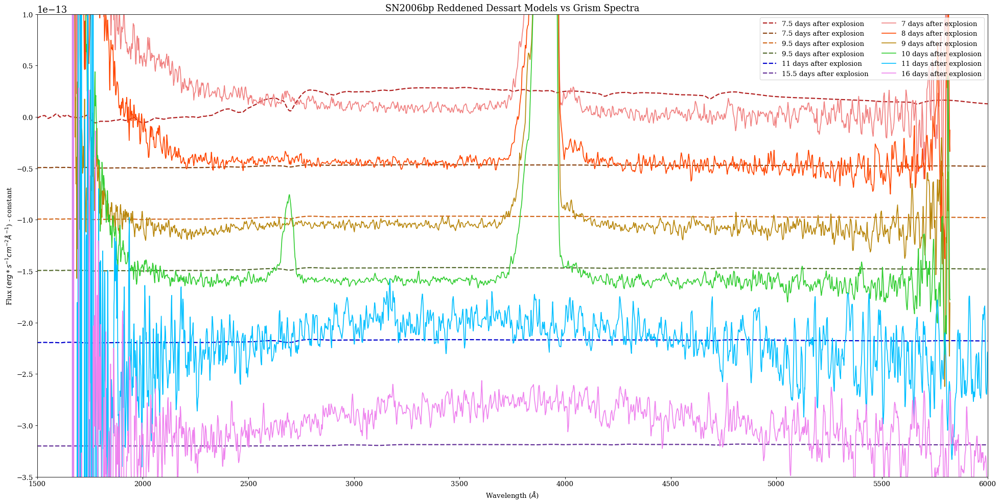

In [65]:
# SN2006bp
fig=plt.figure(figsize=(30, 15), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2006bp Reddened Dessart Models vs Grism Spectra',fontsize=font)
#plt.plot(SN06bp_2half_wave_mred,SN06bp_2half_flux_mred*2*10**(-8),label='2.5 days after explosion',linewidth=2,linestyle='dashed',c='black')
plt.plot(SN06bp_7half_wave_mred,SN06bp_7half_flux_mred*10-0.000000000000008,label='7.5 days after explosion',linewidth=2,linestyle='dashed',c='firebrick')
plt.plot(SN06bp_7half_wave_mred,SN06bp_7half_flux_mred-0.00000000000005,label='7.5 days after explosion',linewidth=2,linestyle='dashed',c='saddlebrown')
plt.plot(SN06bp_9half_wave_mred,SN06bp_9half_flux_mred-0.00000000000010,label='9.5 days after explosion',linewidth=2,linestyle='dashed',c='chocolate')
plt.plot(SN06bp_9half_wave_mred,SN06bp_9half_flux_mred-0.00000000000015,label='9.5 days after explosion',linewidth=2,linestyle='dashed',c='darkolivegreen')
plt.plot(SN06bp_11_wave_mred,SN06bp_11_flux_mred-0.00000000000022,label='11 days after explosion',linewidth=2,linestyle='dashed',c='mediumblue')
plt.plot(SN06bp_15half_wave_mred,SN06bp_15half_flux_mred-0.00000000000032,label='15.5 days after explosion',linewidth=2,linestyle='dashed',c='rebeccapurple')
#plt.plot(SN06bp_5_wave_o,SN06bp_5_flux_o,label='5 days after explosion',linewidth=1.5,c='grey')
plt.plot(SN06bp_7_wave_o,SN06bp_7_flux_o,label='7 days after explosion',linewidth=1.5,c='lightcoral')
plt.plot(SN06bp_8_wave_o,SN06bp_8_flux_o-0.00000000000005,label='8 days after explosion',linewidth=1.5,c='orangered')
plt.plot(SN06bp_9_wave_o,SN06bp_9_flux_o-0.00000000000011,label='9 days after explosion',linewidth=1.5,c='darkgoldenrod')
plt.plot(SN06bp_10_wave_o,SN06bp_10_flux_o-0.00000000000016,label='10 days after explosion',linewidth=1.5,c='limegreen')
plt.plot(SN06bp_11_wave_o,SN06bp_11_flux_o-0.00000000000024,label='11 days after explosion',linewidth=1.5,c='deepskyblue')
plt.plot(SN06bp_16_wave_o,SN06bp_16_flux_o-0.00000000000031,label='16 days after explosion',linewidth=1.5,c='violet')
plt.legend(loc=1,fontsize=font1,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.ylim(-0.00000000000035,0.0000000000001)
plt.xlim(1500,6000)
plt.savefig("OM_SN2006bp_paperplot.png",dpi=300) # save as png
plt.show()

### <a id='7c'>Figure 42b: SN2012aw</a> 
[Table of Contents](#0)

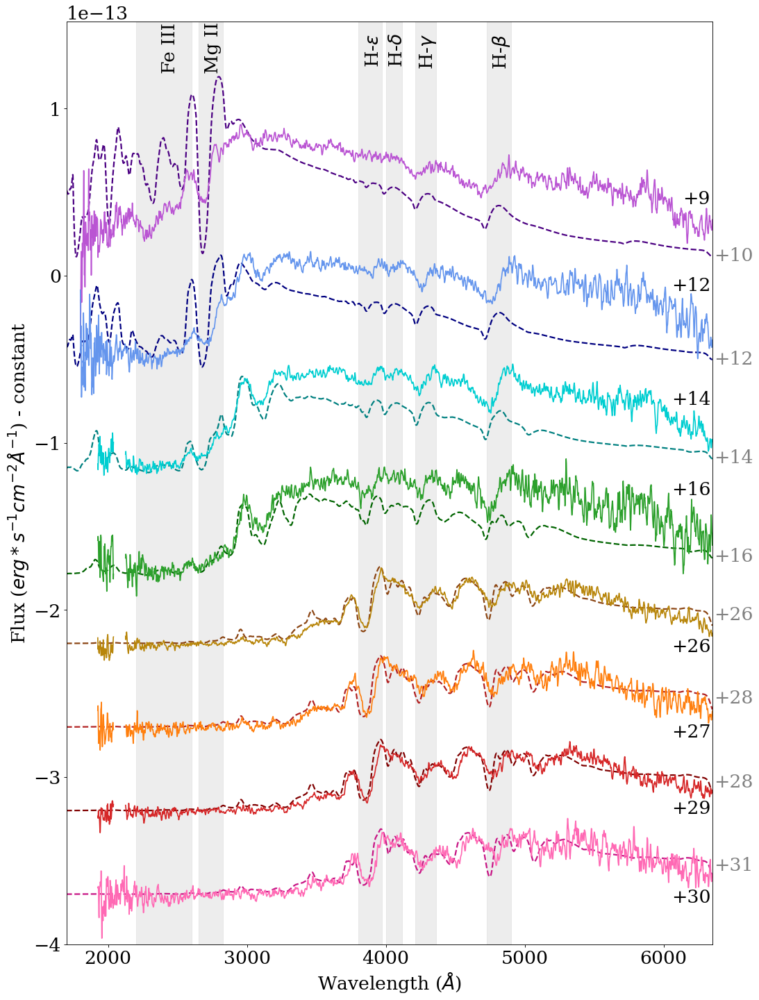

In [143]:
# SN2012aw w shaded features
fig=plt.figure(figsize=(15, 22), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2012aw Dessart Models vs Grism Spectra',fontsize=font)
# removing the zeroth order stellar feature for days 14, 16, 42, 43, and 45
SN12aw_14_wave_ol = []
SN12aw_14_flux_ol = []
SN12aw_14_wave_oh = []
SN12aw_14_flux_oh = []
for i in range(len(SN12aw_14_wave_o)):
    if SN12aw_14_wave_o[i] < 2040:
        SN12aw_14_wave_ol.append(SN12aw_14_wave_o[i])
        SN12aw_14_flux_ol.append(SN12aw_14_flux_o[i])
    if SN12aw_14_wave_o[i] > 2125:
        SN12aw_14_wave_oh.append(SN12aw_14_wave_o[i])
        SN12aw_14_flux_oh.append(SN12aw_14_flux_o[i])
SN12aw_14_wave_ol = np.array(SN12aw_14_wave_ol)
SN12aw_14_flux_ol = np.array(SN12aw_14_flux_ol)
SN12aw_14_wave_oh = np.array(SN12aw_14_wave_oh)
SN12aw_14_flux_oh = np.array(SN12aw_14_flux_oh)
SN12aw_16_wave_ol = []
SN12aw_16_flux_ol = []
SN12aw_16_wave_oh = []
SN12aw_16_flux_oh = []
for i in range(len(SN12aw_16_wave_o)):
    if SN12aw_16_wave_o[i] < 2040:
        SN12aw_16_wave_ol.append(SN12aw_16_wave_o[i])
        SN12aw_16_flux_ol.append(SN12aw_16_flux_o[i])
    if SN12aw_16_wave_o[i] > 2125:
        SN12aw_16_wave_oh.append(SN12aw_16_wave_o[i])
        SN12aw_16_flux_oh.append(SN12aw_16_flux_o[i])
SN12aw_16_wave_ol = np.array(SN12aw_16_wave_ol)
SN12aw_16_flux_ol = np.array(SN12aw_16_flux_ol)
SN12aw_16_wave_oh = np.array(SN12aw_16_wave_oh)
SN12aw_16_flux_oh = np.array(SN12aw_16_flux_oh)
SN12aw_42_wave_ol = []
SN12aw_42_flux_ol = []
SN12aw_42_wave_oh = []
SN12aw_42_flux_oh = []
for i in range(len(SN12aw_42_wave_o)):
    if SN12aw_42_wave_o[i] < 2040:
        SN12aw_42_wave_ol.append(SN12aw_42_wave_o[i])
        SN12aw_42_flux_ol.append(SN12aw_42_flux_o[i])
    if SN12aw_42_wave_o[i] > 2125:
        SN12aw_42_wave_oh.append(SN12aw_42_wave_o[i])
        SN12aw_42_flux_oh.append(SN12aw_42_flux_o[i])
SN12aw_42_wave_ol = np.array(SN12aw_42_wave_ol)
SN12aw_42_flux_ol = np.array(SN12aw_42_flux_ol)
SN12aw_42_wave_oh = np.array(SN12aw_42_wave_oh)
SN12aw_42_flux_oh = np.array(SN12aw_42_flux_oh)
SN12aw_43_wave_ol = []
SN12aw_43_flux_ol = []
SN12aw_43_wave_oh = []
SN12aw_43_flux_oh = []
for i in range(len(SN12aw_43_wave_o)):
    if SN12aw_43_wave_o[i] < 2040:
        SN12aw_43_wave_ol.append(SN12aw_43_wave_o[i])
        SN12aw_43_flux_ol.append(SN12aw_43_flux_o[i])
    if SN12aw_43_wave_o[i] > 2125:
        SN12aw_43_wave_oh.append(SN12aw_43_wave_o[i])
        SN12aw_43_flux_oh.append(SN12aw_43_flux_o[i])
SN12aw_43_wave_ol = np.array(SN12aw_43_wave_ol)
SN12aw_43_flux_ol = np.array(SN12aw_43_flux_ol)
SN12aw_43_wave_oh = np.array(SN12aw_43_wave_oh)
SN12aw_43_flux_oh = np.array(SN12aw_43_flux_oh)
SN12aw_45_wave_ol = []
SN12aw_45_flux_ol = []
SN12aw_45_wave_oh = []
SN12aw_45_flux_oh = []
for i in range(len(SN12aw_45_wave_o)):
    if SN12aw_45_wave_o[i] < 2040:
        SN12aw_45_wave_ol.append(SN12aw_45_wave_o[i])
        SN12aw_45_flux_ol.append(SN12aw_45_flux_o[i])
    if SN12aw_45_wave_o[i] > 2125:
        SN12aw_45_wave_oh.append(SN12aw_45_wave_o[i])
        SN12aw_45_flux_oh.append(SN12aw_45_flux_o[i])
SN12aw_45_wave_ol = np.array(SN12aw_45_wave_ol)
SN12aw_45_flux_ol = np.array(SN12aw_45_flux_ol)
SN12aw_45_wave_oh = np.array(SN12aw_45_wave_oh)
SN12aw_45_flux_oh = np.array(SN12aw_45_flux_oh)
# removing the parts where the sensitivity is bad for days 9, 12, 14, 16, 42, 43, 45, 46
SN12aw_9_wave_oh = []
SN12aw_9_flux_oh = []
SN12aw_12_wave_oh = []
SN12aw_12_flux_oh = []
SN12aw_14_wave_oll = []
SN12aw_14_flux_oll = []
SN12aw_16_wave_oll = []
SN12aw_16_flux_oll = []
SN12aw_42_wave_oll = []
SN12aw_42_flux_oll = []
SN12aw_43_wave_oll = []
SN12aw_43_flux_oll = []
SN12aw_45_wave_oll = []
SN12aw_45_flux_oll = []
SN12aw_46_wave_oh = []
SN12aw_46_flux_oh = []
for i in range(len(SN12aw_9_wave_o)):
    if SN12aw_9_wave_o[i] > 1800:
        SN12aw_9_wave_oh.append(SN12aw_9_wave_o[i])
        SN12aw_9_flux_oh.append(SN12aw_9_flux_o[i])
SN12aw_9_wave_oh = np.array(SN12aw_9_wave_oh)
SN12aw_9_flux_oh = np.array(SN12aw_9_flux_oh)
for i in range(len(SN12aw_12_wave_o)):
    if SN12aw_12_wave_o[i] > 1800:
        SN12aw_12_wave_oh.append(SN12aw_12_wave_o[i])
        SN12aw_12_flux_oh.append(SN12aw_12_flux_o[i])
SN12aw_12_wave_oh = np.array(SN12aw_12_wave_oh)
SN12aw_12_flux_oh = np.array(SN12aw_12_flux_oh)
for i in range(len(SN12aw_14_wave_ol)):
    if SN12aw_14_wave_ol[i] > 1925:
        SN12aw_14_wave_oll.append(SN12aw_14_wave_ol[i])
        SN12aw_14_flux_oll.append(SN12aw_14_flux_ol[i])
SN12aw_14_wave_oll = np.array(SN12aw_14_wave_oll)
SN12aw_14_flux_oll = np.array(SN12aw_14_flux_oll)
for i in range(len(SN12aw_16_wave_ol)):
    if SN12aw_16_wave_ol[i] > 1925:
        SN12aw_16_wave_oll.append(SN12aw_16_wave_ol[i])
        SN12aw_16_flux_oll.append(SN12aw_16_flux_ol[i])
SN12aw_16_wave_oll = np.array(SN12aw_16_wave_oll)
SN12aw_16_flux_oll = np.array(SN12aw_16_flux_oll)
for i in range(len(SN12aw_42_wave_ol)):
    if SN12aw_42_wave_ol[i] > 1925:
        SN12aw_42_wave_oll.append(SN12aw_42_wave_ol[i])
        SN12aw_42_flux_oll.append(SN12aw_42_flux_ol[i])
SN12aw_42_wave_oll = np.array(SN12aw_42_wave_oll)
SN12aw_42_flux_oll = np.array(SN12aw_42_flux_oll)
for i in range(len(SN12aw_43_wave_ol)):
    if SN12aw_43_wave_ol[i] > 1925:
        SN12aw_43_wave_oll.append(SN12aw_43_wave_ol[i])
        SN12aw_43_flux_oll.append(SN12aw_43_flux_ol[i])
SN12aw_43_wave_oll = np.array(SN12aw_43_wave_oll)
SN12aw_43_flux_oll = np.array(SN12aw_43_flux_oll)
for i in range(len(SN12aw_45_wave_ol)):
    if SN12aw_45_wave_ol[i] > 1925:
        SN12aw_45_wave_oll.append(SN12aw_45_wave_ol[i])
        SN12aw_45_flux_oll.append(SN12aw_45_flux_ol[i])
SN12aw_45_wave_oll = np.array(SN12aw_45_wave_oll)
SN12aw_45_flux_oll = np.array(SN12aw_45_flux_oll)
for i in range(len(SN12aw_46_wave_o)):
    if SN12aw_46_wave_o[i] > 1925:
        SN12aw_46_wave_oh.append(SN12aw_46_wave_o[i])
        SN12aw_46_flux_oh.append(SN12aw_46_flux_o[i])
SN12aw_46_wave_oh = np.array(SN12aw_46_wave_oh)
SN12aw_46_flux_oh = np.array(SN12aw_46_flux_oh)
# models
sn12aw_scalefactor = 0.000000012
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m*sn12aw_scalefactor,label='10 days after explosion',linewidth=2,linestyle='dashed',c='indigo')
plt.plot(SN12aw_12_wave_m,SN12aw_12_flux_m*sn12aw_scalefactor-0.00000000000006,label='12 days after explosion',linewidth=2,linestyle='dashed',c='navy')
plt.plot(SN12aw_14_wave_m,SN12aw_14_flux_m*sn12aw_scalefactor-0.00000000000012,label='14 days after explosion',linewidth=2,linestyle='dashed',c='teal')
plt.plot(SN12aw_16_wave_m,SN12aw_16_flux_m*sn12aw_scalefactor-0.00000000000018,label='16 days after explosion',linewidth=2,linestyle='dashed',c='darkgreen')
plt.plot(SN12aw_26_wave_m,SN12aw_26_flux_m*sn12aw_scalefactor-0.00000000000022,label='26 days after explosion',linewidth=2,linestyle='dashed',c='saddlebrown')
plt.plot(SN12aw_28_wave_m,SN12aw_28_flux_m*sn12aw_scalefactor-0.00000000000027,label='28 days after explosion',linewidth=2,linestyle='dashed',c='firebrick')
plt.plot(SN12aw_28_wave_m,SN12aw_28_flux_m*sn12aw_scalefactor-0.00000000000032,label='28 days after explosion',linewidth=2,linestyle='dashed',c='maroon')
plt.plot(SN12aw_31_wave_m,SN12aw_31_flux_m*sn12aw_scalefactor-0.00000000000037,label='31 days after explosion',linewidth=2,linestyle='dashed',c='mediumvioletred')
# observations
plt.plot(SN12aw_9_wave_oh,SN12aw_9_flux_oh,label='9 days after explosion',linewidth=1.5,c='mediumorchid')
plt.plot(SN12aw_12_wave_oh,SN12aw_12_flux_oh-0.00000000000006,label='12 days after explosion',linewidth=1.5,c='cornflowerblue')
plt.plot(SN12aw_14_wave_oll,SN12aw_14_flux_oll-0.00000000000012,label='14 days after explosion',linewidth=1.5,c='darkturquoise')
plt.plot(SN12aw_14_wave_oh,SN12aw_14_flux_oh-0.00000000000012,linewidth=1.5,c='darkturquoise')
plt.plot(SN12aw_16_wave_oll,SN12aw_16_flux_oll-0.00000000000018,label='16 days after explosion',linewidth=1.5,c='tab:green')
plt.plot(SN12aw_16_wave_oh,SN12aw_16_flux_oh-0.00000000000018,linewidth=1.5,c='tab:green')
plt.plot(SN12aw_42_wave_oll,SN12aw_42_flux_oll-0.00000000000022,label='26 days after explosion',linewidth=1.5,c='darkgoldenrod') # the label (26) is correct, I messed up when calculating the dates before
plt.plot(SN12aw_42_wave_oh,SN12aw_42_flux_oh-0.00000000000022,linewidth=1.5,c='darkgoldenrod')
plt.plot(SN12aw_43_wave_oll,SN12aw_43_flux_oll-0.00000000000027,label='27 days after explosion',linewidth=1.5,c='tab:orange')
plt.plot(SN12aw_43_wave_oh,SN12aw_43_flux_oh-0.00000000000027,linewidth=1.5,c='tab:orange')
plt.plot(SN12aw_45_wave_oll,SN12aw_45_flux_oll-0.00000000000032,label='29 days after explosion',linewidth=1.5,c='tab:red')
plt.plot(SN12aw_45_wave_oh,SN12aw_45_flux_oh-0.00000000000032,linewidth=1.5,c='tab:red')
plt.plot(SN12aw_46_wave_oh,SN12aw_46_flux_oh-0.00000000000037,label='30 days after explosion',linewidth=1.5,c='hotpink')
#plt.legend(loc=1,fontsize=font1,ncol=3)
# plotting epoch labels
plt.text(6140,0.000000000000043,'+9',fontsize=font)
plt.text(6060,-0.000000000000009,'+12',fontsize=font)
plt.text(6060,-0.000000000000077,'+14',fontsize=font)
plt.text(6060,-0.000000000000131,'+16',fontsize=font)
plt.text(6060,-0.000000000000225,'+26',fontsize=font)
plt.text(6060,-0.000000000000276,'+27',fontsize=font)
plt.text(6060,-0.000000000000322,'+29',fontsize=font)
plt.text(6060,-0.000000000000375,'+30',fontsize=font)
plt.text(6365,0.000000000000009,'+10',fontsize=font,color='grey')
plt.text(6365,-0.000000000000053,'+12',fontsize=font,color='grey')
plt.text(6365,-0.000000000000112,'+14',fontsize=font,color='grey')
plt.text(6365,-0.000000000000171,'+16',fontsize=font,color='grey')
plt.text(6365,-0.000000000000206,'+26',fontsize=font,color='grey')
plt.text(6365,-0.000000000000256,'+28',fontsize=font,color='grey')
plt.text(6365,-0.000000000000306,'+28',fontsize=font,color='grey')
plt.text(6365,-0.000000000000356,'+31',fontsize=font,color='grey')
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2380,0.000000000000123,'Fe III',fontsize=font1,rotation='vertical')
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2690,0.000000000000123,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3845,0.000000000000127,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4015,0.000000000000127,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4230,0.000000000000127,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4755,0.000000000000127,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(1700,6350)
plt.ylim(-0.00000000000040,0.000000000000152)
plt.savefig("OM_SN2012aw_paperplot_new.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### Figure 3 Caption

Comparison of SN2012aw model from Dr. Luc Dessart and Swift observations. The first 2 observational epochs (days +5 and +7) are excluded because a model epoch was unavailable for comparison. Zeroth order contamination from another object is omitted in the observed turquoise, green, gold, orange, and red spectra from 2040-2125 $Å$. Oversubtraction/bad sensitivity areas are cut off in the observed spectra in wavelengths less than 1800 $Å$ on days +9 and +12 and in wavelengths less than 1925 $Å$ on days +14, +16, +26, +27, +29, and +30. 1e-13 is the y-axis scaling. The spectral epochs on the right are days from explosion with the observational epoch in black and the model epoch in grey. The spectra are offset for presentation purposes. We use the models to look for features in the observed spectra as labeled at the top and highlighted in the grey shaded regions. Observe the over-prediction of certain features like the Mg II line in the earliest 3 epochs, as well as the overprediction of the overall UV flux in the first epoch.

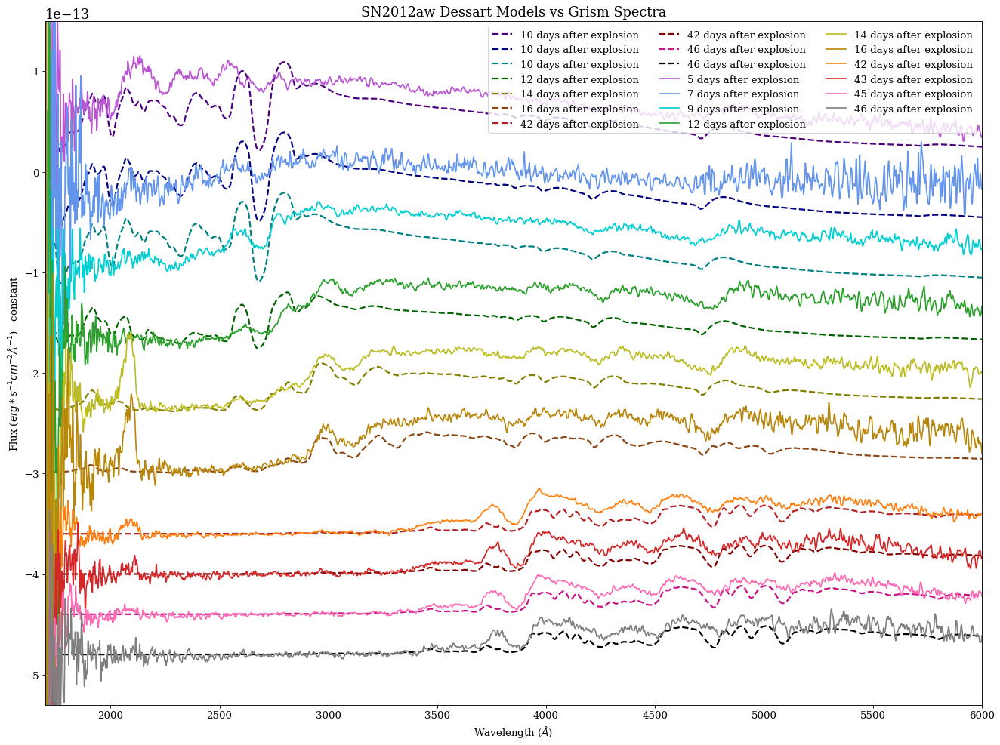

In [13]:
# SN2012aw
fig=plt.figure(figsize=(20, 15), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2012aw Dessart Models vs Grism Spectra',fontsize=font)
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m*0.00000001+0.00000000000001,label='10 days after explosion',linewidth=2,linestyle='dashed',c='indigo')
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m*0.00000001-0.00000000000006,label='10 days after explosion',linewidth=2,linestyle='dashed',c='navy')
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m*0.00000001-0.00000000000012,label='10 days after explosion',linewidth=2,linestyle='dashed',c='teal')
plt.plot(SN12aw_12_wave_m,SN12aw_12_flux_m*0.00000001-0.00000000000018,label='12 days after explosion',linewidth=2,linestyle='dashed',c='darkgreen')
plt.plot(SN12aw_14_wave_m,SN12aw_14_flux_m*0.00000001-0.00000000000024,label='14 days after explosion',linewidth=2,linestyle='dashed',c='olive')
plt.plot(SN12aw_16_wave_m,SN12aw_16_flux_m*0.00000001-0.00000000000030,label='16 days after explosion',linewidth=2,linestyle='dashed',c='saddlebrown')
plt.plot(SN12aw_42_wave_m,SN12aw_42_flux_m*0.00000001-0.00000000000036,label='42 days after explosion',linewidth=2,linestyle='dashed',c='firebrick')
plt.plot(SN12aw_42_wave_m,SN12aw_42_flux_m*0.00000001-0.00000000000040,label='42 days after explosion',linewidth=2,linestyle='dashed',c='maroon')
plt.plot(SN12aw_46_wave_m,SN12aw_46_flux_m*0.00000001-0.00000000000044,label='46 days after explosion',linewidth=2,linestyle='dashed',c='mediumvioletred')
plt.plot(SN12aw_46_wave_m,SN12aw_46_flux_m*0.00000001-0.00000000000048,label='46 days after explosion',linewidth=2,linestyle='dashed',c='black')
plt.plot(SN12aw_5_wave_o,SN12aw_5_flux_o,label='5 days after explosion',linewidth=1.5,c='mediumorchid')
plt.plot(SN12aw_7_wave_o,SN12aw_7_flux_o-0.00000000000006,label='7 days after explosion',linewidth=1.5,c='cornflowerblue')
plt.plot(SN12aw_9_wave_o,SN12aw_9_flux_o-0.00000000000012,label='9 days after explosion',linewidth=1.5,c='darkturquoise')
plt.plot(SN12aw_12_wave_o,SN12aw_12_flux_o-0.00000000000018,label='12 days after explosion',linewidth=1.5,c='tab:green')
plt.plot(SN12aw_14_wave_o,SN12aw_14_flux_o-0.00000000000024,label='14 days after explosion',linewidth=1.5,c='tab:olive')
plt.plot(SN12aw_16_wave_o,SN12aw_16_flux_o-0.00000000000030,label='16 days after explosion',linewidth=1.5,c='darkgoldenrod')
plt.plot(SN12aw_42_wave_o,SN12aw_42_flux_o-0.00000000000036,label='42 days after explosion',linewidth=1.5,c='tab:orange')
plt.plot(SN12aw_43_wave_o,SN12aw_43_flux_o-0.00000000000040,label='43 days after explosion',linewidth=1.5,c='tab:red')
plt.plot(SN12aw_45_wave_o,SN12aw_45_flux_o-0.00000000000044,label='45 days after explosion',linewidth=1.5,c='hotpink')
plt.plot(SN12aw_46_wave_o,SN12aw_46_flux_o-0.00000000000048,label='46 days after explosion',linewidth=1.5,c='tab:gray')
plt.legend(loc=1,fontsize=font1,ncol=3)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(1700,6000)
plt.ylim(-0.00000000000053,0.00000000000015)
#plt.savefig("OM_SN2012aw_paperplot.png",dpi=300) # save as png
plt.show()

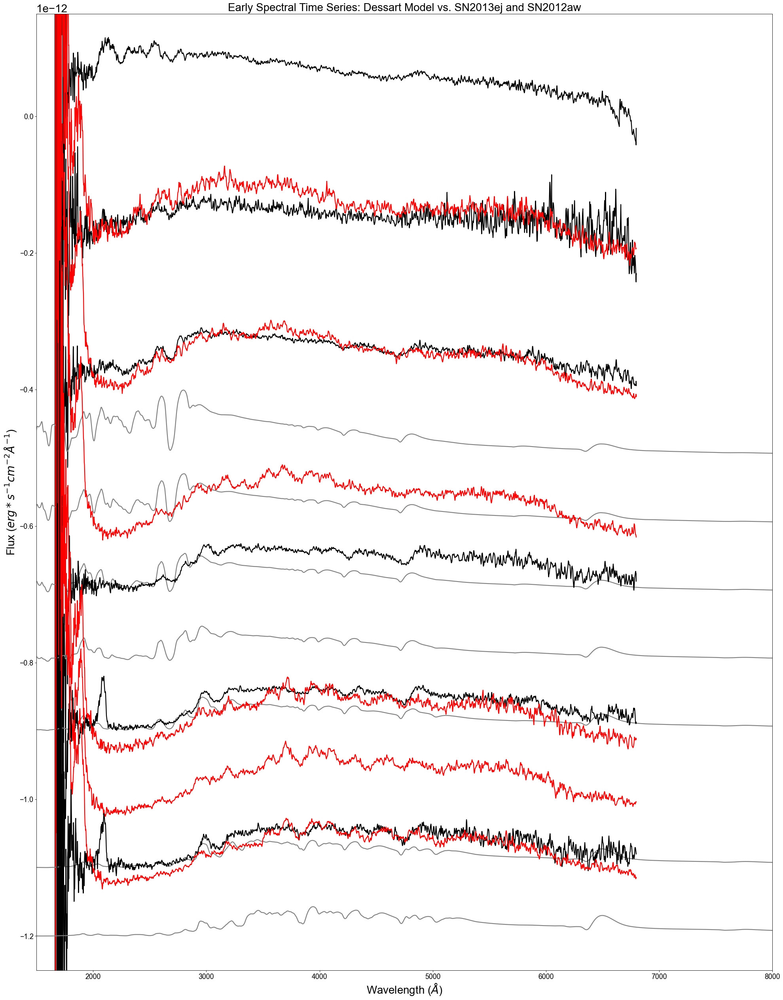

In [18]:
# every -0.00000000000010 is 1 day for 12aw and I am matching flux level for 13ej as best as possible from there (subtract additional 0.00000000000005 it seems)
# excluding last four days of 12aw for ease of view
fig = plt.figure(figsize=(30, 40), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Early Spectral Time Series: Dessart Model vs. SN2013ej and SN2012aw',fontsize=font)
plt.plot(SN12aw_5_wave_o,SN12aw_5_flux_o,linewidth=2,c='black')
plt.plot(SN12aw_7_wave_o,SN12aw_7_flux_o-0.00000000000020,linewidth=2,c='black')
plt.plot(SN13ej_7_wave_o,SN13ej_7_flux_o-0.00000000000025,linewidth=2,c='red')
plt.plot(SN12aw_9_wave_o,SN12aw_9_flux_o-0.00000000000040,linewidth=2,c='black')
plt.plot(SN13ej_9_wave_o,SN13ej_9_flux_o-0.00000000000045,linewidth=2,c='red')
plt.plot(SN12aw_10_wave_m,(0.00000001*SN12aw_10_flux_m)-0.00000000000050,linewidth=2,c='grey')
plt.plot(SN12aw_11_wave_m,(0.00000001*SN12aw_11_flux_m)-0.00000000000060,linewidth=2,c='grey')
plt.plot(SN13ej_11_wave_o,SN13ej_11_flux_o-0.00000000000065,linewidth=2,c='red')
plt.plot(SN12aw_12_wave_m,(0.00000001*SN12aw_12_flux_m)-0.00000000000070,linewidth=2,c='grey')
plt.plot(SN12aw_12_wave_o,SN12aw_12_flux_o-0.00000000000070,linewidth=2,c='black')
plt.plot(SN12aw_13_wave_m,(0.00000001*SN12aw_13_flux_m)-0.00000000000080,linewidth=2,c='grey')
plt.plot(SN12aw_14_wave_m,(0.00000001*SN12aw_14_flux_m)-0.00000000000090,linewidth=2,c='grey')
plt.plot(SN12aw_14_wave_o,SN12aw_14_flux_o-0.00000000000090,linewidth=2,c='black')
plt.plot(SN13ej_14_wave_o,SN13ej_14_flux_o-0.00000000000095,linewidth=2,c='red')
plt.plot(SN13ej_15_wave_o,SN13ej_15_flux_o-0.00000000000104,linewidth=2,c='red')
plt.plot(SN12aw_16_wave_m,(0.00000001*SN12aw_16_flux_m)-0.00000000000110,linewidth=2,c='grey')
plt.plot(SN12aw_16_wave_o,SN12aw_16_flux_o-0.00000000000110,linewidth=2,c='black')
plt.plot(SN13ej_16_wave_o,SN13ej_16_flux_o-0.00000000000114,linewidth=2,c='red')
plt.plot(SN12aw_17_wave_m,(0.00000001*SN12aw_17_flux_m)-0.00000000000120,linewidth=2,c='grey')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.00000000000125,0.00000000000015)
plt.show()

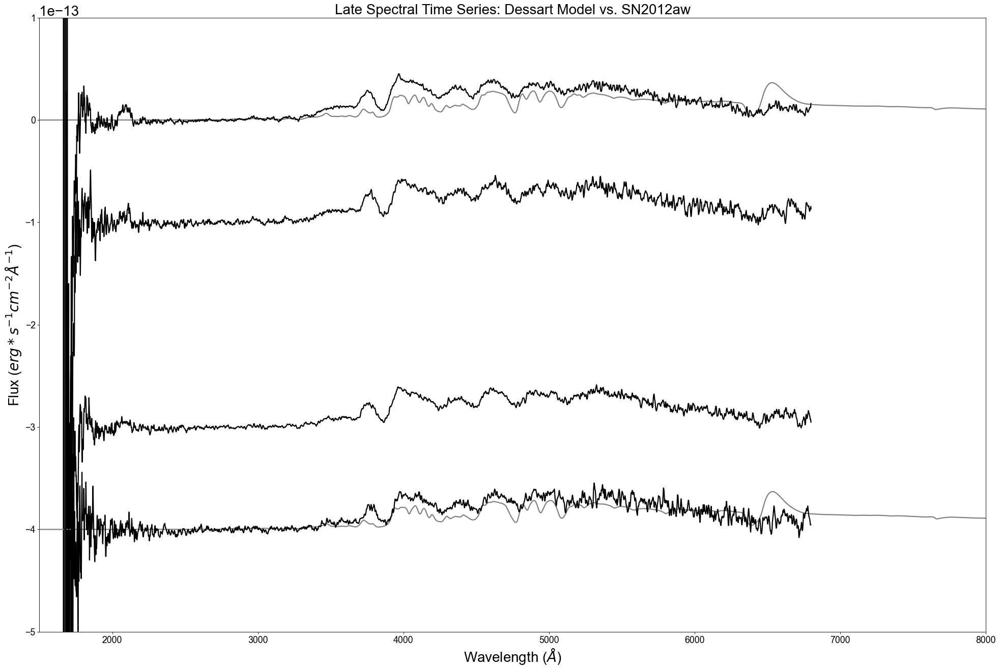

In [19]:
# every -0.00000000000010 is 1 day for 12aw and I am matching flux level for 13ej as best as possible from there (subtract additional 0.00000000000005 it seems)
# excluding everything except last four days of 12aw for ease of view
fig = plt.figure(figsize=(30, 20), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Late Spectral Time Series: Dessart Model vs. SN2012aw',fontsize=font)
plt.plot(SN12aw_42_wave_m,(0.00000001*SN12aw_42_flux_m),linewidth=2,c='grey')
plt.plot(SN12aw_42_wave_o,SN12aw_42_flux_o,linewidth=2,c='black')
plt.plot(SN12aw_43_wave_o,SN12aw_43_flux_o-0.00000000000010,linewidth=2,c='black')
plt.plot(SN12aw_45_wave_o,SN12aw_45_flux_o-0.00000000000030,linewidth=2,c='black')
plt.plot(SN12aw_46_wave_m,(0.00000001*SN12aw_46_flux_m)-0.00000000000040,linewidth=2,c='grey')
plt.plot(SN12aw_46_wave_o,SN12aw_46_flux_o-0.00000000000040,linewidth=2,c='black')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.00000000000050,0.00000000000010)
plt.show()

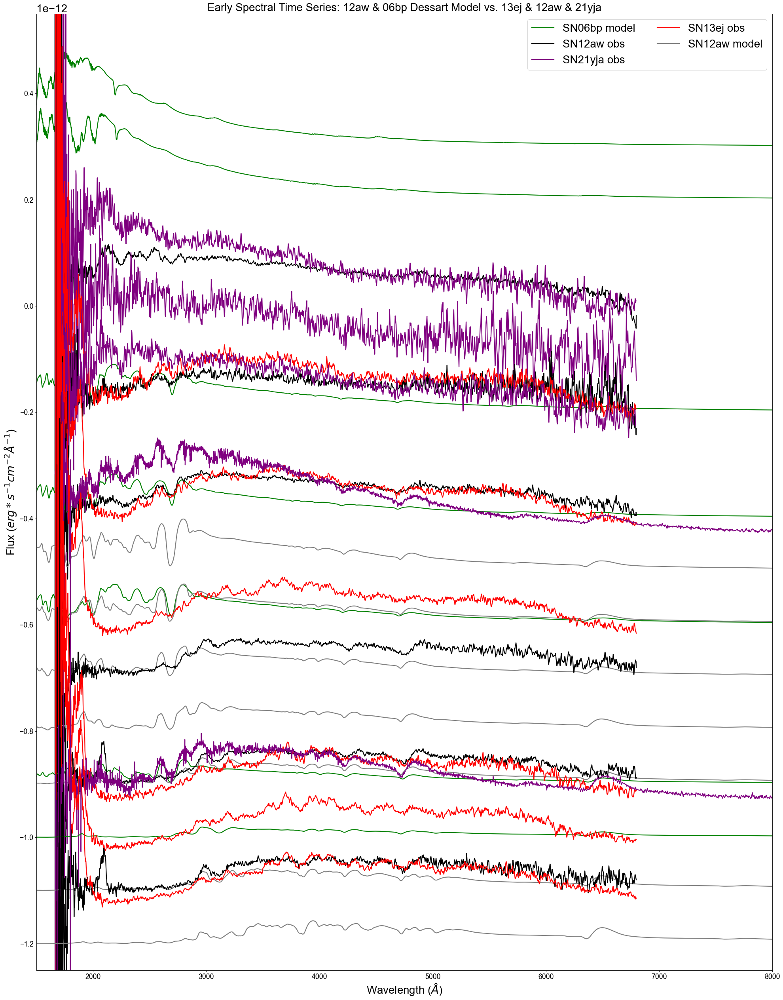

In [61]:
# every -0.00000000000010 is 1 day for 12aw and I am matching flux level for 13ej as best as possible from there (subtract additional 0.00000000000005 it seems)
# excluding last four days of 12aw for ease of view
fig = plt.figure(figsize=(30, 40), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Early Spectral Time Series: 12aw & 06bp Dessart Model vs. 13ej & 12aw & 21yja',fontsize=font)
plt.plot(SN06bp_1half_wave_m,(0.00000001*SN06bp_1half_flux_m)+0.00000000000030,linewidth=2,c='green',label='SN06bp model')
plt.plot(SN06bp_2half_wave_m,(0.00000001*SN06bp_2half_flux_m)+0.00000000000020,linewidth=2,c='green')
plt.plot(SN12aw_5_wave_o,SN12aw_5_flux_o,linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN21yja_5_wave_o,(SN21yja_5_flux_o*10)-0.00000000000005,linewidth=2,c='purple',label='SN21yja obs')
plt.plot(SN21yja_6_wave_o,(SN21yja_6_flux_o*10)-0.00000000000015,linewidth=2,c='purple')
plt.plot(SN06bp_7half_wave_m,(0.00000001*SN06bp_7half_flux_m)-0.00000000000020,linewidth=2,c='green')
plt.plot(SN12aw_7_wave_o,SN12aw_7_flux_o-0.00000000000020,linewidth=2,c='black')
plt.plot(SN13ej_7_wave_o,SN13ej_7_flux_o-0.00000000000025,linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN21yja_7_wave_o,(SN21yja_7_flux_o*10)-0.00000000000025,linewidth=2,c='purple')
plt.plot(SN06bp_9half_wave_m,(0.00000001*SN06bp_9half_flux_m)-0.00000000000040,linewidth=2,c='green')
plt.plot(SN12aw_9_wave_o,SN12aw_9_flux_o-0.00000000000040,linewidth=2,c='black')
plt.plot(SN13ej_9_wave_o,SN13ej_9_flux_o-0.00000000000045,linewidth=2,c='red')
plt.plot(SN21yja_9_wave_o,(SN21yja_9_flux_o*10)-0.00000000000045,linewidth=2,c='purple')
plt.plot(SN12aw_10_wave_m,(0.00000001*SN12aw_10_flux_m)-0.00000000000050,linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN06bp_11_wave_m,(0.00000001*SN06bp_11_flux_m)-0.00000000000060,linewidth=2,c='green')
plt.plot(SN12aw_11_wave_m,(0.00000001*SN12aw_11_flux_m)-0.00000000000060,linewidth=2,c='grey')
plt.plot(SN13ej_11_wave_o,SN13ej_11_flux_o-0.00000000000065,linewidth=2,c='red')
plt.plot(SN12aw_12_wave_m,(0.00000001*SN12aw_12_flux_m)-0.00000000000070,linewidth=2,c='grey')
plt.plot(SN12aw_12_wave_o,SN12aw_12_flux_o-0.00000000000070,linewidth=2,c='black')
plt.plot(SN12aw_13_wave_m,(0.00000001*SN12aw_13_flux_m)-0.00000000000080,linewidth=2,c='grey')
plt.plot(SN06bp_14half_wave_m,(0.00000001*SN06bp_14half_flux_m)-0.00000000000090,linewidth=2,c='green')
plt.plot(SN12aw_14_wave_m,(0.00000001*SN12aw_14_flux_m)-0.00000000000090,linewidth=2,c='grey')
plt.plot(SN12aw_14_wave_o,SN12aw_14_flux_o-0.00000000000090,linewidth=2,c='black')
plt.plot(SN13ej_14_wave_o,SN13ej_14_flux_o-0.00000000000095,linewidth=2,c='red')
plt.plot(SN21yja_14_wave_o,(SN21yja_14_flux_o*10)-0.00000000000095,linewidth=2,c='purple')
plt.plot(SN06bp_15half_wave_m,(0.00000001*SN06bp_15half_flux_m)-0.00000000000100,linewidth=2,c='green')
plt.plot(SN13ej_15_wave_o,SN13ej_15_flux_o-0.00000000000104,linewidth=2,c='red')
plt.plot(SN12aw_16_wave_m,(0.00000001*SN12aw_16_flux_m)-0.00000000000110,linewidth=2,c='grey')
plt.plot(SN12aw_16_wave_o,SN12aw_16_flux_o-0.00000000000110,linewidth=2,c='black')
plt.plot(SN13ej_16_wave_o,SN13ej_16_flux_o-0.00000000000114,linewidth=2,c='red')
plt.plot(SN12aw_17_wave_m,(0.00000001*SN12aw_17_flux_m)-0.00000000000120,linewidth=2,c='grey')
plt.plot(SN21yja_21_wave_o,(SN21yja_21_flux_o*10)-0.00000000000165,linewidth=2,c='purple')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.00000000000125,0.00000000000055)
plt.show()

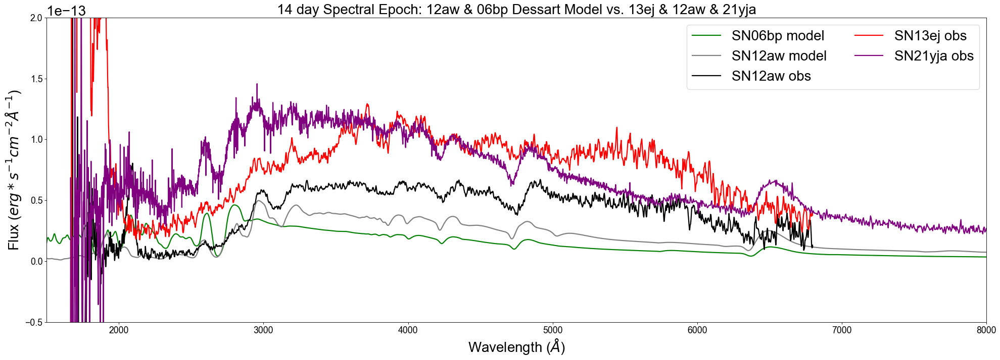

In [29]:
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('14 day Spectral Epoch: 12aw & 06bp Dessart Model vs. 13ej & 12aw & 21yja',fontsize=font)
plt.plot(SN06bp_14half_wave_m,(0.00000001*SN06bp_14half_flux_m),linewidth=2,c='green',label='SN06bp model')
plt.plot(SN12aw_14_wave_m,(0.00000001*SN12aw_14_flux_m),linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN12aw_14_wave_o,SN12aw_14_flux_o,linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN13ej_14_wave_o,SN13ej_14_flux_o,linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN21yja_14_wave_o,(SN21yja_14_flux_o*10),linewidth=2,c='purple',label='SN21yja obs')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.00000000000005,0.00000000000020)
plt.show()

# <a id='8'>Color-color diagrams based on UV Photometry</a> 
[Table of Contents](#0)

### SN2006bp photometric color-color graphs

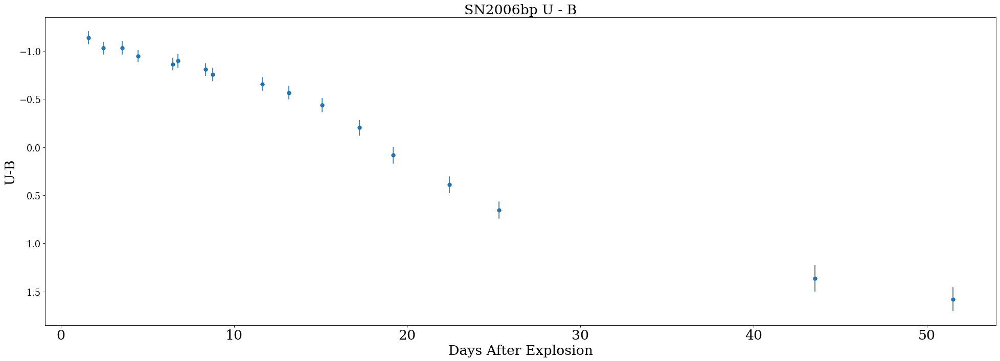

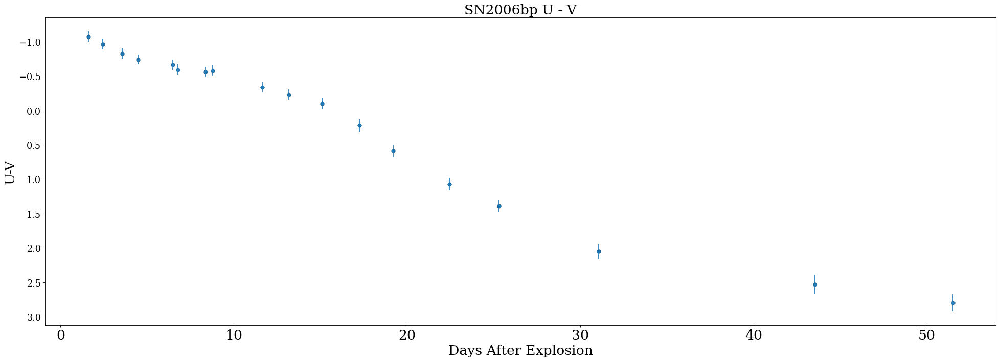

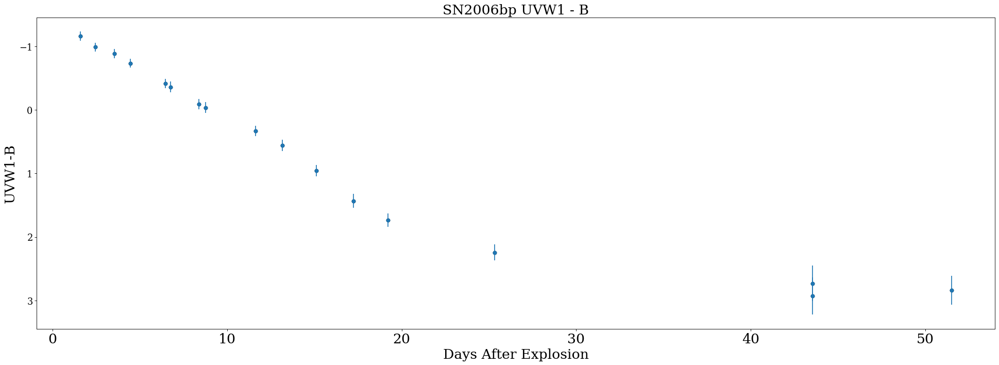

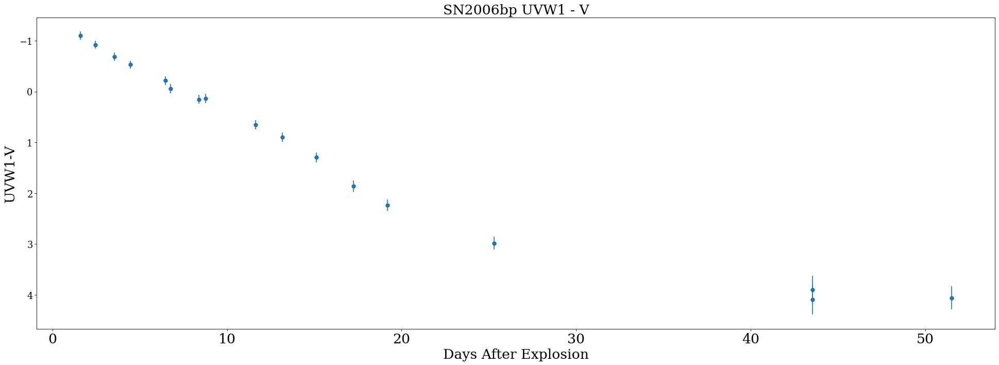

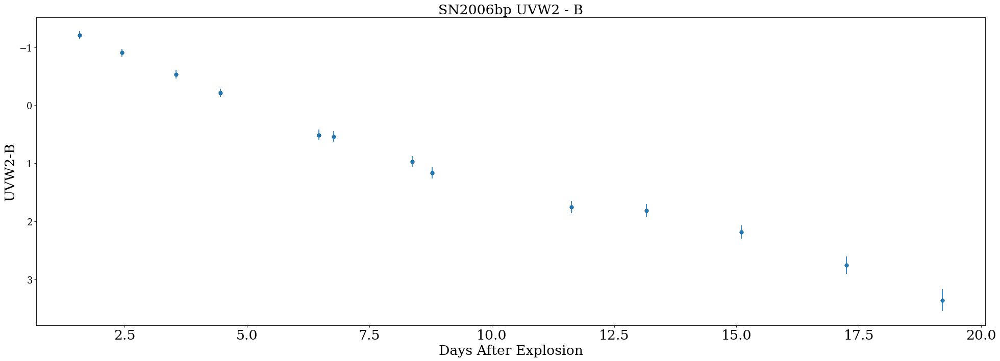

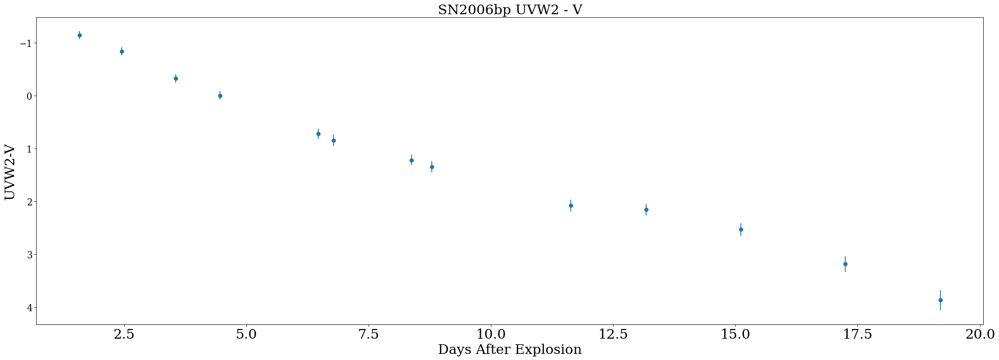

In [239]:
# SN2006bp mjd = 53834
dt = 0.1500
mjdexplosion = 53834

# defining column names and data types to pass to read_csv function
names = ['filter', 'mjd', 'mag', 'magerr', 'exposure', 'elapse']
types = {'filter': str, 'mjd': float, 'mag': float, 'magerr': float, 'exposure': float, 'elapse': float}

# import dat file to dataframe
df = pd.read_csv(SN2006bp_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# function with outputs colorseries and dateseries
def create_colorseries(df, filter1, filter2):

    # creates copy of dataframe
    func_df = df.copy()

    # removes unnecessary filters
    # resets index of dataframe for later lines
    # loc is a filtering function for pandas dataframes
    # .isin is a function that checks equality for more than one value (filter1 and filter2 for us)
    func_df = func_df.loc[func_df['filter'].isin([filter1, filter2])].reset_index(drop=True)

    # looping through rows. iterrows is neccessary for dataframes 
    for index, row in func_df.iterrows():
        
        # subtracts the current row's date by all dates that aren't the current row's filter.
        # generates a new pandas series (basically a list) of those values
        compare = abs(row['mjd'] - (func_df.loc[func_df['filter'] != row['filter']]['mjd']))

        # removes rows from dataframe if it's too far in time
        # returns True if all values in compare variable are > dt variable
        if all(compare > dt):

            # drops row if no other filter's date's are within dt value
            func_df = func_df.drop([index])

    # resetting index for next lines
    func_df = func_df.reset_index(drop=True)

    # loop through rows again to generate color values for each date add to new column
    for index, row in func_df.iterrows():
        
        compare = abs(row['mjd'] - (func_df.loc[func_df['filter'] != row['filter']]['mjd']))

        # this gives you the index (row number) of the closest date in the other filter
        # returns the index of the smallest value in compare series
        closest_dt_index = compare.idxmin()

        # getting the color based on subtraction of current row's mag and closest dates mag
        # at function returns or lets you define the value at [row, column]
        # iloc function returns row at index (row number)
        func_df.at[index, 'color'] = func_df.iloc[index]['mag'] - func_df.iloc[closest_dt_index]['mag']
        func_df.at[index, 'colorerr'] = math.sqrt( func_df.iloc[index]['magerr']**2 + func_df.iloc[closest_dt_index]['magerr']**2 )

        # overwrites the date of current row with the average of the two dates
        func_df.at[index, 'mjd'] = (func_df.iloc[index]['mjd'] + func_df.iloc[closest_dt_index]['mjd']) / 2.0

    # filters dataframe to only filter1 (color is filter1 - filter2)
    func_df = func_df[func_df['filter'] == filter1]

    # returns two columns for color and date
    return func_df['color'], func_df['mjd'], func_df['colorerr']

filters = [['U', 'B'], ['U', 'V'], ['UVW1', 'B'],
           ['UVW1', 'V'], ['UVW2', 'B'], ['UVW2', 'V']]

for filter1, filter2 in filters:

    colorseries, timeseries, errseries = create_colorseries(df, filter1, filter2)

    fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
    plt.title('SN2006bp ' + filter1 + ' - ' + filter2,fontsize=font)
    plt.scatter(timeseries-mjdexplosion,colorseries,c='black')
    plt.errorbar(timeseries-mjdexplosion,colorseries,yerr=errseries,fmt="o")
    plt.xlabel('Days After Explosion',fontsize=font)
    plt.ylabel(filter1 + '-' +filter2,fontsize=font)
    plt.yticks(fontsize=16)
    plt.gca().invert_yaxis()
    #plt.gca().get_xaxis().get_major_formatter().set_useOffset(False)
    #plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)

plt.show()

# creating variable names to plot easily
SN06bp_p_ub, SN06bp_mjd_ub, SN06bp_err_ub = create_colorseries(df,'U','B')
SN06bp_dse_ub = SN06bp_mjd_ub-mjdexplosion
SN06bp_p_uv, SN06bp_mjd_uv, SN06bp_err_uv = create_colorseries(df,'U','V')
SN06bp_dse_uv = SN06bp_mjd_uv-mjdexplosion
SN06bp_p_uvw1b, SN06bp_mjd_uvw1b, SN06bp_err_uvw1b = create_colorseries(df,'UVW1','B')
SN06bp_dse_uvw1b = SN06bp_mjd_uvw1b-mjdexplosion
SN06bp_p_uvw1v, SN06bp_mjd_uvw1v, SN06bp_err_uvw1v = create_colorseries(df,'UVW1','V')
SN06bp_dse_uvw1v = SN06bp_mjd_uvw1v-mjdexplosion
SN06bp_p_uvw2b, SN06bp_mjd_uvw2b, SN06bp_err_uvw2b = create_colorseries(df,'UVW2','B')
SN06bp_dse_uvw2b = SN06bp_mjd_uvw2b-mjdexplosion
SN06bp_p_uvw2v, SN06bp_mjd_uvw2v, SN06bp_err_uvw2v = create_colorseries(df,'UVW2','V')
SN06bp_dse_uvw2v = SN06bp_mjd_uvw2v-mjdexplosion

### SN2005cs photometric color-color graphs

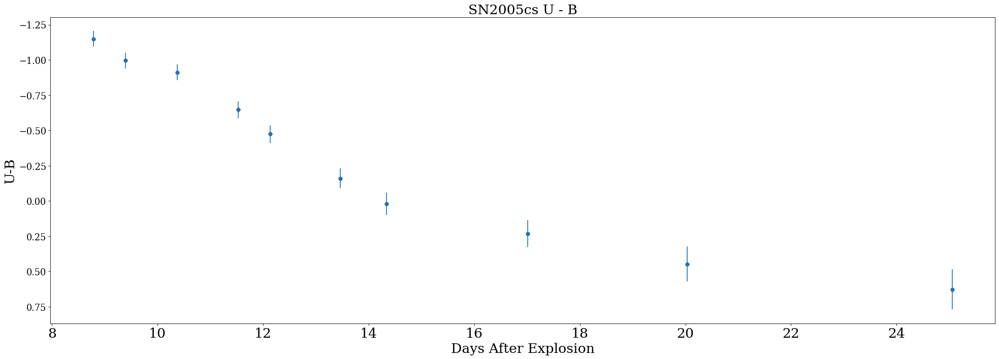

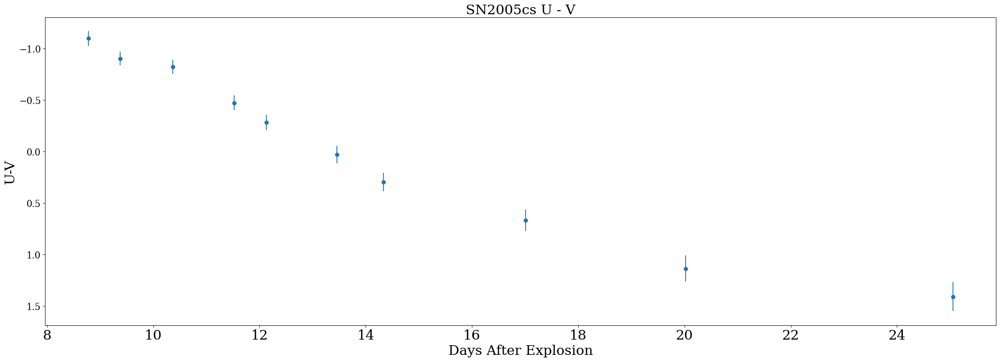

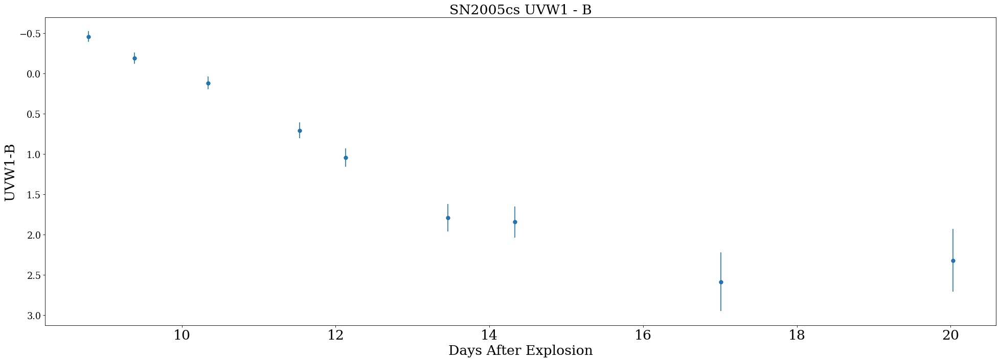

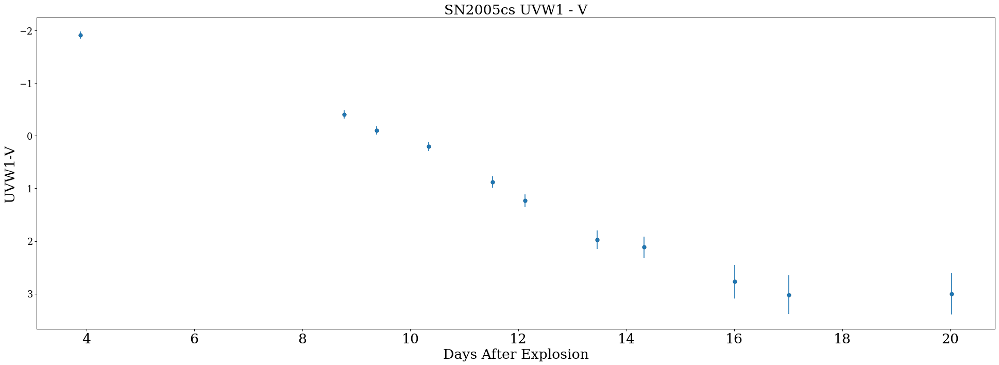

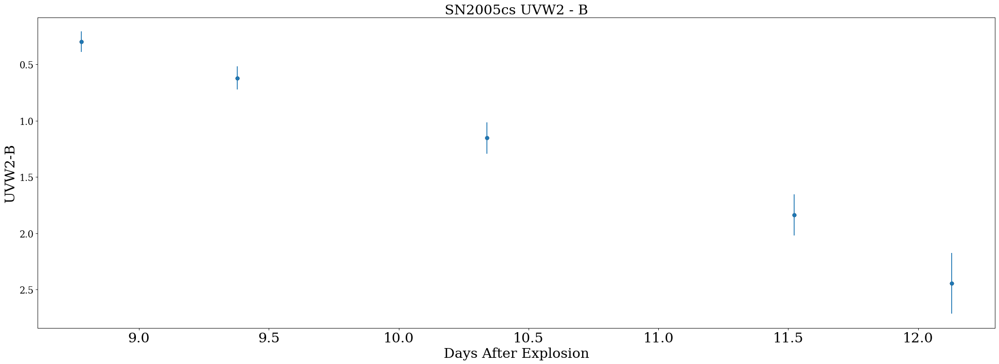

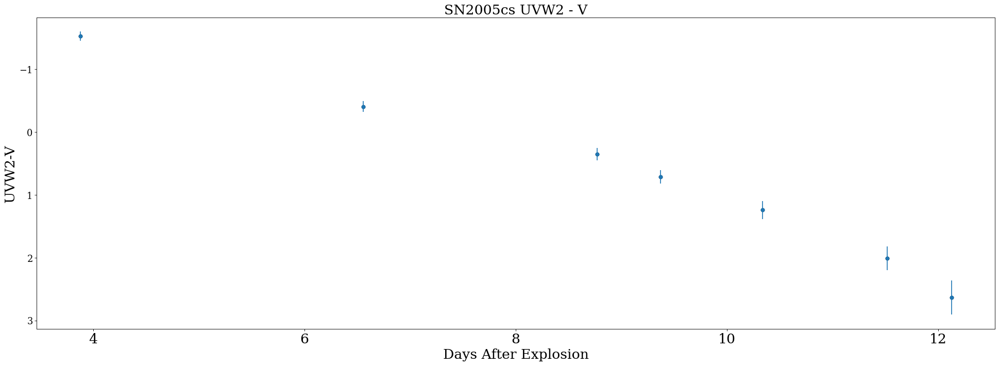

In [240]:
# SN2005cs mjd = 53548
dt = 0.1500
mjdexplosion = 53548

# defining column names and data types to pass to read_csv function
names = ['filter', 'mjd', 'mag', 'magerr', 'exposure', 'elapse']
types = {'filter': str, 'mjd': float, 'mag': float, 'magerr': float, 'exposure': float, 'elapse': float}

# import dat file to dataframe
df = pd.read_csv(SN2005cs_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# function with outputs colorseries and dateseries
def create_colorseries(df, filter1, filter2):

    # creates copy of dataframe
    func_df = df.copy()

    # removes unnecessary filters
    # resets index of dataframe for later lines
    # loc is a filtering function for pandas dataframes
    # .isin is a function that checks equality for more than one value (filter1 and filter2 for us)
    func_df = func_df.loc[func_df['filter'].isin([filter1, filter2])].reset_index(drop=True)

    # looping through rows. iterrows is neccessary for dataframes 
    for index, row in func_df.iterrows():
        
        # subtracts the current row's date by all dates that aren't the current row's filter.
        # generates a new pandas series (basically a list) of those values
        compare = abs(row['mjd'] - (func_df.loc[func_df['filter'] != row['filter']]['mjd']))

        # removes rows from dataframe if it's too far in time
        # returns True if all values in compare variable are > dt variable
        if all(compare > dt):

            # drops row if no other filter's date's are within dt value
            func_df = func_df.drop([index])

    # resetting index for next lines
    func_df = func_df.reset_index(drop=True)

    # loop through rows again to generate color values for each date add to new column
    for index, row in func_df.iterrows():
        
        compare = abs(row['mjd'] - (func_df.loc[func_df['filter'] != row['filter']]['mjd']))

        # this gives you the index (row number) of the closest date in the other filter
        # returns the index of the smallest value in compare series
        closest_dt_index = compare.idxmin()

        # getting the color based on subtraction of current row's mag and closest dates mag
        # at function returns or lets you define the value at [row, column]
        # iloc function returns row at index (row number)
        func_df.at[index, 'color'] = func_df.iloc[index]['mag'] - func_df.iloc[closest_dt_index]['mag']
        func_df.at[index, 'colorerr'] = math.sqrt( func_df.iloc[index]['magerr']**2 + func_df.iloc[closest_dt_index]['magerr']**2 )

        # overwrites the date of current row with the average of the two dates
        func_df.at[index, 'mjd'] = (func_df.iloc[index]['mjd'] + func_df.iloc[closest_dt_index]['mjd']) / 2.0

    # filters dataframe to only filter1 (color is filter1 - filter2)
    func_df = func_df[func_df['filter'] == filter1]

    # returns two columns for color and date
    return func_df['color'], func_df['mjd'], func_df['colorerr']

filters = [['U', 'B'], ['U', 'V'], ['UVW1', 'B'],
           ['UVW1', 'V'], ['UVW2', 'B'], ['UVW2', 'V']]

for filter1, filter2 in filters:

    colorseries, timeseries, errseries = create_colorseries(df, filter1, filter2)

    fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
    plt.title('SN2005cs ' + filter1 + ' - ' + filter2,fontsize=font)
    plt.scatter(timeseries-mjdexplosion,colorseries,c='black')
    plt.errorbar(timeseries-mjdexplosion,colorseries,yerr=errseries,fmt="o")
    plt.xlabel('Days After Explosion',fontsize=font)
    plt.ylabel(filter1 + '-' +filter2,fontsize=font)
    plt.yticks(fontsize=16)
    plt.gca().invert_yaxis()
    #plt.gca().get_xaxis().get_major_formatter().set_useOffset(False)
    #plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)

plt.show()

# creating variable names to plot easily
SN05cs_p_ub, SN05cs_mjd_ub, SN05cs_err_ub = create_colorseries(df,'U','B')
SN05cs_dse_ub = SN05cs_mjd_ub-mjdexplosion
SN05cs_p_uv, SN05cs_mjd_uv, SN05cs_err_uv = create_colorseries(df,'U','V')
SN05cs_dse_uv = SN05cs_mjd_uv-mjdexplosion
SN05cs_p_uvw1b, SN05cs_mjd_uvw1b, SN05cs_err_uvw1b = create_colorseries(df,'UVW1','B')
SN05cs_dse_uvw1b = SN05cs_mjd_uvw1b-mjdexplosion
SN05cs_p_uvw1v, SN05cs_mjd_uvw1v, SN05cs_err_uvw1v = create_colorseries(df,'UVW1','V')
SN05cs_dse_uvw1v = SN05cs_mjd_uvw1v-mjdexplosion
SN05cs_p_uvw2b, SN05cs_mjd_uvw2b, SN05cs_err_uvw2b = create_colorseries(df,'UVW2','B')
SN05cs_dse_uvw2b = SN05cs_mjd_uvw2b-mjdexplosion
SN05cs_p_uvw2v, SN05cs_mjd_uvw2v, SN05cs_err_uvw2v = create_colorseries(df,'UVW2','V')
SN05cs_dse_uvw2v = SN05cs_mjd_uvw2v-mjdexplosion

### SN2012aw photometric color-color graphs

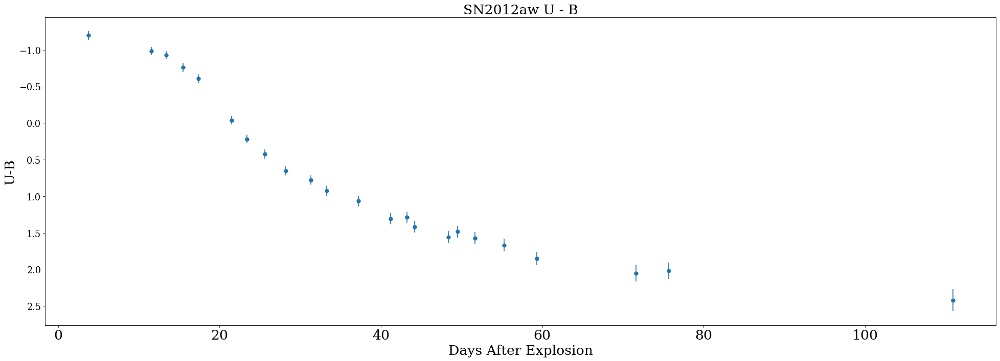

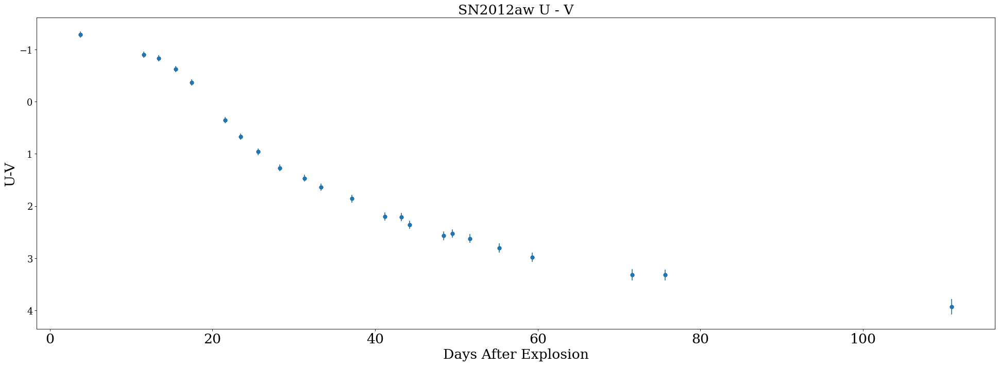

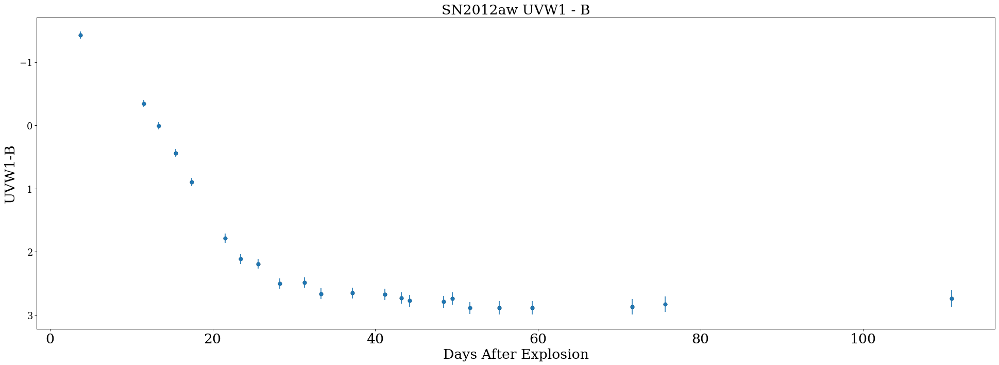

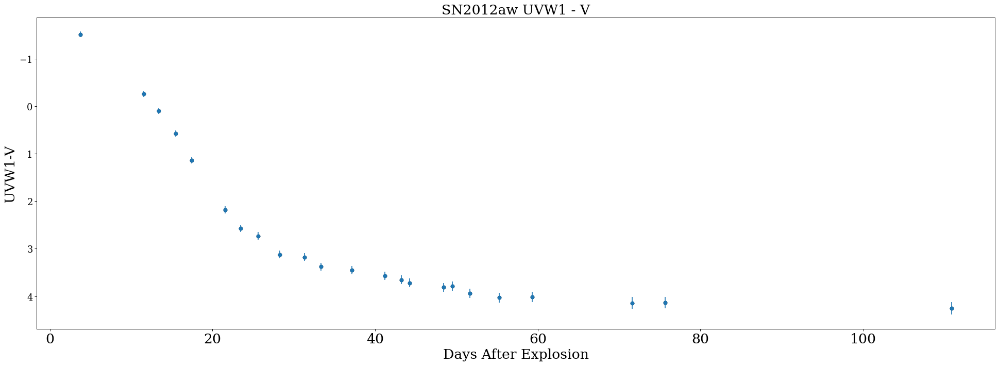

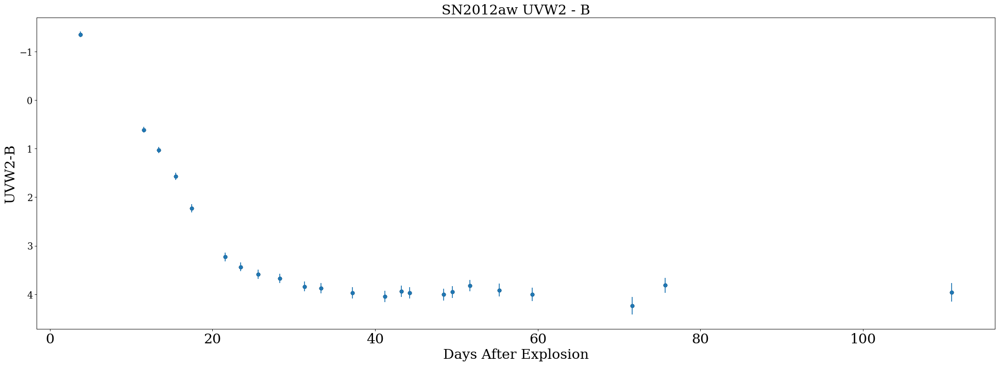

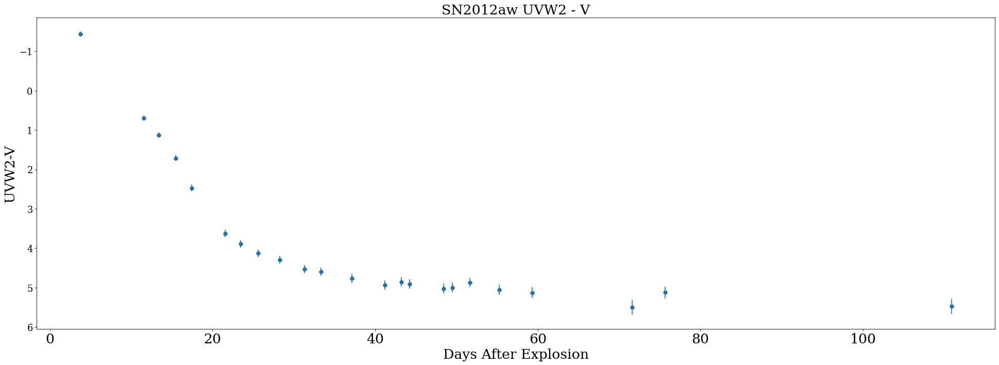

In [241]:
# SN2012aw mjd = 56002
dt = 0.1500
mjdexplosion = 56002

# defining column names and data types to pass to read_csv function
names = ['filter', 'mjd', 'mag', 'magerr', 'exposure', 'elapse']
types = {'filter': str, 'mjd': float, 'mag': float, 'magerr': float, 'exposure': float, 'elapse': float}

# import dat file to dataframe
df = pd.read_csv(SN2012aw_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# function with outputs colorseries and dateseries
def create_colorseries(df, filter1, filter2):

    # creates copy of dataframe
    func_df = df.copy()

    # removes unnecessary filters
    # resets index of dataframe for later lines
    # loc is a filtering function for pandas dataframes
    # .isin is a function that checks equality for more than one value (filter1 and filter2 for us)
    func_df = func_df.loc[func_df['filter'].isin([filter1, filter2])].reset_index(drop=True)

    # looping through rows. iterrows is neccessary for dataframes 
    for index, row in func_df.iterrows():
        
        # subtracts the current row's date by all dates that aren't the current row's filter.
        # generates a new pandas series (basically a list) of those values
        compare = abs(row['mjd'] - (func_df.loc[func_df['filter'] != row['filter']]['mjd']))

        # removes rows from dataframe if it's too far in time
        # returns True if all values in compare variable are > dt variable
        if all(compare > dt):

            # drops row if no other filter's date's are within dt value
            func_df = func_df.drop([index])

    # resetting index for next lines
    func_df = func_df.reset_index(drop=True)

    # loop through rows again to generate color values for each date add to new column
    for index, row in func_df.iterrows():
        
        compare = abs(row['mjd'] - (func_df.loc[func_df['filter'] != row['filter']]['mjd']))

        # this gives you the index (row number) of the closest date in the other filter
        # returns the index of the smallest value in compare series
        closest_dt_index = compare.idxmin()

        # getting the color based on subtraction of current row's mag and closest dates mag
        # at function returns or lets you define the value at [row, column]
        # iloc function returns row at index (row number)
        func_df.at[index, 'color'] = func_df.iloc[index]['mag'] - func_df.iloc[closest_dt_index]['mag']
        func_df.at[index, 'colorerr'] = math.sqrt( func_df.iloc[index]['magerr']**2 + func_df.iloc[closest_dt_index]['magerr']**2 )

        # overwrites the date of current row with the average of the two dates
        func_df.at[index, 'mjd'] = (func_df.iloc[index]['mjd'] + func_df.iloc[closest_dt_index]['mjd']) / 2.0

    # filters dataframe to only filter1 (color is filter1 - filter2)
    func_df = func_df[func_df['filter'] == filter1]

    # returns two columns for color and date
    return func_df['color'], func_df['mjd'], func_df['colorerr']

filters = [['U', 'B'], ['U', 'V'], ['UVW1', 'B'],
           ['UVW1', 'V'], ['UVW2', 'B'], ['UVW2', 'V']]

for filter1, filter2 in filters:

    colorseries, timeseries, errseries = create_colorseries(df, filter1, filter2)

    fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
    plt.title('SN2012aw ' + filter1 + ' - ' + filter2,fontsize=font)
    plt.scatter(timeseries-mjdexplosion,colorseries,c='black')
    plt.errorbar(timeseries-mjdexplosion,colorseries,yerr=errseries,fmt="o")
    plt.xlabel('Days After Explosion',fontsize=font)
    plt.ylabel(filter1 + '-' +filter2,fontsize=font)
    plt.yticks(fontsize=16)
    plt.gca().invert_yaxis()
    #plt.gca().get_xaxis().get_major_formatter().set_useOffset(False)
    #plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)

plt.show()

# creating variable names to plot easily
SN12aw_p_ub, SN12aw_mjd_ub, SN12aw_err_ub = create_colorseries(df,'U','B')
SN12aw_dse_ub = SN12aw_mjd_ub-mjdexplosion
SN12aw_p_uv, SN12aw_mjd_uv, SN12aw_err_uv = create_colorseries(df,'U','V')
SN12aw_dse_uv = SN12aw_mjd_uv-mjdexplosion
SN12aw_p_uvw1b, SN12aw_mjd_uvw1b, SN12aw_err_uvw1b = create_colorseries(df,'UVW1','B')
SN12aw_dse_uvw1b = SN12aw_mjd_uvw1b-mjdexplosion
SN12aw_p_uvw1v, SN12aw_mjd_uvw1v, SN12aw_err_uvw1v = create_colorseries(df,'UVW1','V')
SN12aw_dse_uvw1v = SN12aw_mjd_uvw1v-mjdexplosion
SN12aw_p_uvw2b, SN12aw_mjd_uvw2b, SN12aw_err_uvw2b = create_colorseries(df,'UVW2','B')
SN12aw_dse_uvw2b = SN12aw_mjd_uvw2b-mjdexplosion
SN12aw_p_uvw2v, SN12aw_mjd_uvw2v, SN12aw_err_uvw2v = create_colorseries(df,'UVW2','V')
SN12aw_dse_uvw2v = SN12aw_mjd_uvw2v-mjdexplosion

### SN2013ej photometric color-color graphs

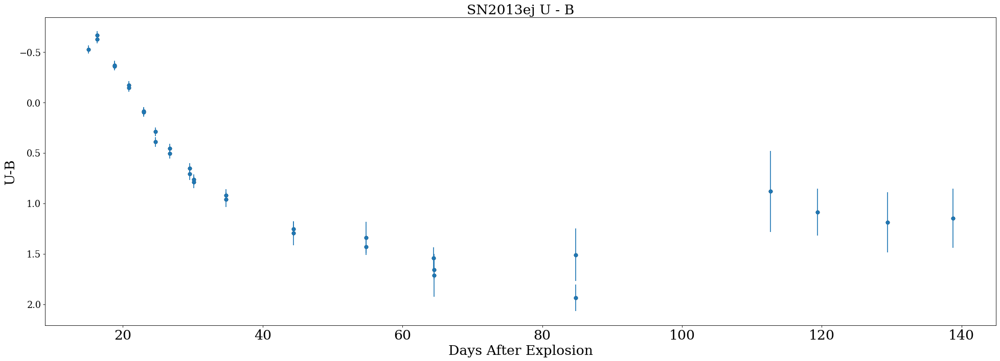

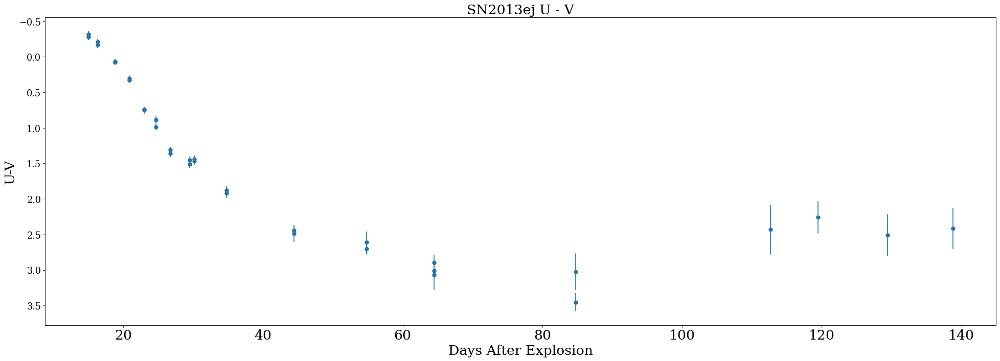

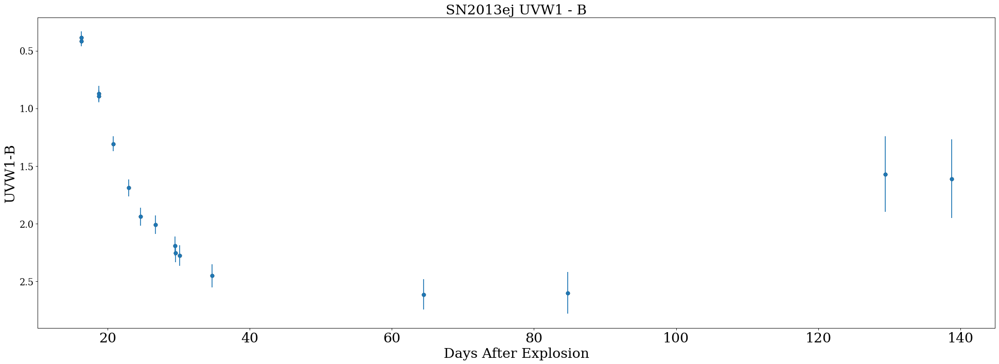

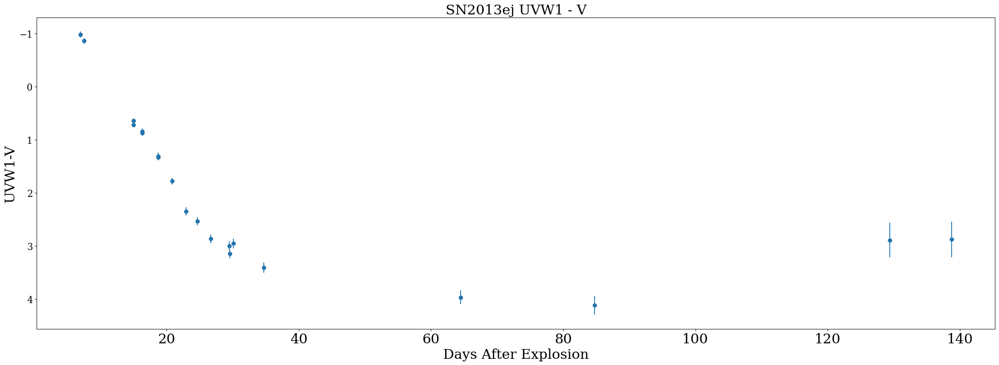

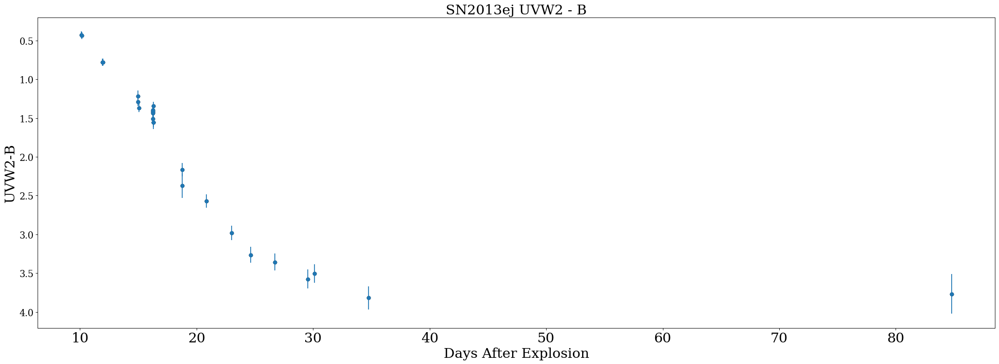

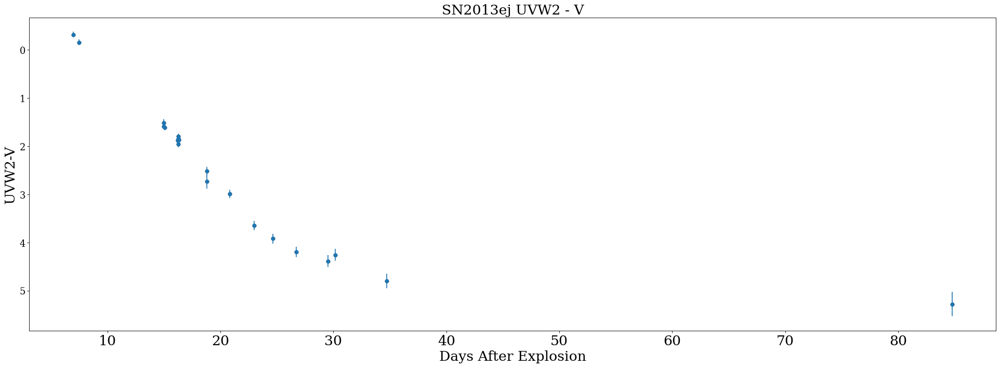

In [242]:
# SN2013ej mjd = 56497
dt = 0.1500
mjdexplosion = 56497

# defining column names and data types to pass to read_csv function
names = ['filter', 'mjd', 'mag', 'magerr', 'exposure', 'elapse']
types = {'filter': str, 'mjd': float, 'mag': float, 'magerr': float, 'exposure': float, 'elapse': float}

# import dat file to dataframe
df = pd.read_csv(SN2013ej_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# function with outputs colorseries and dateseries
def create_colorseries(df, filter1, filter2):

    # creates copy of dataframe
    func_df = df.copy()

    # removes unnecessary filters
    # resets index of dataframe for later lines
    # loc is a filtering function for pandas dataframes
    # .isin is a function that checks equality for more than one value (filter1 and filter2 for us)
    func_df = func_df.loc[func_df['filter'].isin([filter1, filter2])].reset_index(drop=True)

    # looping through rows. iterrows is neccessary for dataframes 
    for index, row in func_df.iterrows():
        
        # subtracts the current row's date by all dates that aren't the current row's filter.
        # generates a new pandas series (basically a list) of those values
        compare = abs(row['mjd'] - (func_df.loc[func_df['filter'] != row['filter']]['mjd']))

        # removes rows from dataframe if it's too far in time
        # returns True if all values in compare variable are > dt variable
        if all(compare > dt):

            # drops row if no other filter's date's are within dt value
            func_df = func_df.drop([index])

    # resetting index for next lines
    func_df = func_df.reset_index(drop=True)

    # loop through rows again to generate color values for each date add to new column
    for index, row in func_df.iterrows():
        
        compare = abs(row['mjd'] - (func_df.loc[func_df['filter'] != row['filter']]['mjd']))

        # this gives you the index (row number) of the closest date in the other filter
        # returns the index of the smallest value in compare series
        closest_dt_index = compare.idxmin()

        # getting the color based on subtraction of current row's mag and closest dates mag
        # at function returns or lets you define the value at [row, column]
        # iloc function returns row at index (row number)
        func_df.at[index, 'color'] = func_df.iloc[index]['mag'] - func_df.iloc[closest_dt_index]['mag']
        func_df.at[index, 'colorerr'] = math.sqrt( func_df.iloc[index]['magerr']**2 + func_df.iloc[closest_dt_index]['magerr']**2 )

        # overwrites the date of current row with the average of the two dates
        func_df.at[index, 'mjd'] = (func_df.iloc[index]['mjd'] + func_df.iloc[closest_dt_index]['mjd']) / 2.0

    # filters dataframe to only filter1 (color is filter1 - filter2)
    func_df = func_df[func_df['filter'] == filter1]
    
    # dropping nan values caused by NULL values in the OG file
    func_df = func_df.dropna(subset=['color'])

    # returns two columns for color and date
    return func_df['color'], func_df['mjd'], func_df['colorerr']

filters = [['U', 'B'], ['U', 'V'], ['UVW1', 'B'],
           ['UVW1', 'V'], ['UVW2', 'B'], ['UVW2', 'V']]

for filter1, filter2 in filters:

    colorseries, timeseries, errseries = create_colorseries(df, filter1, filter2)

    fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
    plt.title('SN2013ej ' + filter1 + ' - ' + filter2,fontsize=font)
    plt.scatter(timeseries-mjdexplosion,colorseries,c='black')
    plt.errorbar(timeseries-mjdexplosion,colorseries,yerr=errseries,fmt="o")
    plt.xlabel('Days After Explosion',fontsize=font)
    plt.ylabel(filter1 + '-' +filter2,fontsize=font)
    plt.yticks(fontsize=16)
    plt.gca().invert_yaxis()
    #plt.gca().get_xaxis().get_major_formatter().set_useOffset(False)
    #plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)

plt.show()

# creating variable names to plot easily
SN13ej_p_ub, SN13ej_mjd_ub, SN13ej_err_ub = create_colorseries(df,'U','B')
SN13ej_dse_ub = SN13ej_mjd_ub-mjdexplosion
SN13ej_p_uv, SN13ej_mjd_uv, SN13ej_err_uv = create_colorseries(df,'U','V')
SN13ej_dse_uv = SN13ej_mjd_uv-mjdexplosion
SN13ej_p_uvw1b, SN13ej_mjd_uvw1b, SN13ej_err_uvw1b = create_colorseries(df,'UVW1','B')
SN13ej_dse_uvw1b = SN13ej_mjd_uvw1b-mjdexplosion
SN13ej_p_uvw1v, SN13ej_mjd_uvw1v, SN13ej_err_uvw1v = create_colorseries(df,'UVW1','V')
SN13ej_dse_uvw1v = SN13ej_mjd_uvw1v-mjdexplosion
SN13ej_p_uvw2b, SN13ej_mjd_uvw2b, SN13ej_err_uvw2b = create_colorseries(df,'UVW2','B')
SN13ej_dse_uvw2b = SN13ej_mjd_uvw2b-mjdexplosion
SN13ej_p_uvw2v, SN13ej_mjd_uvw2v, SN13ej_err_uvw2v = create_colorseries(df,'UVW2','V')
SN13ej_dse_uvw2v = SN13ej_mjd_uvw2v-mjdexplosion

# <a id='9'>U-V Color-color diagrams based on spectra</a> 
[Table of Contents](#0)

## Run "Applying Spectrophotometry/ColorColor Functions" first before this section :)

### Running the spectral data to be plotted

In [243]:
############### putting data files into an array to run through the for loop
SN06bp_modeldata = [SN06bp_1half_m,SN06bp_2half_m,SN06bp_7half_m,SN06bp_9half_m,SN06bp_11_m,SN06bp_14half_m,
                    SN06bp_15half_m,SN06bp_20half_m,SN06bp_22_m,SN06bp_24_m,SN06bp_30_m,SN06bp_41half_m,
                    SN06bp_56half_m,SN06bp_72half_m]
SN05cs_modeldata = [SN05cs_3_m,SN05cs_4_m,SN05cs_5_m,SN05cs_6_m,SN05cs_7_m,SN05cs_8_m,SN05cs_9_m,SN05cs_12_m,
                    SN05cs_13_m,SN05cs_14_m,SN05cs_15_m,SN05cs_17_m]
SN12aw_modeldata = [SN12aw_10_m,SN12aw_11_m,SN12aw_12_m,SN12aw_13_m,SN12aw_14_m,SN12aw_16_m,SN12aw_17_m,
                    SN12aw_19_m,SN12aw_21_m,SN12aw_23_m,SN12aw_26_m,SN12aw_28_m,SN12aw_31_m,SN12aw_34_m,
                    SN12aw_38_m,SN12aw_42_m,SN12aw_46_m,SN12aw_50_m,SN12aw_55_m,SN12aw_61_m,SN12aw_67_m,
                    SN12aw_74_m,SN12aw_81_m,SN12aw_89_m,SN12aw_98_m,SN12aw_108_m,SN12aw_119_m,SN12aw_121_m,
                    SN12aw_124_m,SN12aw_126_m,SN12aw_129_m,SN12aw_131_m,SN12aw_134_m,SN12aw_137_m,SN12aw_139_m,
                    SN12aw_142_m,SN12aw_145_m,SN12aw_148_m,SN12aw_151_m,SN12aw_154_m,SN12aw_157_m,SN12aw_160_m,
                    SN12aw_163_m,SN12aw_166_m,SN12aw_175_m,SN12aw_187_m,SN12aw_200_m]
SN13ej_obsdata = [SN13ej_7_o,SN13ej_9_o,SN13ej_11_o,SN13ej_14_o,
                  SN13ej_15_o,SN13ej_16_o]
SN12aw_obsdata = [SN12aw_5_o,SN12aw_7_o,SN12aw_9_o,SN12aw_12_o,
                  SN12aw_14_o,SN12aw_16_o,SN12aw_42_o,SN12aw_43_o,
                  SN12aw_45_o,SN12aw_46_o]
SN21yja_obsdata = [SN21yja_5_o,SN21yja_6_o,SN21yja_7_o,SN21yja_9_o,
                   SN21yja_14_o,SN21yja_21_o]

############### running data 
# SN06bp model
SN06bp_m_mag = []
for sp in range(len(SN06bp_modeldata)):
    SN06bp_m_mag.append(specphotmodel_filters(SN06bp_modeldata[sp],17.5*10**6)) # append filter data
SN06bp_m_mag = np.array(SN06bp_m_mag) # turn into array so you can shape it
SN06bp_m_shape = (len(SN06bp_modeldata),6) # set up shape
SN06bp_m_mag = SN06bp_m_mag.reshape(SN06bp_m_shape) # reshape it
SN06bp_m_mag = np.matrix(SN06bp_m_mag) # turn into matrix
# SN12aw model
SN12aw_m_mag = []
for sp in range(len(SN12aw_modeldata)):
    SN12aw_m_mag.append(specphot_filters(SN12aw_modeldata[sp]))
SN12aw_m_mag = np.array(SN12aw_m_mag)
SN12aw_m_shape = (len(SN12aw_modeldata),6)
SN12aw_m_mag = SN12aw_m_mag.reshape(SN12aw_m_shape)
SN12aw_m_mag = np.matrix(SN12aw_m_mag)
# SN13ej obs
SN13ej_o_mag = []
for sp in range(len(SN13ej_obsdata)):
    SN13ej_o_mag.append(specphot_filters(SN13ej_obsdata[sp]))
SN13ej_o_mag = np.array(SN13ej_o_mag)
SN13ej_o_shape = (len(SN13ej_obsdata),6)
SN13ej_o_mag = SN13ej_o_mag.reshape(SN13ej_o_shape)
SN13ej_o_mag = np.matrix(SN13ej_o_mag)

SN13ej_o_magerr = []
for sp in range(len(SN13ej_obsdata)):
    SN13ej_o_magerr.append(specphoterr_filters(SN13ej_obsdata[sp]))
SN13ej_o_magerr = np.array(SN13ej_o_magerr)
SN13ej_o_magerr = SN13ej_o_magerr.reshape(SN13ej_o_shape)
# SN12aw obs
SN12aw_o_mag = []
for sp in range(len(SN12aw_obsdata)):
    SN12aw_o_mag.append(specphot_filters(SN12aw_obsdata[sp]))
SN12aw_o_mag = np.array(SN12aw_o_mag)
SN12aw_o_shape = (len(SN12aw_obsdata),6)
SN12aw_o_mag = SN12aw_o_mag.reshape(SN12aw_o_shape)
SN12aw_o_mag = np.matrix(SN12aw_o_mag)

SN12aw_o_magerr = []
for sp in range(len(SN12aw_obsdata)):
    SN12aw_o_magerr.append(specphoterr_filters(SN12aw_obsdata[sp]))
SN12aw_o_magerr = np.array(SN12aw_o_magerr)
SN12aw_o_magerr = SN12aw_o_magerr.reshape(SN12aw_o_shape)
# SN21yja obs
SN21yja_o_mag = []
for sp in range(len(SN21yja_obsdata)):
    SN21yja_o_mag.append(specphot_filters(SN21yja_obsdata[sp]))
SN21yja_o_mag = np.array(SN21yja_o_mag)
SN21yja_o_shape = (len(SN21yja_obsdata),6)
SN21yja_o_mag = SN21yja_o_mag.reshape(SN21yja_o_shape)
SN21yja_o_mag = np.matrix(SN21yja_o_mag)

SN21yja_o_magerr = []
for sp in range(len(SN21yja_obsdata)):
    SN21yja_o_magerr.append(specphoterr_filters(SN21yja_obsdata[sp]))
SN21yja_o_magerr = np.array(SN21yja_o_magerr)
SN21yja_o_magerr = SN21yja_o_magerr.reshape(SN21yja_o_shape)
############### order of mag is w2,m2,w1,u,b,v

############### setting up arrays for getting days after explosion
SN06bp_m_date = [1,2,7,9,11,14,15,20,22,24,30,41,56,72]
SN06bp_m_date = np.array(SN06bp_m_date)
SN05cs_m_date = [3,4,5,6,7,8,9,12,13,14,15,17]
SN05cs_m_date = np.array(SN05cs_m_date)
SN12aw_m_date = [10,11,12,13,14,16,17,19,21,23,26,28,31,34,38,42,46,50,55,61,67,74,81,89,98,108,119,121,124,126,
                 129,131,134,137,139,142,145,148,151,154,157,160,163,166,175,187,200]
SN12aw_m_date = np.array(SN12aw_m_date)
SN13ej_o_date = [7,9,11,14,15,16]
SN13ej_o_date = np.array(SN13ej_o_date)
SN12aw_o_date = [5,7,9,12,14,16,26,27,29,30]
SN12aw_o_date = np.array(SN12aw_o_date)
SN21yja_o_date = [5,6,7,9,14,21]
SN21yja_o_date = np.array(SN21yja_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN06bp_m_data = np.c_[SN06bp_m_mag,SN06bp_m_date]
SN12aw_m_data = np.c_[SN12aw_m_mag,SN12aw_m_date]
SN13ej_o_data = np.c_[SN13ej_o_mag,SN13ej_o_date]
SN12aw_o_data = np.c_[SN12aw_o_mag,SN12aw_o_date]
SN21yja_o_data = np.c_[SN21yja_o_mag,SN21yja_o_date]

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

### Plotting U-V color over time

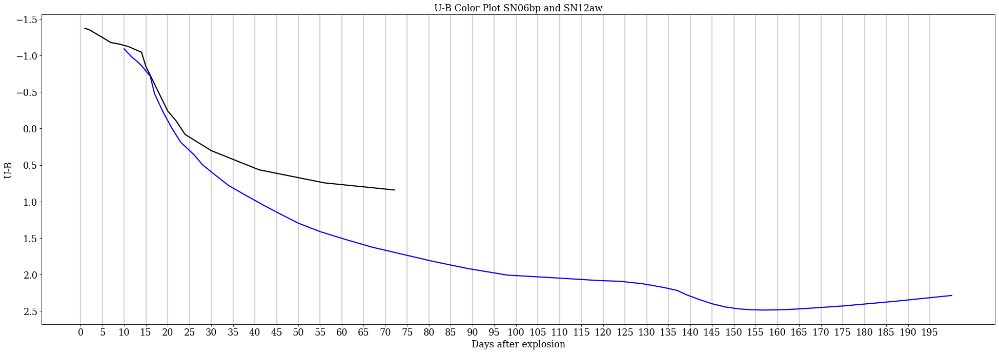

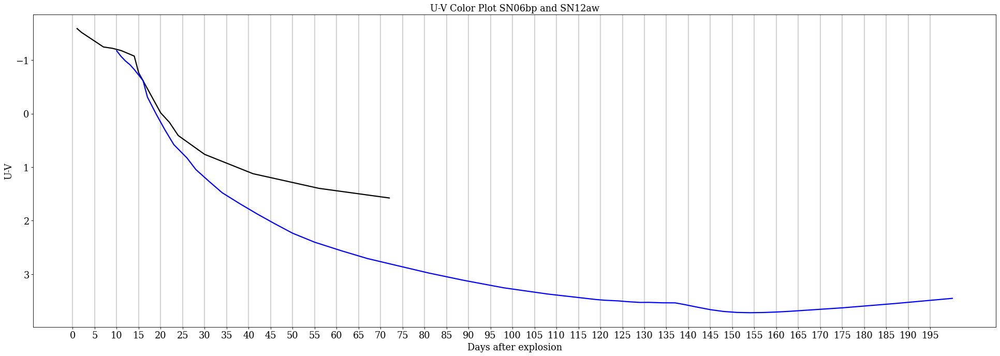

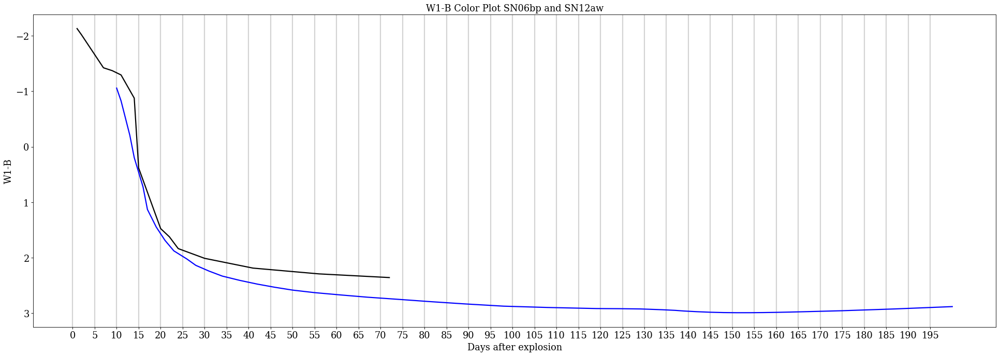

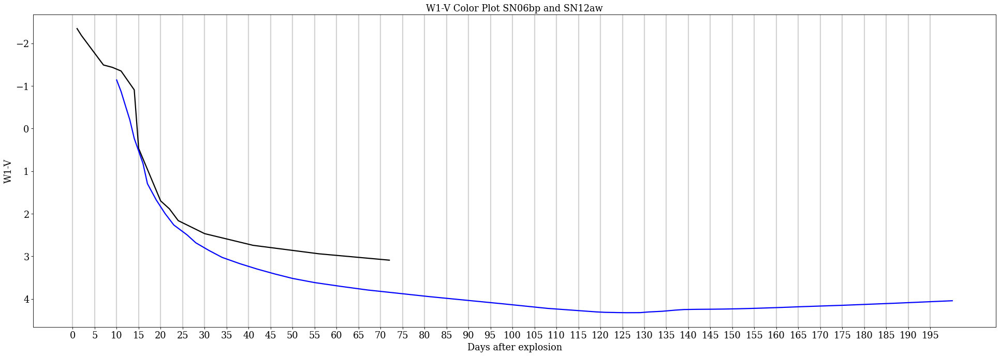

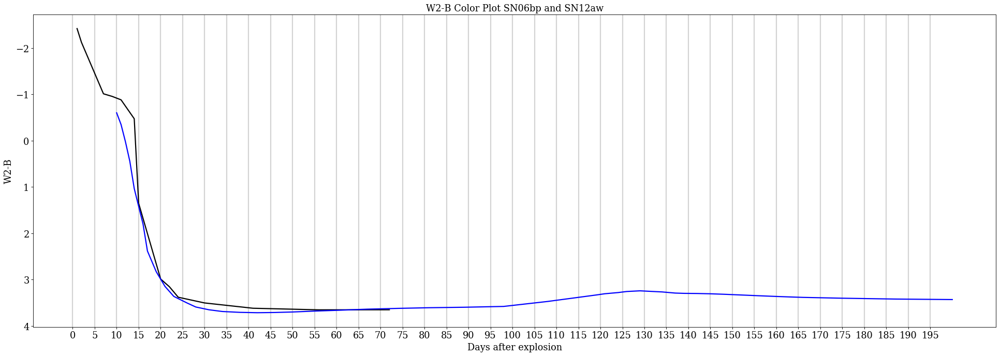

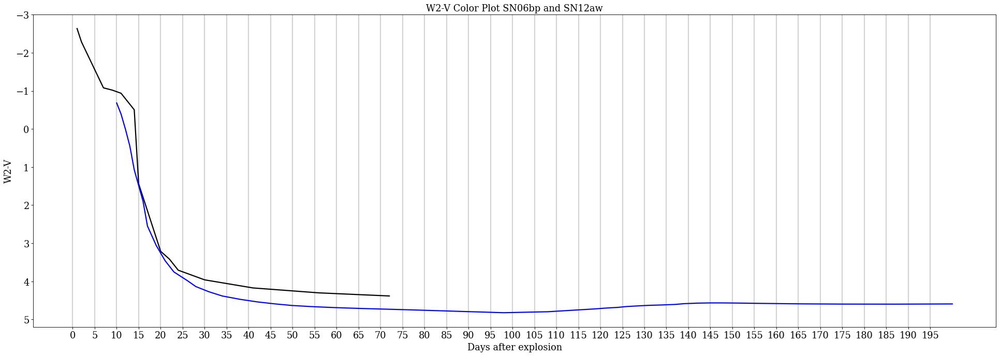

In [18]:
# w2,m2,w1,u,b,v

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('U-B Color Plot SN06bp and SN12aw',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,3]-SN06bp_m_data[:,4],linewidth=2,c='black')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,3]-SN12aw_m_data[:,4],linewidth=2,c='blue')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("U-B",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('U-V Color Plot SN06bp and SN12aw',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,3]-SN06bp_m_data[:,5],linewidth=2,c='black')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,3]-SN12aw_m_data[:,5],linewidth=2,c='blue')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("U-V",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()
# look at the spectra before and after the slope drop off for new features - Calcium?

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W1-B Color Plot SN06bp and SN12aw',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,2]-SN06bp_m_data[:,4],linewidth=2,c='black')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,2]-SN12aw_m_data[:,4],linewidth=2,c='blue')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W1-B",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W1-V Color Plot SN06bp and SN12aw',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,2]-SN06bp_m_data[:,5],linewidth=2,c='black')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,2]-SN12aw_m_data[:,5],linewidth=2,c='blue')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W1-V",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W2-B Color Plot SN06bp and SN12aw',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,0]-SN06bp_m_data[:,4],linewidth=2,c='black')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,0]-SN12aw_m_data[:,4],linewidth=2,c='blue')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W2-B",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W2-V Color Plot SN06bp and SN12aw',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,0]-SN06bp_m_data[:,5],linewidth=2,c='black')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,0]-SN12aw_m_data[:,5],linewidth=2,c='blue')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W2-V",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

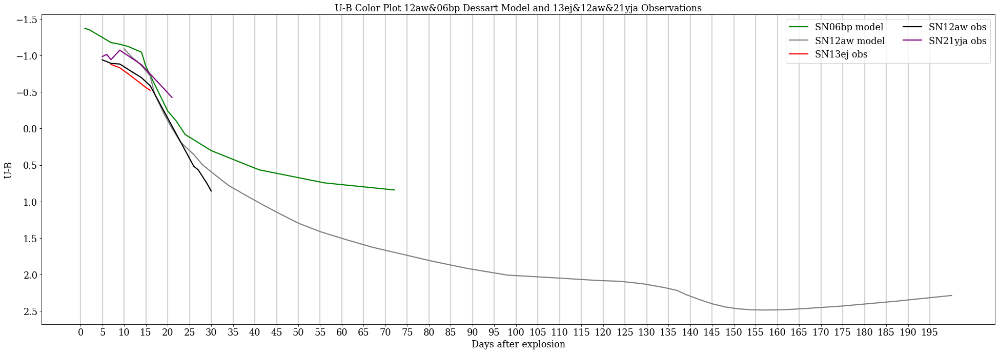

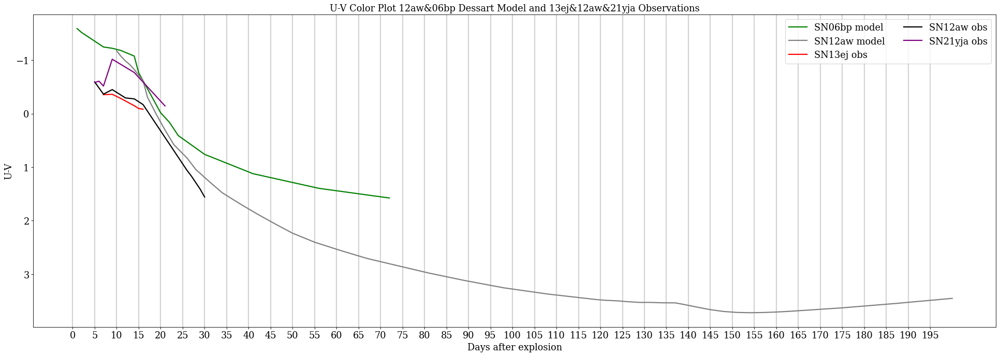

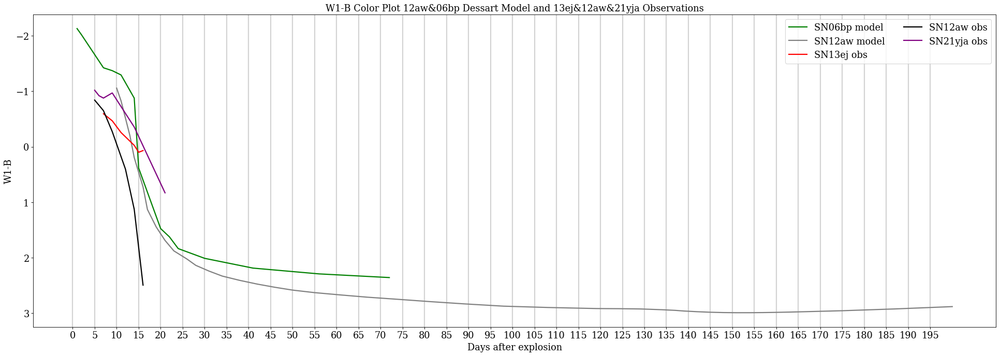

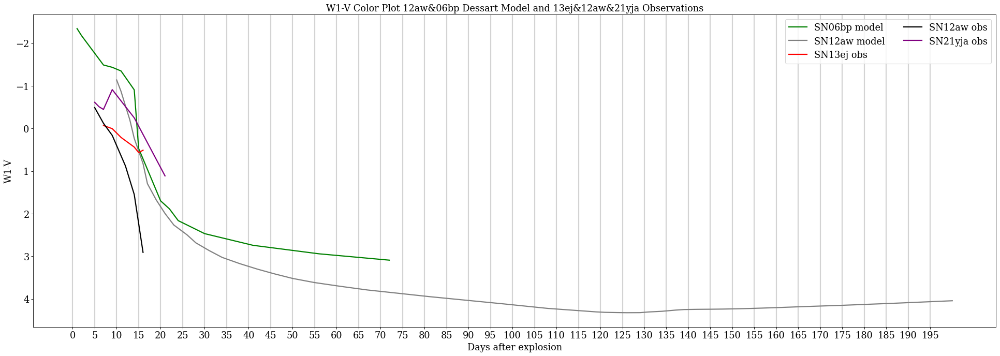

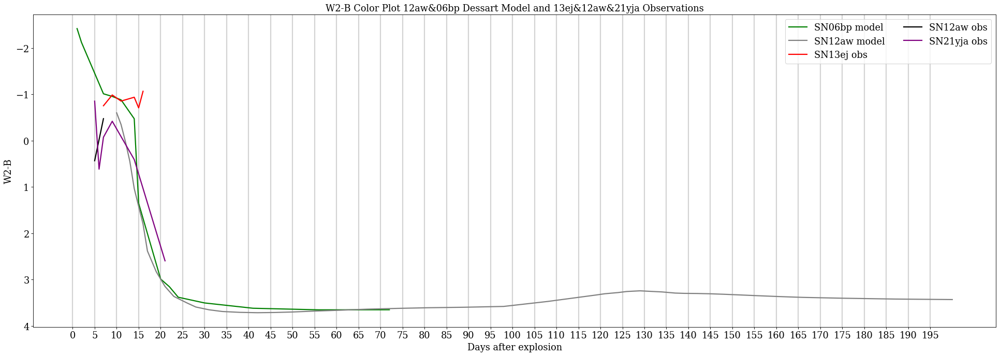

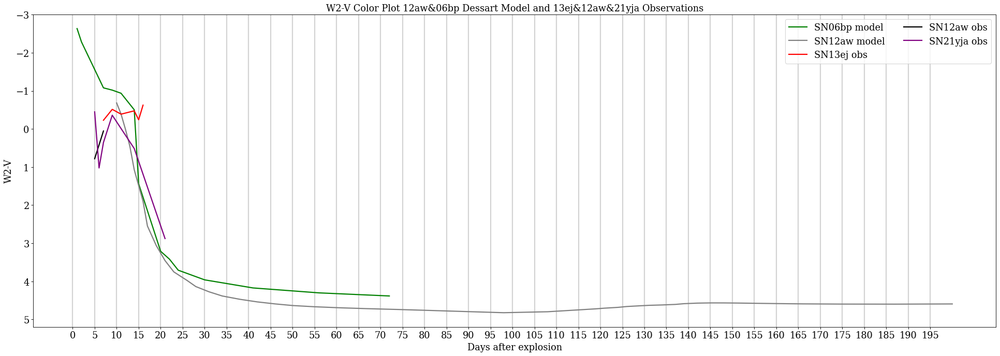

In [19]:
# w2,m2,w1,u,b,v

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('U-B Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,3]-SN06bp_m_data[:,4],linewidth=2,c='green',label='SN06bp model')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,3]-SN12aw_m_data[:,4],linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN13ej_o_data[:,6],SN13ej_o_data[:,3]-SN13ej_o_data[:,4],linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN12aw_o_data[:,6],SN12aw_o_data[:,3]-SN12aw_o_data[:,4],linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN21yja_o_data[:,6],SN21yja_o_data[:,3]-SN21yja_o_data[:,4],linewidth=2,c='purple',label='SN21yja obs')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("U-B",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('U-V Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,3]-SN06bp_m_data[:,5],linewidth=2,c='green',label='SN06bp model')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,3]-SN12aw_m_data[:,5],linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN13ej_o_data[:,6],SN13ej_o_data[:,3]-SN13ej_o_data[:,5],linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN12aw_o_data[:,6],SN12aw_o_data[:,3]-SN12aw_o_data[:,5],linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN21yja_o_data[:,6],SN21yja_o_data[:,3]-SN21yja_o_data[:,5],linewidth=2,c='purple',label='SN21yja obs')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("U-V",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W1-B Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,2]-SN06bp_m_data[:,4],linewidth=2,c='green',label='SN06bp model')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,2]-SN12aw_m_data[:,4],linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN13ej_o_data[:,6],SN13ej_o_data[:,2]-SN13ej_o_data[:,4],linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN12aw_o_data[:,6],SN12aw_o_data[:,2]-SN12aw_o_data[:,4],linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN21yja_o_data[:,6],SN21yja_o_data[:,2]-SN21yja_o_data[:,4],linewidth=2,c='purple',label='SN21yja obs')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W1-B",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W1-V Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,2]-SN06bp_m_data[:,5],linewidth=2,c='green',label='SN06bp model')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,2]-SN12aw_m_data[:,5],linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN13ej_o_data[:,6],SN13ej_o_data[:,2]-SN13ej_o_data[:,5],linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN12aw_o_data[:,6],SN12aw_o_data[:,2]-SN12aw_o_data[:,5],linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN21yja_o_data[:,6],SN21yja_o_data[:,2]-SN21yja_o_data[:,5],linewidth=2,c='purple',label='SN21yja obs')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W1-V",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W2-B Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,0]-SN06bp_m_data[:,4],linewidth=2,c='green',label='SN06bp model')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,0]-SN12aw_m_data[:,4],linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN13ej_o_data[:,6],SN13ej_o_data[:,0]-SN13ej_o_data[:,4],linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN12aw_o_data[:,6],SN12aw_o_data[:,0]-SN12aw_o_data[:,4],linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN21yja_o_data[:,6],SN21yja_o_data[:,0]-SN21yja_o_data[:,4],linewidth=2,c='purple',label='SN21yja obs')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W2-B",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W2-V Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,0]-SN06bp_m_data[:,5],linewidth=2,c='green',label='SN06bp model')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,0]-SN12aw_m_data[:,5],linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN13ej_o_data[:,6],SN13ej_o_data[:,0]-SN13ej_o_data[:,5],linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN12aw_o_data[:,6],SN12aw_o_data[:,0]-SN12aw_o_data[:,5],linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN21yja_o_data[:,6],SN21yja_o_data[:,0]-SN21yja_o_data[:,5],linewidth=2,c='purple',label='SN21yja obs')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W2-V",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

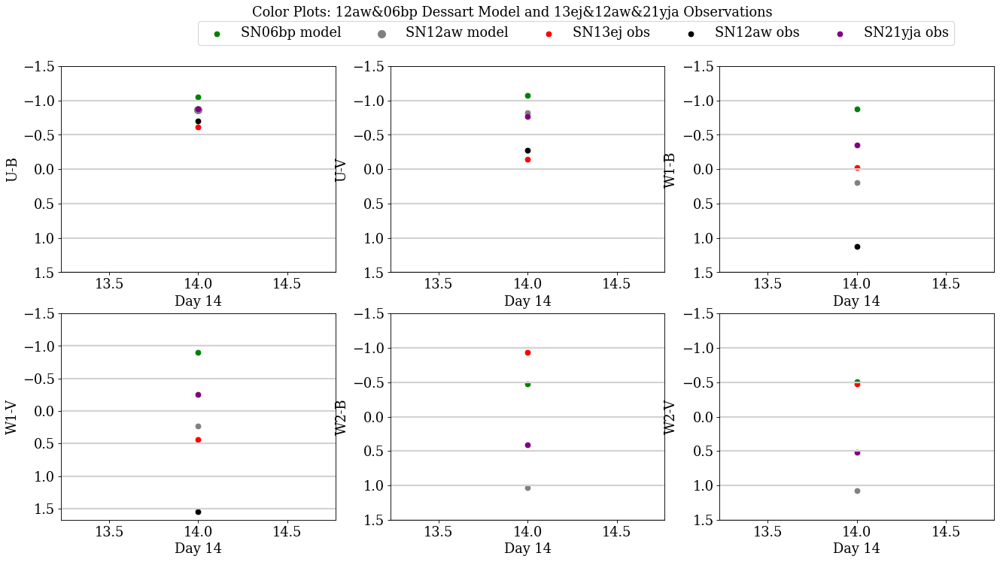

In [20]:
fig = plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.suptitle('Color Plots: 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=16)

plt.subplot(231)
plt.scatter(SN06bp_m_data[5,6],SN06bp_m_data[5,3]-SN06bp_m_data[5,4],c='green',label='SN06bp model')
plt.scatter(SN12aw_m_data[4,6],SN12aw_m_data[4,3]-SN12aw_m_data[4,4],c='grey',label='SN12aw model',s=80)
plt.scatter(SN13ej_o_data[3,6],SN13ej_o_data[3,3]-SN13ej_o_data[3,4],c='red',label='SN13ej obs')
plt.scatter(SN12aw_o_data[4,6],SN12aw_o_data[4,3]-SN12aw_o_data[4,4],c='black',label='SN12aw obs')
plt.scatter(SN21yja_o_data[4,6],SN21yja_o_data[4,3]-SN21yja_o_data[4,4],c='purple',label='SN21yja obs')
plt.xlabel("Day 14",fontsize=16)
plt.ylabel("U-B",fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(np.arange(-1.5, 2, step=0.5),fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='y',color='lightgrey', linestyle='-', linewidth=2)
plt.legend(loc=(0.5,1.1),fontsize=16,ncol=5)

plt.subplot(232)
plt.scatter(SN06bp_m_data[5,6],SN06bp_m_data[5,3]-SN06bp_m_data[5,5],c='green',label='SN06bp model')
plt.scatter(SN12aw_m_data[4,6],SN12aw_m_data[4,3]-SN12aw_m_data[4,5],c='grey',label='SN12aw model')
plt.scatter(SN13ej_o_data[3,6],SN13ej_o_data[3,3]-SN13ej_o_data[3,5],c='red',label='SN13ej obs')
plt.scatter(SN12aw_o_data[4,6],SN12aw_o_data[4,3]-SN12aw_o_data[4,5],c='black',label='SN12aw obs')
plt.scatter(SN21yja_o_data[4,6],SN21yja_o_data[4,3]-SN21yja_o_data[4,5],c='purple',label='SN21yja obs')
plt.xlabel("Day 14",fontsize=16)
plt.ylabel("U-V",fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(np.arange(-1.5, 2, step=0.5),fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='y',color='lightgrey', linestyle='-', linewidth=2)

plt.subplot(233)
plt.scatter(SN06bp_m_data[5,6],SN06bp_m_data[5,2]-SN06bp_m_data[5,4],c='green',label='SN06bp model')
plt.scatter(SN12aw_m_data[4,6],SN12aw_m_data[4,2]-SN12aw_m_data[4,4],c='grey',label='SN12aw model')
plt.scatter(SN13ej_o_data[3,6],SN13ej_o_data[3,2]-SN13ej_o_data[3,4],c='red',label='SN13ej obs')
plt.scatter(SN12aw_o_data[4,6],SN12aw_o_data[4,2]-SN12aw_o_data[4,4],c='black',label='SN12aw obs')
plt.scatter(SN21yja_o_data[4,6],SN21yja_o_data[4,2]-SN21yja_o_data[4,4],c='purple',label='SN21yja obs')
plt.xlabel("Day 14",fontsize=16)
plt.ylabel("W1-B",fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(np.arange(-1.5, 2, step=0.5),fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='y',color='lightgrey', linestyle='-', linewidth=2)

plt.subplot(234)
plt.scatter(SN06bp_m_data[5,6],SN06bp_m_data[5,2]-SN06bp_m_data[5,5],c='green',label='SN06bp model')
plt.scatter(SN12aw_m_data[4,6],SN12aw_m_data[4,2]-SN12aw_m_data[4,5],c='grey',label='SN12aw model')
plt.scatter(SN13ej_o_data[3,6],SN13ej_o_data[3,2]-SN13ej_o_data[3,5],c='red',label='SN13ej obs')
plt.scatter(SN12aw_o_data[4,6],SN12aw_o_data[4,2]-SN12aw_o_data[4,5],c='black',label='SN12aw obs')
plt.scatter(SN21yja_o_data[4,6],SN21yja_o_data[4,2]-SN21yja_o_data[4,5],c='purple',label='SN21yja obs')
plt.xlabel("Day 14",fontsize=16)
plt.ylabel("W1-V",fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(np.arange(-1.5, 2, step=0.5),fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='y',color='lightgrey', linestyle='-', linewidth=2)

plt.subplot(235)
plt.scatter(SN06bp_m_data[5,6],SN06bp_m_data[5,0]-SN06bp_m_data[5,4],c='green',label='SN06bp model')
plt.scatter(SN12aw_m_data[4,6],SN12aw_m_data[4,0]-SN12aw_m_data[4,4],c='grey',label='SN12aw model')
plt.scatter(SN13ej_o_data[3,6],SN13ej_o_data[3,0]-SN13ej_o_data[3,4],c='red',label='SN13ej obs')
plt.scatter(SN12aw_o_data[4,6],SN12aw_o_data[4,0]-SN12aw_o_data[4,4],c='black',label='SN12aw obs')
plt.scatter(SN21yja_o_data[4,6],SN21yja_o_data[4,0]-SN21yja_o_data[4,4],c='purple',label='SN21yja obs')
plt.xlabel("Day 14",fontsize=16)
plt.ylabel("W2-B",fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(np.arange(-1.5, 2, step=0.5),fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='y',color='lightgrey', linestyle='-', linewidth=2)

plt.subplot(236)
plt.scatter(SN06bp_m_data[5,6],SN06bp_m_data[5,0]-SN06bp_m_data[5,5],c='green',label='SN06bp model')
plt.scatter(SN12aw_m_data[4,6],SN12aw_m_data[4,0]-SN12aw_m_data[4,5],c='grey',label='SN12aw model')
plt.scatter(SN13ej_o_data[3,6],SN13ej_o_data[3,0]-SN13ej_o_data[3,5],c='red',label='SN13ej obs')
plt.scatter(SN12aw_o_data[4,6],SN12aw_o_data[4,0]-SN12aw_o_data[4,5],c='black',label='SN12aw obs')
plt.scatter(SN21yja_o_data[4,6],SN21yja_o_data[4,0]-SN21yja_o_data[4,5],c='purple',label='SN21yja obs')
plt.xlabel("Day 14",fontsize=16)
plt.ylabel("W2-V",fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(np.arange(-1.5, 2, step=0.5),fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='y',color='lightgrey', linestyle='-', linewidth=2)

plt.show()

## Comparing photometric and spectral colors

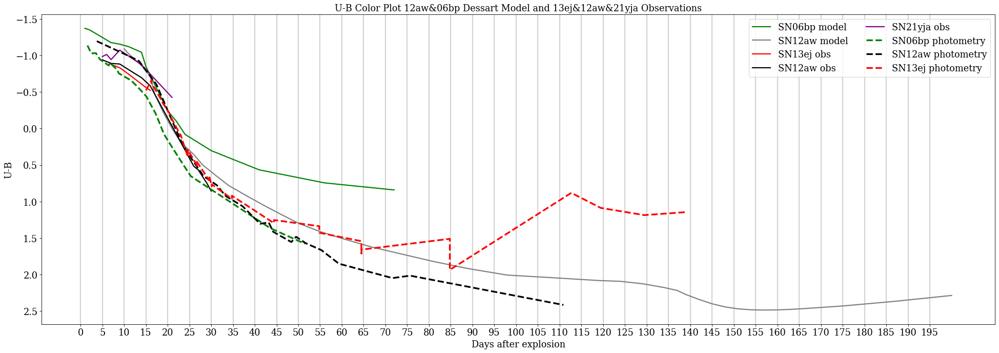

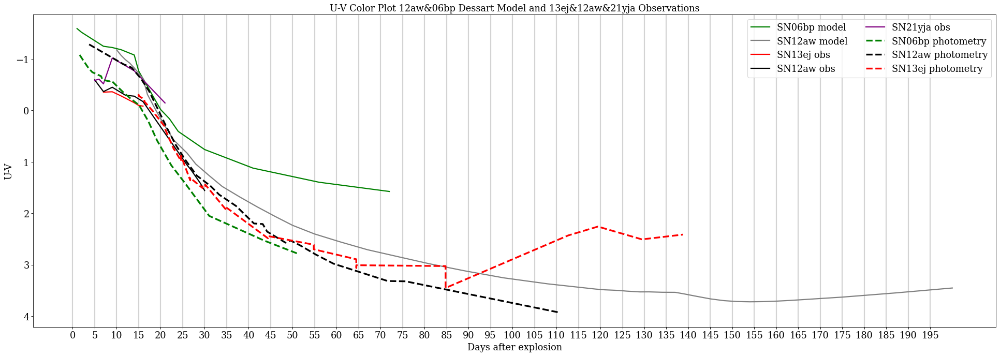

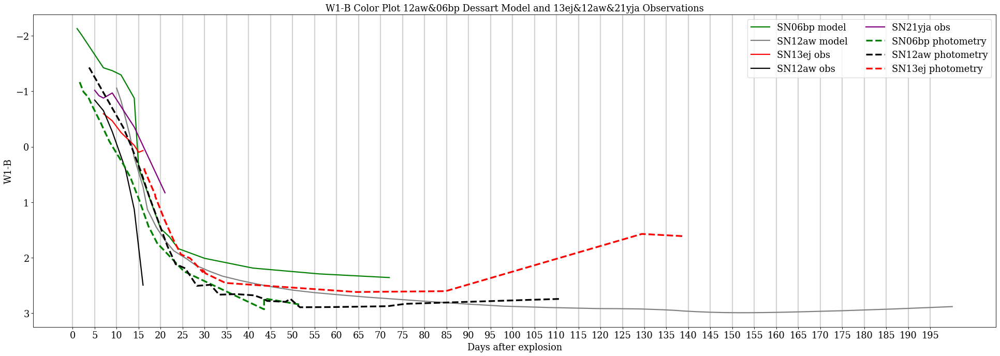

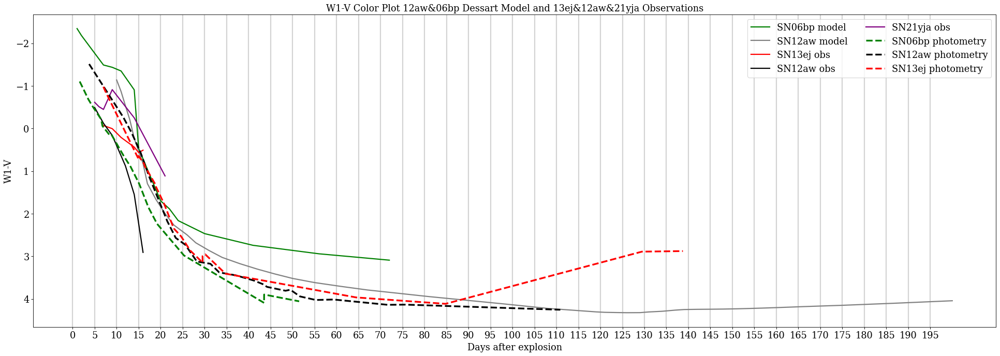

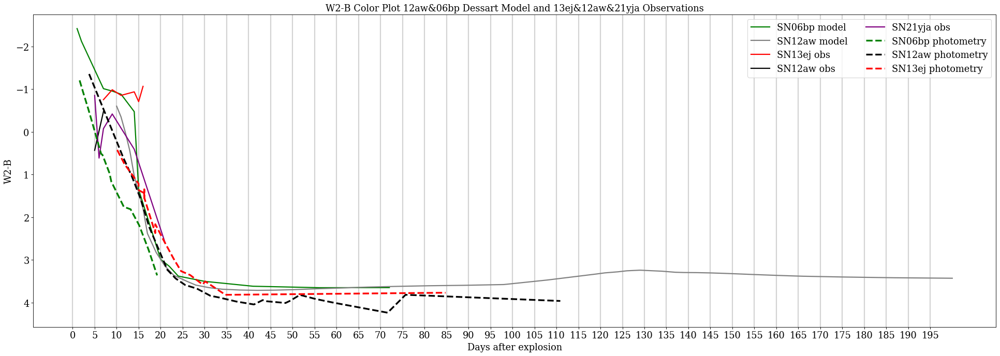

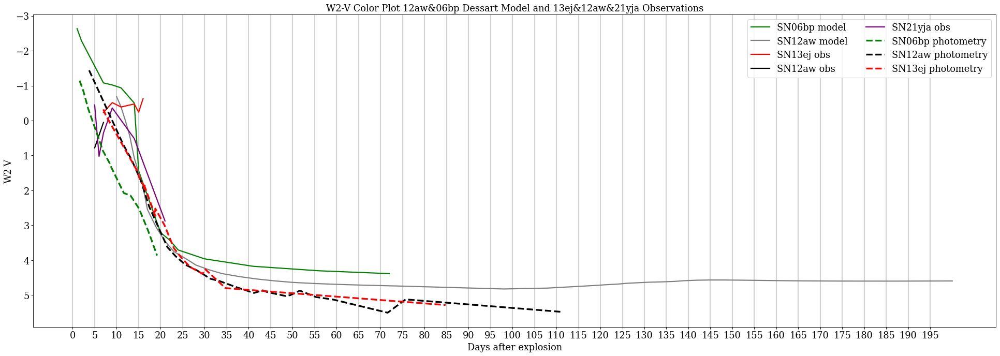

In [21]:
# w2,m2,w1,u,b,v

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('U-B Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,3]-SN06bp_m_data[:,4],linewidth=2,c='green',label='SN06bp model')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,3]-SN12aw_m_data[:,4],linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN13ej_o_data[:,6],SN13ej_o_data[:,3]-SN13ej_o_data[:,4],linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN12aw_o_data[:,6],SN12aw_o_data[:,3]-SN12aw_o_data[:,4],linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN21yja_o_data[:,6],SN21yja_o_data[:,3]-SN21yja_o_data[:,4],linewidth=2,c='purple',label='SN21yja obs')
plt.plot(SN06bp_dse_ub,SN06bp_p_ub,linewidth=3,linestyle='dashed',c='green',label='SN06bp photometry')
plt.plot(SN12aw_dse_ub,SN12aw_p_ub,linewidth=3,linestyle='dashed',c='black',label='SN12aw photometry')
plt.plot(SN13ej_dse_ub,SN13ej_p_ub,linewidth=3,linestyle='dashed',c='red',label='SN13ej photometry')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("U-B",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('U-V Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,3]-SN06bp_m_data[:,5],linewidth=2,c='green',label='SN06bp model')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,3]-SN12aw_m_data[:,5],linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN13ej_o_data[:,6],SN13ej_o_data[:,3]-SN13ej_o_data[:,5],linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN12aw_o_data[:,6],SN12aw_o_data[:,3]-SN12aw_o_data[:,5],linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN21yja_o_data[:,6],SN21yja_o_data[:,3]-SN21yja_o_data[:,5],linewidth=2,c='purple',label='SN21yja obs')
plt.plot(SN06bp_dse_uv,SN06bp_p_uv,linewidth=3,linestyle='dashed',c='green',label='SN06bp photometry')
plt.plot(SN12aw_dse_uv,SN12aw_p_uv,linewidth=3,linestyle='dashed',c='black',label='SN12aw photometry')
plt.plot(SN13ej_dse_uv,SN13ej_p_uv,linewidth=3,linestyle='dashed',c='red',label='SN13ej photometry')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("U-V",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W1-B Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,2]-SN06bp_m_data[:,4],linewidth=2,c='green',label='SN06bp model')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,2]-SN12aw_m_data[:,4],linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN13ej_o_data[:,6],SN13ej_o_data[:,2]-SN13ej_o_data[:,4],linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN12aw_o_data[:,6],SN12aw_o_data[:,2]-SN12aw_o_data[:,4],linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN21yja_o_data[:,6],SN21yja_o_data[:,2]-SN21yja_o_data[:,4],linewidth=2,c='purple',label='SN21yja obs')
plt.plot(SN06bp_dse_uvw1b,SN06bp_p_uvw1b,linewidth=3,linestyle='dashed',c='green',label='SN06bp photometry')
plt.plot(SN12aw_dse_uvw1b,SN12aw_p_uvw1b,linewidth=3,linestyle='dashed',c='black',label='SN12aw photometry')
plt.plot(SN13ej_dse_uvw1b,SN13ej_p_uvw1b,linewidth=3,linestyle='dashed',c='red',label='SN13ej photometry')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W1-B",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W1-V Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,2]-SN06bp_m_data[:,5],linewidth=2,c='green',label='SN06bp model')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,2]-SN12aw_m_data[:,5],linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN13ej_o_data[:,6],SN13ej_o_data[:,2]-SN13ej_o_data[:,5],linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN12aw_o_data[:,6],SN12aw_o_data[:,2]-SN12aw_o_data[:,5],linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN21yja_o_data[:,6],SN21yja_o_data[:,2]-SN21yja_o_data[:,5],linewidth=2,c='purple',label='SN21yja obs')
plt.plot(SN06bp_dse_uvw1v,SN06bp_p_uvw1v,linewidth=3,linestyle='dashed',c='green',label='SN06bp photometry')
plt.plot(SN12aw_dse_uvw1v,SN12aw_p_uvw1v,linewidth=3,linestyle='dashed',c='black',label='SN12aw photometry')
plt.plot(SN13ej_dse_uvw1v,SN13ej_p_uvw1v,linewidth=3,linestyle='dashed',c='red',label='SN13ej photometry')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W1-V",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W2-B Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,0]-SN06bp_m_data[:,4],linewidth=2,c='green',label='SN06bp model')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,0]-SN12aw_m_data[:,4],linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN13ej_o_data[:,6],SN13ej_o_data[:,0]-SN13ej_o_data[:,4],linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN12aw_o_data[:,6],SN12aw_o_data[:,0]-SN12aw_o_data[:,4],linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN21yja_o_data[:,6],SN21yja_o_data[:,0]-SN21yja_o_data[:,4],linewidth=2,c='purple',label='SN21yja obs')
plt.plot(SN06bp_dse_uvw2b,SN06bp_p_uvw2b,linewidth=3,linestyle='dashed',c='green',label='SN06bp photometry')
plt.plot(SN12aw_dse_uvw2b,SN12aw_p_uvw2b,linewidth=3,linestyle='dashed',c='black',label='SN12aw photometry')
plt.plot(SN13ej_dse_uvw2b,SN13ej_p_uvw2b,linewidth=3,linestyle='dashed',c='red',label='SN13ej photometry')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W2-B",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W2-V Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,0]-SN06bp_m_data[:,5],linewidth=2,c='green',label='SN06bp model')
plt.plot(SN12aw_m_data[:,6],SN12aw_m_data[:,0]-SN12aw_m_data[:,5],linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN13ej_o_data[:,6],SN13ej_o_data[:,0]-SN13ej_o_data[:,5],linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN12aw_o_data[:,6],SN12aw_o_data[:,0]-SN12aw_o_data[:,5],linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN21yja_o_data[:,6],SN21yja_o_data[:,0]-SN21yja_o_data[:,5],linewidth=2,c='purple',label='SN21yja obs')
plt.plot(SN06bp_dse_uvw2v,SN06bp_p_uvw2v,linewidth=3,linestyle='dashed',c='green',label='SN06bp photometry')
plt.plot(SN12aw_dse_uvw2v,SN12aw_p_uvw2v,linewidth=3,linestyle='dashed',c='black',label='SN12aw photometry')
plt.plot(SN13ej_dse_uvw2v,SN13ej_p_uvw2v,linewidth=3,linestyle='dashed',c='red',label='SN13ej photometry')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W2-V",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()


## <a id='9a'>Figure 46a: Color Comparisons</a> 
[Table of Contents](#0)

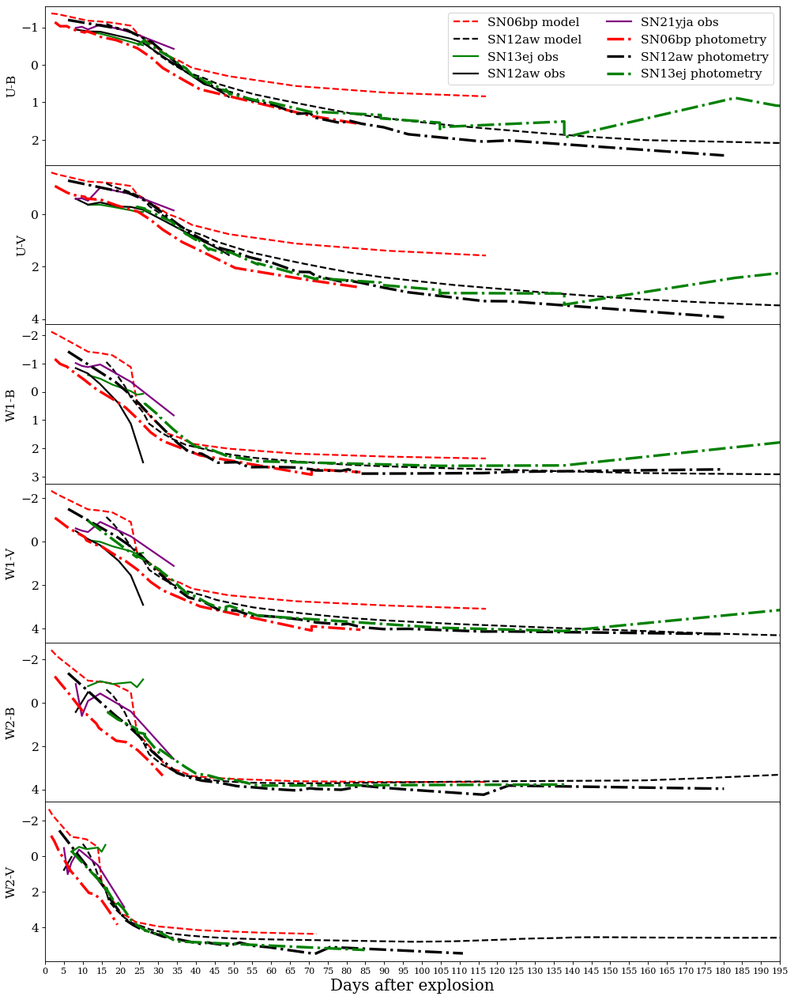

In [255]:
# need to run Figure 45 before this one for font sizes

# w2,m2,w1,u,b,v

fig = plt.figure(figsize=(15, 20), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(6, hspace=0)
axs = gs.subplots(sharex=True, sharey=False)
#fig.suptitle('Color Evolution Comparisons: SN2006bp & SN2012aw Dessart Models vs. SN2012aw, SN2013ej, & SN2021yja Synthetic Photometry vs. SN2006bp, SN2012aw, & SN2013ej Photometry',fontsize=font,y=0.89)
axs[0].plot(SN06bp_m_data[:,6],SN06bp_m_data[:,3]-SN06bp_m_data[:,4],linewidth=2,linestyle='dashed',c='red',label='SN06bp model')
axs[0].plot(SN12aw_m_data[:,6],SN12aw_m_data[:,3]-SN12aw_m_data[:,4],linewidth=2,linestyle='dashed',c='black',label='SN12aw model')
axs[0].plot(SN13ej_o_data[:,6],SN13ej_o_data[:,3]-SN13ej_o_data[:,4],linewidth=2,c='green',label='SN13ej obs')
axs[0].plot(SN12aw_o_data[:,6],SN12aw_o_data[:,3]-SN12aw_o_data[:,4],linewidth=2,c='black',label='SN12aw obs')
axs[0].plot(SN21yja_o_data[:,6],SN21yja_o_data[:,3]-SN21yja_o_data[:,4],linewidth=2,c='purple',label='SN21yja obs')
axs[0].plot(SN06bp_dse_ub,SN06bp_p_ub,linewidth=3,linestyle='dashdot',c='red',label='SN06bp photometry')
axs[0].plot(SN12aw_dse_ub,SN12aw_p_ub,linewidth=3,linestyle='dashdot',c='black',label='SN12aw photometry')
axs[0].plot(SN13ej_dse_ub,SN13ej_p_ub,linewidth=3,linestyle='dashdot',c='green',label='SN13ej photometry')
axs[0].legend(loc=1,fontsize=fontsp,ncol=2)
axs[1].plot(SN06bp_m_data[:,6],SN06bp_m_data[:,3]-SN06bp_m_data[:,5],linewidth=2,linestyle='dashed',c='red',label='SN06bp model')
axs[1].plot(SN12aw_m_data[:,6],SN12aw_m_data[:,3]-SN12aw_m_data[:,5],linewidth=2,linestyle='dashed',c='black',label='SN12aw model')
axs[1].plot(SN13ej_o_data[:,6],SN13ej_o_data[:,3]-SN13ej_o_data[:,5],linewidth=2,c='green',label='SN13ej obs')
axs[1].plot(SN12aw_o_data[:,6],SN12aw_o_data[:,3]-SN12aw_o_data[:,5],linewidth=2,c='black',label='SN12aw obs')
axs[1].plot(SN21yja_o_data[:,6],SN21yja_o_data[:,3]-SN21yja_o_data[:,5],linewidth=2,c='purple',label='SN21yja obs')
axs[1].plot(SN06bp_dse_uv,SN06bp_p_uv,linewidth=3,linestyle='dashdot',c='red',label='SN06bp photometry')
axs[1].plot(SN12aw_dse_uv,SN12aw_p_uv,linewidth=3,linestyle='dashdot',c='black',label='SN12aw photometry')
axs[1].plot(SN13ej_dse_uv,SN13ej_p_uv,linewidth=3,linestyle='dashdot',c='green',label='SN13ej photometry')
axs[2].plot(SN06bp_m_data[:,6],SN06bp_m_data[:,2]-SN06bp_m_data[:,4],linewidth=2,linestyle='dashed',c='red',label='SN06bp model')
axs[2].plot(SN12aw_m_data[:,6],SN12aw_m_data[:,2]-SN12aw_m_data[:,4],linewidth=2,linestyle='dashed',c='black',label='SN12aw model')
axs[2].plot(SN13ej_o_data[:,6],SN13ej_o_data[:,2]-SN13ej_o_data[:,4],linewidth=2,c='green',label='SN13ej obs')
axs[2].plot(SN12aw_o_data[:,6],SN12aw_o_data[:,2]-SN12aw_o_data[:,4],linewidth=2,c='black',label='SN12aw obs')
axs[2].plot(SN21yja_o_data[:,6],SN21yja_o_data[:,2]-SN21yja_o_data[:,4],linewidth=2,c='purple',label='SN21yja obs')
axs[2].plot(SN06bp_dse_uvw1b,SN06bp_p_uvw1b,linewidth=3,linestyle='dashdot',c='red',label='SN06bp photometry')
axs[2].plot(SN12aw_dse_uvw1b,SN12aw_p_uvw1b,linewidth=3,linestyle='dashdot',c='black',label='SN12aw photometry')
axs[2].plot(SN13ej_dse_uvw1b,SN13ej_p_uvw1b,linewidth=3,linestyle='dashdot',c='green',label='SN13ej photometry')
axs[3].plot(SN06bp_m_data[:,6],SN06bp_m_data[:,2]-SN06bp_m_data[:,5],linewidth=2,linestyle='dashed',c='red',label='SN06bp model')
axs[3].plot(SN12aw_m_data[:,6],SN12aw_m_data[:,2]-SN12aw_m_data[:,5],linewidth=2,linestyle='dashed',c='black',label='SN12aw model')
axs[3].plot(SN13ej_o_data[:,6],SN13ej_o_data[:,2]-SN13ej_o_data[:,5],linewidth=2,c='green',label='SN13ej obs')
axs[3].plot(SN12aw_o_data[:,6],SN12aw_o_data[:,2]-SN12aw_o_data[:,5],linewidth=2,c='black',label='SN12aw obs')
axs[3].plot(SN21yja_o_data[:,6],SN21yja_o_data[:,2]-SN21yja_o_data[:,5],linewidth=2,c='purple',label='SN21yja obs')
axs[3].plot(SN06bp_dse_uvw1v,SN06bp_p_uvw1v,linewidth=3,linestyle='dashdot',c='red',label='SN06bp photometry')
axs[3].plot(SN12aw_dse_uvw1v,SN12aw_p_uvw1v,linewidth=3,linestyle='dashdot',c='black',label='SN12aw photometry')
axs[3].plot(SN13ej_dse_uvw1v,SN13ej_p_uvw1v,linewidth=3,linestyle='dashdot',c='green',label='SN13ej photometry')
axs[4].plot(SN06bp_m_data[:,6],SN06bp_m_data[:,0]-SN06bp_m_data[:,4],linewidth=2,linestyle='dashed',c='red',label='SN06bp model')
axs[4].plot(SN12aw_m_data[:,6],SN12aw_m_data[:,0]-SN12aw_m_data[:,4],linewidth=2,linestyle='dashed',c='black',label='SN12aw model')
axs[4].plot(SN13ej_o_data[:,6],SN13ej_o_data[:,0]-SN13ej_o_data[:,4],linewidth=2,c='green',label='SN13ej obs')
axs[4].plot(SN12aw_o_data[:,6],SN12aw_o_data[:,0]-SN12aw_o_data[:,4],linewidth=2,c='black',label='SN12aw obs')
axs[4].plot(SN21yja_o_data[:,6],SN21yja_o_data[:,0]-SN21yja_o_data[:,4],linewidth=2,c='purple',label='SN21yja obs')
axs[4].plot(SN06bp_dse_uvw2b,SN06bp_p_uvw2b,linewidth=3,linestyle='dashdot',c='red',label='SN06bp photometry')
axs[4].plot(SN12aw_dse_uvw2b,SN12aw_p_uvw2b,linewidth=3,linestyle='dashdot',c='black',label='SN12aw photometry')
axs[4].plot(SN13ej_dse_uvw2b,SN13ej_p_uvw2b,linewidth=3,linestyle='dashdot',c='green',label='SN13ej photometry')
axs[5].plot(SN06bp_m_data[:,6],SN06bp_m_data[:,0]-SN06bp_m_data[:,5],linewidth=2,linestyle='dashed',c='red',label='SN06bp model')
axs[5].plot(SN12aw_m_data[:,6],SN12aw_m_data[:,0]-SN12aw_m_data[:,5],linewidth=2,linestyle='dashed',c='black',label='SN12aw model')
axs[5].plot(SN13ej_o_data[:,6],SN13ej_o_data[:,0]-SN13ej_o_data[:,5],linewidth=2,c='green',label='SN13ej obs')
axs[5].plot(SN12aw_o_data[:,6],SN12aw_o_data[:,0]-SN12aw_o_data[:,5],linewidth=2,c='black',label='SN12aw obs')
axs[5].plot(SN21yja_o_data[:,6],SN21yja_o_data[:,0]-SN21yja_o_data[:,5],linewidth=2,c='purple',label='SN21yja obs')
axs[5].plot(SN06bp_dse_uvw2v,SN06bp_p_uvw2v,linewidth=3,linestyle='dashdot',c='red',label='SN06bp photometry')
axs[5].plot(SN12aw_dse_uvw2v,SN12aw_p_uvw2v,linewidth=3,linestyle='dashdot',c='black',label='SN12aw photometry')
axs[5].plot(SN13ej_dse_uvw2v,SN13ej_p_uvw2v,linewidth=3,linestyle='dashdot',c='green',label='SN13ej photometry')
# Hide x labels and tick labels for all but bottom plot.
for ax in axs:
    ax.label_outer()
plt.xlabel("Days after explosion",fontsize=fontps)
# Set y label
axs[0].set(ylabel='U-B')
axs[1].set(ylabel='U-V')
axs[2].set(ylabel='W1-B')
axs[3].set(ylabel='W1-V')
axs[4].set(ylabel='W2-B')
axs[5].set(ylabel='W2-V')
plt.xlim(0,120)
plt.xticks(np.arange(0, 200, step=5),fontsize=10)
#plt.yticks(fontsize=16)
for ax in axs:
    ax.invert_yaxis()
    #ax.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.savefig("colorcomparisons_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

## Comparing photometric and spectral colors with error

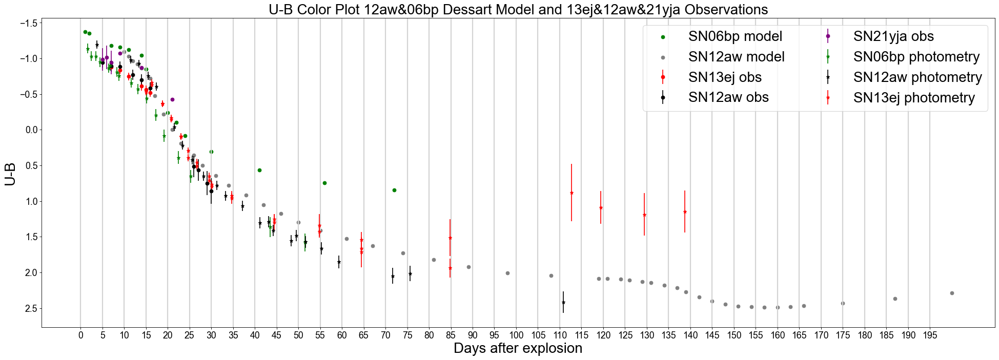

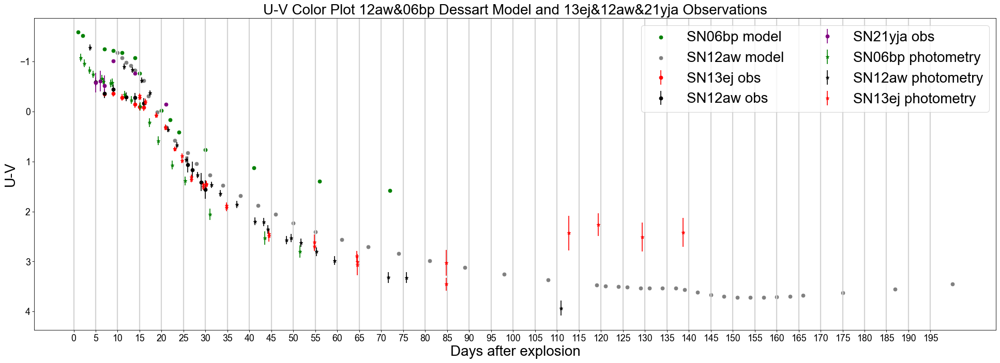

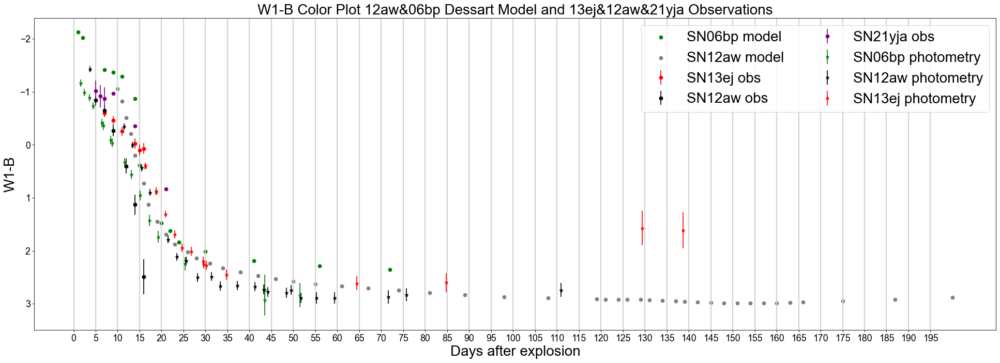

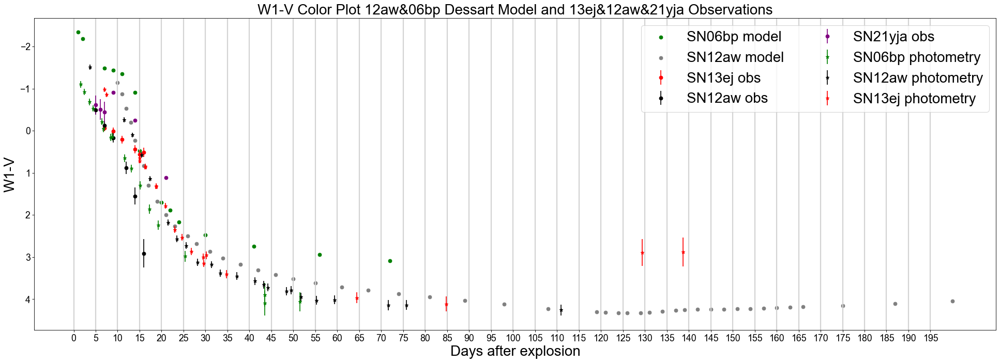

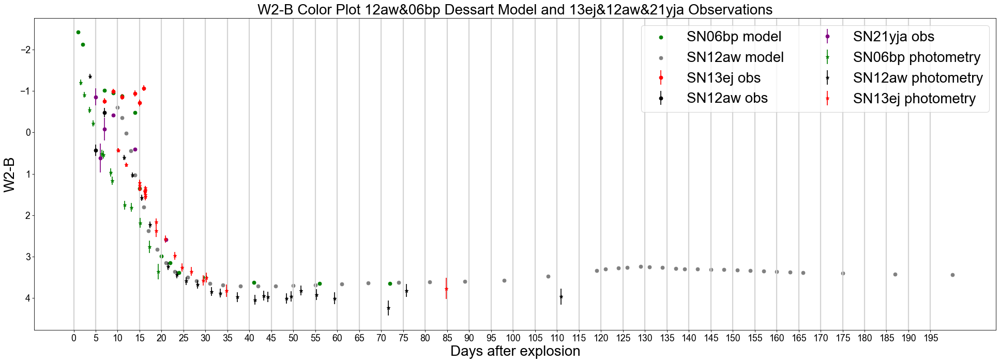

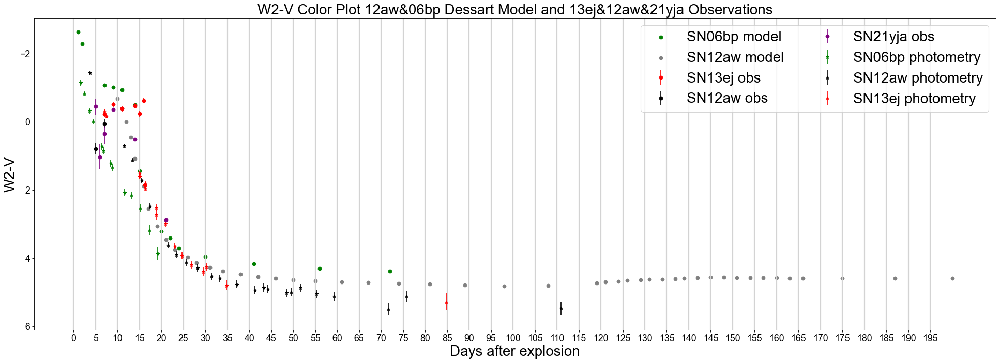

In [71]:
# w2,m2,w1,u,b,v

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('U-B Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.scatter([SN06bp_m_data[:,6]],[SN06bp_m_data[:,3]-SN06bp_m_data[:,4]],c='green',label='SN06bp model')
plt.scatter([SN12aw_m_data[:,6]],[SN12aw_m_data[:,3]-SN12aw_m_data[:,4]],c='grey',label='SN12aw model')
plt.errorbar(SN13ej_o_data[:,6],SN13ej_o_data[:,3]-SN13ej_o_data[:,4],yerr=np.sqrt(SN13ej_o_magerr[:,3]**2 + SN13ej_o_magerr[:,4]**2),fmt="o",c='red',label='SN13ej obs')
plt.errorbar(SN12aw_o_data[:,6],SN12aw_o_data[:,3]-SN12aw_o_data[:,4],yerr=np.sqrt(SN12aw_o_magerr[:,3]**2+SN12aw_o_magerr[:,4]**2),fmt="o",c='black',label='SN12aw obs')
plt.errorbar(SN21yja_o_data[:,6],SN21yja_o_data[:,3]-SN21yja_o_data[:,4],yerr=np.sqrt(SN21yja_o_magerr[:,3]**2+SN21yja_o_magerr[:,4]**2),fmt="o",c='purple',label='SN21yja obs')
plt.errorbar(SN06bp_dse_ub,SN06bp_p_ub,yerr=SN06bp_err_ub,fmt="*",c='green',label='SN06bp photometry')
plt.errorbar(SN12aw_dse_ub,SN12aw_p_ub,yerr=SN12aw_err_ub,fmt="*",c='black',label='SN12aw photometry')
plt.errorbar(SN13ej_dse_ub,SN13ej_p_ub,yerr=SN13ej_err_ub,fmt="*",c='red',label='SN13ej photometry')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("U-B",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('U-V Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.scatter([SN06bp_m_data[:,6]],[SN06bp_m_data[:,3]-SN06bp_m_data[:,5]],c='green',label='SN06bp model')
plt.scatter([SN12aw_m_data[:,6]],[SN12aw_m_data[:,3]-SN12aw_m_data[:,5]],c='grey',label='SN12aw model')
plt.errorbar(SN13ej_o_data[:,6],SN13ej_o_data[:,3]-SN13ej_o_data[:,5],yerr=np.sqrt(SN13ej_o_magerr[:,3]**2 + SN13ej_o_magerr[:,5]**2),fmt="o",c='red',label='SN13ej obs')
plt.errorbar(SN12aw_o_data[:,6],SN12aw_o_data[:,3]-SN12aw_o_data[:,5],yerr=np.sqrt(SN12aw_o_magerr[:,3]**2+SN12aw_o_magerr[:,5]**2),fmt="o",c='black',label='SN12aw obs')
plt.errorbar(SN21yja_o_data[:,6],SN21yja_o_data[:,3]-SN21yja_o_data[:,5],yerr=np.sqrt(SN21yja_o_magerr[:,3]**2+SN21yja_o_magerr[:,5]**2),fmt="o",c='purple',label='SN21yja obs')
plt.errorbar(SN06bp_dse_uv,SN06bp_p_uv,yerr=SN06bp_err_uv,fmt="*",c='green',label='SN06bp photometry')
plt.errorbar(SN12aw_dse_uv,SN12aw_p_uv,yerr=SN12aw_err_uv,fmt="*",c='black',label='SN12aw photometry')
plt.errorbar(SN13ej_dse_uv,SN13ej_p_uv,yerr=SN13ej_err_uv,fmt="*",c='red',label='SN13ej photometry')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("U-V",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W1-B Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.scatter([SN06bp_m_data[:,6]],[SN06bp_m_data[:,2]-SN06bp_m_data[:,4]],c='green',label='SN06bp model')
plt.scatter([SN12aw_m_data[:,6]],[SN12aw_m_data[:,2]-SN12aw_m_data[:,4]],c='grey',label='SN12aw model')
plt.errorbar(SN13ej_o_data[:,6],SN13ej_o_data[:,2]-SN13ej_o_data[:,4],yerr=np.sqrt(SN13ej_o_magerr[:,2]**2 + SN13ej_o_magerr[:,4]**2),fmt="o",c='red',label='SN13ej obs')
plt.errorbar(SN12aw_o_data[:,6],SN12aw_o_data[:,2]-SN12aw_o_data[:,4],yerr=np.sqrt(SN12aw_o_magerr[:,2]**2+SN12aw_o_magerr[:,4]**2),fmt="o",c='black',label='SN12aw obs')
plt.errorbar(SN21yja_o_data[:,6],SN21yja_o_data[:,2]-SN21yja_o_data[:,4],yerr=np.sqrt(SN21yja_o_magerr[:,2]**2+SN21yja_o_magerr[:,4]**2),fmt="o",c='purple',label='SN21yja obs')
plt.errorbar(SN06bp_dse_uvw1b,SN06bp_p_uvw1b,yerr=SN06bp_err_uvw1b,fmt="*",c='green',label='SN06bp photometry')
plt.errorbar(SN12aw_dse_uvw1b,SN12aw_p_uvw1b,yerr=SN12aw_err_uvw1b,fmt="*",c='black',label='SN12aw photometry')
plt.errorbar(SN13ej_dse_uvw1b,SN13ej_p_uvw1b,yerr=SN13ej_err_uvw1b,fmt="*",c='red',label='SN13ej photometry')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W1-B",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W1-V Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.scatter([SN06bp_m_data[:,6]],[SN06bp_m_data[:,2]-SN06bp_m_data[:,5]],c='green',label='SN06bp model')
plt.scatter([SN12aw_m_data[:,6]],[SN12aw_m_data[:,2]-SN12aw_m_data[:,5]],c='grey',label='SN12aw model')
plt.errorbar(SN13ej_o_data[:,6],SN13ej_o_data[:,2]-SN13ej_o_data[:,5],yerr=np.sqrt(SN13ej_o_magerr[:,2]**2 + SN13ej_o_magerr[:,5]**2),fmt="o",c='red',label='SN13ej obs')
plt.errorbar(SN12aw_o_data[:,6],SN12aw_o_data[:,2]-SN12aw_o_data[:,5],yerr=np.sqrt(SN12aw_o_magerr[:,2]**2+SN12aw_o_magerr[:,5]**2),fmt="o",c='black',label='SN12aw obs')
plt.errorbar(SN21yja_o_data[:,6],SN21yja_o_data[:,2]-SN21yja_o_data[:,5],yerr=np.sqrt(SN21yja_o_magerr[:,2]**2+SN21yja_o_magerr[:,5]**2),fmt="o",c='purple',label='SN21yja obs')
plt.errorbar(SN06bp_dse_uvw1v,SN06bp_p_uvw1v,yerr=SN06bp_err_uvw1v,fmt="*",c='green',label='SN06bp photometry')
plt.errorbar(SN12aw_dse_uvw1v,SN12aw_p_uvw1v,yerr=SN12aw_err_uvw1v,fmt="*",c='black',label='SN12aw photometry')
plt.errorbar(SN13ej_dse_uvw1v,SN13ej_p_uvw1v,yerr=SN13ej_err_uvw1v,fmt="*",c='red',label='SN13ej photometry')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W1-V",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W2-B Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.scatter([SN06bp_m_data[:,6]],[SN06bp_m_data[:,0]-SN06bp_m_data[:,4]],c='green',label='SN06bp model')
plt.scatter([SN12aw_m_data[:,6]],[SN12aw_m_data[:,0]-SN12aw_m_data[:,4]],c='grey',label='SN12aw model')
plt.errorbar(SN13ej_o_data[:,6],SN13ej_o_data[:,0]-SN13ej_o_data[:,4],yerr=np.sqrt(SN13ej_o_magerr[:,0]**2 + SN13ej_o_magerr[:,4]**2),fmt="o",c='red',label='SN13ej obs')
plt.errorbar(SN12aw_o_data[:,6],SN12aw_o_data[:,0]-SN12aw_o_data[:,4],yerr=np.sqrt(SN12aw_o_magerr[:,0]**2+SN12aw_o_magerr[:,4]**2),fmt="o",c='black',label='SN12aw obs')
plt.errorbar(SN21yja_o_data[:,6],SN21yja_o_data[:,0]-SN21yja_o_data[:,4],yerr=np.sqrt(SN21yja_o_magerr[:,0]**2+SN21yja_o_magerr[:,4]**2),fmt="o",c='purple',label='SN21yja obs')
plt.errorbar(SN06bp_dse_uvw2b,SN06bp_p_uvw2b,yerr=SN06bp_err_uvw2b,fmt="*",c='green',label='SN06bp photometry')
plt.errorbar(SN12aw_dse_uvw2b,SN12aw_p_uvw2b,yerr=SN12aw_err_uvw2b,fmt="*",c='black',label='SN12aw photometry')
plt.errorbar(SN13ej_dse_uvw2b,SN13ej_p_uvw2b,yerr=SN13ej_err_uvw2b,fmt="*",c='red',label='SN13ej photometry')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W2-B",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('W2-V Color Plot 12aw&06bp Dessart Model and 13ej&12aw&21yja Observations',fontsize=font)
plt.scatter([SN06bp_m_data[:,6]],[SN06bp_m_data[:,0]-SN06bp_m_data[:,5]],c='green',label='SN06bp model')
plt.scatter([SN12aw_m_data[:,6]],[SN12aw_m_data[:,0]-SN12aw_m_data[:,5]],c='grey',label='SN12aw model')
plt.errorbar(SN13ej_o_data[:,6],SN13ej_o_data[:,0]-SN13ej_o_data[:,5],yerr=np.sqrt(SN13ej_o_magerr[:,0]**2 + SN13ej_o_magerr[:,5]**2),fmt="o",c='red',label='SN13ej obs')
plt.errorbar(SN12aw_o_data[:,6],SN12aw_o_data[:,0]-SN12aw_o_data[:,5],yerr=np.sqrt(SN12aw_o_magerr[:,0]**2+SN12aw_o_magerr[:,5]**2),fmt="o",c='black',label='SN12aw obs')
plt.errorbar(SN21yja_o_data[:,6],SN21yja_o_data[:,0]-SN21yja_o_data[:,5],yerr=np.sqrt(SN21yja_o_magerr[:,0]**2+SN21yja_o_magerr[:,5]**2),fmt="o",c='purple',label='SN21yja obs')
plt.errorbar(SN06bp_dse_uvw2v,SN06bp_p_uvw2v,yerr=SN06bp_err_uvw2v,fmt="*",c='green',label='SN06bp photometry')
plt.errorbar(SN12aw_dse_uvw2v,SN12aw_p_uvw2v,yerr=SN12aw_err_uvw2v,fmt="*",c='black',label='SN12aw photometry')
plt.errorbar(SN13ej_dse_uvw2v,SN13ej_p_uvw2v,yerr=SN13ej_err_uvw2v,fmt="*",c='red',label='SN13ej photometry')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Days after explosion",fontsize=font)
plt.ylabel("W2-V",fontsize=font)
plt.xticks(np.arange(0, 200, step=5),fontsize=16)
plt.yticks(fontsize=16)
plt.gca().invert_yaxis()
plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)
plt.show()

# <a id='10'>Photometry Check</a> 
[Table of Contents](#0)

### Sanity check for 12aw bc colors were flat

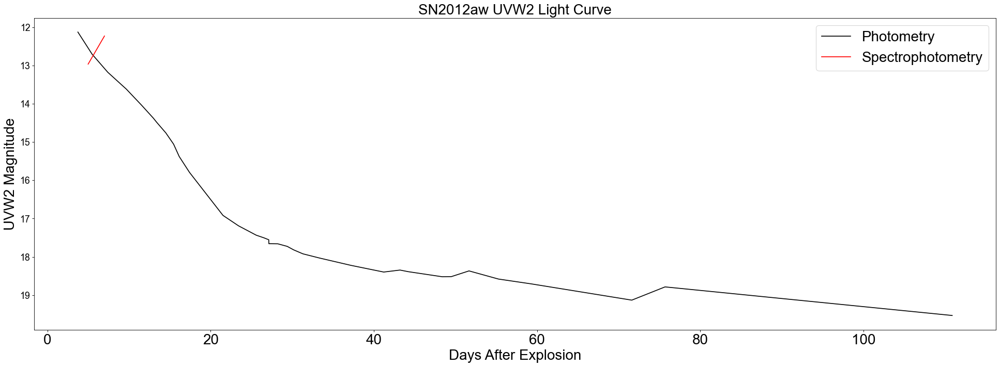

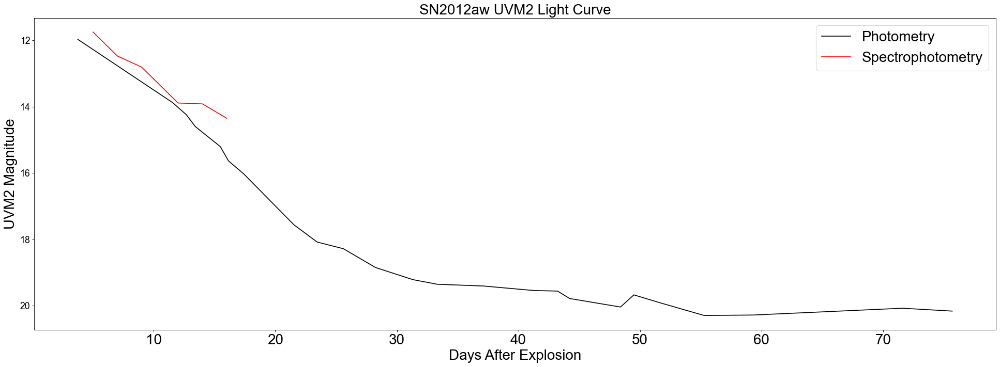

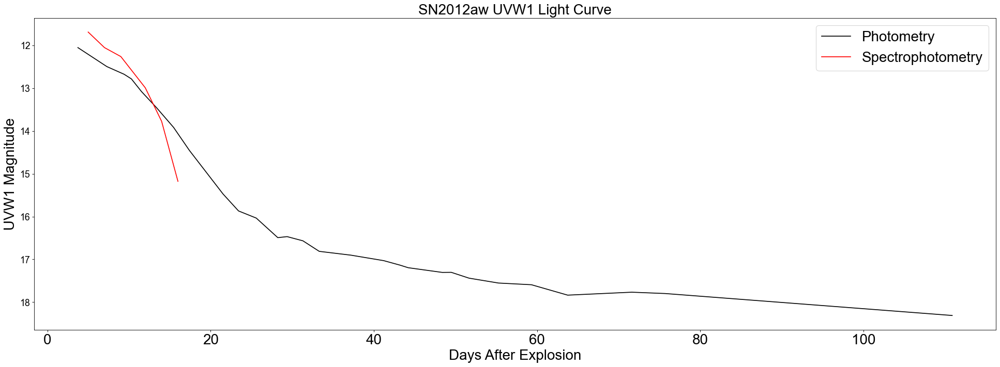

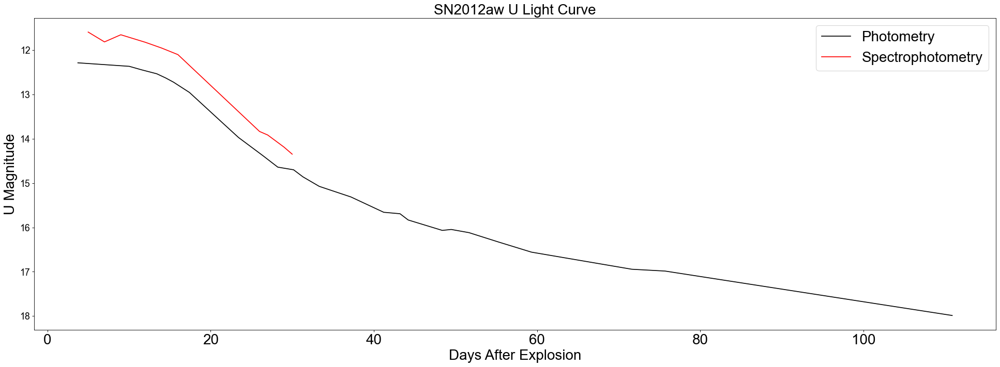

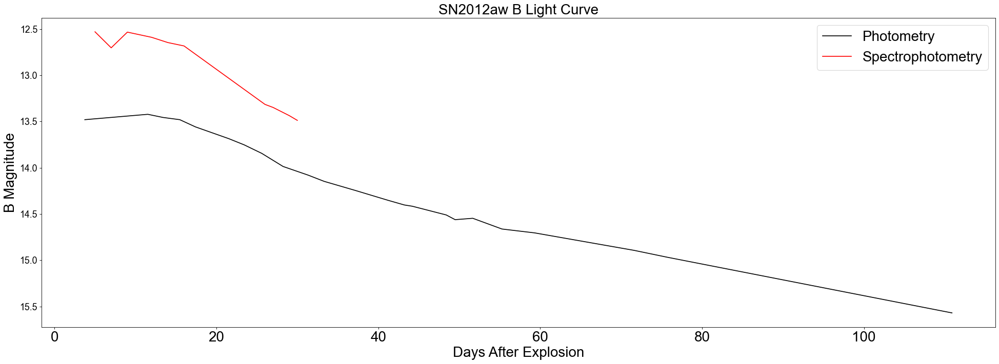

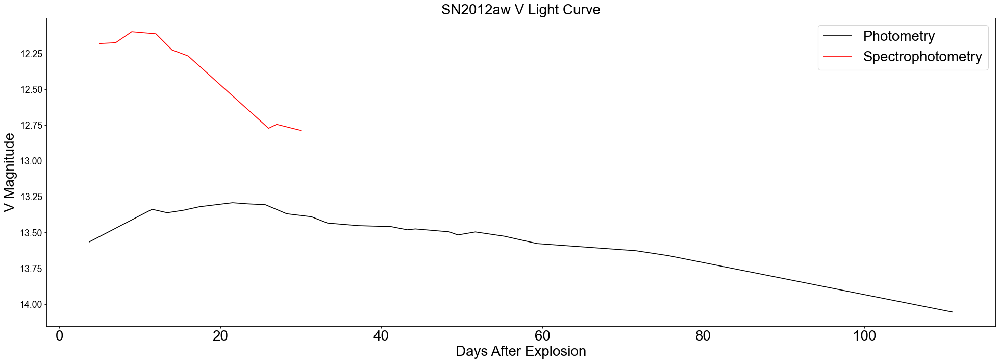

In [73]:
# SN2012aw mjd = 56002
mjdexplosion = 56002

# defining column names and data types to pass to read_csv function
names = ['filter', 'mjd', 'mag', 'magerr', 'exposure', 'elapse']
types = {'filter': str, 'mjd': float, 'mag': float, 'magerr': float, 'exposure': float, 'elapse': float}

# import dat file to dataframe
df = pd.read_csv(SN2012aw_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# function with outputs colorseries and dateseries
def create_lc(df, filter1):

    # creates copy of dataframe
    func_df = df.copy()

    # removes unnecessary filters
    # resets index of dataframe for later lines
    # loc is a filtering function for pandas dataframes
    # .isin is a function that checks equality for more than one value (filter1 and filter2 for us)
    func_df = func_df.loc[func_df['filter'].isin([filter1])].reset_index(drop=True)
    
    # returns two columns for color and date
    return func_df['mjd'], func_df['filter'], func_df['mag']

w2_fil = 0
m2_fil = 1
w1_fil = 2
u_fil = 3
b_fil = 4
v_fil = 5
filters = [['UVW2',w2_fil],['UVM2',m2_fil],['UVW1',w1_fil],['U',u_fil],['B',b_fil],['V',v_fil]]

for filter1,filter2 in filters:

    time_phot, filter_phot, mag_phot = create_lc(df, filter1)

    fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
    plt.title('SN2012aw ' + filter1 + ' Light Curve',fontsize=font)
    plt.plot(time_phot-mjdexplosion,mag_phot,c='black',label='Photometry')
    plt.plot(SN12aw_o_data[:,6],SN12aw_o_data[:,filter2],c='red',label='Spectrophotometry')
    plt.xlabel('Days After Explosion',fontsize=font)
    plt.ylabel(filter1 + ' Magnitude',fontsize=font)
    plt.yticks(fontsize=16)
    plt.legend()
    plt.gca().invert_yaxis()
    #plt.gca().get_xaxis().get_major_formatter().set_useOffset(False)
    #plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)

plt.show()

### Comparing flux levels for reddening for 06bp

In [ ]:
SN06bp_modeldata_red3 = [[SN06bp_1half_wave_mred3, SN06bp_1half_flux_mred3],
                        [SN06bp_2half_wave_mred3, SN06bp_2half_flux_mred3],
                        [SN06bp_7half_wave_mred3, SN06bp_7half_flux_mred3],
                        [SN06bp_9half_wave_mred3, SN06bp_9half_flux_mred3],
                        [SN06bp_11_wave_mred3, SN06bp_11_flux_mred3],
                        [SN06bp_14half_wave_mred3, SN06bp_14half_flux_mred3],
                        [SN06bp_15half_wave_mred3, SN06bp_15half_flux_mred3],
                        [SN06bp_20half_wave_mred3, SN06bp_20half_flux_mred3],
                        [SN06bp_22_wave_mred3, SN06bp_22_flux_mred3],
                        [SN06bp_24_wave_mred3, SN06bp_24_flux_mred3],
                        [SN06bp_30_wave_mred3, SN06bp_30_flux_mred3],
                        [SN06bp_41half_wave_mred3, SN06bp_41half_flux_mred3],
                        [SN06bp_56half_wave_mred3, SN06bp_56half_flux_mred3],
                        [SN06bp_72half_wave_mred3, SN06bp_72half_flux_mred3]]
# SN06bp model
SN06bp_mred3_mag = []
for wavered3,fluxred3 in SN06bp_modeldata_red3:
    SN06bp_mred3_mag.append(specin_countsout(wavered3,fluxred3))
SN06bp_mred3_mag = np.array(SN06bp_mred3_mag)
SN06bp_mred3_shape = (len(SN06bp_modeldata_red3),6)
SN06bp_mred3_mag = SN06bp_mred3_mag.reshape(SN06bp_mred3_shape)
SN06bp_mred3_mag = np.matrix(SN06bp_mred3_mag)
# date
SN06bp_mred3_date = [1,2,7,9,11,14,15,20,22,24,30,41,56,72]
SN06bp_mred3_date = np.array(SN06bp_mred3_date)
# append date for ease of access
SN06bp_mred3_data = np.c_[SN06bp_mred3_mag,SN06bp_mred3_date]

<ipython-input-63-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-63-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])


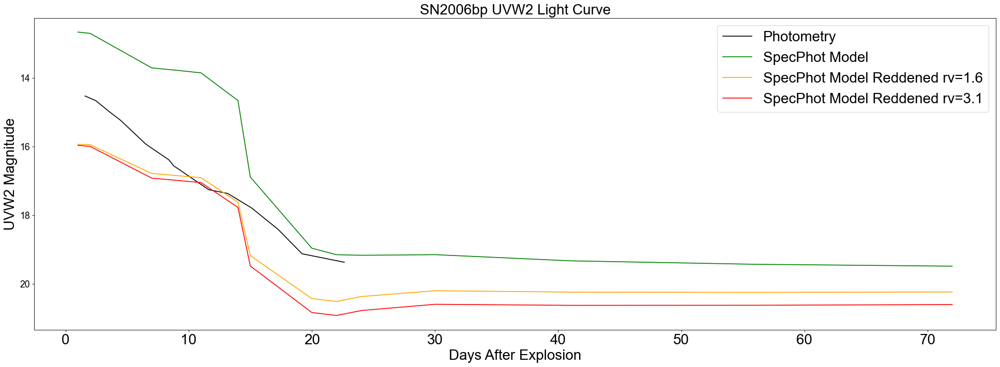

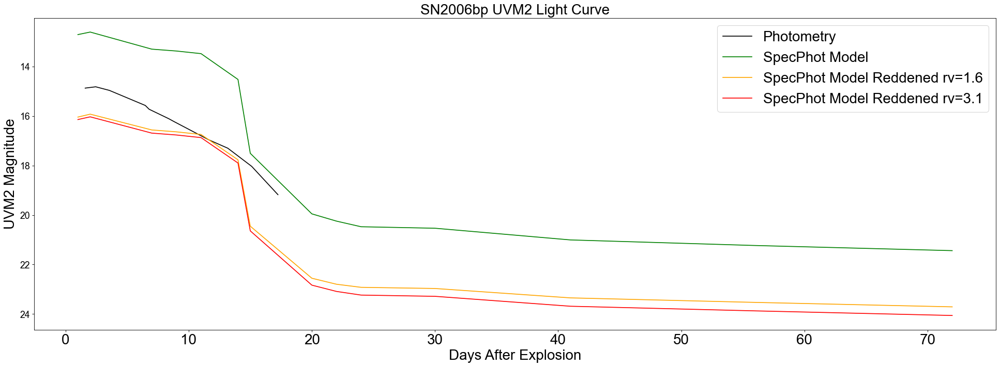

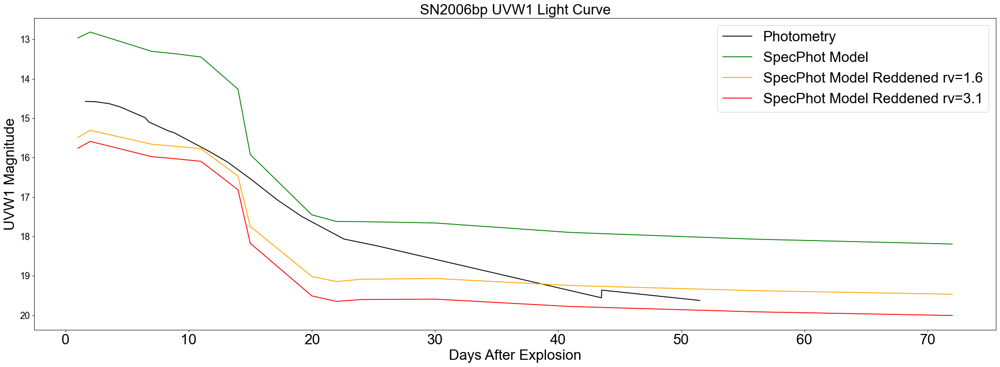

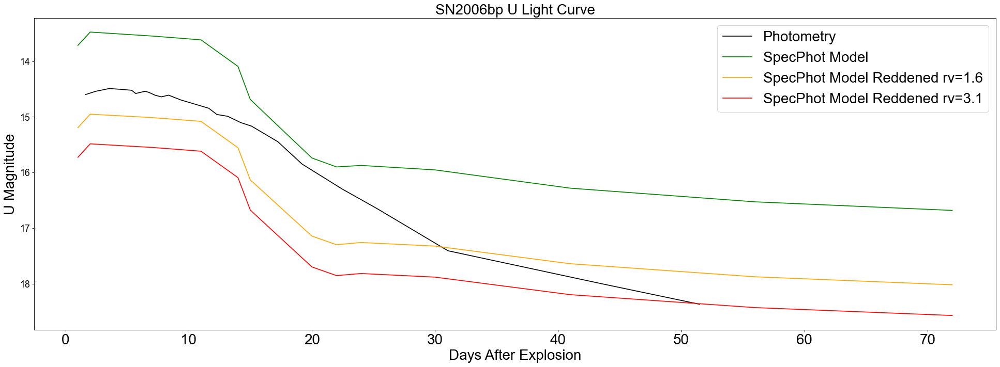

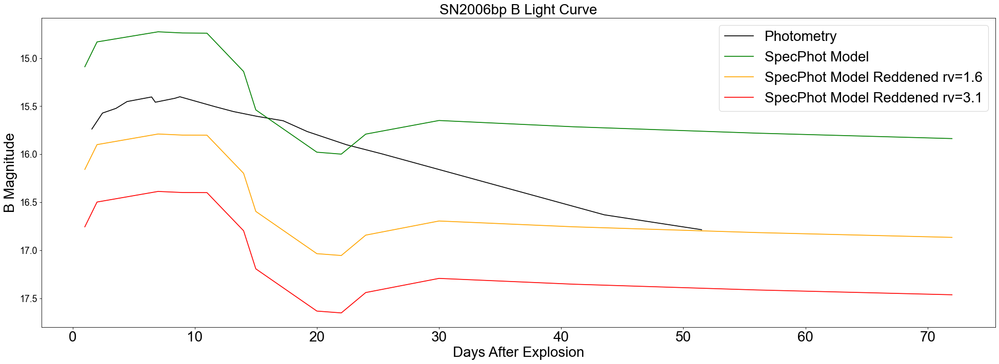

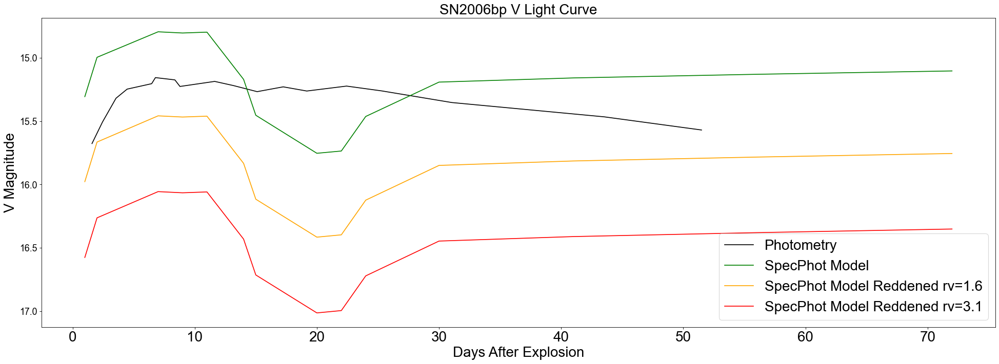

In [86]:
# rv = 3.1
SN06bp_modeldata_red3 = [[SN06bp_1half_wave_mred3, SN06bp_1half_flux_mred3],
                        [SN06bp_2half_wave_mred3, SN06bp_2half_flux_mred3],
                        [SN06bp_7half_wave_mred3, SN06bp_7half_flux_mred3],
                        [SN06bp_9half_wave_mred3, SN06bp_9half_flux_mred3],
                        [SN06bp_11_wave_mred3, SN06bp_11_flux_mred3],
                        [SN06bp_14half_wave_mred3, SN06bp_14half_flux_mred3],
                        [SN06bp_15half_wave_mred3, SN06bp_15half_flux_mred3],
                        [SN06bp_20half_wave_mred3, SN06bp_20half_flux_mred3],
                        [SN06bp_22_wave_mred3, SN06bp_22_flux_mred3],
                        [SN06bp_24_wave_mred3, SN06bp_24_flux_mred3],
                        [SN06bp_30_wave_mred3, SN06bp_30_flux_mred3],
                        [SN06bp_41half_wave_mred3, SN06bp_41half_flux_mred3],
                        [SN06bp_56half_wave_mred3, SN06bp_56half_flux_mred3],
                        [SN06bp_72half_wave_mred3, SN06bp_72half_flux_mred3]]
# SN06bp model
SN06bp_mred3_mag = []
for wavered3,fluxred3 in SN06bp_modeldata_red3:
    SN06bp_mred3_mag.append(specin_countsout(wavered3,fluxred3))
SN06bp_mred3_mag = np.array(SN06bp_mred3_mag)
SN06bp_mred3_shape = (len(SN06bp_modeldata_red3),6)
SN06bp_mred3_mag = SN06bp_mred3_mag.reshape(SN06bp_mred3_shape)
SN06bp_mred3_mag = np.matrix(SN06bp_mred3_mag)
# date
SN06bp_mred3_date = [1,2,7,9,11,14,15,20,22,24,30,41,56,72]
SN06bp_mred3_date = np.array(SN06bp_mred3_date)
# append date for ease of access
SN06bp_mred3_data = np.c_[SN06bp_mred3_mag,SN06bp_mred3_date]

# rv = 1.6
SN06bp_modeldata_red = [[SN06bp_1half_wave_mred, SN06bp_1half_flux_mred],
                        [SN06bp_2half_wave_mred, SN06bp_2half_flux_mred],
                        [SN06bp_7half_wave_mred, SN06bp_7half_flux_mred],
                        [SN06bp_9half_wave_mred, SN06bp_9half_flux_mred],
                        [SN06bp_11_wave_mred, SN06bp_11_flux_mred],
                        [SN06bp_14half_wave_mred, SN06bp_14half_flux_mred],
                        [SN06bp_15half_wave_mred, SN06bp_15half_flux_mred],
                        [SN06bp_20half_wave_mred, SN06bp_20half_flux_mred],
                        [SN06bp_22_wave_mred, SN06bp_22_flux_mred],
                        [SN06bp_24_wave_mred, SN06bp_24_flux_mred],
                        [SN06bp_30_wave_mred, SN06bp_30_flux_mred],
                        [SN06bp_41half_wave_mred, SN06bp_41half_flux_mred],
                        [SN06bp_56half_wave_mred, SN06bp_56half_flux_mred],
                        [SN06bp_72half_wave_mred, SN06bp_72half_flux_mred]]
# SN06bp model
SN06bp_mred_mag = []
for wavered,fluxred in SN06bp_modeldata_red:
    SN06bp_mred_mag.append(specin_countsout(wavered,fluxred))
SN06bp_mred_mag = np.array(SN06bp_mred_mag)
SN06bp_mred_shape = (len(SN06bp_modeldata_red),6)
SN06bp_mred_mag = SN06bp_mred_mag.reshape(SN06bp_mred_shape)
SN06bp_mred_mag = np.matrix(SN06bp_mred_mag)
# date
SN06bp_mred_date = [1,2,7,9,11,14,15,20,22,24,30,41,56,72]
SN06bp_mred_date = np.array(SN06bp_mred_date)
# append date for ease of access
SN06bp_mred_data = np.c_[SN06bp_mred_mag,SN06bp_mred_date]

# SN2006bp mjd = 53834
mjdexplosion = 53834

# defining column names and data types to pass to read_csv function
names = ['filter', 'mjd', 'mag', 'magerr', 'exposure', 'elapse']
types = {'filter': str, 'mjd': float, 'mag': float, 'magerr': float, 'exposure': float, 'elapse': float}

# import dat file to dataframe
df = pd.read_csv(SN2006bp_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# function with outputs colorseries and dateseries
def create_lc(df, filter1):

    # creates copy of dataframe
    func_df = df.copy()

    # removes unnecessary filters
    # resets index of dataframe for later lines
    # loc is a filtering function for pandas dataframes
    # .isin is a function that checks equality for more than one value (filter1 and filter2 for us)
    func_df = func_df.loc[func_df['filter'].isin([filter1])].reset_index(drop=True)
    
    # returns two columns for color and date
    return func_df['mjd'], func_df['filter'], func_df['mag']

w2_fil = 0
m2_fil = 1
w1_fil = 2
u_fil = 3
b_fil = 4
v_fil = 5

filters = [['UVW2',w2_fil],['UVM2',m2_fil],['UVW1',w1_fil],['U',u_fil],['B',b_fil],['V',v_fil]]

for filter1,filter2 in filters:

    time_phot, filter_phot, mag_phot = create_lc(df, filter1)

    fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
    plt.title('SN2006bp ' + filter1 + ' Light Curve',fontsize=font)
    plt.plot(time_phot-mjdexplosion,mag_phot,c='black',label='Photometry')
    plt.plot(SN06bp_m_data[:,6],SN06bp_m_data[:,filter2],c='green',label='SpecPhot Model')
    plt.plot(SN06bp_mred_data[:,6],SN06bp_mred_data[:,filter2],c='orange',label='SpecPhot Model Reddened rv=1.6')
    plt.plot(SN06bp_mred3_data[:,6],SN06bp_mred3_data[:,filter2],c='red',label='SpecPhot Model Reddened rv=3.1')
    plt.xlabel('Days After Explosion',fontsize=font)
    plt.ylabel(filter1 + ' Magnitude',fontsize=font)
    plt.yticks(fontsize=16)
    plt.legend()
    plt.gca().invert_yaxis()
    #plt.gca().get_xaxis().get_major_formatter().set_useOffset(False)
    #plt.grid(axis='x',color='lightgrey', linestyle='-', linewidth=2)

plt.show()

# <a id='11'>Normalized Model Plots</a> 
[Table of Contents](#0)

### Normalizing Data to be Plotted

In [188]:
############### putting data files into an array to run through the for loop
SN06bp_modeldata = [SN06bp_1half_m,SN06bp_2half_m,SN06bp_7half_m,SN06bp_9half_m,SN06bp_11_m,SN06bp_14half_m,
                    SN06bp_15half_m,SN06bp_20half_m,SN06bp_22_m,SN06bp_24_m,SN06bp_30_m,SN06bp_41half_m,
                    SN06bp_56half_m,SN06bp_72half_m]
SN05cs_modeldata = [SN05cs_3_m,SN05cs_4_m,SN05cs_5_m,SN05cs_6_m,SN05cs_7_m,SN05cs_8_m,SN05cs_9_m,SN05cs_12_m,
                    SN05cs_13_m,SN05cs_14_m,SN05cs_15_m,SN05cs_17_m]
SN12aw_modeldata = [SN12aw_10_m,SN12aw_11_m,SN12aw_12_m,SN12aw_13_m,SN12aw_14_m,SN12aw_16_m,SN12aw_17_m,
                    SN12aw_19_m,SN12aw_21_m,SN12aw_23_m,SN12aw_26_m,SN12aw_28_m,SN12aw_31_m,SN12aw_34_m,
                    SN12aw_38_m,SN12aw_42_m,SN12aw_46_m,SN12aw_50_m,SN12aw_55_m,SN12aw_61_m,SN12aw_67_m,
                    SN12aw_74_m,SN12aw_81_m,SN12aw_89_m,SN12aw_98_m,SN12aw_108_m,SN12aw_119_m,SN12aw_121_m,
                    SN12aw_124_m,SN12aw_126_m,SN12aw_129_m,SN12aw_131_m,SN12aw_134_m,SN12aw_137_m,SN12aw_139_m,
                    SN12aw_142_m,SN12aw_145_m,SN12aw_148_m,SN12aw_151_m,SN12aw_154_m,SN12aw_157_m,SN12aw_160_m,
                    SN12aw_163_m,SN12aw_166_m,SN12aw_175_m,SN12aw_187_m,SN12aw_200_m]

############### setting up empty arrays for norm
# SN06bp
SN06bp_1half_norm_m = []
SN06bp_2half_norm_m = []
SN06bp_7half_norm_m = []
SN06bp_9half_norm_m = []
SN06bp_11_norm_m = []
SN06bp_14half_norm_m = []
SN06bp_15half_norm_m = []
SN06bp_20half_norm_m = []
SN06bp_22_norm_m = []
SN06bp_24_norm_m = []
SN06bp_30_norm_m = []
SN06bp_41half_norm_m = []
SN06bp_56half_norm_m = []
SN06bp_72half_norm_m = []
# SN05cs
SN05cs_3_norm_m = []
SN05cs_4_norm_m = []
SN05cs_5_norm_m = []
SN05cs_6_norm_m = []
SN05cs_7_norm_m = []
SN05cs_8_norm_m = []
SN05cs_9_norm_m = []
SN05cs_12_norm_m = []
SN05cs_13_norm_m = []
SN05cs_14_norm_m = []
SN05cs_15_norm_m = []
SN05cs_17_norm_m = []
# SN12aw
SN12aw_10_norm_m = []
SN12aw_11_norm_m = []
SN12aw_12_norm_m = []
SN12aw_13_norm_m = []
SN12aw_14_norm_m = []
SN12aw_16_norm_m = []
SN12aw_17_norm_m = []
SN12aw_19_norm_m = []
SN12aw_21_norm_m = []
SN12aw_23_norm_m = []
SN12aw_26_norm_m = []
SN12aw_28_norm_m = []
SN12aw_31_norm_m = []
SN12aw_34_norm_m = []
SN12aw_38_norm_m = []
SN12aw_42_norm_m = []
SN12aw_46_norm_m = []
SN12aw_50_norm_m = []
SN12aw_55_norm_m = []
SN12aw_61_norm_m = []
SN12aw_67_norm_m = []
SN12aw_74_norm_m = []
SN12aw_81_norm_m = []
SN12aw_89_norm_m = []
SN12aw_98_norm_m = []
SN12aw_108_norm_m = []
SN12aw_119_norm_m = []
SN12aw_121_norm_m = []
SN12aw_124_norm_m = []
SN12aw_126_norm_m = []
SN12aw_129_norm_m = []
SN12aw_131_norm_m = []
SN12aw_134_norm_m = []
SN12aw_137_norm_m = []
SN12aw_139_norm_m = []
SN12aw_142_norm_m = []
SN12aw_145_norm_m = []
SN12aw_148_norm_m = []
SN12aw_151_norm_m = []
SN12aw_154_norm_m = []
SN12aw_157_norm_m = []
SN12aw_160_norm_m = []
SN12aw_163_norm_m = []
SN12aw_166_norm_m = []
SN12aw_175_norm_m = []
SN12aw_187_norm_m = []
SN12aw_200_norm_m = []

############### putting data files into an array to run through the for loop for norm
SN06bp_modeldata_norm = [SN06bp_1half_norm_m,SN06bp_2half_norm_m,SN06bp_7half_norm_m,SN06bp_9half_norm_m,
                         SN06bp_11_norm_m,SN06bp_14half_norm_m,SN06bp_15half_norm_m,SN06bp_20half_norm_m,
                         SN06bp_22_norm_m,SN06bp_24_norm_m,SN06bp_30_norm_m,SN06bp_41half_norm_m,
                         SN06bp_56half_norm_m,SN06bp_72half_norm_m]
SN05cs_modeldata_norm = [SN05cs_3_norm_m,SN05cs_4_norm_m,SN05cs_5_norm_m,SN05cs_6_norm_m,SN05cs_7_norm_m,
                         SN05cs_8_norm_m,SN05cs_9_norm_m,SN05cs_12_norm_m,SN05cs_13_norm_m,SN05cs_14_norm_m,
                         SN05cs_15_norm_m,SN05cs_17_norm_m]
SN12aw_modeldata_norm = [SN12aw_10_norm_m,SN12aw_11_norm_m,SN12aw_12_norm_m,SN12aw_13_norm_m,SN12aw_14_norm_m,
                         SN12aw_16_norm_m,SN12aw_17_norm_m,SN12aw_19_norm_m,SN12aw_21_norm_m,SN12aw_23_norm_m,
                         SN12aw_26_norm_m,SN12aw_28_norm_m,SN12aw_31_norm_m,SN12aw_34_norm_m,SN12aw_38_norm_m,
                         SN12aw_42_norm_m,SN12aw_46_norm_m,SN12aw_50_norm_m,SN12aw_55_norm_m,SN12aw_61_norm_m,
                         SN12aw_67_norm_m,SN12aw_74_norm_m,SN12aw_81_norm_m,SN12aw_89_norm_m,SN12aw_98_norm_m,
                         SN12aw_108_norm_m,SN12aw_119_norm_m,SN12aw_121_norm_m,SN12aw_124_norm_m,SN12aw_126_norm_m,
                         SN12aw_129_norm_m,SN12aw_131_norm_m,SN12aw_134_norm_m,SN12aw_137_norm_m,SN12aw_139_norm_m,
                         SN12aw_142_norm_m,SN12aw_145_norm_m,SN12aw_148_norm_m,SN12aw_151_norm_m,SN12aw_154_norm_m,
                         SN12aw_157_norm_m,SN12aw_160_norm_m,SN12aw_163_norm_m,SN12aw_166_norm_m,SN12aw_175_norm_m,
                         SN12aw_187_norm_m,SN12aw_200_norm_m]

############### running data 
# SN06bp
for n in range(len(SN06bp_modeldata)):
    wave_m, flux_m = np.loadtxt(SN06bp_modeldata[n], unpack=True)
    wave_m_trimmed = []
    flux_m_trimmed = []
    for i in range(len(wave_m)):
        if wave_m[i] >= 3000 and wave_m[i] <= 3500:
            wave_m_trimmed.append(wave_m[i])
            flux_m_trimmed.append(flux_m[i])
    flux_m_trimmed = np.array(flux_m_trimmed)
    avg_m = np.mean(flux_m_trimmed)
    for f in flux_m:
        SN06bp_modeldata_norm[n].append(f/avg_m)

# SN12aw
for n in range(len(SN12aw_modeldata)):
    wave_m, flux_m = np.loadtxt(SN12aw_modeldata[n], unpack=True)
    wave_m_trimmed = []
    flux_m_trimmed = []
    for i in range(len(wave_m)):
        if wave_m[i] >= 3000 and wave_m[i] <= 3500:
            wave_m_trimmed.append(wave_m[i])
            flux_m_trimmed.append(flux_m[i])
    flux_m_trimmed = np.array(flux_m_trimmed)
    avg_m = np.mean(flux_m_trimmed)
    for f in flux_m:
        SN12aw_modeldata_norm[n].append(f/avg_m)

### Plotting

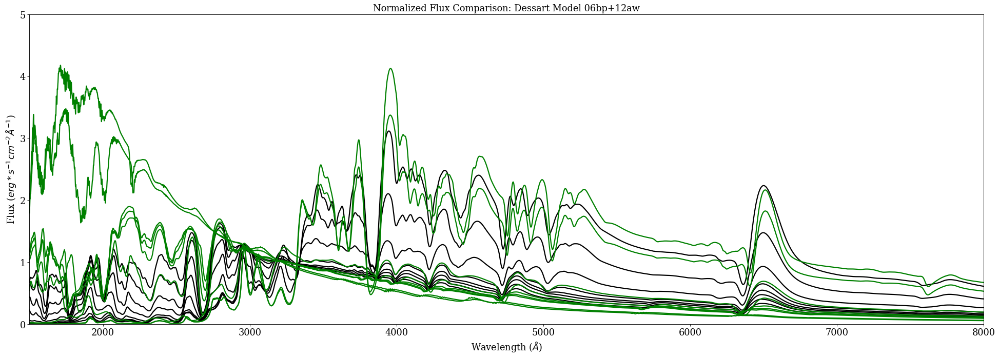

In [131]:
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Normalized Flux Comparison: Dessart Model 06bp+12aw',fontsize=font)
plt.plot(SN12aw_10_wave_m,SN12aw_10_norm_m,linewidth=2,c='black')
plt.plot(SN12aw_11_wave_m,SN12aw_11_norm_m,linewidth=2,c='black')
plt.plot(SN12aw_12_wave_m,SN12aw_12_norm_m,linewidth=2,c='black')
plt.plot(SN12aw_13_wave_m,SN12aw_13_norm_m,linewidth=2,c='black')
plt.plot(SN12aw_14_wave_m,SN12aw_14_norm_m,linewidth=2,c='black')
plt.plot(SN12aw_16_wave_m,SN12aw_16_norm_m,linewidth=2,c='black')
plt.plot(SN12aw_17_wave_m,SN12aw_17_norm_m,linewidth=2,c='black')
plt.plot(SN12aw_19_wave_m,SN12aw_19_norm_m,linewidth=2,c='black')
#plt.plot(SN12aw_21_wave_m,SN12aw_21_norm_m,linewidth=2,c='black')
#plt.plot(SN12aw_23_wave_m,SN12aw_23_norm_m,linewidth=2,c='black')
#plt.plot(SN12aw_26_wave_m,SN12aw_26_norm_m,linewidth=2,c='black')
#plt.plot(SN12aw_28_wave_m,SN12aw_28_norm_m,linewidth=2,c='black')
#plt.plot(SN12aw_31_wave_m,SN12aw_31_norm_m,linewidth=2,c='black')
#plt.plot(SN12aw_34_wave_m,SN12aw_34_norm_m,linewidth=2,c='black')
#plt.plot(SN12aw_38_wave_m,SN12aw_38_norm_m,linewidth=2,c='black')
#plt.plot(SN12aw_42_wave_m,SN12aw_42_norm_m,linewidth=2,c='black')
#plt.plot(SN12aw_46_wave_m,SN12aw_46_norm_m,linewidth=2,c='black')
plt.plot(SN06bp_1half_wave_m,SN06bp_1half_norm_m,linewidth=2,c='green')
plt.plot(SN06bp_2half_wave_m,SN06bp_2half_norm_m,linewidth=2,c='green')
plt.plot(SN06bp_7half_wave_m,SN06bp_7half_norm_m,linewidth=2,c='green')
plt.plot(SN06bp_9half_wave_m,SN06bp_9half_norm_m,linewidth=2,c='green')
plt.plot(SN06bp_11_wave_m,SN06bp_11_norm_m,linewidth=2,c='green')
plt.plot(SN06bp_14half_wave_m,SN06bp_14half_norm_m,linewidth=2,c='green')
plt.plot(SN06bp_15half_wave_m,SN06bp_15half_norm_m,linewidth=2,c='green')
plt.plot(SN06bp_20half_wave_m,SN06bp_20half_norm_m,linewidth=2,c='green')
plt.plot(SN06bp_22_wave_m,SN06bp_22_norm_m,linewidth=2,c='green')
#plt.plot(SN06bp_24_wave_m,SN06bp_24_norm_m,linewidth=2,c='green')
#plt.plot(SN06bp_30_wave_m,SN06bp_30_norm_m,linewidth=2,c='green')
#plt.plot(SN06bp_41half_wave_m,SN06bp_41half_norm_m,linewidth=2,c='green')
#plt.plot(SN06bp_56half_wave_m,SN06bp_56half_norm_m,linewidth=2,c='green')
#plt.plot(SN06bp_72half_wave_m,SN06bp_72half_norm_m,linewidth=2,c='green')
#plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.000001,5)
plt.show()
# continuum normalized to 1, how wide is the line? think of normalizing area
# normalize to peaks on right or left, then compare depth of the line with the continuum at the same place (2700-2900)

# <a id='12'>Normalized Day _ plots for all IIPs</a> 
[Table of Contents](#0)

### Normalizing Observed Data to be Plotted

In [189]:
############### putting data files into an array to run through the for loop
SN13ej_obsdata = [SN13ej_7_o,SN13ej_9_o,SN13ej_11_o,SN13ej_14_o,
                  SN13ej_15_o,SN13ej_16_o]
SN12aw_obsdata = [SN12aw_5_o,SN12aw_7_o,SN12aw_9_o,SN12aw_12_o,
                  SN12aw_14_o,SN12aw_16_o,SN12aw_26_o,SN12aw_27_o,
                  SN12aw_29_o,SN12aw_30_o]
SN21yja_obsdata = [SN21yja_5_o,SN21yja_6_o,SN21yja_7_o,SN21yja_9_o,
                   SN21yja_14_o,SN21yja_21_o]

############### setting up empty arrays for norm
# SN13ej
SN13ej_7_norm_o = []
SN13ej_9_norm_o = []
SN13ej_11_norm_o = []
SN13ej_14_norm_o = []
SN13ej_15_norm_o = []
SN13ej_16_norm_o = []
# SN12aw
SN12aw_5_norm_o = []
SN12aw_7_norm_o = []
SN12aw_9_norm_o = []
SN12aw_12_norm_o = []
SN12aw_14_norm_o = []
SN12aw_16_norm_o = []
SN12aw_26_norm_o = []
SN12aw_27_norm_o = []
SN12aw_29_norm_o = []
SN12aw_30_norm_o = []
# SN21yja
SN21yja_5_norm_o = []
SN21yja_6_norm_o = []
SN21yja_7_norm_o = []
SN21yja_9_norm_o = []
SN21yja_14_norm_o = []
SN21yja_21_norm_o = []

############### putting data files into an array to run through the for loop for norm
SN13ej_obsdata_norm = [SN13ej_7_norm_o,SN13ej_9_norm_o,SN13ej_11_norm_o,SN13ej_14_norm_o,
                       SN13ej_15_norm_o,SN13ej_16_norm_o]
SN12aw_obsdata_norm = [SN12aw_5_norm_o,SN12aw_7_norm_o,SN12aw_9_norm_o,SN12aw_12_norm_o,
                       SN12aw_14_norm_o,SN12aw_16_norm_o,SN12aw_26_norm_o,SN12aw_27_norm_o,
                       SN12aw_29_norm_o,SN12aw_30_norm_o]
SN21yja_obsdata_norm = [SN21yja_5_norm_o,SN21yja_6_norm_o,SN21yja_7_norm_o,SN21yja_9_norm_o,
                        SN21yja_14_norm_o,SN21yja_21_norm_o]

############### running data 
# SN13ej
for n in range(len(SN13ej_obsdata)):
    wave_m, flux_m = np.loadtxt(SN13ej_obsdata[n], usecols=(0,1), unpack=True)
    wave_m_trimmed = []
    flux_m_trimmed = []
    for i in range(len(wave_m)):
        if wave_m[i] >= 3000 and wave_m[i] <= 3500:
            wave_m_trimmed.append(wave_m[i])
            flux_m_trimmed.append(flux_m[i])
    flux_m_trimmed = np.array(flux_m_trimmed)
    avg_m = np.mean(flux_m_trimmed)
    for f in flux_m:
        SN13ej_obsdata_norm[n].append(f/avg_m)
# SN12aw
for n in range(len(SN12aw_obsdata)):
    wave_m, flux_m = np.loadtxt(SN12aw_obsdata[n], usecols=(0,1), unpack=True)
    wave_m_trimmed = []
    flux_m_trimmed = []
    for i in range(len(wave_m)):
        if wave_m[i] >= 3000 and wave_m[i] <= 3500:
            wave_m_trimmed.append(wave_m[i])
            flux_m_trimmed.append(flux_m[i])
    flux_m_trimmed = np.array(flux_m_trimmed)
    avg_m = np.mean(flux_m_trimmed)
    for f in flux_m:
        SN12aw_obsdata_norm[n].append(f/avg_m)
# SN21yja
for n in range(len(SN21yja_obsdata)):
    wave_m, flux_m = np.loadtxt(SN21yja_obsdata[n], usecols=(0,1), unpack=True)
    wave_m_trimmed = []
    flux_m_trimmed = []
    for i in range(len(wave_m)):
        if wave_m[i] >= 3000 and wave_m[i] <= 3500:
            wave_m_trimmed.append(wave_m[i])
            flux_m_trimmed.append(flux_m[i])
    flux_m_trimmed = np.array(flux_m_trimmed)
    avg_m = np.mean(flux_m_trimmed)
    for f in flux_m:
        SN21yja_obsdata_norm[n].append(f/avg_m)

### Plotting

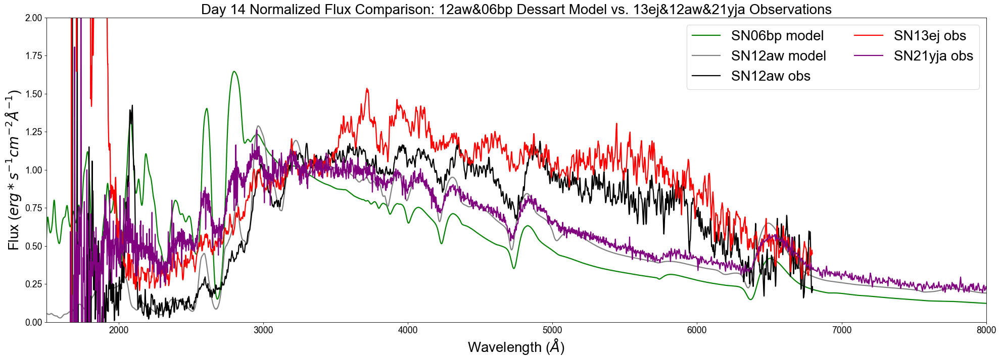

In [12]:
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Day 14 Normalized Flux Comparison: 12aw&06bp Dessart Model vs. 13ej&12aw&21yja Observations',fontsize=font)
plt.plot(SN06bp_14half_wave_m,SN06bp_14half_norm_m,linewidth=2,c='green',label='SN06bp model')
plt.plot(SN12aw_14_wave_m,SN12aw_14_norm_m,linewidth=2,c='grey',label='SN12aw model')
plt.plot(SN12aw_14_wave_o,SN12aw_14_norm_o,linewidth=2,c='black',label='SN12aw obs')
plt.plot(SN13ej_14_wave_o,SN13ej_14_norm_o,linewidth=2,c='red',label='SN13ej obs')
plt.plot(SN21yja_14_wave_o,SN21yja_14_norm_o,linewidth=2,c='purple',label='SN21yja obs')
plt.legend(loc=1,fontsize=font,ncol=2)
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.000001,2)
plt.show()
# overall continuum matches better
# H depths match better
# we don't see the dramatic change in purple Mg like we do green Mg
# might show this to Luke and see if there is an expectation that the Mg is overestimated 
# Normalize to 4400 or 5000-6000

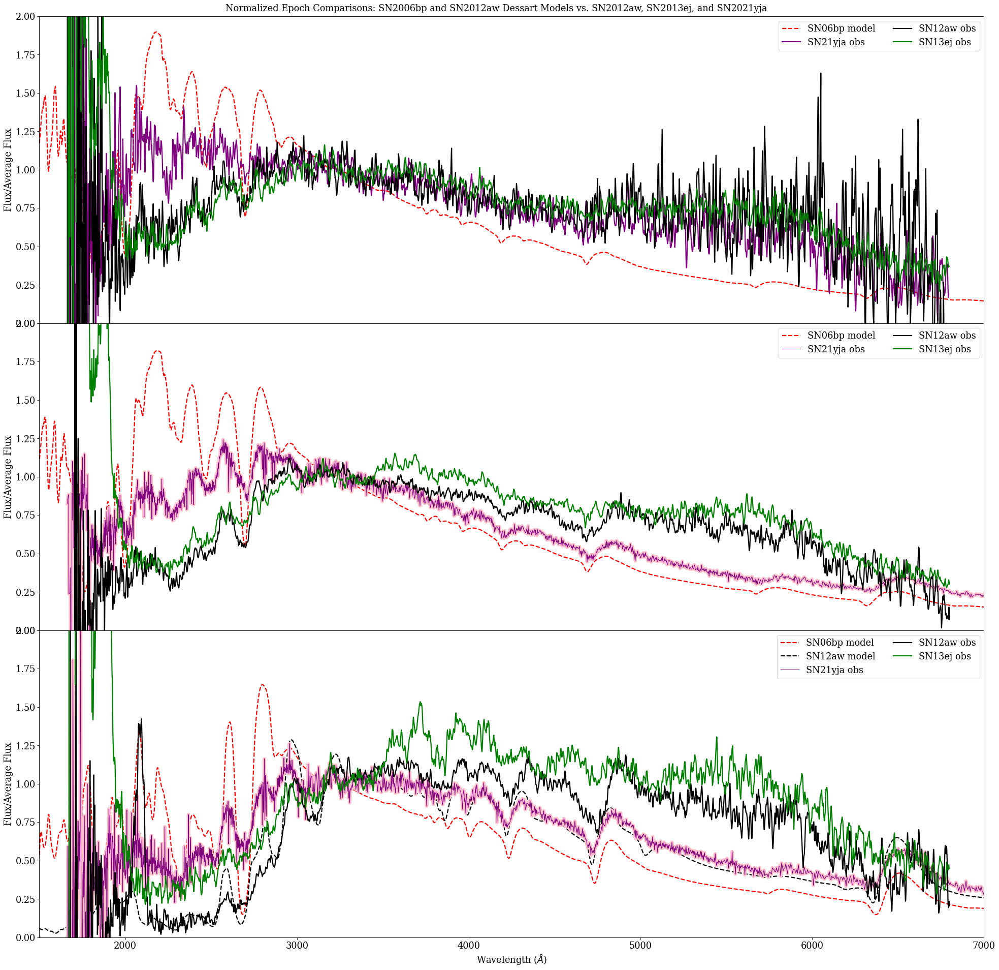

In [144]:
fig = plt.figure(figsize=(30, 30), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(3, hspace=0)
axs = gs.subplots(sharex=True, sharey=True)
fig.suptitle('Normalized Epoch Comparisons: SN2006bp and SN2012aw Dessart Models vs. SN2012aw, SN2013ej, and SN2021yja',fontsize=font,y=0.89)
axs[0].plot(SN06bp_7half_wave_m,SN06bp_7half_norm_m,linewidth=2,linestyle='--',c='red',label='SN06bp model')
axs[0].plot(SN21yja_7_wave_o,SN21yja_7_norm_o,linewidth=2,c='purple',label='SN21yja obs')
axs[0].plot(SN12aw_7_wave_o,SN12aw_7_norm_o,linewidth=2,c='black',label='SN12aw obs')
axs[0].plot(SN13ej_7_wave_o,SN13ej_7_norm_o,linewidth=2,c='green',label='SN13ej obs')
axs[0].legend(loc=1,fontsize=font,ncol=2)
axs[1].plot(SN06bp_9half_wave_m,SN06bp_9half_norm_m,linewidth=2,linestyle='--',c='red',label='SN06bp model')
axs[1].plot(SN21yja_9_wave_o,SN21yja_9_norm_o,linewidth=6,c='pink')
axs[1].plot(SN21yja_9_wave_o,SN21yja_9_norm_o,linewidth=1,c='purple',label='SN21yja obs')
axs[1].plot(SN12aw_9_wave_o,SN12aw_9_norm_o,linewidth=2,c='black',label='SN12aw obs')
axs[1].plot(SN13ej_9_wave_o,SN13ej_9_norm_o,linewidth=2,c='green',label='SN13ej obs')
axs[1].legend(loc=1,fontsize=font,ncol=2)
axs[2].plot(SN06bp_14half_wave_m,SN06bp_14half_norm_m,linewidth=2,linestyle='--',c='red',label='SN06bp model')
axs[2].plot(SN12aw_14_wave_m,SN12aw_14_norm_m,linewidth=2,linestyle='--',c='black',label='SN12aw model')
axs[2].plot(SN21yja_14_wave_o,SN21yja_14_norm_o,linewidth=6,c='pink')
axs[2].plot(SN21yja_14_wave_o,SN21yja_14_norm_o,linewidth=1,c='purple',label='SN21yja obs')
axs[2].plot(SN12aw_14_wave_o,SN12aw_14_norm_o,linewidth=2,c='black',label='SN12aw obs')
axs[2].plot(SN13ej_14_wave_o,SN13ej_14_norm_o,linewidth=2,c='green',label='SN13ej obs')
axs[2].legend(loc=1,fontsize=font,ncol=2)
# Hide x labels and tick labels for all but bottom plot.
for ax in axs:
    ax.label_outer()
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
# Set y label
for ax in axs:
    ax.set(ylabel="Flux/Average Flux")
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,7000)
plt.ylim(0,2)
plt.savefig("EpochComparisonNormalized_paperplot.png",dpi=300) # save as png
plt.show()

# <a id='13'>Epoch Plots</a> 
[Table of Contents](#0)

## <a id='13a'>Figure 45: Epoch Comparisons</a> 
[Table of Contents](#0)

### Time matched Normalized and not normalized

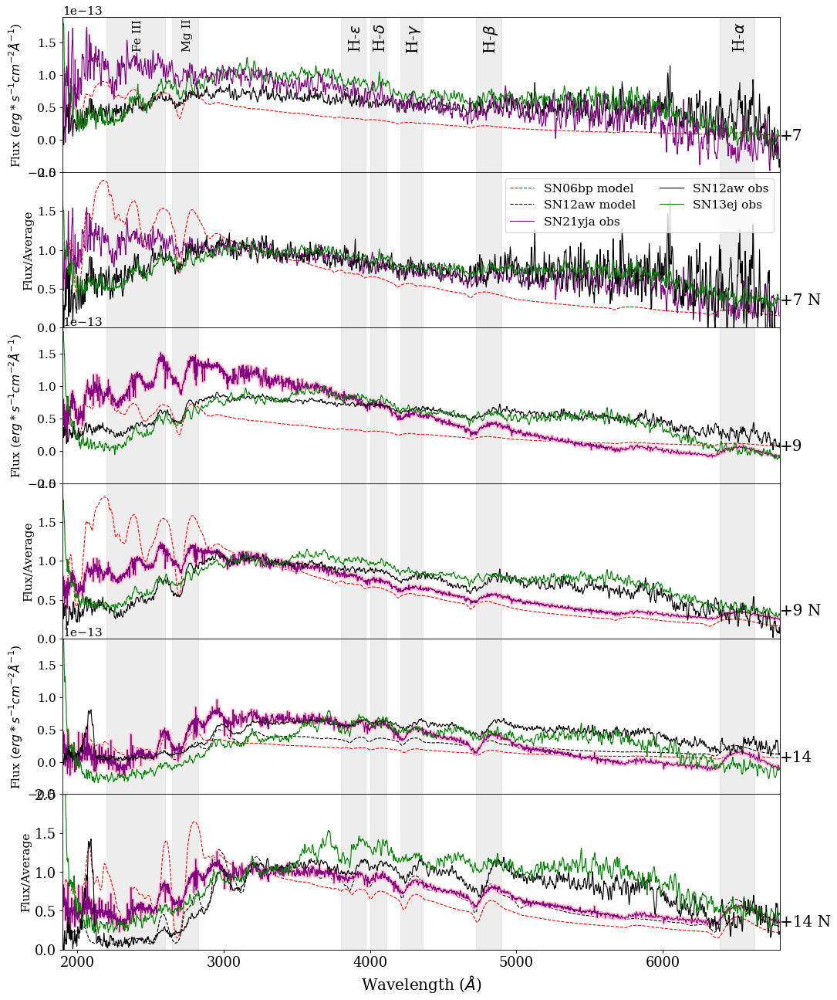

In [297]:
# need to go back and run the topmost cell in this notebook to reset the font parameter to regular
fontsp = 14
fontps = 18
plt.rcParams.update({'font.size': fontsp})
fig = plt.figure(figsize=(15, 20), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(6, hspace=0)
axs = gs.subplots(sharex=True, sharey=False)
#fig.suptitle('Epoch Comparisons: SN2006bp and SN2012aw Dessart Models vs. SN2012aw, SN2013ej, and SN2021yja',fontsize=font,y=0.89)
axs[0].plot(SN06bp_7half_wave_m,(0.00000001*SN06bp_7half_flux_m),linewidth=1,linestyle='--',c='red',label='SN06bp model')
axs[0].plot(SN12aw_7_wave_o,SN12aw_7_flux_o,linewidth=1,c='black',label='SN12aw obs')
axs[0].plot(SN13ej_7_wave_o,SN13ej_7_flux_o-0.00000000000005,linewidth=1,c='green',label='SN13ej obs')
axs[0].plot(SN21yja_7_wave_o,(SN21yja_7_flux_o*10)-0.00000000000005,linewidth=1,c='purple',label='SN21yja obs')
axs[0].set_ylim(-0.00000000000005,0.00000000000019)
axs[0].text(6800,0.0000000000000,'+7',fontsize=fontps)
#plotting vertical shaded bars and their corresponding features
axs[0].axvspan(2200, 2600, alpha=0.5, color='gainsboro')
axs[0].axvspan(2650, 2825, alpha=0.5, color='gainsboro')
axs[0].axvspan(3800, 3970, alpha=0.5, color='gainsboro')
axs[0].axvspan(4000, 4115, alpha=0.5, color='gainsboro')
axs[0].axvspan(4210, 4360, alpha=0.5, color='gainsboro')
axs[0].axvspan(4725, 4900, alpha=0.5, color='gainsboro')
axs[0].axvspan(6390, 6625, alpha=0.5, color='gainsboro')
# FeIII
axs[0].text(2380,0.00000000000014,'Fe III',fontsize=fontsp,rotation='vertical')
# MgII
axs[0].text(2715,0.00000000000014,'Mg II',fontsize=fontsp,rotation='vertical')
# H-epsilon
axs[0].text(3855,0.00000000000014,"H-" r'$\epsilon$',fontsize=fontps,rotation='vertical')
# H-delta
axs[0].text(4025,0.00000000000014,"H-" r'$\delta$',fontsize=fontps,rotation='vertical')
# H-gamma
axs[0].text(4240,0.00000000000014,"H-" r'$\gamma$',fontsize=fontps,rotation='vertical')
# H-beta
axs[0].text(4765,0.00000000000014,"H-" r'$\beta$',fontsize=fontps,rotation='vertical')
# H-alpha
axs[0].text(6480,0.00000000000014,"H-" r'$\alpha$',fontsize=fontps,rotation='vertical')
axs[1].plot(SN06bp_7half_wave_m,SN06bp_7half_norm_m,linewidth=1,linestyle='--',c='red',label='SN06bp model')
axs[1].plot(SN21yja_7_wave_o,SN21yja_7_norm_o,linewidth=1,c='purple',label='SN21yja obs')
axs[1].plot(SN12aw_7_wave_o,SN12aw_7_norm_o,linewidth=1,c='black',label='SN12aw obs')
axs[1].plot(SN13ej_7_wave_o,SN13ej_7_norm_o,linewidth=1,c='green',label='SN13ej obs')
axs[1].set_ylim(0,2)
axs[1].text(6800,0.3,'+7 N',fontsize=fontps)
axs[1].axvspan(2200, 2600, alpha=0.5, color='gainsboro')
axs[1].axvspan(2650, 2825, alpha=0.5, color='gainsboro')
axs[1].axvspan(3800, 3970, alpha=0.5, color='gainsboro')
axs[1].axvspan(4000, 4115, alpha=0.5, color='gainsboro')
axs[1].axvspan(4210, 4360, alpha=0.5, color='gainsboro')
axs[1].axvspan(4725, 4900, alpha=0.5, color='gainsboro')
axs[1].axvspan(6390, 6625, alpha=0.5, color='gainsboro')
axs[2].plot(SN06bp_9half_wave_m,(0.00000001*SN06bp_9half_flux_m),linewidth=1,linestyle='--',c='red',label='SN06bp model')
axs[2].plot(SN21yja_9_wave_o,(SN21yja_9_flux_o*10)-0.00000000000005,linewidth=4,c='pink')
axs[2].plot(SN21yja_9_wave_o,(SN21yja_9_flux_o*10)-0.00000000000005,linewidth=1,c='purple',label='SN21yja obs')
axs[2].plot(SN12aw_9_wave_o,SN12aw_9_flux_o,linewidth=1,c='black',label='SN12aw obs')
axs[2].plot(SN13ej_9_wave_o,SN13ej_9_flux_o-0.00000000000005,linewidth=1,c='green',label='SN13ej obs')
axs[2].set_ylim(-0.00000000000005,0.00000000000019)
axs[2].text(6800,0.0000000000000,'+9',fontsize=fontps)
axs[2].axvspan(2200, 2600, alpha=0.5, color='gainsboro')
axs[2].axvspan(2650, 2825, alpha=0.5, color='gainsboro')
axs[2].axvspan(3800, 3970, alpha=0.5, color='gainsboro')
axs[2].axvspan(4000, 4115, alpha=0.5, color='gainsboro')
axs[2].axvspan(4210, 4360, alpha=0.5, color='gainsboro')
axs[2].axvspan(4725, 4900, alpha=0.5, color='gainsboro')
axs[2].axvspan(6390, 6625, alpha=0.5, color='gainsboro')
axs[3].plot(SN06bp_9half_wave_m,SN06bp_9half_norm_m,linewidth=1,linestyle='--',c='red',label='SN06bp model')
axs[3].plot(SN21yja_9_wave_o,SN21yja_9_norm_o,linewidth=4,c='pink')
axs[3].plot(SN21yja_9_wave_o,SN21yja_9_norm_o,linewidth=1,c='purple',label='SN21yja obs')
axs[3].plot(SN12aw_9_wave_o,SN12aw_9_norm_o,linewidth=1,c='black',label='SN12aw obs')
axs[3].plot(SN13ej_9_wave_o,SN13ej_9_norm_o,linewidth=1,c='green',label='SN13ej obs')
axs[3].set_ylim(0,2)
axs[3].text(6800,0.3,'+9 N',fontsize=fontps)
axs[3].axvspan(2200, 2600, alpha=0.5, color='gainsboro')
axs[3].axvspan(2650, 2825, alpha=0.5, color='gainsboro')
axs[3].axvspan(3800, 3970, alpha=0.5, color='gainsboro')
axs[3].axvspan(4000, 4115, alpha=0.5, color='gainsboro')
axs[3].axvspan(4210, 4360, alpha=0.5, color='gainsboro')
axs[3].axvspan(4725, 4900, alpha=0.5, color='gainsboro')
axs[3].axvspan(6390, 6625, alpha=0.5, color='gainsboro')
axs[4].plot(SN06bp_14half_wave_m,(0.00000001*SN06bp_14half_flux_m),linewidth=1,linestyle='--',c='red',label='SN06bp model')
axs[4].plot(SN12aw_14_wave_m,(0.00000001*SN12aw_14_flux_m),linewidth=1,linestyle='--',c='black',label='SN12aw model')
axs[4].plot(SN21yja_14_wave_o,(SN21yja_14_flux_o*10)-0.00000000000005,linewidth=4,c='pink')
axs[4].plot(SN21yja_14_wave_o,(SN21yja_14_flux_o*10)-0.00000000000005,linewidth=1,c='purple',label='SN21yja obs')
axs[4].plot(SN12aw_14_wave_o,SN12aw_14_flux_o,linewidth=1,c='black',label='SN12aw obs')
axs[4].plot(SN13ej_14_wave_o,SN13ej_14_flux_o-0.00000000000005,linewidth=1,c='green',label='SN13ej obs')
axs[4].legend(bbox_to_anchor=(1, 4),fontsize=fontsp,ncol=2)
axs[4].set_ylim(-0.00000000000005,0.00000000000019)
axs[4].text(6800,0.0000000000000,'+14',fontsize=fontps)
axs[4].axvspan(2200, 2600, alpha=0.5, color='gainsboro')
axs[4].axvspan(2650, 2825, alpha=0.5, color='gainsboro')
axs[4].axvspan(3800, 3970, alpha=0.5, color='gainsboro')
axs[4].axvspan(4000, 4115, alpha=0.5, color='gainsboro')
axs[4].axvspan(4210, 4360, alpha=0.5, color='gainsboro')
axs[4].axvspan(4725, 4900, alpha=0.5, color='gainsboro')
axs[4].axvspan(6390, 6625, alpha=0.5, color='gainsboro')
axs[5].plot(SN06bp_14half_wave_m,SN06bp_14half_norm_m,linewidth=1,linestyle='--',c='red',label='SN06bp model')
axs[5].plot(SN12aw_14_wave_m,SN12aw_14_norm_m,linewidth=1,linestyle='--',c='black',label='SN12aw model')
axs[5].plot(SN21yja_14_wave_o,SN21yja_14_norm_o,linewidth=4,c='pink')
axs[5].plot(SN21yja_14_wave_o,SN21yja_14_norm_o,linewidth=1,c='purple',label='SN21yja obs')
axs[5].plot(SN12aw_14_wave_o,SN12aw_14_norm_o,linewidth=1,c='black',label='SN12aw obs')
axs[5].plot(SN13ej_14_wave_o,SN13ej_14_norm_o,linewidth=1,c='green',label='SN13ej obs')
axs[5].set_ylim(0,2)
axs[5].text(6800,0.3,'+14 N',fontsize=fontps)
axs[5].axvspan(2200, 2600, alpha=0.5, color='gainsboro')
axs[5].axvspan(2650, 2825, alpha=0.5, color='gainsboro')
axs[5].axvspan(3800, 3970, alpha=0.5, color='gainsboro')
axs[5].axvspan(4000, 4115, alpha=0.5, color='gainsboro')
axs[5].axvspan(4210, 4360, alpha=0.5, color='gainsboro')
axs[5].axvspan(4725, 4900, alpha=0.5, color='gainsboro')
axs[5].axvspan(6390, 6625, alpha=0.5, color='gainsboro')
# Hide x labels and tick labels for all but bottom plot.
for ax in axs:
    ax.label_outer()
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=18)
# Set y label
axs[0].set(ylabel="Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)')
axs[1].set(ylabel="Flux/Average")
axs[2].set(ylabel="Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)')
axs[3].set(ylabel="Flux/Average")
axs[4].set(ylabel="Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)')
axs[5].set(ylabel="Flux/Average")
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1900,6800)
plt.savefig("epochcomparisons_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### Time matched conjoined

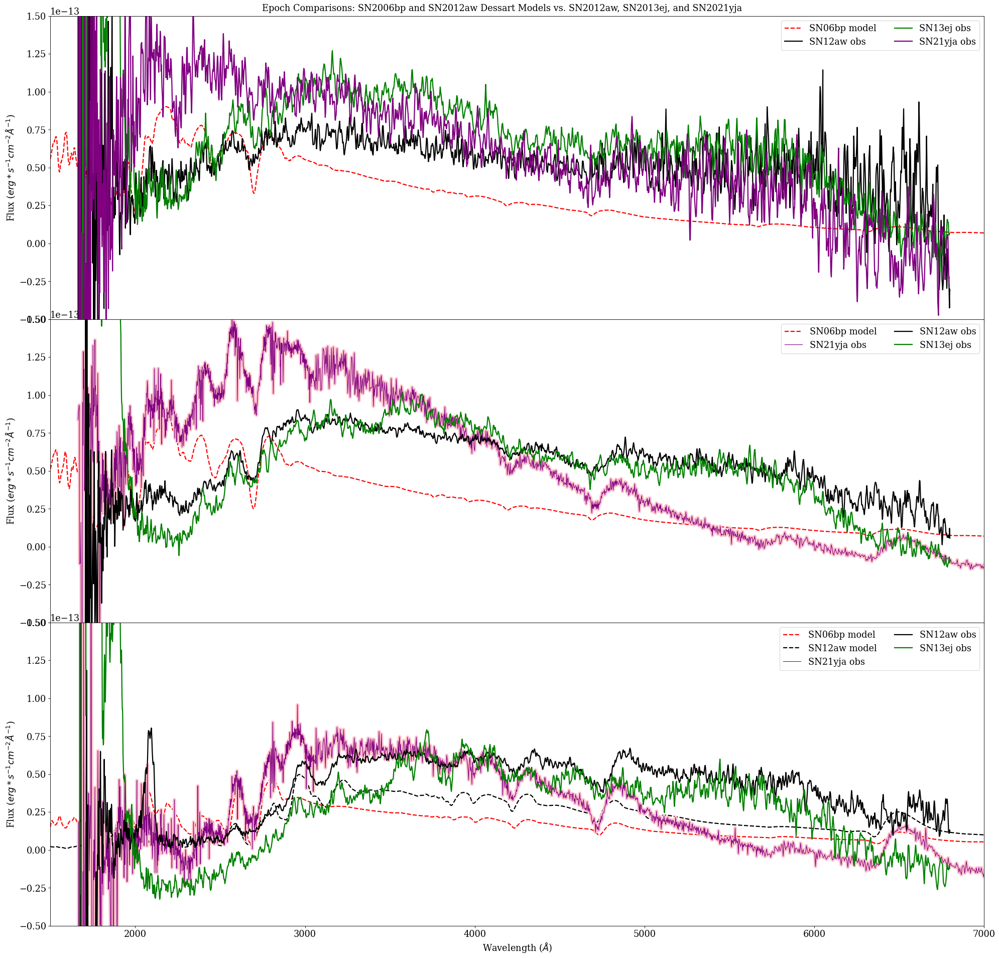

In [145]:
fig = plt.figure(figsize=(30, 30), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(3, hspace=0)
axs = gs.subplots(sharex=True, sharey=True)
#plt.title('Epoch Comparisons: SN2006bp and SN2012aw Dessart Models vs. SN2012aw, SN2013ej, and SN2021yja')
fig.suptitle('Epoch Comparisons: SN2006bp and SN2012aw Dessart Models vs. SN2012aw, SN2013ej, and SN2021yja',fontsize=font,y=0.89)
axs[0].plot(SN06bp_7half_wave_m,(0.00000001*SN06bp_7half_flux_m),linewidth=2,linestyle='--',c='red',label='SN06bp model')
axs[0].plot(SN12aw_7_wave_o,SN12aw_7_flux_o,linewidth=2,c='black',label='SN12aw obs')
axs[0].plot(SN13ej_7_wave_o,SN13ej_7_flux_o-0.00000000000005,linewidth=2,c='green',label='SN13ej obs')
axs[0].plot(SN21yja_7_wave_o,(SN21yja_7_flux_o*10)-0.00000000000005,linewidth=2,c='purple',label='SN21yja obs')
axs[0].legend(loc=1,fontsize=font,ncol=2)
axs[1].plot(SN06bp_9half_wave_m,(0.00000001*SN06bp_9half_flux_m),linewidth=2,linestyle='--',c='red',label='SN06bp model')
axs[1].plot(SN21yja_9_wave_o,(SN21yja_9_flux_o*10)-0.00000000000005,linewidth=6,c='pink')
axs[1].plot(SN21yja_9_wave_o,(SN21yja_9_flux_o*10)-0.00000000000005,linewidth=1,c='purple',label='SN21yja obs')
axs[1].plot(SN12aw_9_wave_o,SN12aw_9_flux_o,linewidth=2,c='black',label='SN12aw obs')
axs[1].plot(SN13ej_9_wave_o,SN13ej_9_flux_o-0.00000000000005,linewidth=2,c='green',label='SN13ej obs')
axs[1].legend(loc=1,fontsize=font,ncol=2)
axs[2].plot(SN06bp_14half_wave_m,(0.00000001*SN06bp_14half_flux_m),linewidth=2,linestyle='--',c='red',label='SN06bp model')
axs[2].plot(SN12aw_14_wave_m,(0.00000001*SN12aw_14_flux_m),linewidth=2,linestyle='--',c='black',label='SN12aw model')
axs[2].plot(SN21yja_14_wave_o,(SN21yja_14_flux_o*10)-0.00000000000005,linewidth=6,c='pink')
axs[2].plot(SN21yja_14_wave_o,(SN21yja_14_flux_o*10)-0.00000000000005,linewidth=1,c='purple',label='SN21yja obs')
axs[2].plot(SN12aw_14_wave_o,SN12aw_14_flux_o,linewidth=2,c='black',label='SN12aw obs')
axs[2].plot(SN13ej_14_wave_o,SN13ej_14_flux_o-0.00000000000005,linewidth=2,c='green',label='SN13ej obs')
axs[2].legend(loc=1,fontsize=font,ncol=2)
# Hide x labels and tick labels for all but bottom plot.
for ax in axs:
    ax.label_outer()
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
# Set y label
for ax in axs:
    ax.set(ylabel="Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)')
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,7000)
plt.ylim(-0.00000000000005,0.00000000000015)
plt.savefig("EpochComparison_paperplot.png",dpi=300) # save as png
plt.show()

### Time matched

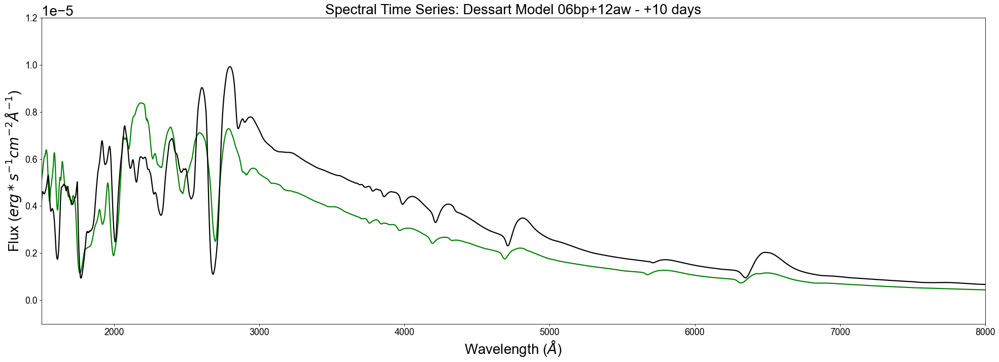

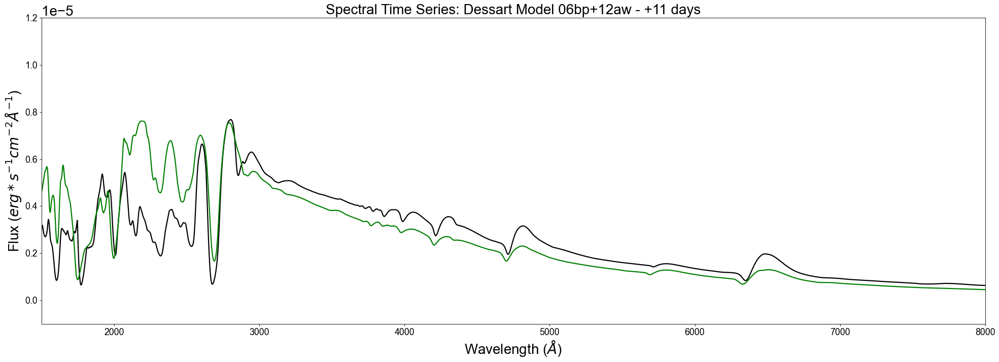

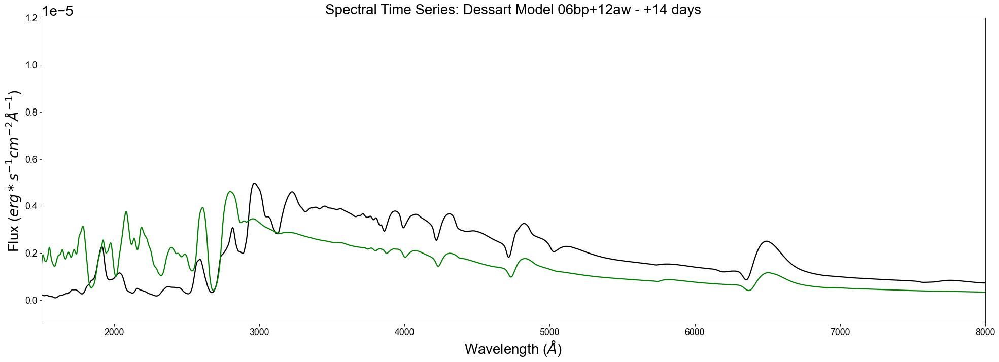

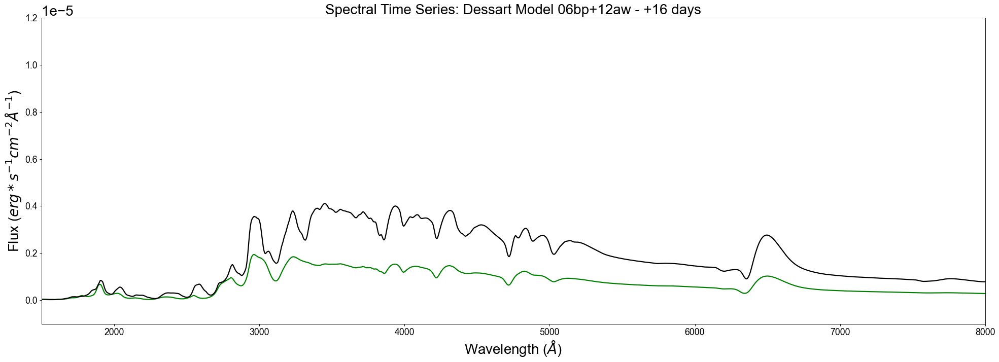

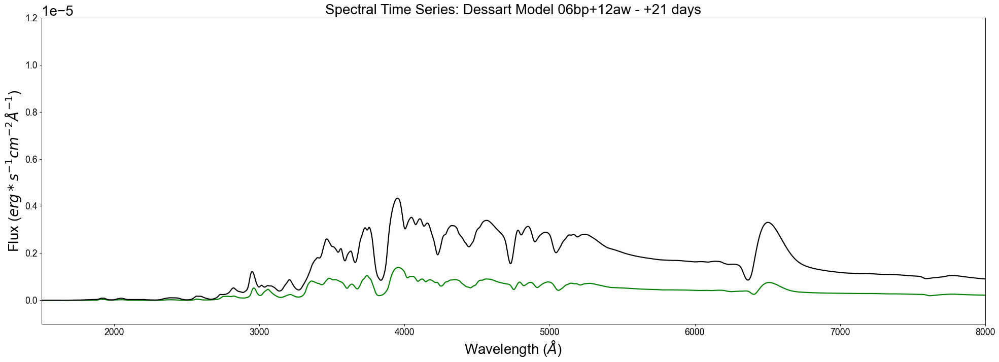

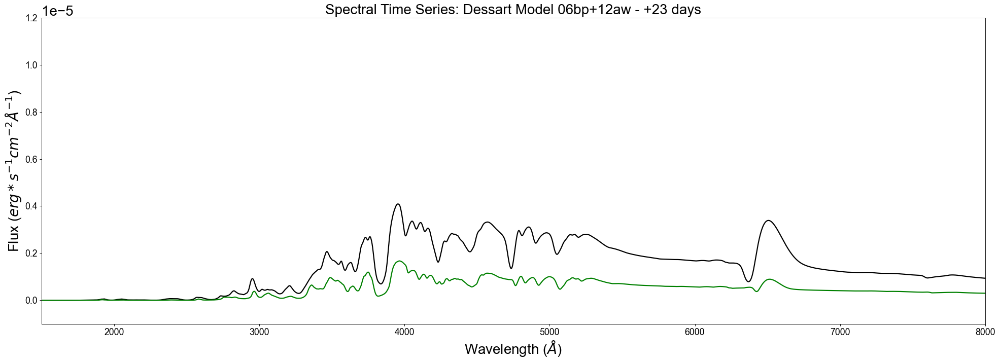

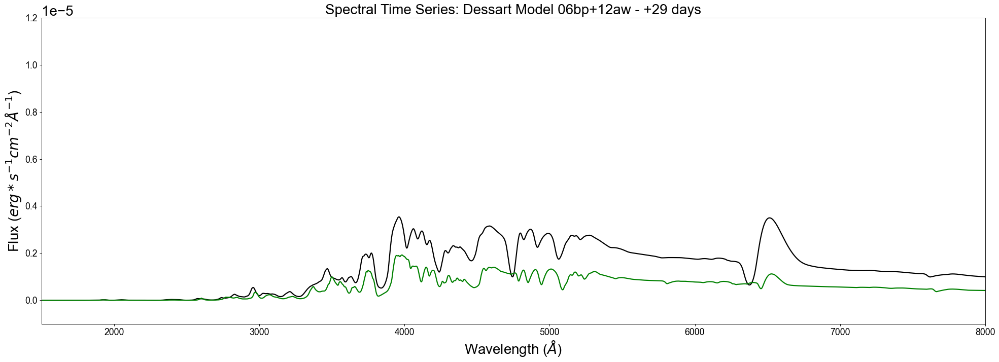

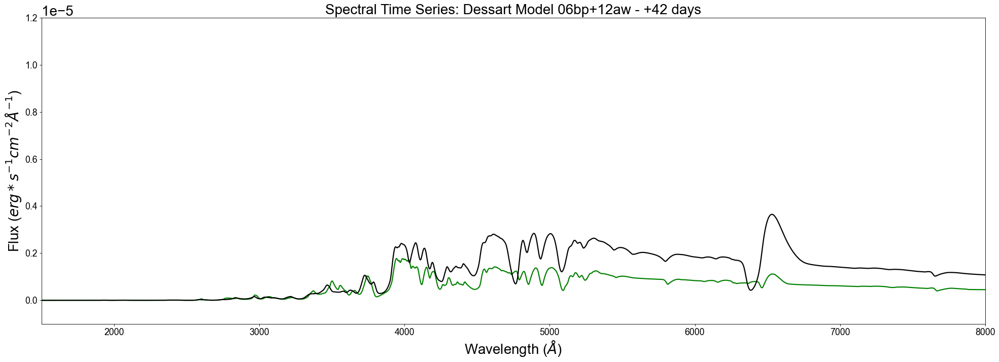

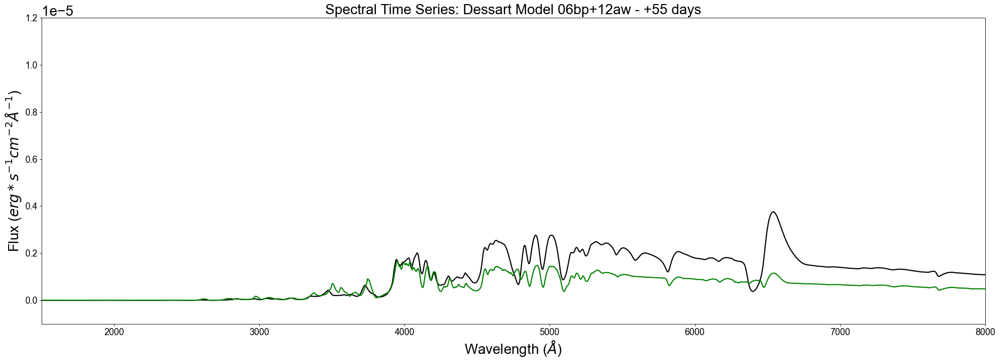

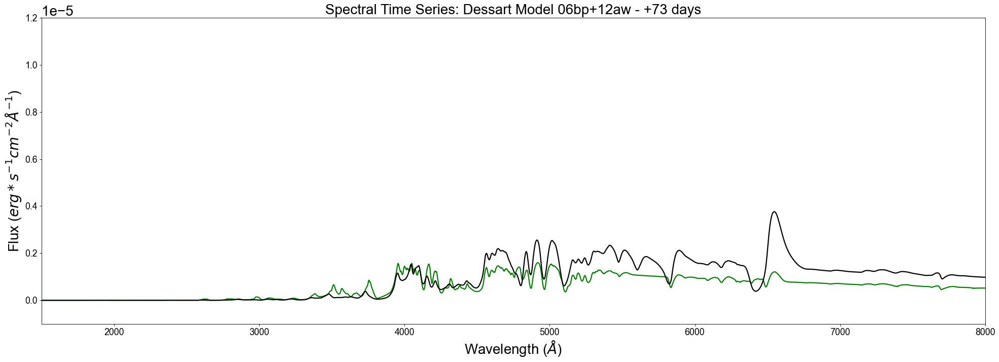

In [28]:
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - +10 days',fontsize=font)
plt.plot(SN06bp_9half_wave_m,SN06bp_9half_flux_m,linewidth=2,c='green')
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m,linewidth=2,c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - +11 days',fontsize=font)
plt.plot(SN12aw_11_wave_m,SN12aw_11_flux_m,linewidth=2,c='black')
plt.plot(SN06bp_11_wave_m,SN06bp_11_flux_m,linewidth=2,c='green')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - +14 days',fontsize=font)
plt.plot(SN12aw_14_wave_m,SN12aw_14_flux_m,linewidth=2,c='black')
plt.plot(SN06bp_14half_wave_m,SN06bp_14half_flux_m,linewidth=2,c='green')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - +16 days',fontsize=font)
plt.plot(SN06bp_15half_wave_m,SN06bp_15half_flux_m,linewidth=2,c='green')
plt.plot(SN12aw_16_wave_m,SN12aw_16_flux_m,linewidth=2,c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - +21 days',fontsize=font)
plt.plot(SN06bp_20half_wave_m,SN06bp_20half_flux_m,linewidth=2,c='green')
plt.plot(SN12aw_21_wave_m,SN12aw_21_flux_m,linewidth=2,c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - +23 days',fontsize=font)
plt.plot(SN12aw_23_wave_m,SN12aw_23_flux_m,linewidth=2,c='black')
plt.plot(SN06bp_24_wave_m,SN06bp_24_flux_m,linewidth=2,c='green')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - +29 days',fontsize=font)
plt.plot(SN12aw_28_wave_m,SN12aw_28_flux_m,linewidth=2,c='black')
plt.plot(SN06bp_30_wave_m,SN06bp_30_flux_m,linewidth=2,c='green')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - +42 days',fontsize=font)
plt.plot(SN06bp_41half_wave_m,SN06bp_41half_flux_m,linewidth=2,c='green')
plt.plot(SN12aw_42_wave_m,SN12aw_42_flux_m,linewidth=2,c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - +55 days',fontsize=font)
plt.plot(SN12aw_55_wave_m,SN12aw_55_flux_m,linewidth=2,c='black')
plt.plot(SN06bp_56half_wave_m,SN06bp_56half_flux_m,linewidth=2,c='green')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - +73 days',fontsize=font)
plt.plot(SN06bp_72half_wave_m,SN06bp_72half_flux_m,linewidth=2,c='green')
plt.plot(SN12aw_74_wave_m,SN12aw_74_flux_m,linewidth=2,c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

### Color Matched

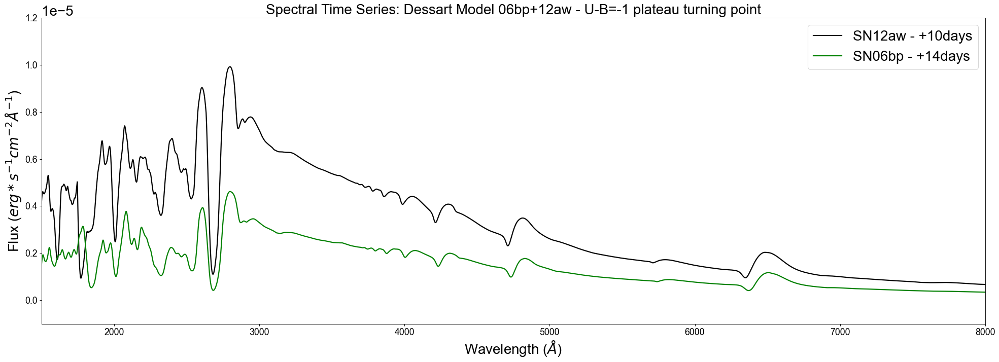

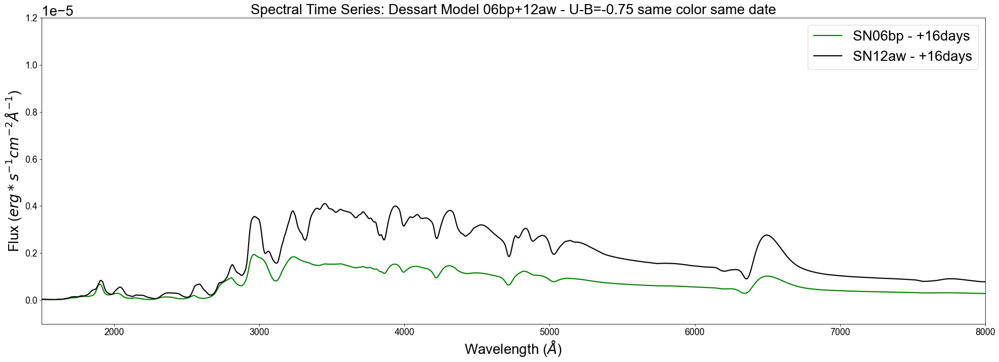

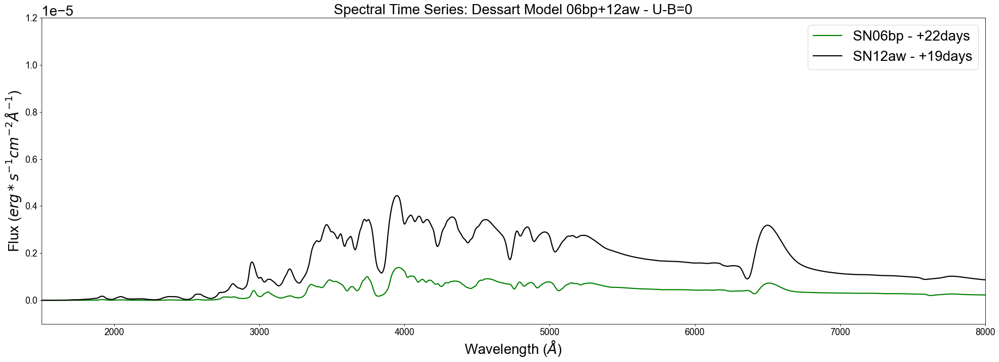

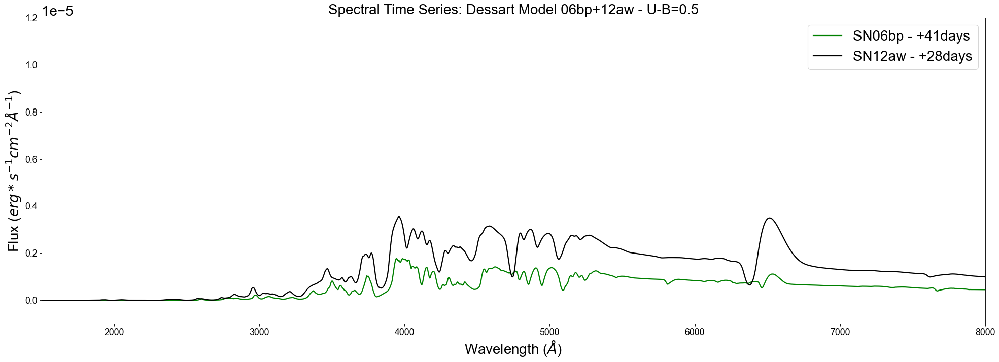

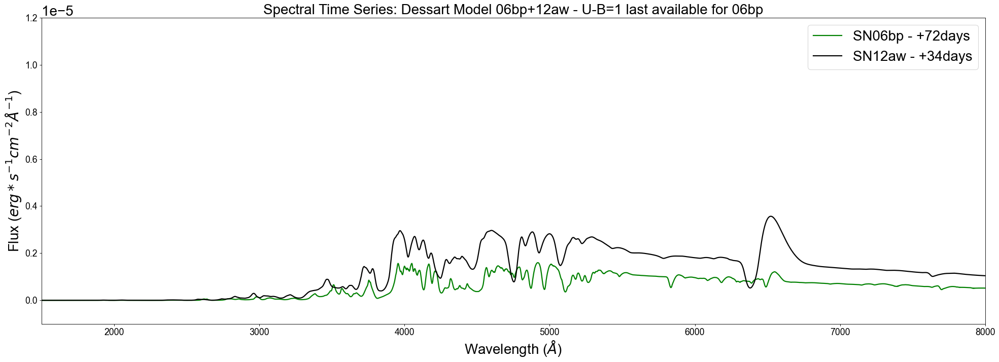

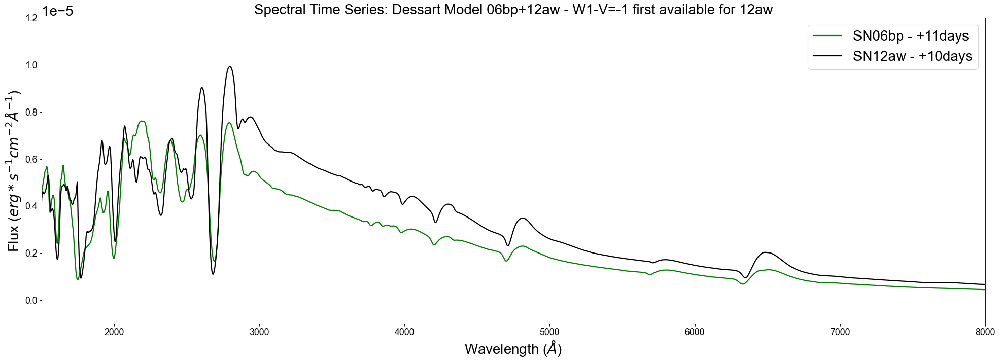

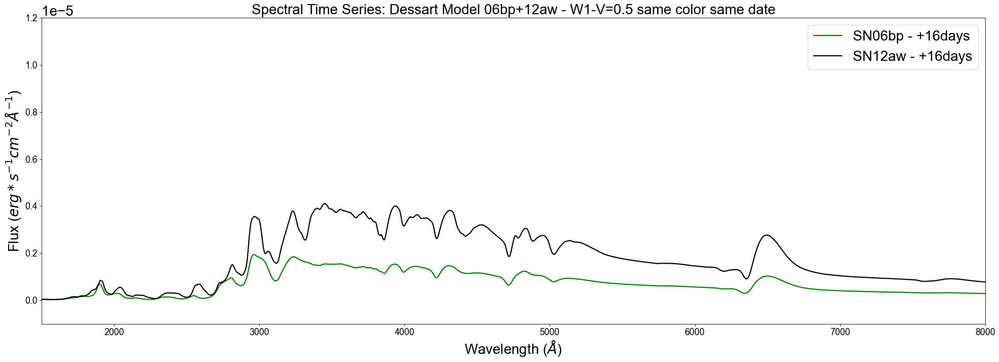

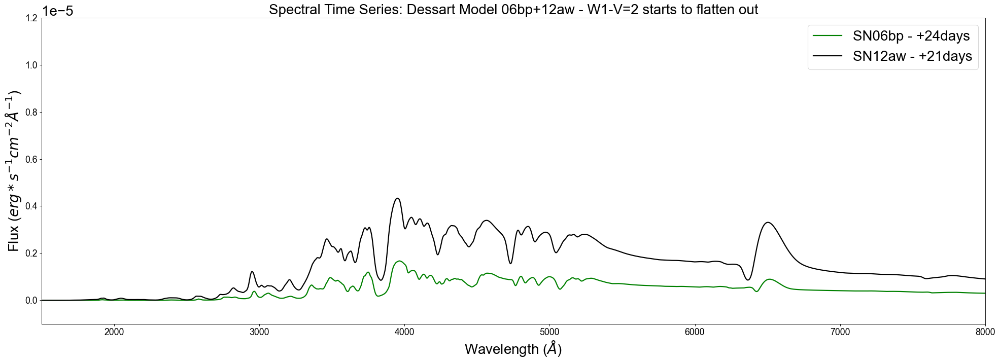

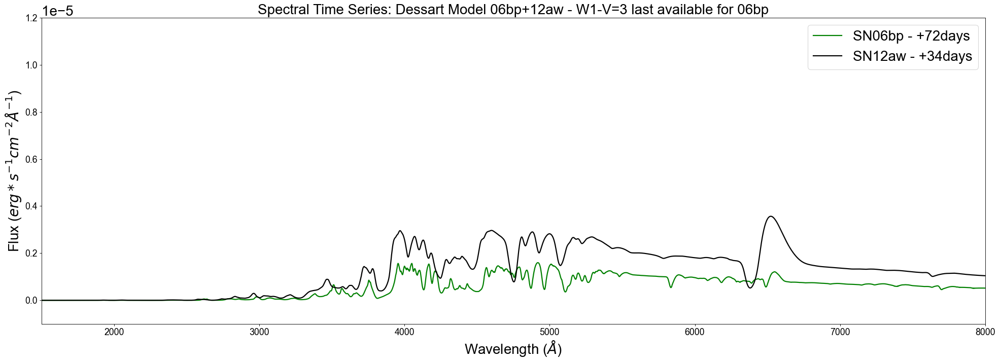

In [29]:
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - U-B=-1 plateau turning point',fontsize=font)
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m,linewidth=2,label='SN12aw - +10days',c='black')
plt.plot(SN06bp_14half_wave_m,SN06bp_14half_flux_m,linewidth=2,label='SN06bp - +14days',c='green')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.legend(loc=1,fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - U-B=-0.75 same color same date',fontsize=font)
plt.plot(SN06bp_15half_wave_m,SN06bp_15half_flux_m,linewidth=2,label='SN06bp - +16days',c='green')
plt.plot(SN12aw_16_wave_m,SN12aw_16_flux_m,linewidth=2,label='SN12aw - +16days',c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.legend(loc=1,fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - U-B=0',fontsize=font)
plt.plot(SN06bp_22_wave_m,SN06bp_22_flux_m,linewidth=2,label='SN06bp - +22days',c='green')
plt.plot(SN12aw_19_wave_m,SN12aw_19_flux_m,linewidth=2,label='SN12aw - +19days',c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.legend(loc=1,fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - U-B=0.5',fontsize=font)
plt.plot(SN06bp_41half_wave_m,SN06bp_41half_flux_m,linewidth=2,label='SN06bp - +41days',c='green')
plt.plot(SN12aw_28_wave_m,SN12aw_28_flux_m,linewidth=2,label='SN12aw - +28days',c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.legend(loc=1,fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - U-B=1 last available for 06bp',fontsize=font)
plt.plot(SN06bp_72half_wave_m,SN06bp_72half_flux_m,linewidth=2,label='SN06bp - +72days',c='green')
plt.plot(SN12aw_34_wave_m,SN12aw_34_flux_m,linewidth=2,label='SN12aw - +34days',c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.legend(loc=1,fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - W1-V=-1 first available for 12aw',fontsize=font)
plt.plot(SN06bp_11_wave_m,SN06bp_11_flux_m,linewidth=2,label='SN06bp - +11days',c='green')
plt.plot(SN12aw_10_wave_m,SN12aw_10_flux_m,linewidth=2,label='SN12aw - +10days',c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.legend(loc=1,fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - W1-V=0.5 same color same date',fontsize=font)
plt.plot(SN06bp_15half_wave_m,SN06bp_15half_flux_m,linewidth=2,label='SN06bp - +16days',c='green')
plt.plot(SN12aw_16_wave_m,SN12aw_16_flux_m,linewidth=2,label='SN12aw - +16days',c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.legend(loc=1,fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - W1-V=2 starts to flatten out',fontsize=font)
plt.plot(SN06bp_24_wave_m,SN06bp_24_flux_m,linewidth=2,label='SN06bp - +24days',c='green')
plt.plot(SN12aw_21_wave_m,SN12aw_21_flux_m,linewidth=2,label='SN12aw - +21days',c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.legend(loc=1,fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - W1-V=3 last available for 06bp',fontsize=font)
plt.plot(SN06bp_72half_wave_m,SN06bp_72half_flux_m,linewidth=2,label='SN06bp - +72days',c='green')
plt.plot(SN12aw_34_wave_m,SN12aw_34_flux_m,linewidth=2,label='SN12aw - +34days',c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.legend(loc=1,fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.0000010,0.000012)
plt.show()

## <a id='13b'>Figure 46b: Color Matched Comparions</a> 
[Table of Contents](#0)

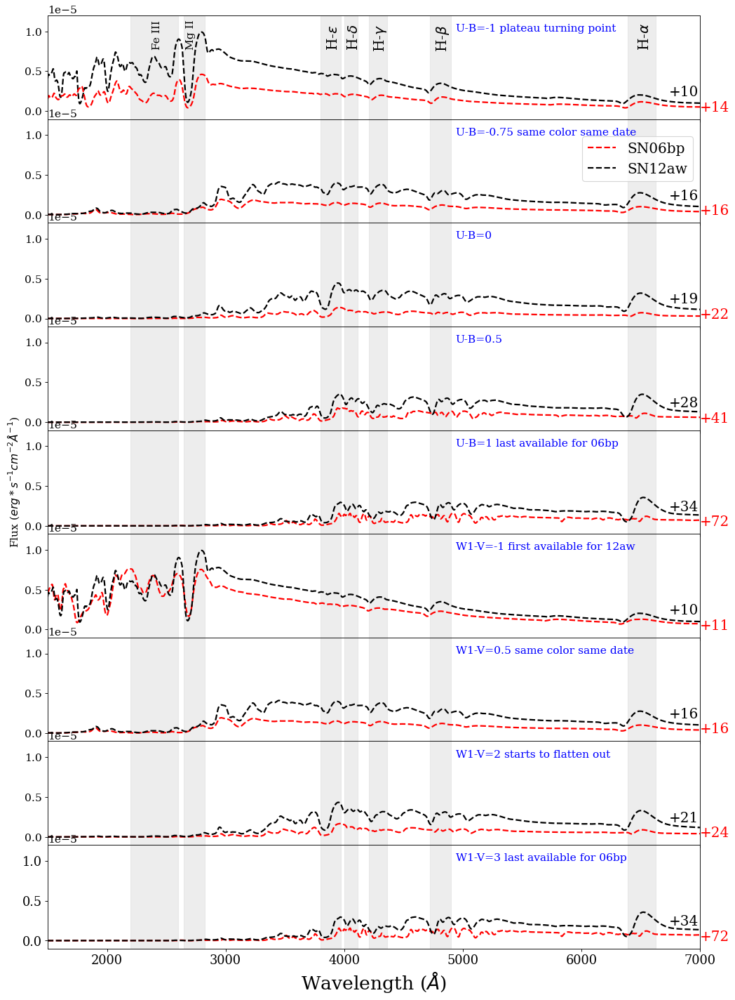

In [298]:
# need to run Figure 45 before this one for font sizes
fig = plt.figure(figsize=(15, 22), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(9, hspace=0)
axs = gs.subplots(sharex=True, sharey=False)
#fig.suptitle('Color Matched Comparisons: SN2006bp and SN2012aw Dessart Models',fontsize=font,y=0.89)
axs[0].plot(SN12aw_10_wave_m,SN12aw_10_flux_m,linewidth=2,linestyle='dashed',label='SN12aw',c='black')
axs[0].plot(SN06bp_14half_wave_m,SN06bp_14half_flux_m,linewidth=2,linestyle='dashed',label='SN06bp',c='red')
axs[0].set_ylim(-0.0000010,0.000012)
axs[0].text(4940,0.00001,'U-B=-1 plateau turning point',fontsize=fontsp,color='b')
axs[0].text(6740,0.0000019,'+10',fontsize=fontps)
axs[0].text(7000,0,'+14',fontsize=fontps,c='red')
#plotting corresponding features for shaded bars
# FeIII
axs[0].text(2380,0.000008,'Fe III',fontsize=fontsp,rotation='vertical')
# MgII
axs[0].text(2665,0.000008,'Mg II',fontsize=fontsp,rotation='vertical')
# H-epsilon
axs[0].text(3855,0.000008,"H-" r'$\epsilon$',fontsize=fontps,rotation='vertical')
# H-delta
axs[0].text(4025,0.000008,"H-" r'$\delta$',fontsize=fontps,rotation='vertical')
# H-gamma
axs[0].text(4240,0.000008,"H-" r'$\gamma$',fontsize=fontps,rotation='vertical')
# H-beta
axs[0].text(4765,0.000008,"H-" r'$\beta$',fontsize=fontps,rotation='vertical')
# H-alpha
axs[0].text(6480,0.000008,"H-" r'$\alpha$',fontsize=fontps,rotation='vertical')
axs[1].plot(SN06bp_15half_wave_m,SN06bp_15half_flux_m,linewidth=2,linestyle='dashed',label='SN06bp',c='red')
axs[1].plot(SN12aw_16_wave_m,SN12aw_16_flux_m,linewidth=2,linestyle='dashed',label='SN12aw',c='black')
axs[1].set_ylim(-0.0000010,0.000012)
axs[1].text(4940,0.00001,'U-B=-0.75 same color same date',fontsize=fontsp,color='b')
axs[1].text(6740,0.0000019,'+16',fontsize=fontps)
axs[1].text(7000,0,'+16',fontsize=fontps,c='red')
axs[2].plot(SN06bp_22_wave_m,SN06bp_22_flux_m,linewidth=2,linestyle='dashed',label='SN06bp',c='red')
axs[2].plot(SN12aw_19_wave_m,SN12aw_19_flux_m,linewidth=2,linestyle='dashed',label='SN12aw',c='black')
axs[2].legend(bbox_to_anchor=(1, 1.9),fontsize=fontps)
axs[2].set_ylim(-0.0000010,0.000012)
axs[2].text(4940,0.00001,'U-B=0',fontsize=fontsp,color='b')
axs[2].text(6740,0.0000019,'+19',fontsize=fontps)
axs[2].text(7000,0,'+22',fontsize=fontps,c='red')
axs[3].plot(SN06bp_41half_wave_m,SN06bp_41half_flux_m,linewidth=2,linestyle='dashed',label='SN06bp - +41days',c='red')
axs[3].plot(SN12aw_28_wave_m,SN12aw_28_flux_m,linewidth=2,linestyle='dashed',label='SN12aw - +28days',c='black')
axs[3].set_ylim(-0.0000010,0.000012)
axs[3].text(4940,0.00001,'U-B=0.5',fontsize=fontsp,color='b')
axs[3].text(6740,0.0000019,'+28',fontsize=fontps)
axs[3].text(7000,0,'+41',fontsize=fontps,c='red')
axs[4].plot(SN06bp_72half_wave_m,SN06bp_72half_flux_m,linewidth=2,linestyle='dashed',label='SN06bp - +72days',c='red')
axs[4].plot(SN12aw_34_wave_m,SN12aw_34_flux_m,linewidth=2,linestyle='dashed',label='SN12aw - +34days',c='black')
axs[4].set_ylim(-0.0000010,0.000012)
axs[4].text(4940,0.00001,'U-B=1 last available for 06bp',fontsize=fontsp,color='b')
axs[4].text(6740,0.0000019,'+34',fontsize=fontps)
axs[4].text(7000,0,'+72',fontsize=fontps,c='red')
axs[5].plot(SN06bp_11_wave_m,SN06bp_11_flux_m,linewidth=2,linestyle='dashed',label='SN06bp - +11days',c='red')
axs[5].plot(SN12aw_10_wave_m,SN12aw_10_flux_m,linewidth=2,linestyle='dashed',label='SN12aw - +10days',c='black')
axs[5].set_ylim(-0.0000010,0.000012)
axs[5].text(4940,0.00001,'W1-V=-1 first available for 12aw',fontsize=fontsp,color='b')
axs[5].text(6740,0.0000019,'+10',fontsize=fontps)
axs[5].text(7000,0,'+11',fontsize=fontps,c='red')
axs[6].plot(SN06bp_15half_wave_m,SN06bp_15half_flux_m,linewidth=2,linestyle='dashed',label='SN06bp - +16days',c='red')
axs[6].plot(SN12aw_16_wave_m,SN12aw_16_flux_m,linewidth=2,linestyle='dashed',label='SN12aw - +16days',c='black')
axs[6].set_ylim(-0.0000010,0.000012)
axs[6].text(4940,0.00001,'W1-V=0.5 same color same date',fontsize=fontsp,color='b')
axs[6].text(6740,0.0000019,'+16',fontsize=fontps)
axs[6].text(7000,0,'+16',fontsize=fontps,c='red')
axs[7].plot(SN06bp_24_wave_m,SN06bp_24_flux_m,linewidth=2,linestyle='dashed',label='SN06bp - +24days',c='red')
axs[7].plot(SN12aw_21_wave_m,SN12aw_21_flux_m,linewidth=2,linestyle='dashed',label='SN12aw - +21days',c='black')
axs[7].set_ylim(-0.0000010,0.000012)
axs[7].text(4940,0.00001,'W1-V=2 starts to flatten out',fontsize=fontsp,color='b')
axs[7].text(6740,0.0000019,'+21',fontsize=fontps)
axs[7].text(7000,0,'+24',fontsize=fontps,c='red')
axs[8].plot(SN06bp_72half_wave_m,SN06bp_72half_flux_m,linewidth=2,linestyle='dashed',label='SN06bp - +72days',c='red')
axs[8].plot(SN12aw_34_wave_m,SN12aw_34_flux_m,linewidth=2,linestyle='dashed',label='SN12aw - +34days',c='black')
axs[8].set_ylim(-0.0000010,0.000012)
axs[8].text(4940,0.00001,'W1-V=3 last available for 06bp',fontsize=fontsp,color='b')
axs[8].text(6740,0.0000019,'+34',fontsize=fontps)
axs[8].text(7000,0,'+72',fontsize=fontps,c='red')
# Hide x labels and tick labels for all but bottom plot.
for ax in axs:
    ax.label_outer()
    #plotting vertical shaded bars and their corresponding features
    ax.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
    ax.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
    ax.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
    ax.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
    ax.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
    ax.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
    ax.axvspan(6390, 6625, alpha=0.5, color='gainsboro')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
# Set y label
axs[4].set(ylabel="Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)')
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,7000)
plt.savefig("colormatchedcomparisons_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

## Normalized plot for W1-V=2

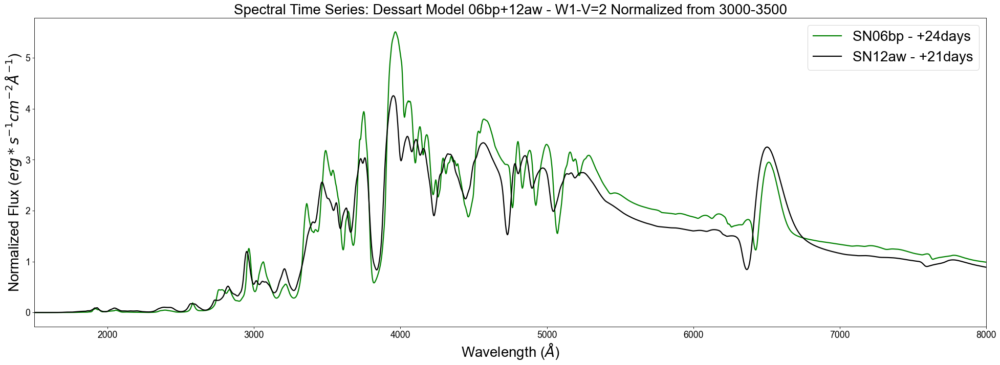

In [31]:
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - W1-V=2 Normalized from 3000-3500',fontsize=font)
plt.plot(SN06bp_24_wave_m,SN06bp_24_norm_m,linewidth=2,label='SN06bp - +24days',c='green')
plt.plot(SN12aw_21_wave_m,SN12aw_21_norm_m,linewidth=2,label='SN12aw - +21days',c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Normalized Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.legend(loc=1,fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
#plt.ylim(-0.0000010,0.000012)
plt.show()

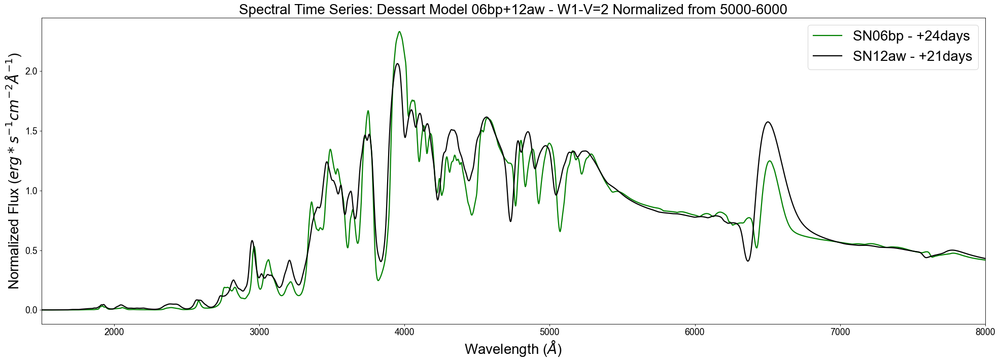

In [33]:
fig = plt.figure(figsize=(30, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Spectral Time Series: Dessart Model 06bp+12aw - W1-V=2 Normalized from 5000-6000',fontsize=font)
plt.plot(SN06bp_24_wave_m,SN06bp_24_norm_m,linewidth=2,label='SN06bp - +24days',c='green')
plt.plot(SN12aw_21_wave_m,SN12aw_21_norm_m,linewidth=2,label='SN12aw - +21days',c='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Normalized Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.legend(loc=1,fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
#plt.ylim(-0.0000010,0.000012)
plt.show()

In [ ]:
# how long does absorption take to cover up certain bands?
Start putting observations next to models and see how self similar spectra are to eaach other, models are to each other, self similar models are to observations

future: how uniform is the color evolution over time with the photometry?

In [ ]:
check with spectrophotometry to see if the galaxy is adding flux or what
pull up ds9 images to see if anything is messing with the sn spectra

model consistently in black
# spectra in different colors; each sn has a color
# make sure to use the website to make sure it's accessible; 
# add a plus constant based on time on y axis

Currently: maybe do a u-v color and look at the color evolution of the models (look at the tilts) for 06bp and 12aw
temperature then ionization which depends on temperature plus composition difference between objects

!! normalize the spectra to a specific wavelength and see which matches with the feature strengths
spectrophotometry for the color evolution plots

6/22/2022
# make individual epoch plots to see how features line up (matching in time)
# with the same colors, at these different dates, what do the spectra look like? also at same color but different epochs what do the spectra look like
# make plots of bluer colors 

6/29/22
# Normalize in V band w1v=2 and see what the structure looks like - how determined are the UV features based on time or color
# Can compare the early swift spectra for 2021yja to others to see how they compare

7/13/22
#normalize 14 day epoch across all (13ej might be weird)
#look at colors at this epoch to compare with photometry (reddest or bluest)
colors: look at the spectra before and after the slope drop off for new features - Calcium at 3500?
for normalization plot:
-continuum normalized to 1, how wide is the line? think of normalizing area
-normalize to peaks on right or left, then compare depth of the line with the continuum at the same place (2700-2900)
#what is the color evolution of the objects and the models to see how they match up

# <a id='14'>All SNe plots</a> 
[Table of Contents](#0)

## <a id='14a'>IIbs</a> 
[Table of Contents](#0)

### <a id='14a1'>SN2011dh</a> 
[Table of Contents](#0)

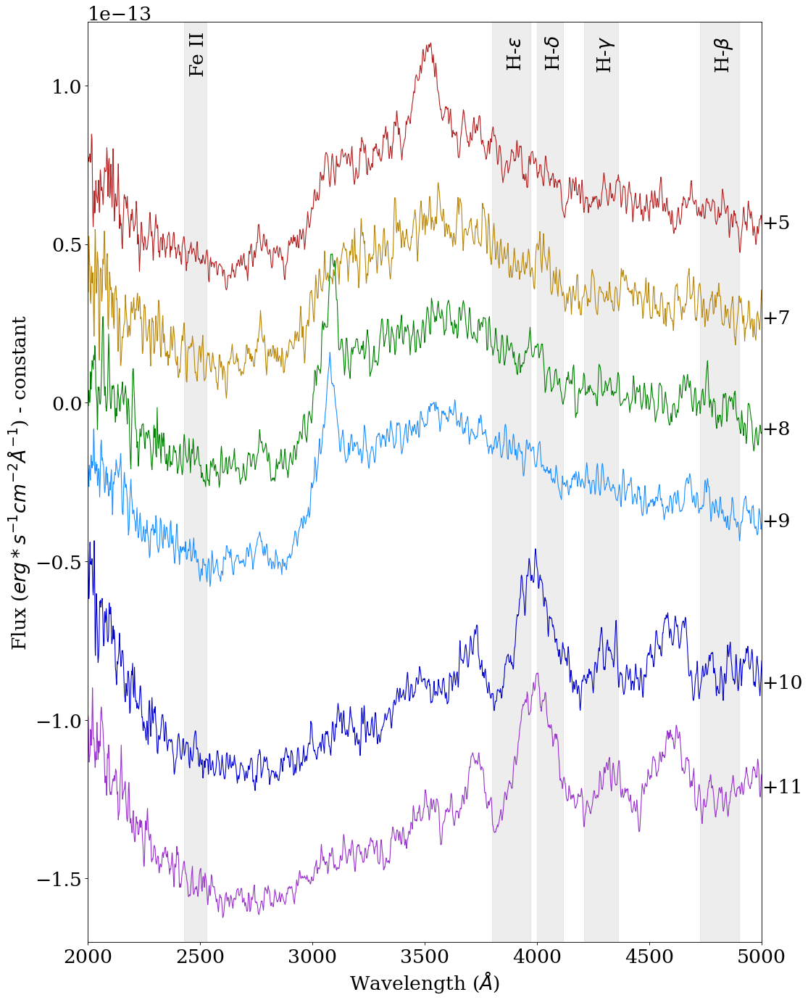

In [136]:
sum_005_wavelength,sum_005_flux,sum_005_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017005sumspectrum.txt', unpack=True)
sum_013_wavelength,sum_013_flux,sum_013_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017013sumspectrum.txt', unpack=True)
sum_017_wavelength,sum_017_flux,sum_017_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017017sumspectrum.txt', unpack=True)
sum_020_wavelength,sum_020_flux,sum_020_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017020sumspectrum.txt', unpack=True)
sum_023_wavelength,sum_023_flux,sum_023_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017023sumspectrum.txt', unpack=True)
sum_026_wavelength,sum_026_flux,sum_026_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017026sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 21), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2011dh Swift UV GRISM Spectra',fontsize=font)
# removing the zeroth order stellar feature 005
#sum_19005_wavelength_ol = []
#sum_19005_flux_ol = []
#sum_19005_wavelength_om = []
#sum_19005_flux_om = []
#sum_19005_wavelength_oh = []
#sum_19005_flux_oh = []
#for i in range(len(sum_19005_wavelength)):
#    if sum_19005_wavelength[i] < 2010:
#        sum_19005_wavelength_ol.append(sum_19005_wavelength[i])
#        sum_19005_flux_ol.append(sum_19005_flux[i])
#    if sum_19005_wavelength[i] > 2135:
#        sum_19005_wavelength_oh.append(sum_19005_wavelength[i])
#        sum_19005_flux_oh.append(sum_19005_flux[i])
#    if sum_19005_wavelength[i] > 2010 and sum_19005_wavelength[i] < 2135:
#        sum_19005_wavelength_om.append(sum_19005_wavelength[i])
#        sum_19005_flux_om.append(sum_19005_flux[i])
#sum_19005_flux_ol = np.array(sum_19005_flux_ol)
#sum_19005_flux_om = np.array(sum_19005_flux_om)
#sum_19005_flux_oh = np.array(sum_19005_flux_oh)

plt.plot(sum_005_wavelength,sum_005_flux,label='5 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_013_wavelength,sum_013_flux-0.00000000000003,label='7 days after explosion',linewidth=1,c='darkgoldenrod')
plt.plot(sum_017_wavelength,sum_017_flux-0.00000000000007,label='8 days after explosion',linewidth=1,c='green')
plt.plot(sum_020_wavelength,sum_020_flux-0.00000000000010,label='9 days after explosion',linewidth=1,c='dodgerblue')
plt.plot(sum_023_wavelength,sum_023_flux-0.00000000000015,label='10 days after explosion',linewidth=1,c='mediumblue')
plt.plot(sum_026_wavelength,sum_026_flux-0.00000000000019,label='11 days after explosion',linewidth=1,c='darkorchid')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.000000000000055,'+5',fontsize=font)
plt.text(5000,0.000000000000025,'+7',fontsize=font)
plt.text(5000,-0.000000000000010,'+8',fontsize=font)
plt.text(5000,-0.000000000000039,'+9',fontsize=font)
plt.text(5000,-0.000000000000090,'+10',fontsize=font)
plt.text(5000,-0.000000000000123,'+11',fontsize=font)
# plotting vertical shaded bars for features
# FeII (Fig 1 https://iopscience.iop.org/article/10.1088/0004-637X/803/1/40/pdf)
plt.axvspan(2430, 2530, alpha=0.5, color='gainsboro')
plt.text(2450,0.000000000000104,'Fe II',fontsize=font1,rotation='vertical')
# H-epsilon (ch 13 pg 260 of SN book fig 16 & 17)
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3865,0.000000000000106,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta (ch 13 pg 260 of SN book fig 16 & 17)
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4035,0.000000000000106,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma (ch 13 pg 260 of SN book fig 16 & 17)
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4260,0.000000000000106,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta (ch 13 pg 260 of SN book fig 16 & 17)
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4785,0.000000000000106,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.00000000000017,0.00000000000012)
plt.savefig("SN2011dh_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()
# The 005 013 017 020 look like there are 2 it picks up, but overall it is superrrr diffuse
# the 1st order grism light in the sky images for 023 and 026 looks broken up? It doesn't seem like a solid line
# it doesn't look like it is picking up the SN light, but I don't know what other light it could be picking up
# I wonder if it could be picking up the spectrum coming from the bright center of the galaxy?

#### SN2011dh Figure Caption

SN2011dh \textit{Swift} UV grism spectra. Days from explosion are shown on the right. The spectra are offset for presentation purposes. The grey shaded regions are areas where particular spectral lines could be visible for that SN type.

#### SN2011dh in text comments

Besides the lack of any significant Balmer-series features, with small differences, the overall shape of the continua for the first four epochs are similar enough to each other to raise suspicions. To explore the validity of these spectra further, we refer to the synthetic photometry and the photometry comparison. With the smallest difference being around 1.5 magnitudes in the reddest filter and the biggest around 5 magnitudes in the bluer filters, this SN spectra do not seem reliable.

TAKE OUT PART TALKING ABOUT THE CONTINUA

### <a id='14a2'>SN2013df</a> 
[Table of Contents](#0)

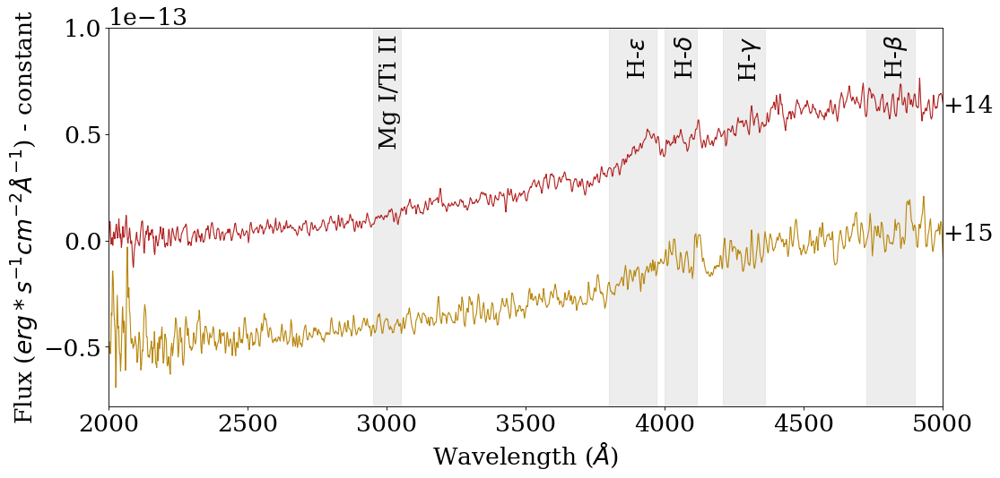

In [70]:
sum_006_wavelength,sum_006_flux,sum_006_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/1SN2013df/00032862006sumspectrum.txt', unpack=True)
sum_009_wavelength,sum_009_flux,sum_009_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/1SN2013df/00032862009sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 7), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2013df Swift UV GRISM Spectra',fontsize=font)
plt.plot(sum_006_wavelength,sum_006_flux,label='14 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_009_wavelength,sum_009_flux-0.00000000000005,label='15 days after explosion',linewidth=1,c='darkgoldenrod')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.00000000000006,'+14',fontsize=font)
plt.text(5000,0.00000000000000,'+15',fontsize=font)
# plotting vertical shaded bars for features
# MgI/TiII (Fig 1 https://iopscience.iop.org/article/10.1088/0004-637X/803/1/40/pdf)
plt.axvspan(2950, 3050, alpha=0.5, color='gainsboro')
plt.text(2970,0.000000000000045,'Mg I/Ti II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3865,0.000000000000078,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4035,0.000000000000078,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4260,0.000000000000078,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4785,0.000000000000079,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.000000000000078,0.0000000000001)
plt.savefig("SN2013df_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()
# the spike in the second spectrum does not seem to be from a zeroth order source

#### SN2013df Figure Caption

SN2013df \textit{Swift} UV grism spectra. Days from explosion are shown on the right. The spectra are offset for presentation purposes. The grey shaded regions are areas where particular spectral lines could be visible for that SN type. 

#### SN2013df in text comments

Besides the lack of any significant Balmer-series features, the overall shape of the continua are similar enough to each other to raise suspicions. To explore the validity of these spectra further, we refer to the synthetic photometry and the photometry comparison. With the smallest difference being around 1 magnitude and the largest around 3 magnitudes, these SN spectra do not seem reliable.

### <a id='14a3'>SN2016gkg</a> 
[Table of Contents](#0)

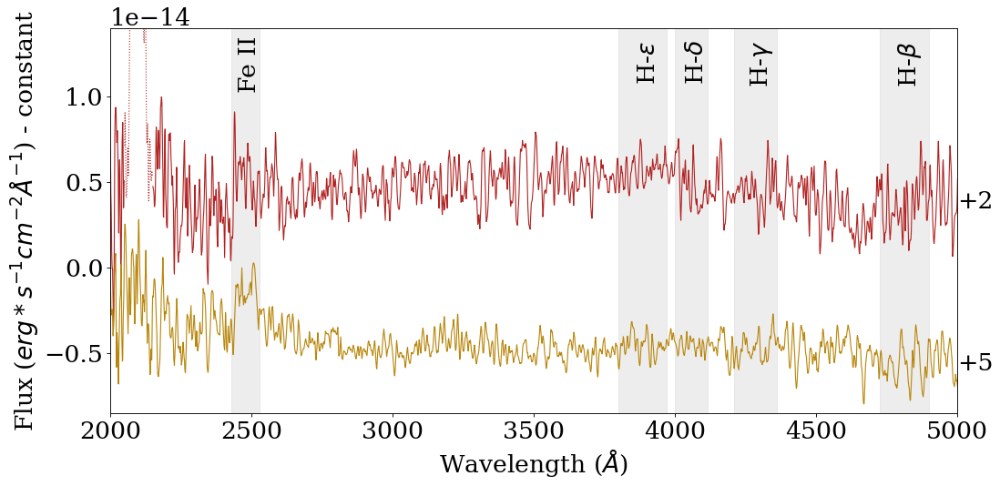

In [71]:
sum_001_wavelength,sum_001_flux,sum_001_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/8SN2016gkg/00034737001sumspectrum.txt', unpack=True)
sum_003_wavelength,sum_003_flux,sum_003_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/8SN2016gkg/00034737003sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 7), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2016gkg Swift UV GRISM Spectra',fontsize=font)
# removing the zeroth order stellar feature 001
sum_001_wavelength_ol = []
sum_001_flux_ol = []
sum_001_wavelength_om = []
sum_001_flux_om = []
sum_001_wavelength_oh = []
sum_001_flux_oh = []
for i in range(len(sum_001_wavelength)):
    if sum_001_wavelength[i] < 2050:
        sum_001_wavelength_ol.append(sum_001_wavelength[i])
        sum_001_flux_ol.append(sum_001_flux[i])
    if sum_001_wavelength[i] > 2150:
        sum_001_wavelength_oh.append(sum_001_wavelength[i])
        sum_001_flux_oh.append(sum_001_flux[i])
    if sum_001_wavelength[i] > 2050 and sum_001_wavelength[i] < 2150:
        sum_001_wavelength_om.append(sum_001_wavelength[i])
        sum_001_flux_om.append(sum_001_flux[i])
sum_001_flux_ol = np.array(sum_001_flux_ol)
sum_001_flux_om = np.array(sum_001_flux_om)
sum_001_flux_oh = np.array(sum_001_flux_oh)

plt.plot(sum_001_wavelength_ol,sum_001_flux_ol,label='2 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_001_wavelength_om,sum_001_flux_om,label='2 days after explosion',linewidth=1,c='firebrick',linestyle='dotted')
plt.plot(sum_001_wavelength_oh,sum_001_flux_oh,label='2 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_003_wavelength,sum_003_flux-0.000000000000006,label='5 days after explosion',linewidth=1,c='darkgoldenrod')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.0000000000000035,'+2',fontsize=font)
plt.text(5000,-0.000000000000006,'+5',fontsize=font)
# plotting vertical shaded bars for features
# FeII (Fig 1 https://iopscience.iop.org/article/10.1088/0004-637X/803/1/40/pdf)
plt.axvspan(2430, 2530, alpha=0.5, color='gainsboro')
plt.text(2450,0.0000000000000105,'Fe II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3865,0.000000000000011,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4035,0.000000000000011,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4260,0.000000000000011,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4785,0.000000000000011,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.0000000000000085,0.000000000000014)
plt.savefig("SN2016gkg_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()
# the zeroth order feature seems to come from a streak across the image, bc there isn't a zeroth order object close enought to make a difference I think
# the second spectrum is pretty stinking faint, so the s/n just might be too low

#### SN2016gkg Figure Caption

SN2016gkg \textit{Swift} UV grism spectra. Days from explosion are shown on the right. The spectra are offset for presentation purposes. The zeroth order light contamination present in the day +2 spectrum is shown with a dotted line. The grey shaded regions are areas where particular spectral lines could be visible for that SN type.

#### SN2016gkg in text comments

Zeroth order light contamination is present in the day +2 spectrum and is shown with a dotted line. An emission feature in the FeII region seems present. A small P-Cygni profile seems visible in the H-beta region for the day +2 spectrum, but it is hard to tell because it is almost overwhelmed by the noise. To further validate these spectra, we refer to the synthetic photometry and the photometry comparison. The biggest difference is around 2 magnitudes in the bluest filter, while the synthetic photometry matches pretty well in all of the other filters. This makes it more likely that these SN spectra are the most reliable of the \textit{Swift} Type IIb SNe spectral sample.

## <a id='14b'>IIns</a> 
[Table of Contents](#0)

### <a id='14b1'>SN2007pk</a> 
[Table of Contents](#0)

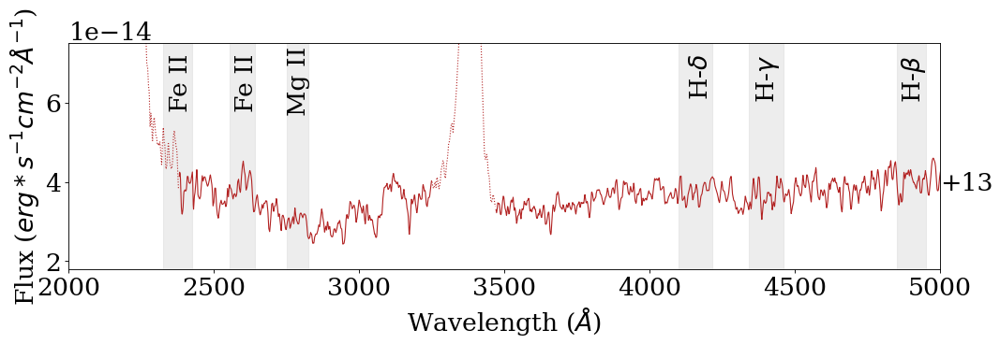

In [72]:
sum_008_wavelength,sum_008_flux,sum_008_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII_/1SN2007pk/00031014008sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 4), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2007pk Swift UV GRISM Spectra',fontsize=font)
# removing the zeroth order stellar feature 008
sum_008_wavelength_ol = []
sum_008_flux_ol = []
sum_008_wavelength_olh = []
sum_008_flux_olh = []
sum_008_wavelength_om = []
sum_008_flux_om = []
sum_008_wavelength_oh = []
sum_008_flux_oh = []
for i in range(len(sum_008_wavelength)):
    if sum_008_wavelength[i] < 2380:
        sum_008_wavelength_ol.append(sum_008_wavelength[i])
        sum_008_flux_ol.append(sum_008_flux[i])
    if sum_008_wavelength[i] < 3250 and sum_008_wavelength[i] > 2380:
        sum_008_wavelength_olh.append(sum_008_wavelength[i])
        sum_008_flux_olh.append(sum_008_flux[i])
    if sum_008_wavelength[i] > 3470:
        sum_008_wavelength_oh.append(sum_008_wavelength[i])
        sum_008_flux_oh.append(sum_008_flux[i])
    if sum_008_wavelength[i] > 3250 and sum_008_wavelength[i] < 3470:
        sum_008_wavelength_om.append(sum_008_wavelength[i])
        sum_008_flux_om.append(sum_008_flux[i])
sum_008_flux_ol = np.array(sum_008_flux_ol)
sum_008_flux_olh = np.array(sum_008_flux_olh)
sum_008_flux_om = np.array(sum_008_flux_om)
sum_008_flux_oh = np.array(sum_008_flux_oh)

plt.plot(sum_008_wavelength_ol,sum_008_flux_ol,label='13 days after explosion',linewidth=1,c='firebrick',linestyle='dotted')
plt.plot(sum_008_wavelength_olh,sum_008_flux_olh,label='13 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_008_wavelength_om,sum_008_flux_om,label='13 days after explosion',linewidth=1,c='firebrick',linestyle='dotted')
plt.plot(sum_008_wavelength_oh,sum_008_flux_oh,label='13 days after explosion',linewidth=1,c='firebrick')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.000000000000038,'+13',fontsize=font)
# plotting vertical shaded bars for features
# FeII (Fig 3e of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2325, 2425, alpha=0.5, color='gainsboro')
plt.text(2345,0.000000000000059,'Fe II',fontsize=font1,rotation='vertical')
# FeII (Fig 3f of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2555, 2640, alpha=0.5, color='gainsboro')
plt.text(2570,0.000000000000059,'Fe II',fontsize=font1,rotation='vertical')
# MgII (Fig 3f of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2750, 2825, alpha=0.5, color='gainsboro')
plt.text(2750,0.000000000000058,'Mg II',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4100, 4215, alpha=0.5, color='gainsboro')
plt.text(4135,0.000000000000062,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4340, 4460, alpha=0.5, color='gainsboro')
plt.text(4360,0.000000000000062,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta (ch 12 fig 17 on SN book pg 223)
plt.axvspan(4850, 4950, alpha=0.5, color='gainsboro')
plt.text(4860,0.000000000000062,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(0.000000000000018,0.000000000000075)
plt.savefig("SN2007pk_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()
# the 3300 is definitely a zeroth order object contamination
# the early rise at 2200 is probably from it starting off really close to the galaxy with a couple zeroth order stars and such

#### SN2007pk Figure Caption

SN2007pk \textit{Swift} UV grism spectra. Days from explosion are shown on the right. The zeroth order light contaminations present in the day +13 spectrum are shown with dotted lines. The grey shaded regions are areas where particular spectral lines could be visible for that SN type.

#### SN2007pk in text comments

Zeroth order light contaminations are present in the day +13 spectrum and are shown with dotted lines. Any significant features do not seem to be visible in the grey shaded regions. To check the validity of this spectrum, we look at the synthetic photometry and photometry comparison. With the smallest difference being around 2 magnitudes and the biggest difference around 4 magnitudes, this SN spectrum does not seem reliable.

### <a id='14b2'>SN2010jl</a> 
[Table of Contents](#0)

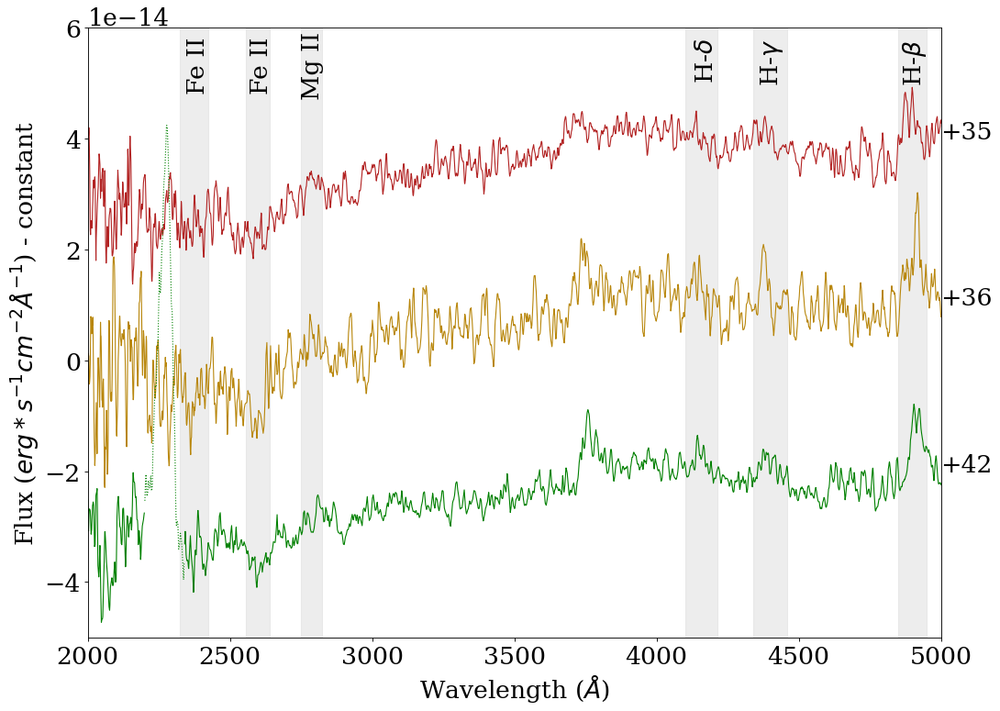

In [73]:
sum_002_wavelength,sum_002_flux,sum_002_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/1SN2010jl/00031858002sumspectrum.txt', unpack=True)
sum_004_wavelength,sum_004_flux,sum_004_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/1SN2010jl/00031858004sumspectrum.txt', unpack=True)
sum_014_wavelength,sum_014_flux,sum_014_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/1SN2010jl/00031858014sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 11), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2010jl Swift UV GRISM Spectra',fontsize=font)
# removing the zeroth order stellar feature 014
sum_014_wavelength_ol = []
sum_014_flux_ol = []
sum_014_wavelength_om = []
sum_014_flux_om = []
sum_014_wavelength_oh = []
sum_014_flux_oh = []
for i in range(len(sum_014_wavelength)):
    if sum_014_wavelength[i] < 2200:
        sum_014_wavelength_ol.append(sum_014_wavelength[i])
        sum_014_flux_ol.append(sum_014_flux[i])
    if sum_014_wavelength[i] > 2340:
        sum_014_wavelength_oh.append(sum_014_wavelength[i])
        sum_014_flux_oh.append(sum_014_flux[i])
    if sum_014_wavelength[i] > 2200 and sum_014_wavelength[i] < 2340:
        sum_014_wavelength_om.append(sum_014_wavelength[i])
        sum_014_flux_om.append(sum_014_flux[i])
sum_014_flux_ol = np.array(sum_014_flux_ol)
sum_014_flux_om = np.array(sum_014_flux_om)
sum_014_flux_oh = np.array(sum_014_flux_oh)

plt.plot(sum_002_wavelength,sum_002_flux,label='35 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_004_wavelength,sum_004_flux-0.00000000000003,label='36 days after explosion',linewidth=1,c='darkgoldenrod')
plt.plot(sum_014_wavelength_ol,sum_014_flux_ol-0.00000000000006,label='42 days after explosion',linewidth=1,c='green')
plt.plot(sum_014_wavelength_om,sum_014_flux_om-0.00000000000006,label='42 days after explosion',linewidth=1,c='green',linestyle='dotted')
plt.plot(sum_014_wavelength_oh,sum_014_flux_oh-0.00000000000006,label='42 days after explosion',linewidth=1,c='green')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.00000000000004,'+35',fontsize=font)
plt.text(5000,0.00000000000001,'+36',fontsize=font)
plt.text(5000,-0.00000000000002,'+42',fontsize=font)
# plotting vertical shaded bars for features
# FeII (Fig 3e of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2325, 2425, alpha=0.5, color='gainsboro')
plt.text(2345,0.000000000000049,'Fe II',fontsize=font1,rotation='vertical')
# FeII (Fig 3f of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2555, 2640, alpha=0.5, color='gainsboro')
plt.text(2570,0.000000000000049,'Fe II',fontsize=font1,rotation='vertical')
# MgII (Fig 3f of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2750, 2825, alpha=0.5, color='gainsboro')
plt.text(2750,0.000000000000048,'Mg II',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4100, 4215, alpha=0.5, color='gainsboro')
plt.text(4135,0.000000000000051,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4340, 4460, alpha=0.5, color='gainsboro')
plt.text(4360,0.000000000000051,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta (ch 12 fig 17 on SN book pg 223)
plt.axvspan(4850, 4950, alpha=0.5, color='gainsboro')
plt.text(4860,0.000000000000051,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.00000000000005,0.00000000000006)
plt.savefig("SN2010jl_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

#### SN2010jl Figure Caption

SN2010jl \textit{Swift} UV grism spectra. Days from explosion are shown on the right. The spectra are offset for presentation purposes. The zeroth order light contamination present in the day +42 spectrum is shown with a dotted line. The grey shaded regions are areas where particular spectral lines could be visible for that SN type. 

#### SN2010jl in text comments

Zeroth order light contamination is present in the day +42 spectrum and is shown with a dotted line. The narrow Balmer emission features typical of Type IIn SNe appear present in all three epochs. Also, FeII absorption features seem present especially in the day +36 and +42 spectra (do i need to cite the paper where I found the FeII lines in a IIn spectrum?). To further validate these spectra, we refer to the synthetic photometry and photometry comparison. With the biggest difference being about 2 magnitudes and an average difference of 1 magnitude, these spectra could be suspect but are not bad enough to entirely discount.

### <a id='14b3'>SN2011ht</a> 
[Table of Contents](#0)

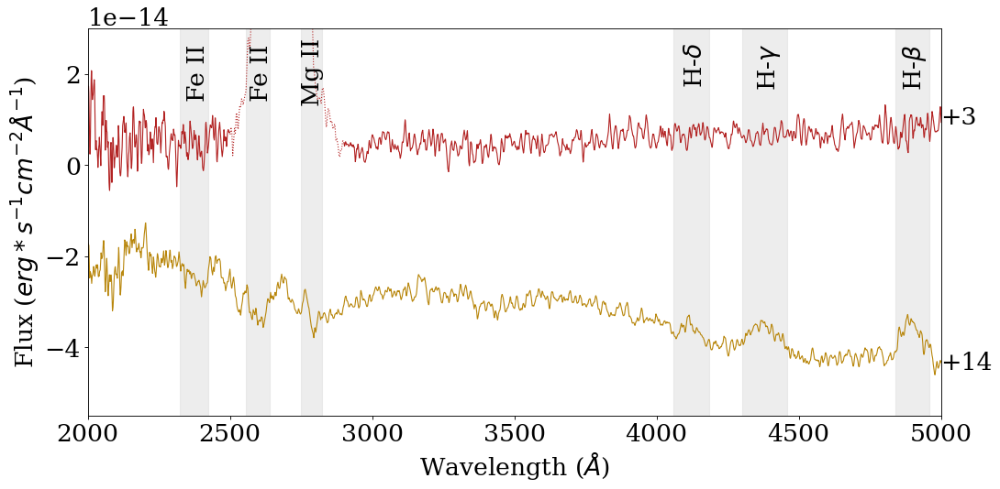

In [74]:
sum_001_wavelength,sum_001_flux,sum_001_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/2SN2011ht/00032150001sumspectrum.txt', unpack=True)
sum_003_wavelength,sum_003_flux,sum_003_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/2SN2011ht/00032150003sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 7), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2011ht Swift UV GRISM Spectra',fontsize=font)
# removing the zeroth order stellar feature 001
sum_001_wavelength_ol = []
sum_001_flux_ol = []
sum_001_wavelength_om = []
sum_001_flux_om = []
sum_001_wavelength_oh = []
sum_001_flux_oh = []
for i in range(len(sum_001_wavelength)):
    if sum_001_wavelength[i] < 2500:
        sum_001_wavelength_ol.append(sum_001_wavelength[i])
        sum_001_flux_ol.append(sum_001_flux[i])
    if sum_001_wavelength[i] > 2900:
        sum_001_wavelength_oh.append(sum_001_wavelength[i])
        sum_001_flux_oh.append(sum_001_flux[i])
    if sum_001_wavelength[i] > 2500 and sum_001_wavelength[i] < 2900:
        sum_001_wavelength_om.append(sum_001_wavelength[i])
        sum_001_flux_om.append(sum_001_flux[i])
sum_001_flux_ol = np.array(sum_001_flux_ol)
sum_001_flux_om = np.array(sum_001_flux_om)
sum_001_flux_oh = np.array(sum_001_flux_oh)

plt.plot(sum_001_wavelength_ol,sum_001_flux_ol,label='3 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_001_wavelength_om,sum_001_flux_om,label='3 days after explosion',linewidth=1,c='firebrick',linestyle='dotted')
plt.plot(sum_001_wavelength_oh,sum_001_flux_oh,label='3 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_003_wavelength,sum_003_flux-0.00000000000007,label='14 days after explosion',linewidth=1,c='darkgoldenrod')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.000000000000009,'+3',fontsize=font)
plt.text(5000,-0.000000000000045,'+14',fontsize=font)
# plotting vertical shaded bars for features
# FeII (Fig 3e of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2325, 2425, alpha=0.5, color='gainsboro')
plt.text(2345,0.000000000000015,'Fe II',fontsize=font1,rotation='vertical')
# FeII (Fig 3f of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2555, 2640, alpha=0.5, color='gainsboro')
plt.text(2570,0.000000000000015,'Fe II',fontsize=font1,rotation='vertical')
# MgII (Fig 3f of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2750, 2825, alpha=0.5, color='gainsboro')
plt.text(2750,0.000000000000014,'Mg II',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4060, 4185, alpha=0.5, color='gainsboro')
plt.text(4095,0.000000000000018,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4300, 4460, alpha=0.5, color='gainsboro')
plt.text(4350,0.000000000000018,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta (ch 12 fig 17 on SN book pg 223)
plt.axvspan(4840, 4960, alpha=0.5, color='gainsboro')
plt.text(4860,0.000000000000018,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.000000000000055,0.00000000000003)
plt.savefig("SN2011ht_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

#### SN2011ht Figure Caption

SN2011ht \textit{Swift} UV grism spectra. Days from explosion are shown on the right. The spectra are offset for presentation purposes. The zeroth order light contamination present in the day +3 spectrum is shown with a dotted line. The grey shaded regions are areas where particular spectral lines could be visible for that SN type. 

#### SN2011ht in text comments

Zeroth order light contamination is present in the day +3 spectrum and is shown with a dotted line. The narrow Balmer emission features typical of Type IIn SNe appear present in the second epoch. Also, FeII absorption features seem present in the day +14 spectrum but are hard to verify due to the zeroth order light contamination in the first epoch (do i need to cite the paper where I found the FeII lines in a IIn spectrum?). To further validate these spectra, we refer to the synthetic photometry and photometry comparison. The biggest difference is about 8 magnitudes for the first epoch in the UV filters, but this large difference could be explained by the large amount of zeroth order light contamination. For the rest of the observations, the largest difference is around 4 magnitudes, with the average difference being around 2 magnitudes. These spectra are more likely suspect when looking at the photometry, but when taking into account the visible Balmer features, they seem not bad enough to entirely discount.

### <a id='14b4'>SN2013L</a> 
[Table of Contents](#0)

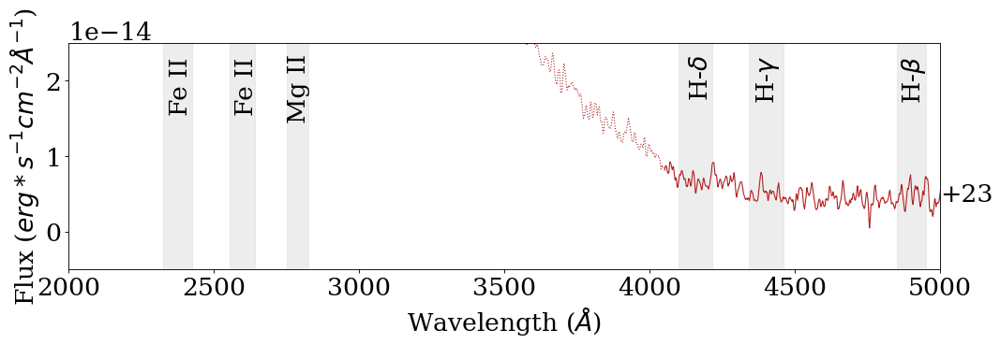

In [75]:
sum_003_wavelength,sum_003_flux,sum_003_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/4SN2013L/00032693003sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 4), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2013L Swift UV GRISM Spectra',fontsize=font)
# removing the first order grism feature 003
sum_003_wavelength_ol = []
sum_003_flux_ol = []
sum_003_wavelength_oh = []
sum_003_flux_oh = []
for i in range(len(sum_003_wavelength)):
    if sum_003_wavelength[i] < 4050:
        sum_003_wavelength_ol.append(sum_003_wavelength[i])
        sum_003_flux_ol.append(sum_003_flux[i])
    if sum_003_wavelength[i] > 4050:
        sum_003_wavelength_oh.append(sum_003_wavelength[i])
        sum_003_flux_oh.append(sum_003_flux[i])
sum_003_flux_ol = np.array(sum_003_flux_ol)
sum_003_flux_oh = np.array(sum_003_flux_oh)

plt.plot(sum_003_wavelength_ol,sum_003_flux_ol,label='23 days after explosion',linewidth=1,c='firebrick',linestyle='dotted')
plt.plot(sum_003_wavelength_oh,sum_003_flux_oh,label='23 days after explosion',linewidth=1,c='firebrick')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.000000000000004,'+23',fontsize=font)
# plotting vertical shaded bars for features
# FeII (Fig 3e of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2325, 2425, alpha=0.5, color='gainsboro')
plt.text(2345,0.000000000000016,'Fe II',fontsize=font1,rotation='vertical')
# FeII (Fig 3f of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2555, 2640, alpha=0.5, color='gainsboro')
plt.text(2570,0.000000000000016,'Fe II',fontsize=font1,rotation='vertical')
# MgII (Fig 3f of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2750, 2825, alpha=0.5, color='gainsboro')
plt.text(2750,0.000000000000015,'Mg II',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4100, 4215, alpha=0.5, color='gainsboro')
plt.text(4135,0.000000000000018,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4340, 4460, alpha=0.5, color='gainsboro')
plt.text(4360,0.000000000000018,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta (ch 12 fig 17 on SN book pg 223)
plt.axvspan(4850, 4950, alpha=0.5, color='gainsboro')
plt.text(4860,0.000000000000018,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.000000000000005,0.000000000000025)
plt.savefig("SN2013L_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()
# Superrrr busy star field, and there is a really bright spectrum that takes over basically until around 4000, and even then idk if it picks up the SN spectrum from there

#### SN2013L Figure Caption

SN2013L \textit{Swift} UV grism spectra. Days from explosion are shown on the right. The zeroth order light contamination present in the day +23 spectrum is shown with a dotted line. The grey shaded regions are areas where particular spectral lines could be visible for that SN type. 

#### SN2013L in text comments

Zeroth order light contamination is present in the day +23 spectrum and is shown with a dotted line. It takes up the majority of the spectrum present. Additionally, the narrow Balmer emission features typical of Type IIn SNe do not appear present in this spectrum. As expected because of the zeroth order light contamination, there is a large difference with the synthetic photometry and photometry topping out at 8 magnitudes in the bluest filters. The difference is smaller in the redder filters, but the summation of evidence makes it likely that this SN spectrum is not reliable.

Zeroth order light contamination is present in the day +2 spectrum and is shown with a dotted line. An emission feature in the FeII region seems present. A small P-Cygni profile seems visible in the H-beta region for the day +2 spectrum, but it is hard to tell because it is almost overwhelmed by the noise. To further validate these spectra, we refer to the synthetic photometry and the photometry comparison shown in Figure~\ref{sn16gkg_sp}. The biggest difference is around 2 magnitudes in the bluest filter, while the synthetic photometry matches pretty well in all of the other filters. This makes it more likely that these SN spectra are the most reliable of the \textit{Swift} Type IIb SNe spectral sample.
Like SN2011dh, the lack of any significant Balmer-series features raise suspicions. To explore the validity of these spectra, the comparison presented in Figure~\ref{sn13df_sp} is used. With the smallest difference being around 1.5 magnitudes in the reddest filter and the biggest around 5 magnitudes in the bluer filters, these SN spectra do not seem reliable.

### <a id='14b5'>SN2015bf</a> 
[Table of Contents](#0)

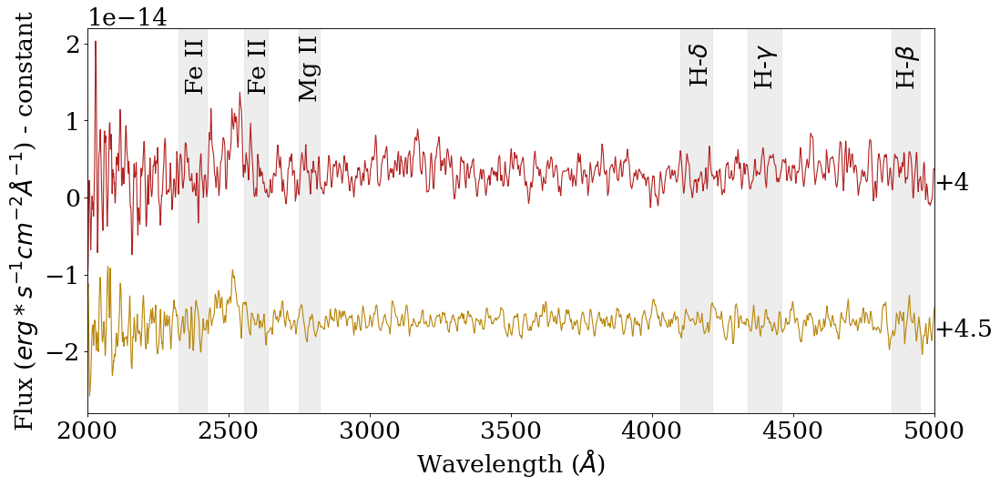

In [76]:
sum_002_wavelength,sum_002_flux,sum_002_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/6SN2015bf/00034221002sumspectrum.txt', unpack=True)
sum_003_wavelength,sum_003_flux,sum_003_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/6SN2015bf/00034221003sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 7), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2015bf Swift UV GRISM Spectra',fontsize=font)
plt.plot(sum_002_wavelength,sum_002_flux,label='4 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_003_wavelength,sum_003_flux-0.00000000000002,label='4.5 days after explosion',linewidth=1,c='darkgoldenrod')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.000000000000001,'+4',fontsize=font)
plt.text(5000,-0.000000000000018,'+4.5',fontsize=font)
# plotting vertical shaded bars for features
# FeII (Fig 3e of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2325, 2425, alpha=0.5, color='gainsboro')
plt.text(2345,0.000000000000014,'Fe II',fontsize=font1,rotation='vertical')
# FeII (Fig 3f of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2555, 2640, alpha=0.5, color='gainsboro')
plt.text(2570,0.000000000000014,'Fe II',fontsize=font1,rotation='vertical')
# MgII (Fig 3f of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2750, 2825, alpha=0.5, color='gainsboro')
plt.text(2750,0.000000000000013,'Mg II',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4100, 4215, alpha=0.5, color='gainsboro')
plt.text(4135,0.000000000000015,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4340, 4460, alpha=0.5, color='gainsboro')
plt.text(4360,0.000000000000015,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta (ch 12 fig 17 on SN book pg 223)
plt.axvspan(4850, 4950, alpha=0.5, color='gainsboro')
plt.text(4860,0.000000000000015,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.000000000000028,0.000000000000022)
plt.savefig("SN2015bf_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()
# 006 not included bc it was too faint





#### SN2011dh Figure Caption
SN2011dh \textit{Swift} UV grism spectra. Days from explosion are shown on the right. The spectra are offset for presentation purposes. The zeroth order light contamination present in the day +10 spectrum is shown with a dotted line. The grey shaded regions are areas where particular spectral lines could be visible for that SN type. 

Comparison of SN2005cs model from Dr. Luc Dessart and Swift observations. The last observational epoch is excluded because a model epoch was unavailable for comparison. Zeroth order contamination from another object is omitted in the observed yellow spectrum from 2350-2470 $Å$. Oversubtraction/bad sensitivity areas are cut off in the observed spectra in wavelengths less than 1925 $Å$ on days +7, +10, and +12 and in wavelengths less than 2500 $Å$ on days +15 and +17. 1e-12 is the y-axis scaling. The spectral epochs on the right are days from explosion with the observational epoch in black and the model epoch in grey. The spectra are offset for presentation purposes. We use the models to look for features in the observed spectra as labeled at the top and highlighted in the grey shaded regions. Observe the over-prediction of certain features like the Mg II line in the earliest epoch.

#### SN2016gkg in text comments
Zeroth order light contamination is present in the day +2 spectrum and is shown with a dotted line. An emission feature in the FeII region seems present. A small P-Cygni profile seems visible in the H-beta region for the day +2 spectrum, but it is hard to tell because it is almost overwhelmed by the noise. To further validate these spectra, we refer to the synthetic photometry and the photometry comparison. The biggest difference is around 2 magnitudes in the bluest filter, while the synthetic photometry matches pretty well in all of the other filters. This makes it more likely that these SN spectra are the most reliable of the \textit{Swift} Type IIb SNe spectral sample.
#### SN2005cs in text comments (IIP)
Zeroth order light contamination is present in the day +10 spectrum, and is shown with a dotted line. The UV flux is still high enough on day +6 to see FeIII line blanketing and the MgII absorption feature, while 3 days later, the flux in the UV has faded and the majority of the flux now resides in the optical. The spectra are almost too noisy to be able to see any hydrogen features, but the p-cygni profile of H-epsilon is evident on Days +14 and +16.
#### SN2011dh in text comments (IIb)
Besides the lack of any significant Balmer-series features, with small differences, the overall shape of the continua for the first four epochs are similar enough to each other to raise suspicions. To explore the validity of these spectra further, we refer to the synthetic photometry and the photometry comparison. With the smallest difference being around 1.5 magnitudes in the reddest filter and the biggest around 5 magnitudes in the bluer filters, these SN spectra do not seem reliable.
#### SN2010jl in text comments (IIn)
Zeroth order light contamination is present in the day +42 spectrum and is shown with a dotted line. The narrow Balmer emission features typical of Type IIn SNe appear present in all three epochs. Also, FeII absorption features seems present especially in the day +36 and +42 spectra (do i need to cite the paper where I found the FeII lines in a IIn spectrum?). To further validate these spectra, we refer to the synthetic photometry and photometry comparison. With the biggest difference being about 2 magnitudes and an average difference of 1 magnitude, these spectra could be suspect but are not bad enough to entirely discount.

### <a id='14b6'>SN2016cvk</a> 
[Table of Contents](#0)

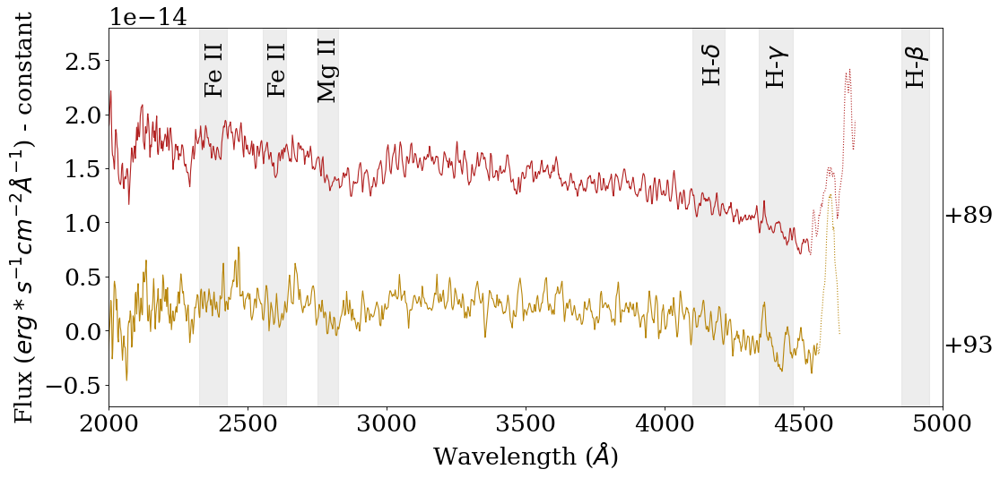

In [77]:
sum_004_wavelength,sum_004_flux,sum_004_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/5SN2016cvk/00034712004sumspectrum.txt', unpack=True)
sum_006_wavelength,sum_006_flux,sum_006_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/5SN2016cvk/00034712006sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 7), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2016cvk Swift UV GRISM Spectra',fontsize=font)
# removing the bright edge of the detector feature 004
sum_004_wavelength_ol = []
sum_004_flux_ol = []
sum_004_wavelength_oh = []
sum_004_flux_oh = []
for i in range(len(sum_004_wavelength)):
    if sum_004_wavelength[i] < 4520:
        sum_004_wavelength_ol.append(sum_004_wavelength[i])
        sum_004_flux_ol.append(sum_004_flux[i])
    if sum_004_wavelength[i] > 4520:
        sum_004_wavelength_oh.append(sum_004_wavelength[i])
        sum_004_flux_oh.append(sum_004_flux[i])
sum_004_flux_ol = np.array(sum_004_flux_ol)
sum_004_flux_oh = np.array(sum_004_flux_oh)
# removing the bright edge of the detector feature 006
sum_006_wavelength_ol = []
sum_006_flux_ol = []
sum_006_wavelength_oh = []
sum_006_flux_oh = []
for i in range(len(sum_006_wavelength)):
    if sum_006_wavelength[i] < 4550:
        sum_006_wavelength_ol.append(sum_006_wavelength[i])
        sum_006_flux_ol.append(sum_006_flux[i])
    if sum_006_wavelength[i] > 4550:
        sum_006_wavelength_oh.append(sum_006_wavelength[i])
        sum_006_flux_oh.append(sum_006_flux[i])
sum_006_flux_ol = np.array(sum_006_flux_ol)
sum_006_flux_oh = np.array(sum_006_flux_oh)

plt.plot(sum_004_wavelength_ol,sum_004_flux_ol,label='89 days after discovery',linewidth=1,c='firebrick')
plt.plot(sum_004_wavelength_oh,sum_004_flux_oh,label='89 days after discovery',linewidth=1,c='firebrick',linestyle='dotted')
plt.plot(sum_006_wavelength_ol,sum_006_flux_ol-0.00000000000001,label='93 days after discovery',linewidth=1,c='darkgoldenrod')
plt.plot(sum_006_wavelength_oh,sum_006_flux_oh-0.00000000000001,label='93 days after discovery',linewidth=1,c='darkgoldenrod',linestyle='dotted')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.00000000000001,'+89',fontsize=font)
plt.text(5000,-0.000000000000002,'+93',fontsize=font)
# plotting vertical shaded bars for features
# FeII (Fig 3e of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2325, 2425, alpha=0.5, color='gainsboro')
plt.text(2345,0.000000000000022,'Fe II',fontsize=font1,rotation='vertical')
# FeII (Fig 3f of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2555, 2640, alpha=0.5, color='gainsboro')
plt.text(2570,0.000000000000022,'Fe II',fontsize=font1,rotation='vertical')
# MgII (Fig 3f of https://ui.adsabs.harvard.edu/abs/2001ApJ...547..406L/abstract)
plt.axvspan(2750, 2825, alpha=0.5, color='gainsboro')
plt.text(2750,0.0000000000000215,'Mg II',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4100, 4215, alpha=0.5, color='gainsboro')
plt.text(4135,0.000000000000023,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4340, 4460, alpha=0.5, color='gainsboro')
plt.text(4360,0.000000000000023,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta (ch 12 fig 17 on SN book pg 223)
plt.axvspan(4850, 4950, alpha=0.5, color='gainsboro')
plt.text(4860,0.000000000000023,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.000000000000007,0.000000000000028)
plt.savefig("SN2016cvk_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()
# no detector image so no spectrum to show for 00034712002
# cuts off past 4500 because it is on the edge of the image and the grism goes off the edge, and the spike is from a bright line along the edge of the image

## <a id='14c'>IIP/Ls</a> 
[Table of Contents](#0)

### <a id='14c1'>SN2005cs</a> 
[Table of Contents](#0)

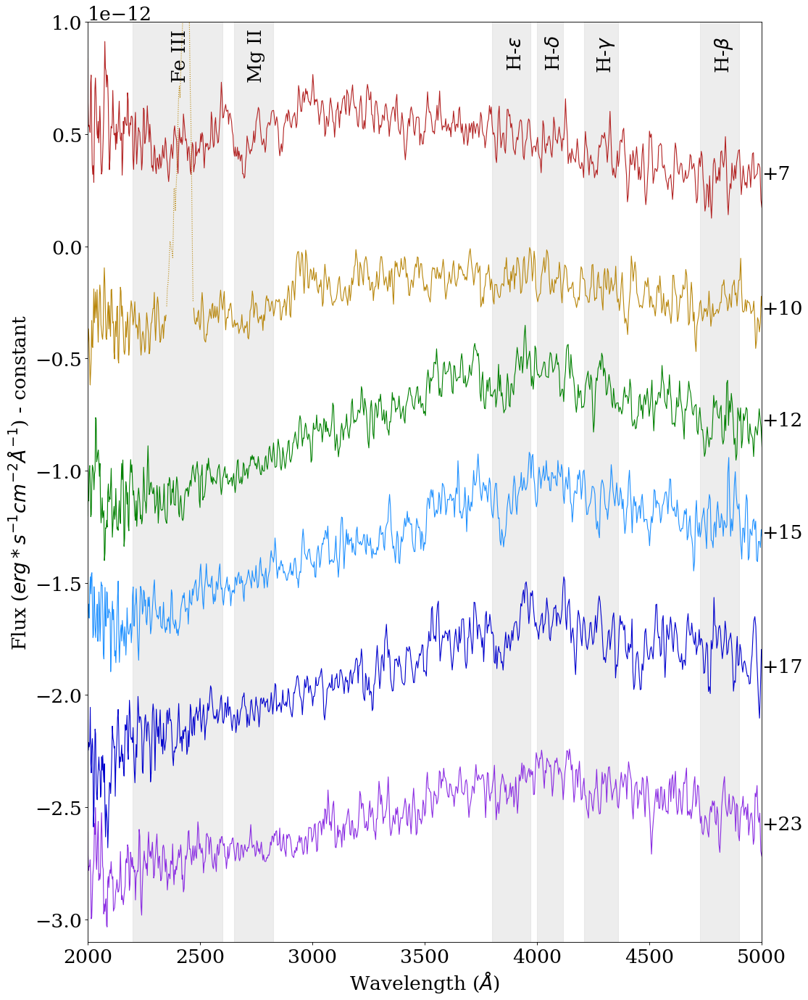

In [78]:
e1_008_wavelength,e1_008_flux,e1_008_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083008e1spectrum.txt', unpack=True)
e1_012_wavelength,e1_012_flux,e1_012_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083012e1spectrum.txt', unpack=True)
e1_017_wavelength,e1_017_flux,e1_017_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083017e1spectrum.txt', unpack=True)
e1_023_wavelength,e1_023_flux,e1_023_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083023e1spectrum.txt', unpack=True)
e1_027_wavelength,e1_027_flux,e1_027_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083027e1spectrum.txt', unpack=True)
e1_035_wavelength,e1_035_flux,e1_035_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/1SN2005cs/00030083035e1spectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 21), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2005cs Swift UV GRISM Spectra',fontsize=font)
# removing the zeroth order stellar feature
e1_012_wavelength_ol = []
e1_012_flux_ol = []
e1_012_wavelength_om = []
e1_012_flux_om = []
e1_012_wavelength_oh = []
e1_012_flux_oh = []
for i in range(len(e1_012_wavelength)):
    if e1_012_wavelength[i] < 2350:
        e1_012_wavelength_ol.append(e1_012_wavelength[i])
        e1_012_flux_ol.append(e1_012_flux[i])
    if e1_012_wavelength[i] > 2470:
        e1_012_wavelength_oh.append(e1_012_wavelength[i])
        e1_012_flux_oh.append(e1_012_flux[i])
    if e1_012_wavelength[i] > 2350 and e1_012_wavelength[i] < 2470:
        e1_012_wavelength_om.append(e1_012_wavelength[i])
        e1_012_flux_om.append(e1_012_flux[i])
e1_012_flux_ol = np.array(e1_012_flux_ol)
e1_012_flux_om = np.array(e1_012_flux_om)
e1_012_flux_oh = np.array(e1_012_flux_oh)
plt.plot(e1_008_wavelength,e1_008_flux,label='7 days after explosion',linewidth=1,c='firebrick')
plt.plot(e1_012_wavelength_ol,e1_012_flux_ol-0.0000000000005,label='10 days after explosion',linewidth=1,c='darkgoldenrod')
plt.plot(e1_012_wavelength_om,e1_012_flux_om-0.0000000000005,label='10 days after explosion',linewidth=1,c='darkgoldenrod',linestyle='dotted')
plt.plot(e1_012_wavelength_oh,e1_012_flux_oh-0.0000000000005,label='10 days after explosion',linewidth=1,c='darkgoldenrod')
plt.plot(e1_017_wavelength,e1_017_flux-0.0000000000012,label='12 days after explosion',linewidth=1,c='green')
plt.plot(e1_023_wavelength,e1_023_flux-0.0000000000017,label='15 days after explosion',linewidth=1,c='dodgerblue')
plt.plot(e1_027_wavelength,e1_027_flux-0.0000000000023,label='17 days after explosion',linewidth=1,c='mediumblue')
plt.plot(e1_035_wavelength,e1_035_flux-0.0000000000029,label='23 days after explosion',linewidth=1,c='blueviolet')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.0000000000003,'+7',fontsize=font)
plt.text(5000,-0.0000000000003,'+10',fontsize=font)
plt.text(5000,-0.0000000000008,'+12',fontsize=font)
plt.text(5000,-0.0000000000013,'+15',fontsize=font)
plt.text(5000,-0.0000000000019,'+17',fontsize=font)
plt.text(5000,-0.0000000000026,'+23',fontsize=font)
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2370,0.00000000000075,'Fe III',fontsize=font1,rotation='vertical') #2390
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2710,0.00000000000075,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3865,0.0000000000008,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4035,0.0000000000008,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4260,0.0000000000008,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4785,0.0000000000008,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.0000000000031,0.0000000000010)
plt.savefig("SN2005cs_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

#### SN2005cs Figure Caption

SN2005cs \textit{Swift} UV grism spectra. The zeroth order light contamination present in the day +10 spectrum is shown with a dotted line.

#### SN2005cs in text comments
Zeroth order light contamination is present in the day +10 spectrum, and is shown with a dotted line. The UV flux is still high enough on day +6 to see FeIII line blanketing and the MgII absorption feature, while 3 days later, the flux in the UV has faded and the majority of the flux now resides in the optical. The spectra are almost too noisy to be able to see any hydrogen features, but the p-cygni profile of H-epsilon is evident on Days +14 and +16.

### <a id='14c2'>SN2006bp</a> 
[Table of Contents](#0)

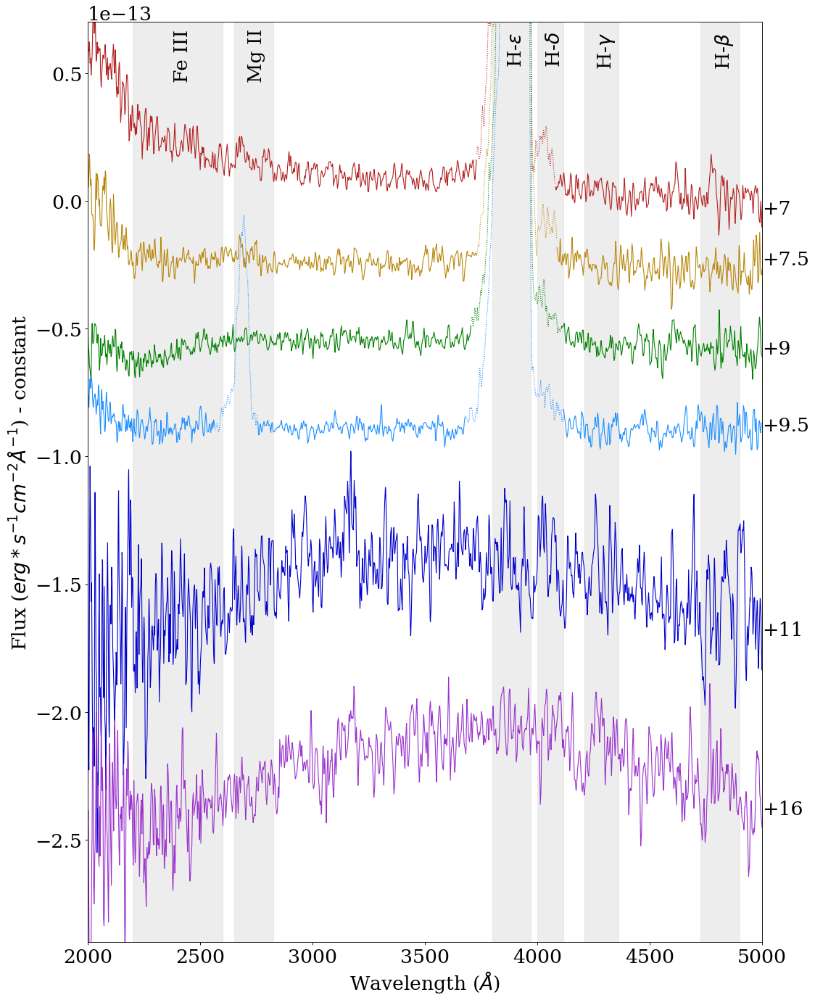

In [79]:
sum_007_wavelength,sum_007_flux,sum_007_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390007sumspectrum.txt', unpack=True)
sum_008_wavelength,sum_008_flux,sum_008_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390008sumspectrum.txt', unpack=True)
sum_015_wavelength,sum_015_flux,sum_015_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390015sumspectrum.txt', unpack=True)
sum_016_wavelength,sum_016_flux,sum_016_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390016sumspectrum.txt', unpack=True)
sum_020_wavelength,sum_020_flux,sum_020_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390020sumspectrum.txt', unpack=True)
sum_026_wavelength,sum_026_flux,sum_026_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/2SN2006bp/00030390026sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 21), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2006bp Swift UV GRISM Spectra',fontsize=font)
# removing the zeroth order stellar feature 007
sum_007_wavelength_ol = []
sum_007_flux_ol = []
sum_007_wavelength_om = []
sum_007_flux_om = []
sum_007_wavelength_oh = []
sum_007_flux_oh = []
for i in range(len(sum_007_wavelength)):
    if sum_007_wavelength[i] < 3730:
        sum_007_wavelength_ol.append(sum_007_wavelength[i])
        sum_007_flux_ol.append(sum_007_flux[i])
    if sum_007_wavelength[i] > 4080:
        sum_007_wavelength_oh.append(sum_007_wavelength[i])
        sum_007_flux_oh.append(sum_007_flux[i])
    if sum_007_wavelength[i] > 3730 and sum_007_wavelength[i] < 4080:
        sum_007_wavelength_om.append(sum_007_wavelength[i])
        sum_007_flux_om.append(sum_007_flux[i])
sum_007_flux_ol = np.array(sum_007_flux_ol)
sum_007_flux_om = np.array(sum_007_flux_om)
sum_007_flux_oh = np.array(sum_007_flux_oh)
# removing the zeroth order stellar feature 008
sum_008_wavelength_ol = []
sum_008_flux_ol = []
sum_008_wavelength_om = []
sum_008_flux_om = []
sum_008_wavelength_oh = []
sum_008_flux_oh = []
for i in range(len(sum_008_wavelength)):
    if sum_008_wavelength[i] < 3730:
        sum_008_wavelength_ol.append(sum_008_wavelength[i])
        sum_008_flux_ol.append(sum_008_flux[i])
    if sum_008_wavelength[i] > 4086:
        sum_008_wavelength_oh.append(sum_008_wavelength[i])
        sum_008_flux_oh.append(sum_008_flux[i])
    if sum_008_wavelength[i] > 3730 and sum_008_wavelength[i] < 4086:
        sum_008_wavelength_om.append(sum_008_wavelength[i])
        sum_008_flux_om.append(sum_008_flux[i])
sum_008_flux_ol = np.array(sum_008_flux_ol)
sum_008_flux_om = np.array(sum_008_flux_om)
sum_008_flux_oh = np.array(sum_008_flux_oh)
# removing the zeroth order stellar feature 015
sum_015_wavelength_ol = []
sum_015_flux_ol = []
sum_015_wavelength_om = []
sum_015_flux_om = []
sum_015_wavelength_oh = []
sum_015_flux_oh = []
for i in range(len(sum_015_wavelength)):
    if sum_015_wavelength[i] < 3705:
        sum_015_wavelength_ol.append(sum_015_wavelength[i])
        sum_015_flux_ol.append(sum_015_flux[i])
    if sum_015_wavelength[i] > 4105:
        sum_015_wavelength_oh.append(sum_015_wavelength[i])
        sum_015_flux_oh.append(sum_015_flux[i])
    if sum_015_wavelength[i] > 3705 and sum_015_wavelength[i] < 4105:
        sum_015_wavelength_om.append(sum_015_wavelength[i])
        sum_015_flux_om.append(sum_015_flux[i])
sum_015_flux_ol = np.array(sum_015_flux_ol)
sum_015_flux_om = np.array(sum_015_flux_om)
sum_015_flux_oh = np.array(sum_015_flux_oh)
# removing the zeroth order stellar feature 016
sum_016_wavelength_ol = []
sum_016_flux_ol = []
sum_016_wavelength_omm = []
sum_016_flux_omm = []
sum_016_wavelength_olh = []
sum_016_flux_olh = []
sum_016_wavelength_om = []
sum_016_flux_om = []
sum_016_wavelength_oh = []
sum_016_flux_oh = []
for i in range(len(sum_016_wavelength)):
    if sum_016_wavelength[i] < 2565:
        sum_016_wavelength_ol.append(sum_016_wavelength[i])
        sum_016_flux_ol.append(sum_016_flux[i])
    if sum_016_wavelength[i] > 2565 and sum_016_wavelength[i] < 2755:
        sum_016_wavelength_omm.append(sum_016_wavelength[i])
        sum_016_flux_omm.append(sum_016_flux[i])
    if sum_016_wavelength[i] < 3680 and sum_016_wavelength[i] > 2755:
        sum_016_wavelength_olh.append(sum_016_wavelength[i])
        sum_016_flux_olh.append(sum_016_flux[i])
    if sum_016_wavelength[i] > 4115:
        sum_016_wavelength_oh.append(sum_016_wavelength[i])
        sum_016_flux_oh.append(sum_016_flux[i])
    if sum_016_wavelength[i] > 3680 and sum_016_wavelength[i] < 4115:
        sum_016_wavelength_om.append(sum_016_wavelength[i])
        sum_016_flux_om.append(sum_016_flux[i])
sum_016_flux_ol = np.array(sum_016_flux_ol)
sum_016_flux_omm = np.array(sum_016_flux_omm)
sum_016_flux_olh = np.array(sum_016_flux_olh)
sum_016_flux_om = np.array(sum_016_flux_om)
sum_016_flux_oh = np.array(sum_016_flux_oh)

plt.plot(sum_007_wavelength_ol,sum_007_flux_ol,label='7 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_007_wavelength_om,sum_007_flux_om,label='7 days after explosion',linewidth=1,c='firebrick',linestyle='dotted')
plt.plot(sum_007_wavelength_oh,sum_007_flux_oh,label='7 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_008_wavelength_ol,sum_008_flux_ol-0.00000000000003,label='7.5 days after explosion',linewidth=1,c='darkgoldenrod')
plt.plot(sum_008_wavelength_om,sum_008_flux_om-0.00000000000003,label='7.5 days after explosion',linewidth=1,c='darkgoldenrod',linestyle='dotted')
plt.plot(sum_008_wavelength_oh,sum_008_flux_oh-0.00000000000003,label='7.5 days after explosion',linewidth=1,c='darkgoldenrod')
plt.plot(sum_015_wavelength_ol,sum_015_flux_ol-0.00000000000006,label='9 days after explosion',linewidth=1,c='green')
plt.plot(sum_015_wavelength_om,sum_015_flux_om-0.00000000000006,label='9 days after explosion',linewidth=1,c='green',linestyle='dotted')
plt.plot(sum_015_wavelength_oh,sum_015_flux_oh-0.00000000000006,label='9 days after explosion',linewidth=1,c='green')
plt.plot(sum_016_wavelength_ol,sum_016_flux_ol-0.00000000000009,label='9.5 days after explosion',linewidth=1,c='dodgerblue')
plt.plot(sum_016_wavelength_omm,sum_016_flux_omm-0.00000000000009,label='9.5 days after explosion',linewidth=1,c='dodgerblue',linestyle='dotted')
plt.plot(sum_016_wavelength_olh,sum_016_flux_olh-0.00000000000009,label='9.5 days after explosion',linewidth=1,c='dodgerblue')
plt.plot(sum_016_wavelength_om,sum_016_flux_om-0.00000000000009,label='9.5 days after explosion',linewidth=1,c='dodgerblue',linestyle='dotted')
plt.plot(sum_016_wavelength_oh,sum_016_flux_oh-0.00000000000009,label='9.5 days after explosion',linewidth=1,c='dodgerblue')
plt.plot(sum_020_wavelength,sum_020_flux-0.00000000000018,label='11 days after explosion',linewidth=1,c='mediumblue')
plt.plot(sum_026_wavelength,sum_026_flux-0.00000000000024,label='16 days after explosion',linewidth=1,c='darkorchid')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,-0.000000000000005,'+7',fontsize=font)
plt.text(5000,-0.000000000000025,'+7.5',fontsize=font)
plt.text(5000,-0.00000000000006,'+9',fontsize=font)
plt.text(5000,-0.00000000000009,'+9.5',fontsize=font)
plt.text(5000,-0.00000000000017,'+11',fontsize=font)
plt.text(5000,-0.00000000000024,'+16',fontsize=font)
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2380,0.000000000000048,'Fe III',fontsize=font1,rotation='vertical')
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2710,0.000000000000048,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3865,0.000000000000054,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4035,0.000000000000054,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4260,0.000000000000054,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4785,0.000000000000054,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.00000000000029,0.00000000000007)
plt.savefig("SN2006bp_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()
# 005 epoch left off bc its too faint

#### SN2006bp Figure Caption

SN2005cs \textit{Swift} UV grism spectra. The zeroth order light contamination present in the day +10 spectrum is shown with a dotted line.

#### SN2006bp in text comments
Zeroth order light contamination is present in the day +10 spectrum, and is shown with a dotted line. The UV flux is still high enough on day +6 to see FeIII line blanketing and the MgII absorption feature, while 3 days later, the flux in the UV has faded and the majority of the flux now resides in the optical. The spectra are almost too noisy to be able to see any hydrogen features, but the p-cygni profile of H-epsilon is evident on Days +14 and +16.

### <a id='14c3'>SN2007od</a> 
[Table of Contents](#0)

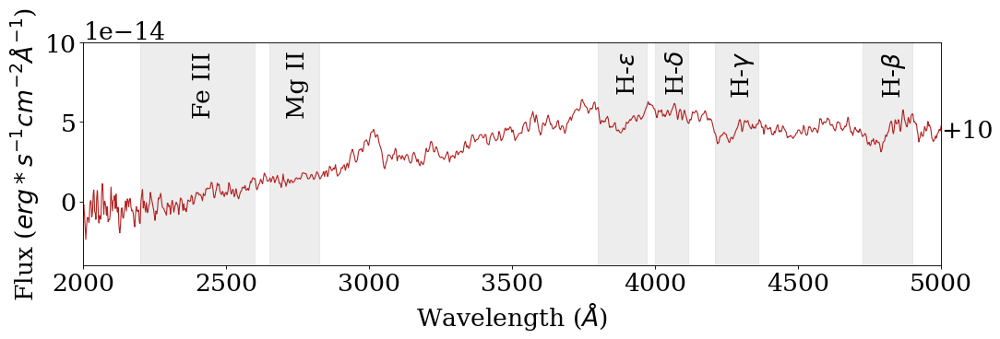

In [80]:
sum_004_wavelength,sum_004_flux,sum_004_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/1SN2007od/00031003004sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 4), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2007od Swift UV GRISM Spectra',fontsize=font)
plt.plot(sum_004_wavelength,sum_004_flux,label='10 days after explosion',linewidth=1,c='firebrick')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.00000000000004,'+10',fontsize=font)
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2380,0.000000000000055,'Fe III',fontsize=font1,rotation='vertical')
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2710,0.000000000000055,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3865,0.00000000000007,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4035,0.00000000000007,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4260,0.00000000000007,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4785,0.00000000000007,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.00000000000004,0.00000000000010)
plt.savefig("SN2007od_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='14c4'>SN2008aw</a> 
[Table of Contents](#0)

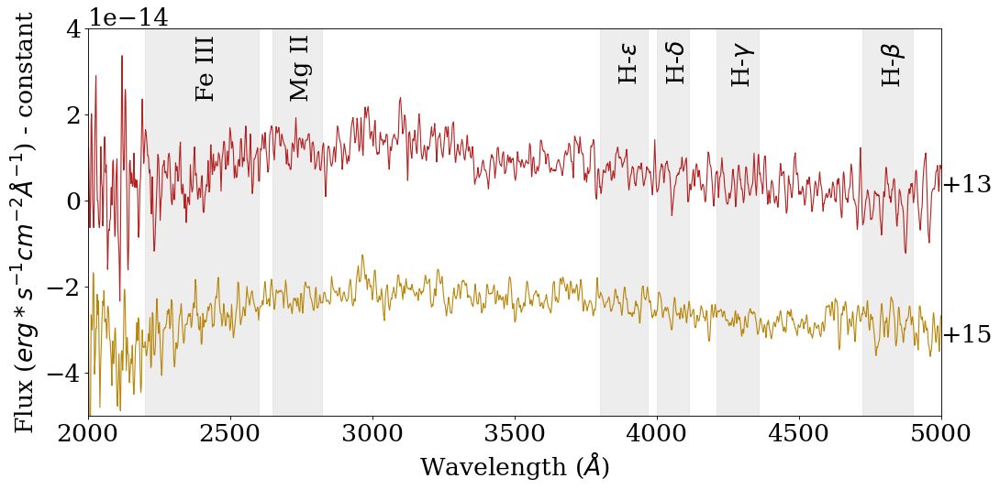

In [81]:
sum_003_wavelength,sum_003_flux,sum_003_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/3SN2008aw/00031153003sumspectrum.txt', unpack=True)
sum_005_wavelength,sum_005_flux,sum_005_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/3SN2008aw/00031153005sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 7), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2008aw Swift UV GRISM Spectra',fontsize=font)
plt.plot(sum_003_wavelength,sum_003_flux,label='13 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_005_wavelength,sum_005_flux-0.00000000000003,label='15 days after explosion',linewidth=1,c='darkgoldenrod')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.000000000000002,'+13',fontsize=font)
plt.text(5000,-0.000000000000033,'+15',fontsize=font)
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2380,0.000000000000024,'Fe III',fontsize=font1,rotation='vertical')
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2710,0.000000000000024,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3865,0.000000000000028,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4035,0.000000000000028,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4260,0.000000000000028,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4785,0.000000000000028,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.00000000000005,0.00000000000004)
plt.savefig("SN2008aw_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='14c5'>SN2008M</a> 
[Table of Contents](#0)

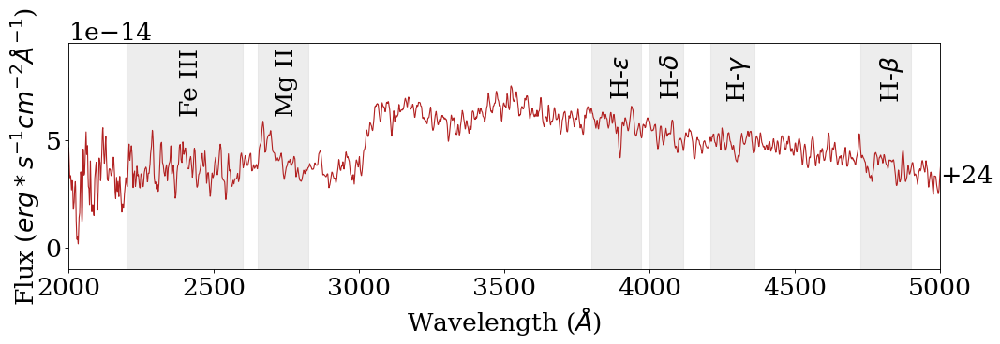

In [82]:
sum_003_wavelength,sum_003_flux,sum_003_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/2SN2008M/00031102003sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 4), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2008M Swift UV GRISM Spectra',fontsize=font)
plt.plot(sum_003_wavelength,sum_003_flux,label='24 days after explosion',linewidth=1,c='firebrick')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.00000000000003,'+24',fontsize=font)
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2380,0.000000000000063,'Fe III',fontsize=font1,rotation='vertical')
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2710,0.000000000000063,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3865,0.000000000000071,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4035,0.000000000000071,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4260,0.000000000000071,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4785,0.000000000000071,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.00000000000001,0.000000000000095)
plt.savefig("SN2008M_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='14c6'>SN2012aw</a> 
[Table of Contents](#0)

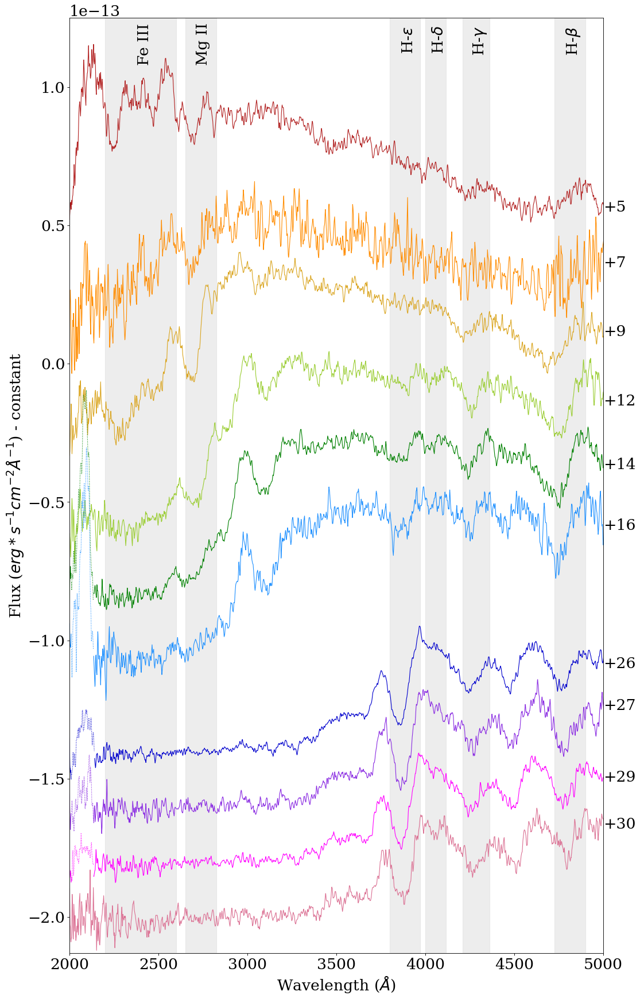

In [83]:
sum_19001_wavelength,sum_19001_flux,sum_19001_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319001sumspectrum.txt', unpack=True)
sum_19002_wavelength,sum_19002_flux,sum_19002_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319002sumspectrum.txt', unpack=True)
sum_19003_wavelength,sum_19003_flux,sum_19003_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319003sumspectrum.txt', unpack=True)
sum_19004_wavelength,sum_19004_flux,sum_19004_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319004sumspectrum.txt', unpack=True)
sum_19005_wavelength,sum_19005_flux,sum_19005_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319005sumspectrum.txt', unpack=True)
sum_19006_wavelength,sum_19006_flux,sum_19006_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032319006sumspectrum.txt', unpack=True)
sum_15020_wavelength,sum_15020_flux,sum_15020_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032315020sumspectrum.txt', unpack=True)
sum_15022_wavelength,sum_15022_flux,sum_15022_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032315022sumspectrum.txt', unpack=True)
sum_15024_wavelength,sum_15024_flux,sum_15024_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032315024sumspectrum.txt', unpack=True)
sum_15026_wavelength,sum_15026_flux,sum_15026_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/6SN2012aw/00032315026sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 27), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2012aw Swift UV GRISM Spectra',fontsize=font)
# removing the zeroth order stellar feature 005
sum_19005_wavelength_ol = []
sum_19005_flux_ol = []
sum_19005_wavelength_om = []
sum_19005_flux_om = []
sum_19005_wavelength_oh = []
sum_19005_flux_oh = []
for i in range(len(sum_19005_wavelength)):
    if sum_19005_wavelength[i] < 2010:
        sum_19005_wavelength_ol.append(sum_19005_wavelength[i])
        sum_19005_flux_ol.append(sum_19005_flux[i])
    if sum_19005_wavelength[i] > 2135:
        sum_19005_wavelength_oh.append(sum_19005_wavelength[i])
        sum_19005_flux_oh.append(sum_19005_flux[i])
    if sum_19005_wavelength[i] > 2010 and sum_19005_wavelength[i] < 2135:
        sum_19005_wavelength_om.append(sum_19005_wavelength[i])
        sum_19005_flux_om.append(sum_19005_flux[i])
sum_19005_flux_ol = np.array(sum_19005_flux_ol)
sum_19005_flux_om = np.array(sum_19005_flux_om)
sum_19005_flux_oh = np.array(sum_19005_flux_oh)
# removing the zeroth order stellar feature 006
sum_19006_wavelength_ol = []
sum_19006_flux_ol = []
sum_19006_wavelength_om = []
sum_19006_flux_om = []
sum_19006_wavelength_oh = []
sum_19006_flux_oh = []
for i in range(len(sum_19006_wavelength)):
    if sum_19006_wavelength[i] < 2010:
        sum_19006_wavelength_ol.append(sum_19006_wavelength[i])
        sum_19006_flux_ol.append(sum_19006_flux[i])
    if sum_19006_wavelength[i] > 2135:
        sum_19006_wavelength_oh.append(sum_19006_wavelength[i])
        sum_19006_flux_oh.append(sum_19006_flux[i])
    if sum_19006_wavelength[i] > 2010 and sum_19006_wavelength[i] < 2135:
        sum_19006_wavelength_om.append(sum_19006_wavelength[i])
        sum_19006_flux_om.append(sum_19006_flux[i])
sum_19006_flux_ol = np.array(sum_19006_flux_ol)
sum_19006_flux_om = np.array(sum_19006_flux_om)
sum_19006_flux_oh = np.array(sum_19006_flux_oh)
# removing the zeroth order stellar feature 020
sum_15020_wavelength_ol = []
sum_15020_flux_ol = []
sum_15020_wavelength_om = []
sum_15020_flux_om = []
sum_15020_wavelength_oh = []
sum_15020_flux_oh = []
for i in range(len(sum_15020_wavelength)):
    if sum_15020_wavelength[i] < 2010:
        sum_15020_wavelength_ol.append(sum_15020_wavelength[i])
        sum_15020_flux_ol.append(sum_15020_flux[i])
    if sum_15020_wavelength[i] > 2140:
        sum_15020_wavelength_oh.append(sum_15020_wavelength[i])
        sum_15020_flux_oh.append(sum_15020_flux[i])
    if sum_15020_wavelength[i] > 2010 and sum_15020_wavelength[i] < 2140:
        sum_15020_wavelength_om.append(sum_15020_wavelength[i])
        sum_15020_flux_om.append(sum_15020_flux[i])
sum_15020_flux_ol = np.array(sum_15020_flux_ol)
sum_15020_flux_om = np.array(sum_15020_flux_om)
sum_15020_flux_oh = np.array(sum_15020_flux_oh)
# removing the zeroth order stellar feature 022
sum_15022_wavelength_ol = []
sum_15022_flux_ol = []
sum_15022_wavelength_om = []
sum_15022_flux_om = []
sum_15022_wavelength_oh = []
sum_15022_flux_oh = []
for i in range(len(sum_15022_wavelength)):
    if sum_15022_wavelength[i] < 2010:
        sum_15022_wavelength_ol.append(sum_15022_wavelength[i])
        sum_15022_flux_ol.append(sum_15022_flux[i])
    if sum_15022_wavelength[i] > 2135:
        sum_15022_wavelength_oh.append(sum_15022_wavelength[i])
        sum_15022_flux_oh.append(sum_15022_flux[i])
    if sum_15022_wavelength[i] > 2010 and sum_15022_wavelength[i] < 2135:
        sum_15022_wavelength_om.append(sum_15022_wavelength[i])
        sum_15022_flux_om.append(sum_15022_flux[i])
sum_15022_flux_ol = np.array(sum_15022_flux_ol)
sum_15022_flux_om = np.array(sum_15022_flux_om)
sum_15022_flux_oh = np.array(sum_15022_flux_oh)
# removing the zeroth order stellar feature 024
sum_15024_wavelength_ol = []
sum_15024_flux_ol = []
sum_15024_wavelength_om = []
sum_15024_flux_om = []
sum_15024_wavelength_oh = []
sum_15024_flux_oh = []
for i in range(len(sum_15024_wavelength)):
    if sum_15024_wavelength[i] < 2010:
        sum_15024_wavelength_ol.append(sum_15024_wavelength[i])
        sum_15024_flux_ol.append(sum_15024_flux[i])
    if sum_15024_wavelength[i] > 2135:
        sum_15024_wavelength_oh.append(sum_15024_wavelength[i])
        sum_15024_flux_oh.append(sum_15024_flux[i])
    if sum_15024_wavelength[i] > 2010 and sum_15024_wavelength[i] < 2135:
        sum_15024_wavelength_om.append(sum_15024_wavelength[i])
        sum_15024_flux_om.append(sum_15024_flux[i])
sum_15024_flux_ol = np.array(sum_15024_flux_ol)
sum_15024_flux_om = np.array(sum_15024_flux_om)
sum_15024_flux_oh = np.array(sum_15024_flux_oh)

plt.plot(sum_19001_wavelength,sum_19001_flux,label='5 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_19002_wavelength,sum_19002_flux-0.00000000000002,label='7 days after explosion',linewidth=1,c='darkorange')
plt.plot(sum_19003_wavelength,sum_19003_flux-0.00000000000005,label='9 days after explosion',linewidth=1,c='goldenrod')
plt.plot(sum_19004_wavelength,sum_19004_flux-0.00000000000007,label='12 days after explosion',linewidth=1,c='yellowgreen')
plt.plot(sum_19005_wavelength_ol,sum_19005_flux_ol-0.00000000000009,label='14 days after explosion',linewidth=1,c='green')
plt.plot(sum_19005_wavelength_om,sum_19005_flux_om-0.00000000000009,label='14 days after explosion',linewidth=1,c='green',linestyle='dotted')
plt.plot(sum_19005_wavelength_oh,sum_19005_flux_oh-0.00000000000009,label='14 days after explosion',linewidth=1,c='green')
plt.plot(sum_19006_wavelength_ol,sum_19006_flux_ol-0.00000000000011,label='16 days after explosion',linewidth=1,c='dodgerblue')
plt.plot(sum_19006_wavelength_om,sum_19006_flux_om-0.00000000000011,label='16 days after explosion',linewidth=1,c='dodgerblue',linestyle='dotted')
plt.plot(sum_19006_wavelength_oh,sum_19006_flux_oh-0.00000000000011,label='16 days after explosion',linewidth=1,c='dodgerblue')
plt.plot(sum_15020_wavelength_ol,sum_15020_flux_ol-0.00000000000014,label='26 days after explosion',linewidth=1,c='mediumblue')
plt.plot(sum_15020_wavelength_om,sum_15020_flux_om-0.00000000000014,label='26 days after explosion',linewidth=1,c='mediumblue',linestyle='dotted')
plt.plot(sum_15020_wavelength_oh,sum_15020_flux_oh-0.00000000000014,label='26 days after explosion',linewidth=1,c='mediumblue')
plt.plot(sum_15022_wavelength_ol,sum_15022_flux_ol-0.00000000000016,label='27 days after explosion',linewidth=1,c='blueviolet')
plt.plot(sum_15022_wavelength_om,sum_15022_flux_om-0.00000000000016,label='27 days after explosion',linewidth=1,c='blueviolet',linestyle='dotted')
plt.plot(sum_15022_wavelength_oh,sum_15022_flux_oh-0.00000000000016,label='27 days after explosion',linewidth=1,c='blueviolet')
plt.plot(sum_15024_wavelength_ol,sum_15024_flux_ol-0.00000000000018,label='29 days after explosion',linewidth=1,c='fuchsia')
plt.plot(sum_15024_wavelength_om,sum_15024_flux_om-0.00000000000018,label='29 days after explosion',linewidth=1,c='fuchsia',linestyle='dotted')
plt.plot(sum_15024_wavelength_oh,sum_15024_flux_oh-0.00000000000018,label='29 days after explosion',linewidth=1,c='fuchsia')
plt.plot(sum_15026_wavelength,sum_15026_flux-0.0000000000002,label='30 days after explosion',linewidth=1,c='palevioletred')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.000000000000055,'+5',fontsize=font)
plt.text(5000,0.000000000000035,'+7',fontsize=font)
plt.text(5000,0.000000000000010,'+9',fontsize=font)
plt.text(5000,-0.000000000000015,'+12',fontsize=font)
plt.text(5000,-0.000000000000038,'+14',fontsize=font)
plt.text(5000,-0.000000000000060,'+16',fontsize=font)
plt.text(5000,-0.000000000000110,'+26',fontsize=font)
plt.text(5000,-0.000000000000125,'+27',fontsize=font)
plt.text(5000,-0.000000000000151,'+29',fontsize=font)
plt.text(5000,-0.000000000000168,'+30',fontsize=font)
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2380,0.000000000000109,'Fe III',fontsize=font1,rotation='vertical')
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2710,0.000000000000109,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3865,0.000000000000113,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4035,0.000000000000113,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4260,0.000000000000113,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4785,0.000000000000113,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.000000000000213,0.000000000000125)
plt.savefig("SN2012aw_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='14c7'>SN2013ab</a> 
[Table of Contents](#0)

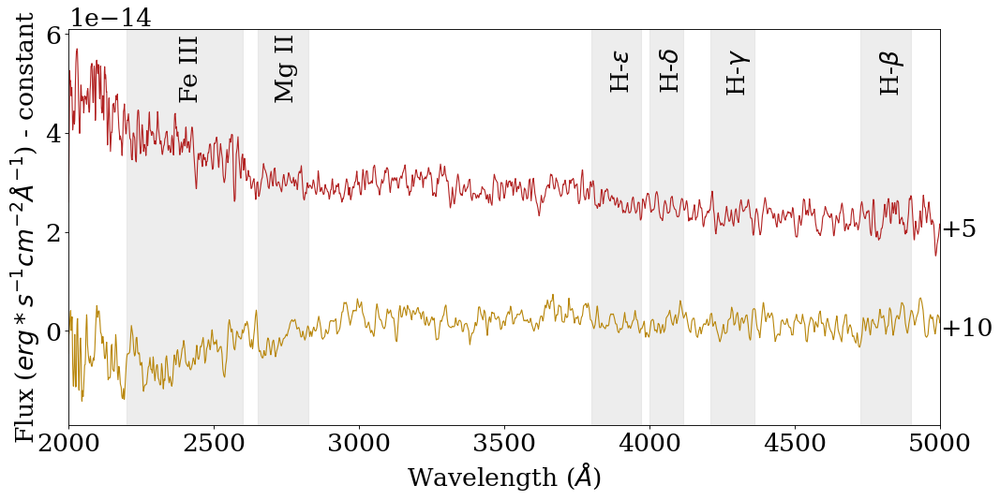

In [84]:
sum_002_wavelength,sum_002_flux,sum_002_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/3SN2013ab/00032725002sumspectrum.txt', unpack=True)
sum_005_wavelength,sum_005_flux,sum_005_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/3SN2013ab/00032725005sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 7), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2013ab Swift UV GRISM Spectra',fontsize=font)
plt.plot(sum_002_wavelength,sum_002_flux,label='5 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_005_wavelength,sum_005_flux-0.00000000000002,label='10 days after explosion',linewidth=1,c='darkgoldenrod')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.000000000000019,'+5',fontsize=font)
plt.text(5000,-0.000000000000001,'+10',fontsize=font)
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2380,0.000000000000047,'Fe III',fontsize=font1,rotation='vertical')
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2710,0.000000000000047,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3865,0.000000000000049,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4035,0.000000000000049,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4260,0.000000000000049,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4785,0.000000000000049,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.000000000000019,0.000000000000061)
plt.savefig("SN2013ab_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='14c8'>SN2013ej</a> 
[Table of Contents](#0)

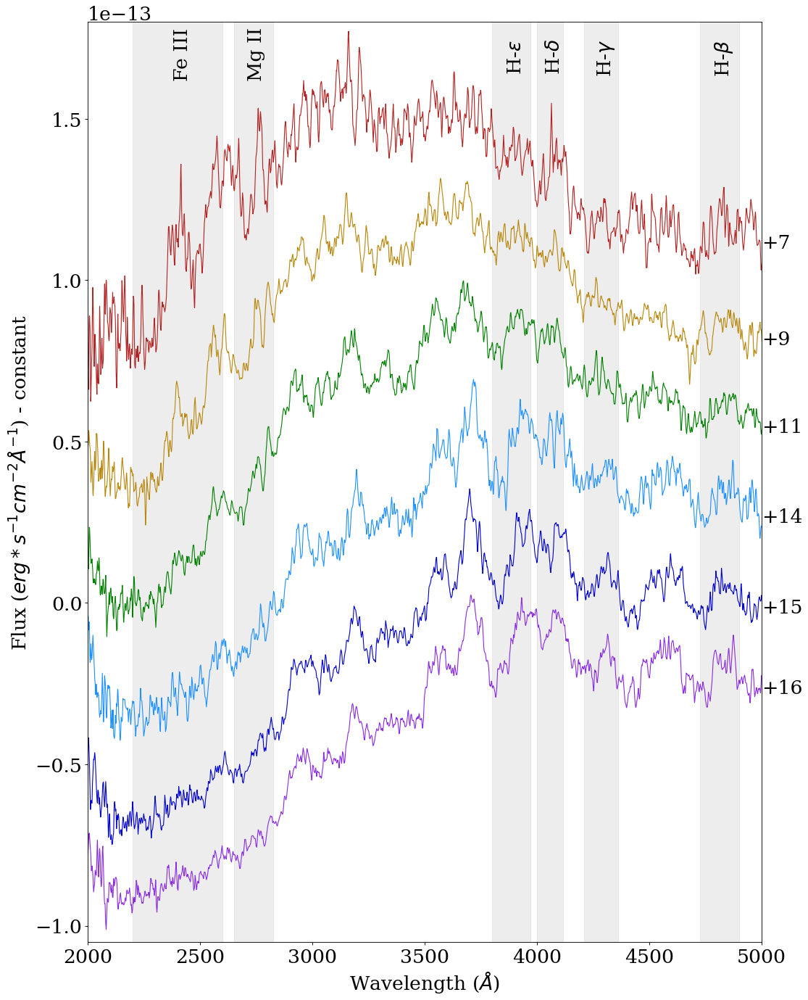

In [85]:
sum_003_wavelength,sum_003_flux,sum_003_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891003sumspectrum.txt', unpack=True)
sum_006_wavelength,sum_006_flux,sum_006_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891006sumspectrum.txt', unpack=True)
sum_009_wavelength,sum_009_flux,sum_009_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891009sumspectrum.txt', unpack=True)
sum_011_wavelength,sum_011_flux,sum_011_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891011sumspectrum.txt', unpack=True)
sum_014_wavelength,sum_014_flux,sum_014_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891014sumspectrum.txt', unpack=True)
sum_016_wavelength,sum_016_flux,sum_016_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891016sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 21), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2013ej Swift UV GRISM Spectra',fontsize=font)
plt.plot(sum_003_wavelength,sum_003_flux,label='7 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_006_wavelength,sum_006_flux-0.00000000000002,label='9 days after explosion',linewidth=1,c='darkgoldenrod')
plt.plot(sum_009_wavelength,sum_009_flux-0.00000000000004,label='11 days after explosion',linewidth=1,c='green')
plt.plot(sum_011_wavelength,sum_011_flux-0.00000000000006,label='14 days after explosion',linewidth=1,c='dodgerblue')
plt.plot(sum_014_wavelength,sum_014_flux-0.00000000000009,label='15 days after explosion',linewidth=1,c='mediumblue')
plt.plot(sum_016_wavelength,sum_016_flux-0.00000000000011,label='16 days after explosion',linewidth=1,c='blueviolet')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.00000000000011,'+7',fontsize=font)
plt.text(5000,0.00000000000008,'+9',fontsize=font)
plt.text(5000,0.000000000000053,'+11',fontsize=font)
plt.text(5000,0.000000000000025,'+14',fontsize=font)
plt.text(5000,-0.000000000000003,'+15',fontsize=font)
plt.text(5000,-0.000000000000028,'+16',fontsize=font)
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2380,0.000000000000163,'Fe III',fontsize=font1,rotation='vertical')
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2710,0.000000000000163,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3865,0.000000000000165,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4035,0.000000000000165,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4260,0.000000000000165,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4785,0.000000000000165,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.000000000000105,0.00000000000018)
plt.savefig("SN2013ej_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='14c9'>ASASSN-14ha</a> 
[Table of Contents](#0)

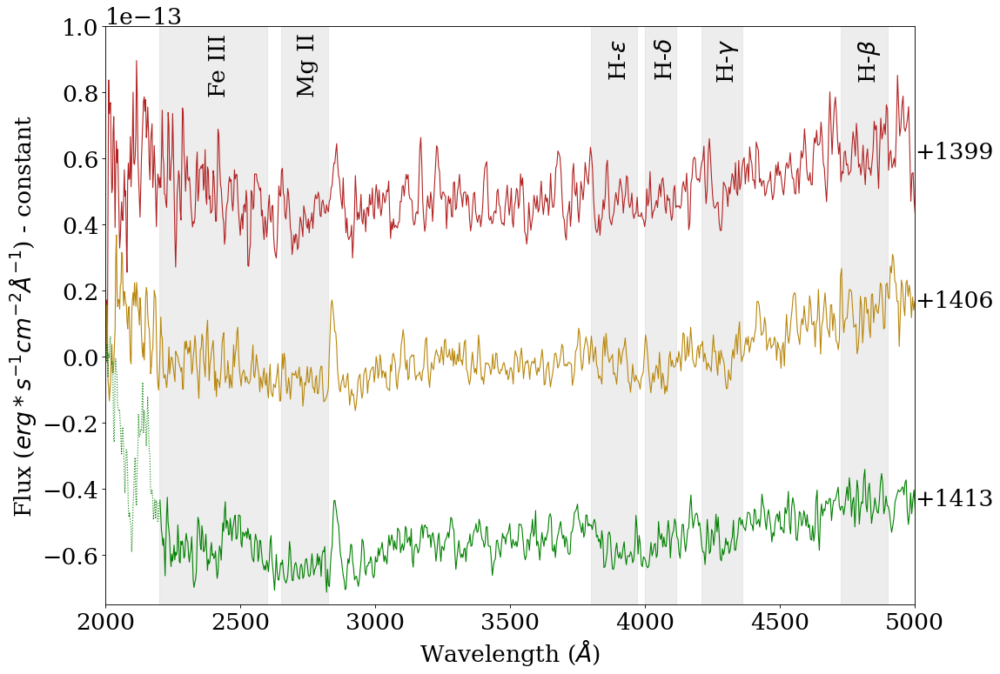

In [86]:
e1_5880006_wavelength,e1_5880006_flux,e1_5880006_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/11ASASSN-14ha/00035880006e1spectrum.txt', unpack=True)
e1_5880008_wavelength,e1_5880008_flux,e1_5880008_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/11ASASSN-14ha/00035880008e1spectrum.txt', unpack=True)
e1_5880010_wavelength,e1_5880010_flux,e1_5880010_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/11ASASSN-14ha/00035880010e1spectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 11), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('ASASSN-14ha Swift UV GRISM Spectra',fontsize=font)
# removing the zeroth order spiral arm of galaxy feature 010
e1_5880010_wavelength_ol = []
e1_5880010_flux_ol = []
e1_5880010_wavelength_oh = []
e1_5880010_flux_oh = []
for i in range(len(e1_5880010_wavelength)):
    if e1_5880010_wavelength[i] < 2200:
        e1_5880010_wavelength_ol.append(e1_5880010_wavelength[i])
        e1_5880010_flux_ol.append(e1_5880010_flux[i])
    if e1_5880010_wavelength[i] > 2200:
        e1_5880010_wavelength_oh.append(e1_5880010_wavelength[i])
        e1_5880010_flux_oh.append(e1_5880010_flux[i])
e1_5880010_flux_ol = np.array(e1_5880010_flux_ol)
e1_5880010_flux_oh = np.array(e1_5880010_flux_oh)

plt.plot(e1_5880006_wavelength,e1_5880006_flux,label='1399 days after discovery',linewidth=1,c='firebrick')
plt.plot(e1_5880008_wavelength,e1_5880008_flux-0.00000000000005,label='1406 days after discovery',linewidth=1,c='darkgoldenrod')
plt.plot(e1_5880010_wavelength_ol,e1_5880010_flux_ol-0.00000000000011,label='1413 days after discovery',linewidth=1,c='green',linestyle='dotted')
plt.plot(e1_5880010_wavelength_oh,e1_5880010_flux_oh-0.00000000000011,label='1413 days after discovery',linewidth=1,c='green')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.00000000000006,'+1399',fontsize=font)
plt.text(5000,0.000000000000015,'+1406',fontsize=font)
plt.text(5000,-0.000000000000045,'+1413',fontsize=font)
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2380,0.00000000000008,'Fe III',fontsize=font1,rotation='vertical')
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2710,0.00000000000008,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3865,0.000000000000085,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4035,0.000000000000085,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4260,0.000000000000085,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4785,0.000000000000085,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.000000000000075,0.00000000000010)
plt.savefig("ASASSN-14ha_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()
# 1st 2 epochs aren't listed bc they are overtaken by a saturated star 00033411003 and 00033411011

### <a id='14c10'>SN2017eaw</a> 
[Table of Contents](#0)

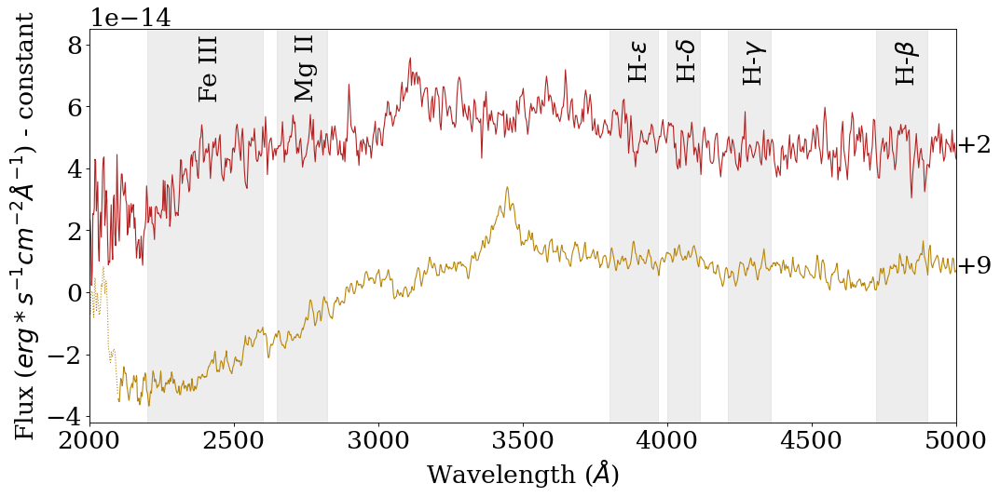

In [87]:
e3_004_wavelength,e3_004_flux,e3_004_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/9SN2017eaw/00010130004e3spectrum.txt', unpack=True)
sum_008_wavelength,sum_008_flux,sum_008_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/9SN2017eaw/00010130008sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 7), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2017eaw Swift UV GRISM Spectra',fontsize=font)
# removing the zeroth order spiral arm of galaxy feature 008
sum_008_wavelength_ol = []
sum_008_flux_ol = []
sum_008_wavelength_oh = []
sum_008_flux_oh = []
for i in range(len(sum_008_wavelength)):
    if sum_008_wavelength[i] < 2100:
        sum_008_wavelength_ol.append(sum_008_wavelength[i])
        sum_008_flux_ol.append(sum_008_flux[i])
    if sum_008_wavelength[i] > 2100:
        sum_008_wavelength_oh.append(sum_008_wavelength[i])
        sum_008_flux_oh.append(sum_008_flux[i])
sum_008_flux_ol = np.array(sum_008_flux_ol)
sum_008_flux_oh = np.array(sum_008_flux_oh)

plt.plot(e3_004_wavelength,e3_004_flux,label='2 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_008_wavelength_ol,sum_008_flux_ol-0.00000000000003,label='9 days after explosion',linewidth=1,c='darkgoldenrod',linestyle='dotted')
plt.plot(sum_008_wavelength_oh,sum_008_flux_oh-0.00000000000003,label='9 days after explosion',linewidth=1,c='darkgoldenrod')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.000000000000045,'+2',fontsize=font)
plt.text(5000,0.000000000000006,'+9',fontsize=font)
# plotting vertical shaded bars for features
# FeIII
plt.axvspan(2200, 2600, alpha=0.5, color='gainsboro')
plt.text(2380,0.000000000000063,'Fe III',fontsize=font1,rotation='vertical')
# MgII
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2710,0.000000000000063,'Mg II',fontsize=font1,rotation='vertical')
# H-epsilon
plt.axvspan(3800, 3970, alpha=0.5, color='gainsboro')
plt.text(3865,0.000000000000069,"H-" r'$\epsilon$',fontsize=font1,rotation='vertical')
# H-delta
plt.axvspan(4000, 4115, alpha=0.5, color='gainsboro')
plt.text(4035,0.000000000000069,"H-" r'$\delta$',fontsize=font1,rotation='vertical')
# H-gamma
plt.axvspan(4210, 4360, alpha=0.5, color='gainsboro')
plt.text(4260,0.000000000000069,"H-" r'$\gamma$',fontsize=font1,rotation='vertical')
# H-beta
plt.axvspan(4725, 4900, alpha=0.5, color='gainsboro')
plt.text(4785,0.000000000000069,"H-" r'$\beta$',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.000000000000042,0.000000000000085)
plt.savefig("SN2017eaw_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

## <a id='14d'>Misc CC SNe</a> 
[Table of Contents](#0)

### <a id='14d1'>SN2006jc: Type Ibn</a> 
[Table of Contents](#0)

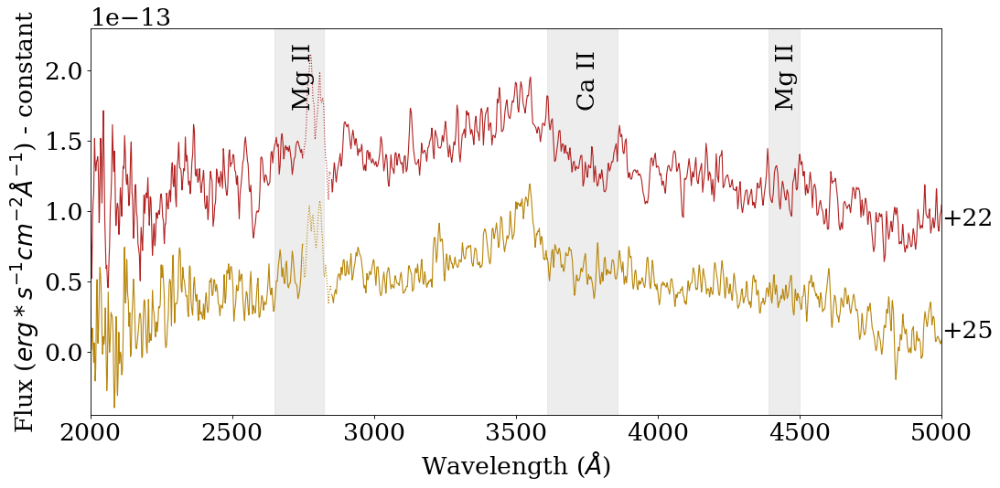

In [88]:
sum_004_wavelength,sum_004_flux,sum_004_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIbn/1SN2006jc/00030810004sumspectrum.txt', unpack=True)
sum_007_wavelength,sum_007_flux,sum_007_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIbn/1SN2006jc/00030810007sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 7), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2006jc Swift UV GRISM Spectra',fontsize=font)
# removing the zeroth order stellar feature 004
sum_004_wavelength_ol = []
sum_004_flux_ol = []
sum_004_wavelength_om = []
sum_004_flux_om = []
sum_004_wavelength_oh = []
sum_004_flux_oh = []
for i in range(len(sum_004_wavelength)):
    if sum_004_wavelength[i] < 2750:
        sum_004_wavelength_ol.append(sum_004_wavelength[i])
        sum_004_flux_ol.append(sum_004_flux[i])
    if sum_004_wavelength[i] > 2850:
        sum_004_wavelength_oh.append(sum_004_wavelength[i])
        sum_004_flux_oh.append(sum_004_flux[i])
    if sum_004_wavelength[i] > 2750 and sum_004_wavelength[i] < 2850:
        sum_004_wavelength_om.append(sum_004_wavelength[i])
        sum_004_flux_om.append(sum_004_flux[i])
sum_004_flux_ol = np.array(sum_004_flux_ol)
sum_004_flux_om = np.array(sum_004_flux_om)
sum_004_flux_oh = np.array(sum_004_flux_oh)
# removing the zeroth order stellar feature 007
sum_007_wavelength_ol = []
sum_007_flux_ol = []
sum_007_wavelength_om = []
sum_007_flux_om = []
sum_007_wavelength_oh = []
sum_007_flux_oh = []
for i in range(len(sum_007_wavelength)):
    if sum_007_wavelength[i] < 2750:
        sum_007_wavelength_ol.append(sum_007_wavelength[i])
        sum_007_flux_ol.append(sum_007_flux[i])
    if sum_007_wavelength[i] > 2850:
        sum_007_wavelength_oh.append(sum_007_wavelength[i])
        sum_007_flux_oh.append(sum_007_flux[i])
    if sum_007_wavelength[i] > 2750 and sum_007_wavelength[i] < 2850:
        sum_007_wavelength_om.append(sum_007_wavelength[i])
        sum_007_flux_om.append(sum_007_flux[i])
sum_007_flux_ol = np.array(sum_007_flux_ol)
sum_007_flux_om = np.array(sum_007_flux_om)
sum_007_flux_oh = np.array(sum_007_flux_oh)

plt.plot(sum_004_wavelength_ol,sum_004_flux_ol,label='22 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_004_wavelength_om,sum_004_flux_om,label='22 days after explosion',linewidth=1,c='firebrick',linestyle='dotted')
plt.plot(sum_004_wavelength_oh,sum_004_flux_oh,label='22 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_007_wavelength_ol,sum_007_flux_ol-0.000000000000049,label='25 days after explosion',linewidth=1,c='darkgoldenrod')
plt.plot(sum_007_wavelength_om,sum_007_flux_om-0.000000000000049,label='25 days after explosion',linewidth=1,c='darkgoldenrod',linestyle='dotted')
plt.plot(sum_007_wavelength_oh,sum_007_flux_oh-0.000000000000049,label='25 days after explosion',linewidth=1,c='darkgoldenrod')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.00000000000009,'+22',fontsize=font)
plt.text(5000,0.00000000000001,'+25',fontsize=font)
# plotting vertical shaded bars for features
# CaII (ch 12 pg 207 of SN book fig 6)
plt.axvspan(3610, 3860, alpha=0.5, color='gainsboro')
plt.text(3715,0.000000000000175,'Ca II',fontsize=font1,rotation='vertical')
# MgII Op (ch 12 pg 207 of SN book fig 6)
plt.axvspan(4390, 4500, alpha=0.5, color='gainsboro')
plt.text(4415,0.000000000000175,'Mg II',fontsize=font1,rotation='vertical')
# MgII UV
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2710,0.000000000000175,'Mg II',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.000000000000045,0.00000000000023)
plt.savefig("SN2006jc_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()
# can't use the last epoch due to a saturated star

### <a id='14d2'>SN2017egm: Type SLSN-I</a> 
[Table of Contents](#0)

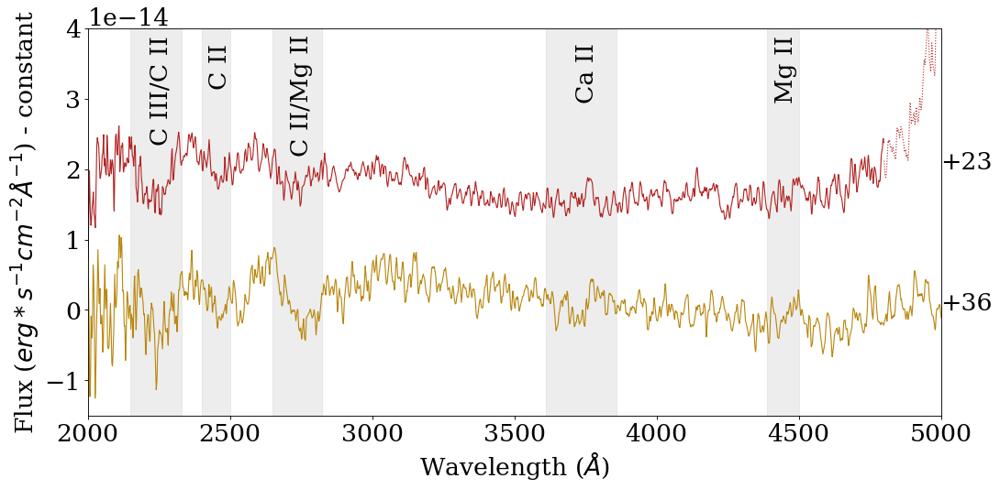

In [89]:
sum_400_wavelength,sum_400_flux,sum_400_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/10SN2017egm/0001015400_sumspectrum.txt', unpack=True)
sum_0014_wavelength,sum_0014_flux,sum_0014_fluxerr = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/10SN2017egm/00010150014sumspectrum.txt', unpack=True)

fig=plt.figure(figsize=(15, 7), dpi= 80, facecolor='w', edgecolor='k')
#plt.title('SN2017egm Swift UV GRISM Spectra',fontsize=font)
# removing the zeroth order spiral arm of galaxy feature 400
sum_400_wavelength_ol = []
sum_400_flux_ol = []
sum_400_wavelength_oh = []
sum_400_flux_oh = []
for i in range(len(sum_400_wavelength)):
    if sum_400_wavelength[i] < 4800:
        sum_400_wavelength_ol.append(sum_400_wavelength[i])
        sum_400_flux_ol.append(sum_400_flux[i])
    if sum_400_wavelength[i] > 4800:
        sum_400_wavelength_oh.append(sum_400_wavelength[i])
        sum_400_flux_oh.append(sum_400_flux[i])
sum_400_flux_ol = np.array(sum_400_flux_ol)
sum_400_flux_oh = np.array(sum_400_flux_oh)

plt.plot(sum_400_wavelength_ol,sum_400_flux_ol,label='23 days after explosion',linewidth=1,c='firebrick')
plt.plot(sum_400_wavelength_oh,sum_400_flux_oh,label='23 days after explosion',linewidth=1,c='firebrick',linestyle='dotted')
plt.plot(sum_0014_wavelength,sum_0014_flux-0.00000000000002,label='36 days after explosion',linewidth=1,c='darkgoldenrod')
#plt.legend(loc=1,fontsize=font1)
# plotting epoch labels
plt.text(5000,0.00000000000002,'+23',fontsize=font)
plt.text(5000,0.00000000000000,'+36',fontsize=font)
# plotting vertical shaded bars for features
# CIII/CII (ch 19 pg 438 of SN book fig 3)
plt.axvspan(2150, 2330, alpha=0.5, color='gainsboro')
plt.text(2215,0.000000000000024,'C III/C II',fontsize=font1,rotation='vertical')
# CII (ch 19 pg 438 of SN book fig 3)
plt.axvspan(2400, 2500, alpha=0.5, color='gainsboro')
plt.text(2425,0.000000000000032,'C II',fontsize=font1,rotation='vertical')
# CII/MgII UV (ch 19 pg 437 of SN book fig 2)
plt.axvspan(2650, 2825, alpha=0.5, color='gainsboro')
plt.text(2710,0.0000000000000225,'C II/Mg II',fontsize=font1,rotation='vertical')
# MgII Op (ch 19 pg 437 of SN book fig 2)
plt.axvspan(4390, 4500, alpha=0.5, color='gainsboro')
plt.text(4415,0.00000000000003,'Mg II',fontsize=font1,rotation='vertical')
# CaII (ch 19 pg 437 of SN book fig 2)
plt.axvspan(3610, 3860, alpha=0.5, color='gainsboro')
plt.text(3715,0.00000000000003,'Ca II',fontsize=font1,rotation='vertical')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font1)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $) - constant',fontsize=font1)
plt.xticks(fontsize=font1)
plt.yticks(fontsize=font1)
plt.xlim(2000,5000)
plt.ylim(-0.000000000000015,0.00000000000004)
plt.savefig("SN2017egm_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()
# upturn problem is dotted out

# <a id='15'>TRUVOT Corrected Spectra</a> 
[Table of Contents](#0)

## <a id='15a'>Type IIPs</a> 
[Table of Contents](#0)

### SN2006bp

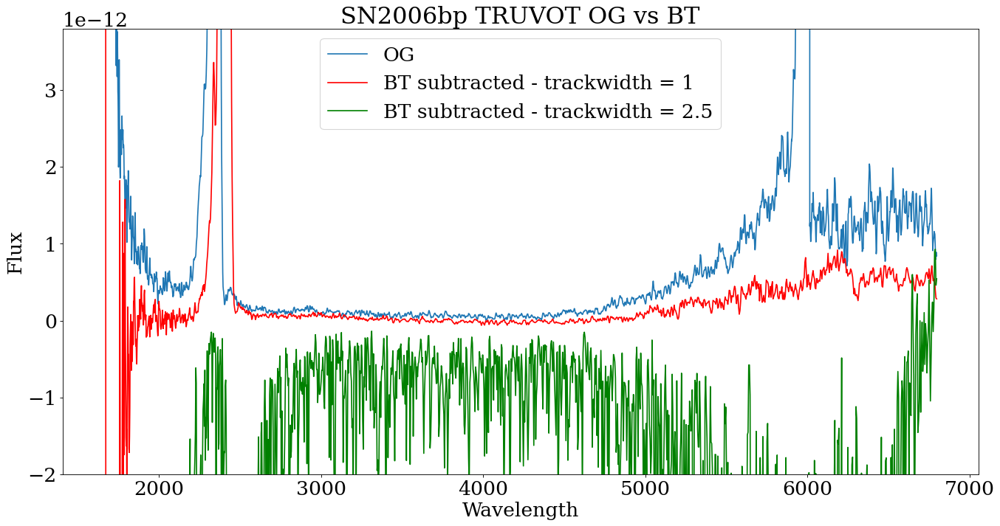

In [9]:
# import the data
SN06bp_5_bt_tw1 = "./TypeIIP/2SN2006bp/00030390005/uvot/image/sw00030390005ugu_1ord_final.dat"
SN06bp_5_wave_bt_tw1, SN06bp_5_flux_bt_tw1, SN06bp_5_fluxerr_bt_tw1 = np.loadtxt(SN06bp_5_bt_tw1, unpack=True)
SN06bp_5_bt_tw25 = "./TypeIIP/2SN2006bp/00030390005/uvot/sw00030390005ugu_1ord_final.dat"
SN06bp_5_wave_bt_tw25, SN06bp_5_flux_bt_tw25, SN06bp_5_fluxerr_bt_tw25 = np.loadtxt(SN06bp_5_bt_tw25, unpack=True)

fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2006bp TRUVOT OG vs BT')
plt.plot(SN06bp_5_wave_o,SN06bp_5_flux_o,label='OG',linewidth=1.5)
plt.plot(SN06bp_5_wave_bt_tw1,SN06bp_5_flux_bt_tw1,label='BT subtracted - trackwidth = 1',linewidth=1.5,c='r')
plt.plot(SN06bp_5_wave_bt_tw25,SN06bp_5_flux_bt_tw25,label='BT subtracted - trackwidth = 2.5',linewidth=1.5,c='g')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.000000000002,0.0000000000038)
plt.show()

### SN2005cs

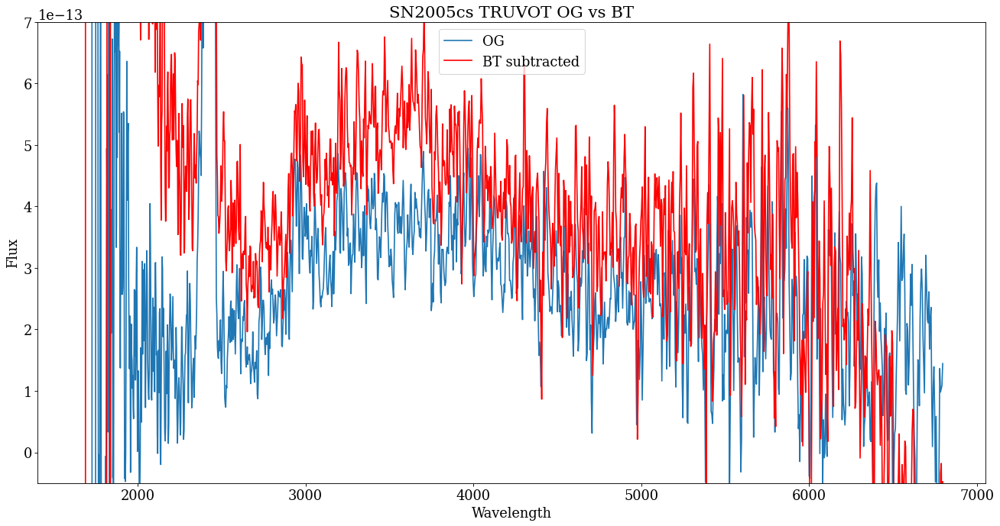

In [67]:
# import the data
# since there was only data 1 extension, the output file is formatted like: pixel_number, wavelength, something, something, flux, flux_error
SN05cs_10_bt = "./TypeIIP/1SN2005cs/00030083012/uvot/image/sw00030083012ugu_1ord_final.dat"
SN05cs_10_wave_bt, SN05cs_10_flux_bt, SN05cs_10_fluxerr_bt = np.loadtxt(SN05cs_10_bt, usecols=(1,4,5), unpack=True)

fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2005cs TRUVOT OG vs BT')
plt.plot(SN05cs_10_wave_o,SN05cs_10_flux_o,label='OG',linewidth=1.5)
plt.plot(SN05cs_10_wave_bt,SN05cs_10_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000005,0.0000000000007)
plt.show()

### SN2013ab

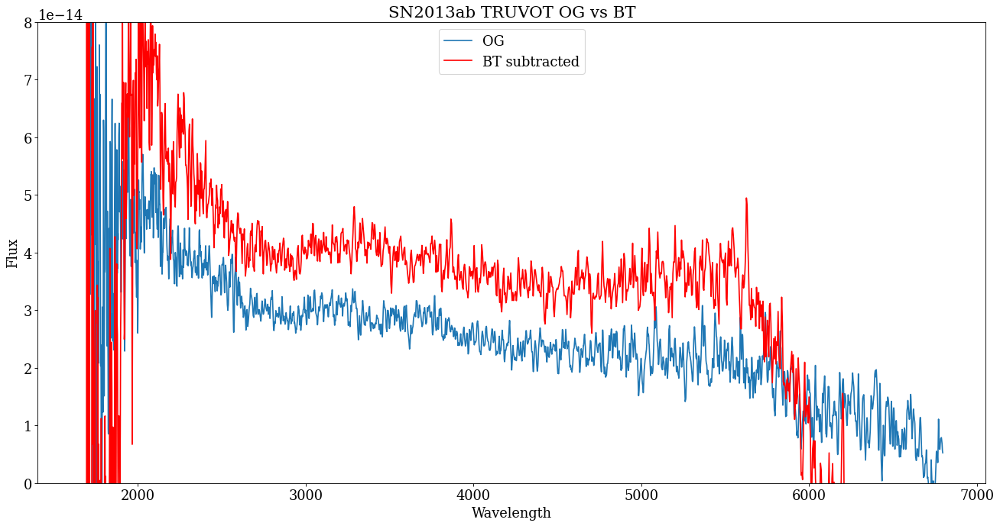

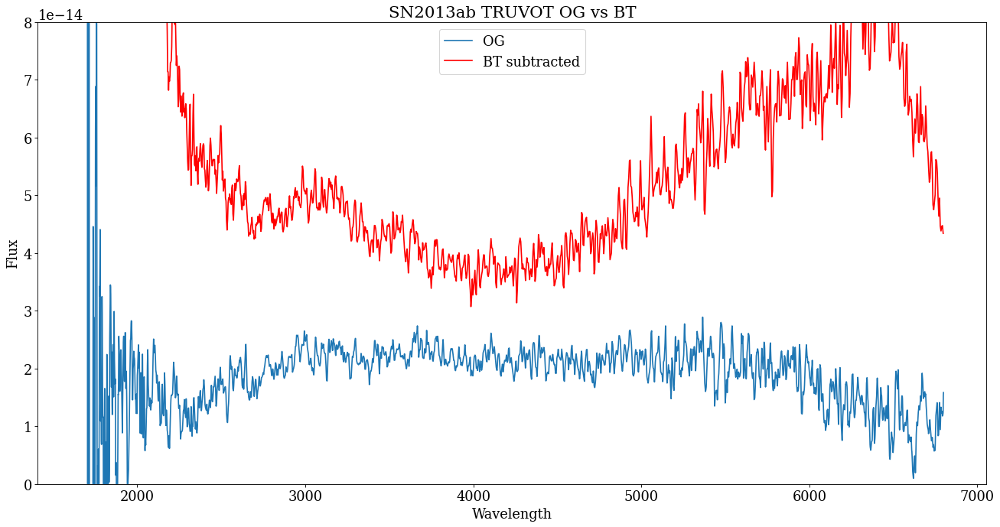

In [77]:
# import the data
SN13ab_5_wave_o, SN13ab_5_flux_o, SN13ab_5_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/3SN2013ab/00032725002sumspectrum.txt', unpack=True)
SN13ab_10_wave_o, SN13ab_10_flux_o, SN13ab_10_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIP/3SN2013ab/00032725005sumspectrum.txt', unpack=True)
SN13ab_5_bt = "./TypeIIP/3SN2013ab/00032725002/uvot/image/sw00032725002ugu_1ord_final.dat"
SN13ab_5_wave_bt, SN13ab_5_flux_bt, SN13ab_5_fluxerr_bt = np.loadtxt(SN13ab_5_bt, unpack=True)
SN13ab_10_bt = "./TypeIIP/3SN2013ab/00032725005/uvot/image/sw00032725005ugu_1ord_final.dat"
SN13ab_10_wave_bt, SN13ab_10_flux_bt, SN13ab_10_fluxerr_bt = np.loadtxt(SN13ab_10_bt, unpack=True)

# 00032725002
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2013ab TRUVOT OG vs BT')
plt.plot(SN13ab_5_wave_o,SN13ab_5_flux_o,label='OG',linewidth=1.5)
plt.plot(SN13ab_5_wave_bt,SN13ab_5_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(0,0.00000000000008)
plt.show()

# 00032725005
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2013ab TRUVOT OG vs BT')
plt.plot(SN13ab_10_wave_o,SN13ab_10_flux_o,label='OG',linewidth=1.5)
plt.plot(SN13ab_10_wave_bt,SN13ab_10_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(0,0.00000000000008)
plt.show()

## <a id='15b'>Type IIns</a> 
[Table of Contents](#0)

### SN2010jl

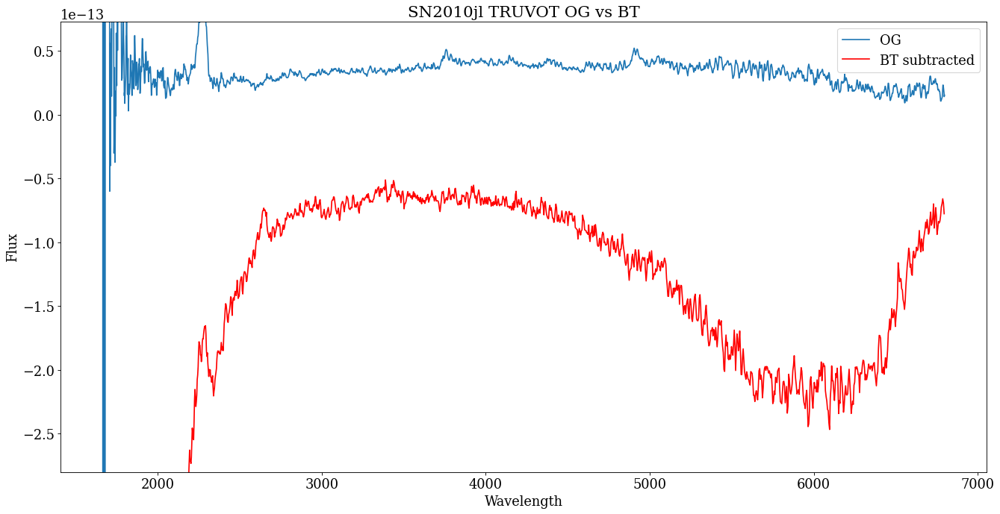

In [90]:
# import the data
SN10jl_42_wave_o, SN10jl_42_flux_o, SN10jl_42_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/1SN2010jl/00031858014sumspectrum.txt', unpack=True)
SN10jl_42_bt = "./TypeIIn/1SN2010jl/00031858014/uvot/image/sw00031858014ugu_1ord_final.dat"
SN10jl_42_wave_bt, SN10jl_42_flux_bt, SN10jl_42_fluxerr_bt = np.loadtxt(SN10jl_42_bt, unpack=True)

fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2010jl TRUVOT OG vs BT')
plt.plot(SN10jl_42_wave_o,SN10jl_42_flux_o,label='OG',linewidth=1.5)
plt.plot(SN10jl_42_wave_bt,SN10jl_42_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000028,0.000000000000073)
plt.show()

### SN2011ht

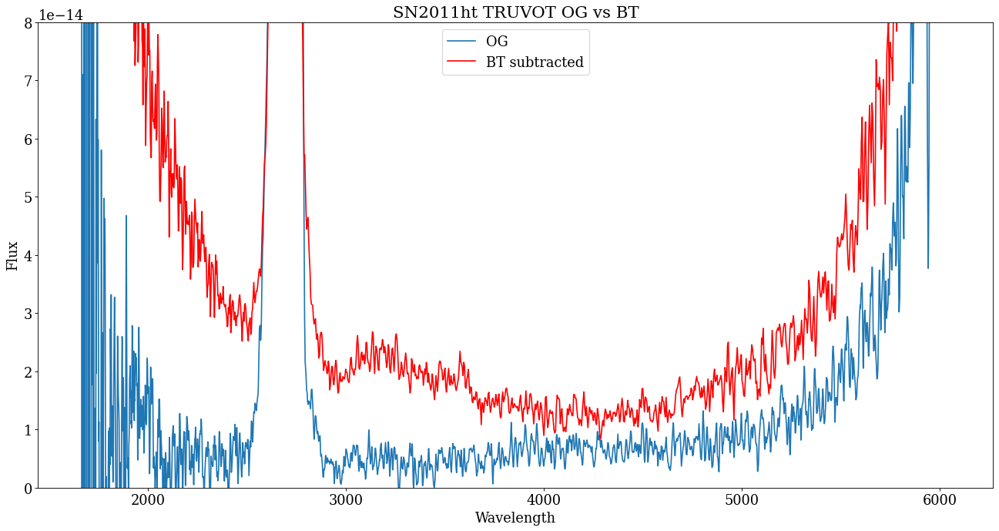

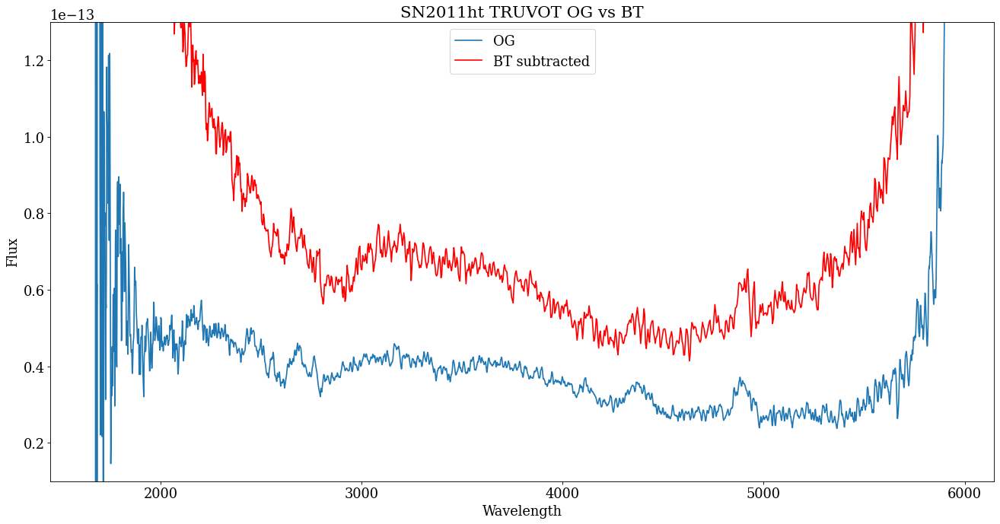

In [97]:
# import the data
SN11ht_3_wave_o, SN11ht_3_flux_o, SN11ht_3_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/2SN2011ht/00032150001sumspectrum.txt', unpack=True)
SN11ht_14_wave_o, SN11ht_14_flux_o, SN11ht_14_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/2SN2011ht/00032150003sumspectrum.txt', unpack=True)
SN11ht_3_bt = "./TypeIIn/2SN2011ht/00032150001/uvot/image/sw00032150001ugu_1ord_final.dat"
SN11ht_3_wave_bt, SN11ht_3_flux_bt, SN11ht_3_fluxerr_bt = np.loadtxt(SN11ht_3_bt, unpack=True)
SN11ht_14_bt = "./TypeIIn/2SN2011ht/00032150003/uvot/image/sw00032150003ugu_1ord_final.dat"
SN11ht_14_wave_bt, SN11ht_14_flux_bt, SN11ht_14_fluxerr_bt = np.loadtxt(SN11ht_14_bt, unpack=True)

# 00032150001
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2011ht TRUVOT OG vs BT')
plt.plot(SN11ht_3_wave_o,SN11ht_3_flux_o,label='OG',linewidth=1.5)
plt.plot(SN11ht_3_wave_bt,SN11ht_3_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(0,0.00000000000008)
plt.show()

# 00032150003
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2011ht TRUVOT OG vs BT')
plt.plot(SN11ht_14_wave_o,SN11ht_14_flux_o,label='OG',linewidth=1.5)
plt.plot(SN11ht_14_wave_bt,SN11ht_14_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(0.00000000000001,0.00000000000013)
plt.show()

### SN2015bf

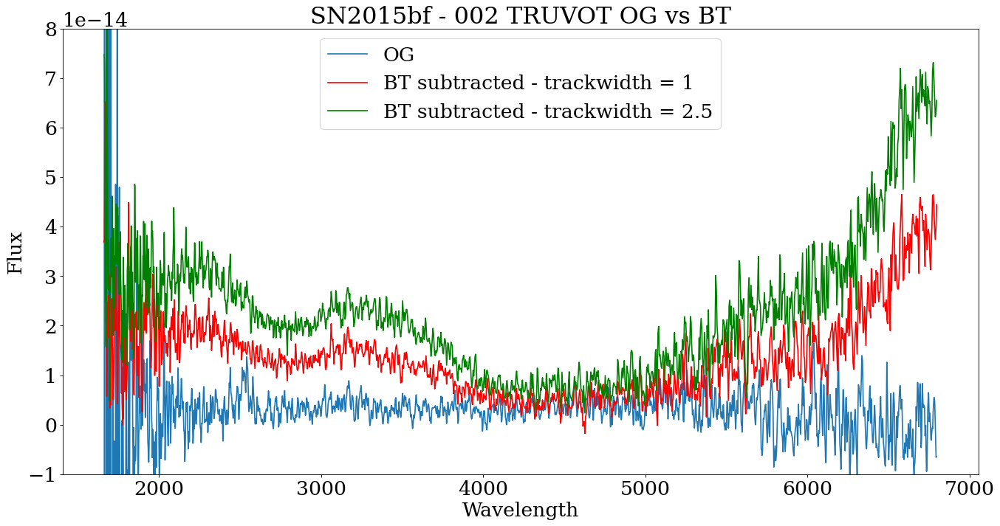

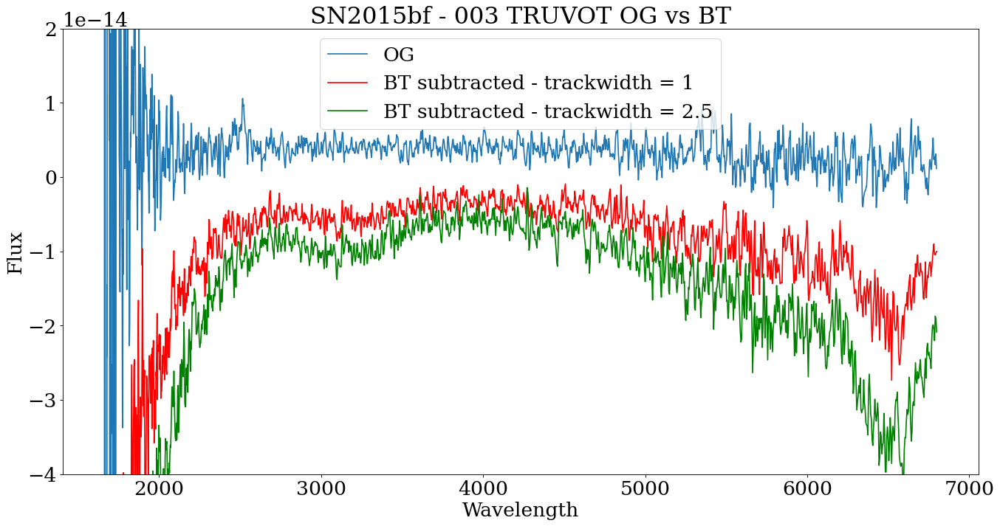

In [18]:
# import the data
SN15bf_4_wave_o, SN15bf_4_flux_o, SN15bf_4_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/6SN2015bf/00034221002sumspectrum.txt', unpack=True)
SN15bf_4_bt_tw1 = "./TypeIIn/6SN2015bf/00034221002/uvot/image/sw00034221002ugu_1ord_final.dat"
SN15bf_4_wave_bt_tw1, SN15bf_4_flux_bt_tw1, SN15bf_4_fluxerr_bt_tw1 = np.loadtxt(SN15bf_4_bt_tw1, unpack=True)
SN15bf_4_bt_tw25 = "./TypeIIn/6SN2015bf/00034221002/uvot/sw00034221002ugu_1ord_final.dat"
SN15bf_4_wave_bt_tw25, SN15bf_4_flux_bt_tw25, SN15bf_4_fluxerr_bt_tw25 = np.loadtxt(SN15bf_4_bt_tw25, unpack=True)

SN15bf_4half_wave_o, SN15bf_4half_flux_o, SN15bf_4half_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIn/6SN2015bf/00034221003sumspectrum.txt', unpack=True)
SN15bf_4half_bt_tw1 = "./TypeIIn/6SN2015bf/00034221003/uvot/image/sw00034221003ugu_1ord_final.dat"
SN15bf_4half_wave_bt_tw1, SN15bf_4half_flux_bt_tw1, SN15bf_4half_fluxerr_bt_tw1 = np.loadtxt(SN15bf_4half_bt_tw1, unpack=True)
SN15bf_4half_bt_tw25 = "./TypeIIn/6SN2015bf/00034221003/uvot/sw00034221003ugu_1ord_final.dat"
SN15bf_4half_wave_bt_tw25, SN15bf_4half_flux_bt_tw25, SN15bf_4half_fluxerr_bt_tw25 = np.loadtxt(SN15bf_4half_bt_tw25, unpack=True)

# 00034221002
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2015bf - 002 TRUVOT OG vs BT')
plt.plot(SN15bf_4_wave_o,SN15bf_4_flux_o,label='OG',linewidth=1.5)
plt.plot(SN15bf_4_wave_bt_tw1,SN15bf_4_flux_bt_tw1,label='BT subtracted - trackwidth = 1',linewidth=1.5,c='r')
plt.plot(SN15bf_4_wave_bt_tw25,SN15bf_4_flux_bt_tw25,label='BT subtracted - trackwidth = 2.5',linewidth=1.5,c='g')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000001,0.00000000000008)
plt.show()

# 00034221003
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2015bf - 003 TRUVOT OG vs BT')
plt.plot(SN15bf_4half_wave_o,SN15bf_4half_flux_o,label='OG',linewidth=1.5)
plt.plot(SN15bf_4half_wave_bt_tw1,SN15bf_4half_flux_bt_tw1,label='BT subtracted - trackwidth = 1',linewidth=1.5,c='r')
plt.plot(SN15bf_4half_wave_bt_tw25,SN15bf_4half_flux_bt_tw25,label='BT subtracted - trackwidth = 2.5',linewidth=1.5,c='g')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000004,0.00000000000002)
plt.show()

# 00034221006
# last epoch too faint originally

## <a id='15c'>Type IIbs</a> 
[Table of Contents](#0)

### SN2011dh

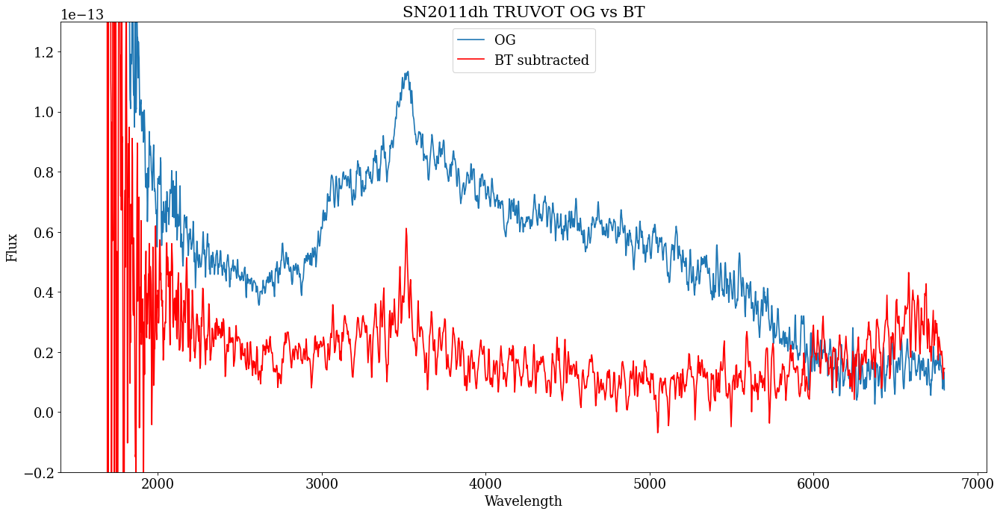

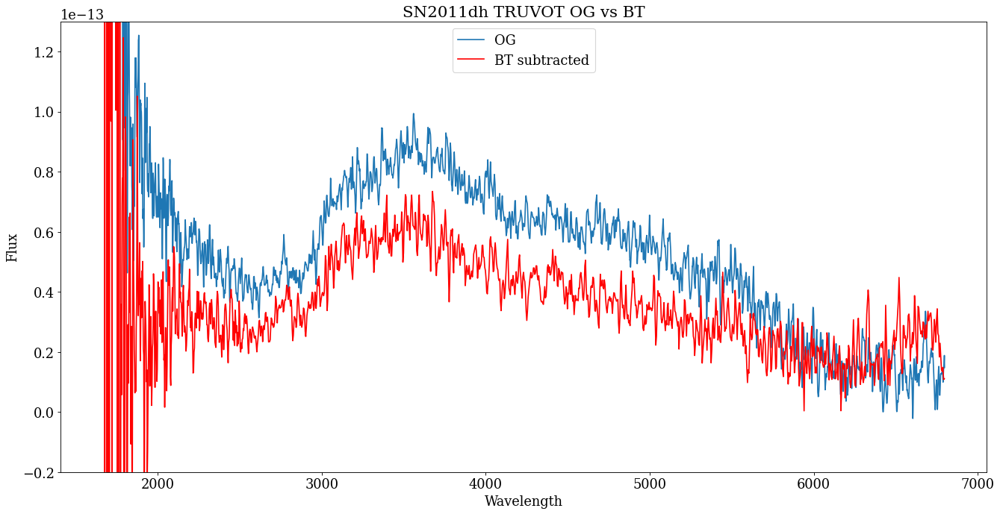

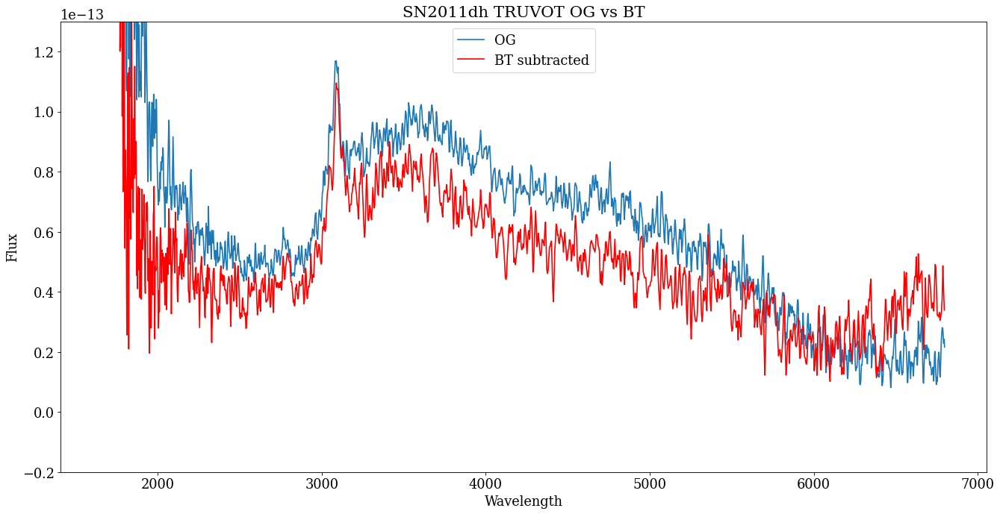

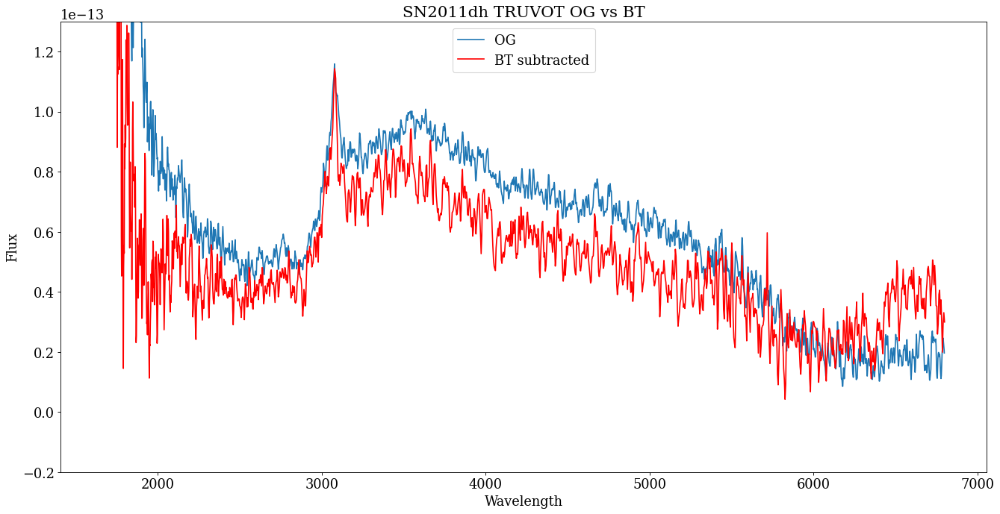

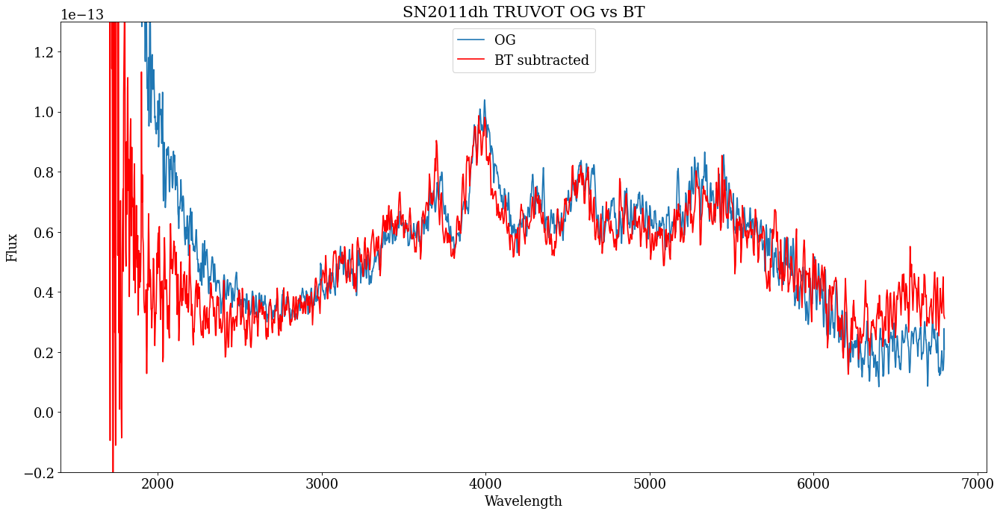

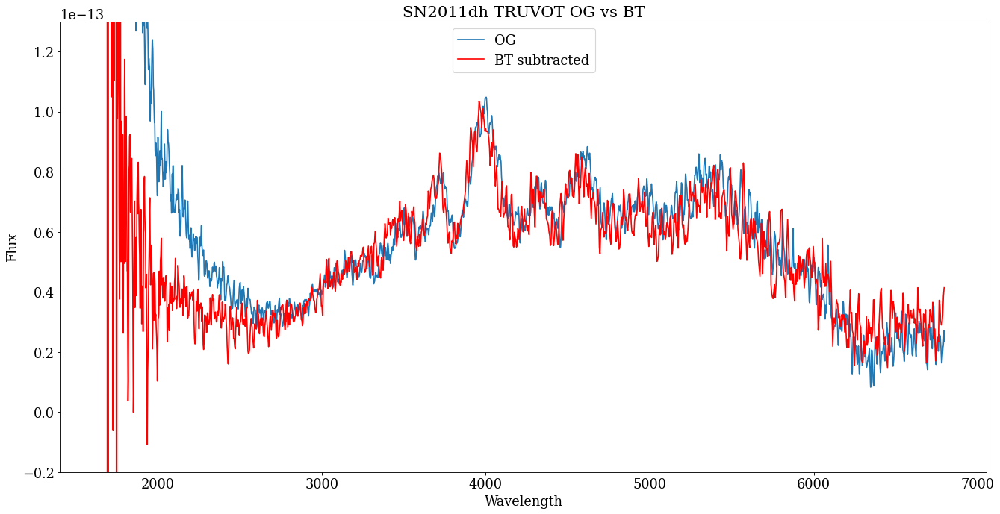

In [104]:
# import the data
SN11dh_5_wave_o, SN11dh_5_flux_o, SN11dh_5_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017005sumspectrum.txt', unpack=True)
SN11dh_7_wave_o, SN11dh_7_flux_o, SN11dh_7_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017013sumspectrum.txt', unpack=True)
SN11dh_8_wave_o, SN11dh_8_flux_o, SN11dh_8_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017017sumspectrum.txt', unpack=True)
SN11dh_9_wave_o, SN11dh_9_flux_o, SN11dh_9_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017020sumspectrum.txt', unpack=True)
SN11dh_10_wave_o, SN11dh_10_flux_o, SN11dh_10_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017023sumspectrum.txt', unpack=True)
SN11dh_11_wave_o, SN11dh_11_flux_o, SN11dh_11_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIIb/2SN2011dh/00032017026sumspectrum.txt', unpack=True)
SN11dh_5_bt = "./TypeIIb/2SN2011dh/00032017005/uvot/image/sw00032017005ugu_1ord_final.dat"
SN11dh_5_wave_bt, SN11dh_5_flux_bt, SN11dh_5_fluxerr_bt = np.loadtxt(SN11dh_5_bt, unpack=True)
SN11dh_7_bt = "./TypeIIb/2SN2011dh/00032017013/uvot/image/sw00032017013ugu_1ord_final.dat"
SN11dh_7_wave_bt, SN11dh_7_flux_bt, SN11dh_7_fluxerr_bt = np.loadtxt(SN11dh_7_bt, unpack=True)
SN11dh_8_bt = "./TypeIIb/2SN2011dh/00032017017/uvot/image/sw00032017017ugu_1ord_final.dat"
SN11dh_8_wave_bt, SN11dh_8_flux_bt, SN11dh_8_fluxerr_bt = np.loadtxt(SN11dh_8_bt, unpack=True)
SN11dh_9_bt = "./TypeIIb/2SN2011dh/00032017020/uvot/image/sw00032017020ugu_1ord_final.dat"
SN11dh_9_wave_bt, SN11dh_9_flux_bt, SN11dh_9_fluxerr_bt = np.loadtxt(SN11dh_9_bt, unpack=True)
SN11dh_10_bt = "./TypeIIb/2SN2011dh/00032017023/uvot/image/sw00032017023ugu_1ord_final.dat"
SN11dh_10_wave_bt, SN11dh_10_flux_bt, SN11dh_10_fluxerr_bt = np.loadtxt(SN11dh_10_bt, unpack=True)
SN11dh_11_bt = "./TypeIIb/2SN2011dh/00032017026/uvot/image/sw00032017026ugu_1ord_final.dat"
SN11dh_11_wave_bt, SN11dh_11_flux_bt, SN11dh_11_fluxerr_bt = np.loadtxt(SN11dh_11_bt, unpack=True)

# 00032017005
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2011dh TRUVOT OG vs BT')
plt.plot(SN11dh_5_wave_o,SN11dh_5_flux_o,label='OG',linewidth=1.5)
plt.plot(SN11dh_5_wave_bt,SN11dh_5_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000002,0.00000000000013)
plt.show()

# 00032017013
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2011dh TRUVOT OG vs BT')
plt.plot(SN11dh_7_wave_o,SN11dh_7_flux_o,label='OG',linewidth=1.5)
plt.plot(SN11dh_7_wave_bt,SN11dh_7_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000002,0.00000000000013)
plt.show()

# 00032017017
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2011dh TRUVOT OG vs BT')
plt.plot(SN11dh_8_wave_o,SN11dh_8_flux_o,label='OG',linewidth=1.5)
plt.plot(SN11dh_8_wave_bt,SN11dh_8_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000002,0.00000000000013)
plt.show()

# 00032017020
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2011dh TRUVOT OG vs BT')
plt.plot(SN11dh_9_wave_o,SN11dh_9_flux_o,label='OG',linewidth=1.5)
plt.plot(SN11dh_9_wave_bt,SN11dh_9_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000002,0.00000000000013)
plt.show()

# 00032017023
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2011dh TRUVOT OG vs BT')
plt.plot(SN11dh_10_wave_o,SN11dh_10_flux_o,label='OG',linewidth=1.5)
plt.plot(SN11dh_10_wave_bt,SN11dh_10_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000002,0.00000000000013)
plt.show()

# 00032017026
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2011dh TRUVOT OG vs BT')
plt.plot(SN11dh_11_wave_o,SN11dh_11_flux_o,label='OG',linewidth=1.5)
plt.plot(SN11dh_11_wave_bt,SN11dh_11_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000002,0.00000000000013)
plt.show()

## <a id='15d'>Type II_s</a> 
[Table of Contents](#0)

### SN2007pk

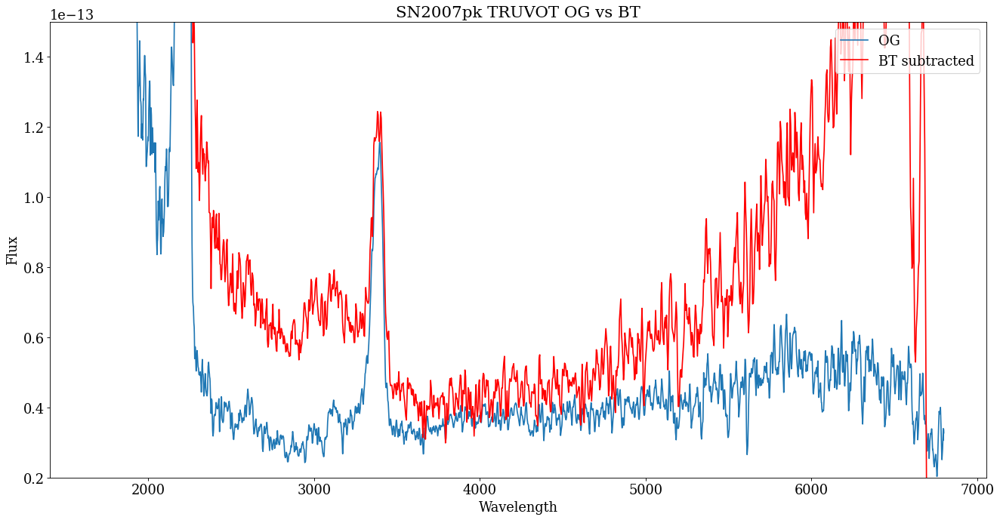

In [107]:
# import the data
SN07pk_13_wave_o, SN07pk_13_flux_o, SN07pk_13_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII_/1SN2007pk/00031014008sumspectrum.txt', unpack=True)
SN07pk_13_bt = "./TypeII_/1SN2007pk/00031014008/uvot/image/sw00031014008ugu_1ord_final.dat"
SN07pk_13_wave_bt, SN07pk_13_flux_bt, SN07pk_13_fluxerr_bt = np.loadtxt(SN07pk_13_bt, unpack=True)

fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2007pk TRUVOT OG vs BT')
plt.plot(SN07pk_13_wave_o,SN07pk_13_flux_o,label='OG',linewidth=1.5)
plt.plot(SN07pk_13_wave_bt,SN07pk_13_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(0.00000000000002,0.00000000000015)
plt.show()

## <a id='15f'>Type IIs</a> 
[Table of Contents](#0)

### SN2008M

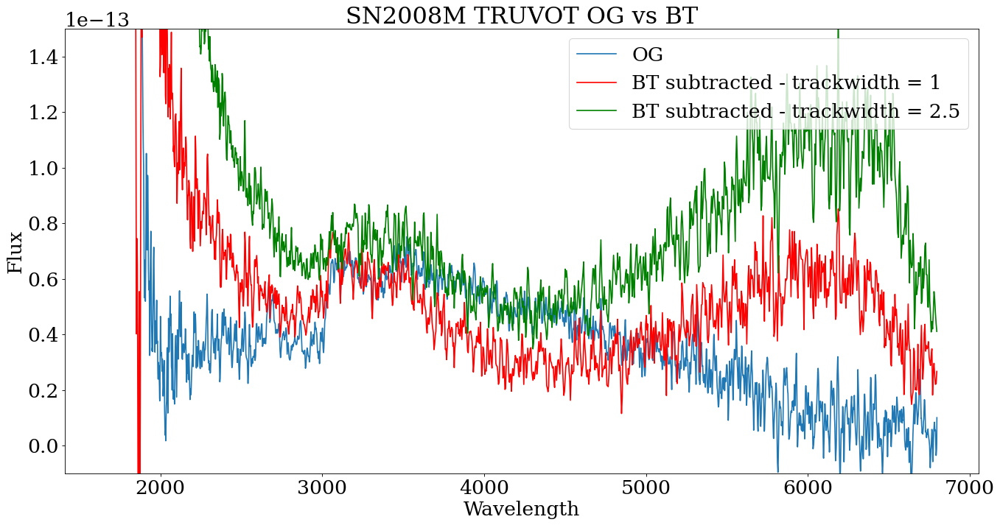

In [16]:
# import the data
SN08M_24_wave_o, SN08M_24_flux_o, SN08M_24_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/2SN2008M/00031102003sumspectrum.txt', unpack=True)
SN08M_24_bt_tw1 = "./TypeII/2SN2008M/00031102003/uvot/image/sw00031102003ugu_1ord_final.dat"
SN08M_24_wave_bt_tw1, SN08M_24_flux_bt_tw1, SN08M_24_fluxerr_bt_tw1 = np.loadtxt(SN08M_24_bt_tw1, unpack=True)
SN08M_24_bt_tw25 = "./TypeII/2SN2008M/00031102003/uvot/sw00031102003ugu_1ord_final.dat"
SN08M_24_wave_bt_tw25, SN08M_24_flux_bt_tw25, SN08M_24_fluxerr_bt_tw25 = np.loadtxt(SN08M_24_bt_tw25, unpack=True)

fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2008M TRUVOT OG vs BT')
plt.plot(SN08M_24_wave_o,SN08M_24_flux_o,label='OG',linewidth=1.5)
plt.plot(SN08M_24_wave_bt_tw1,SN08M_24_flux_bt_tw1,label='BT subtracted - trackwidth = 1',linewidth=1.5,c='r')
plt.plot(SN08M_24_wave_bt_tw25,SN08M_24_flux_bt_tw25,label='BT subtracted - trackwidth = 2.5',linewidth=1.5,c='g')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000001,0.00000000000015)
plt.show()

### SN2013ej

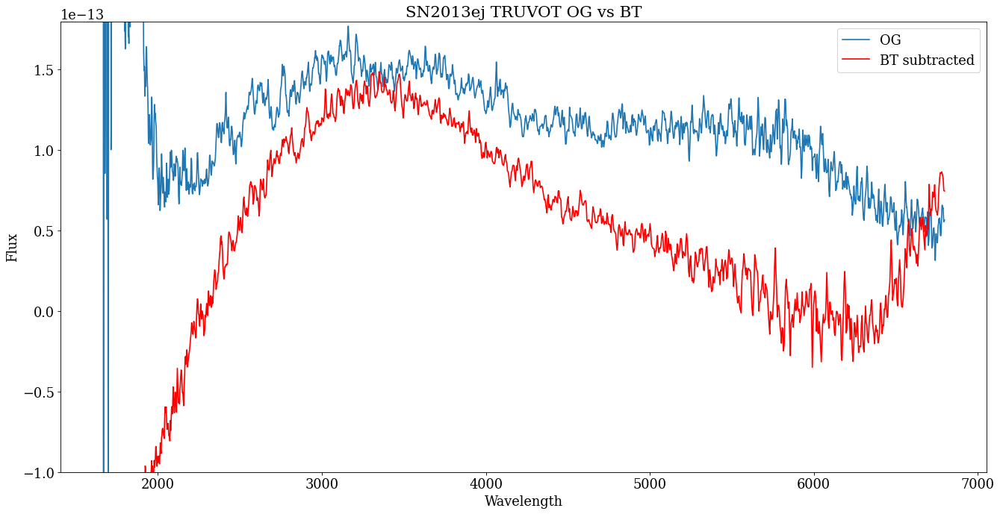

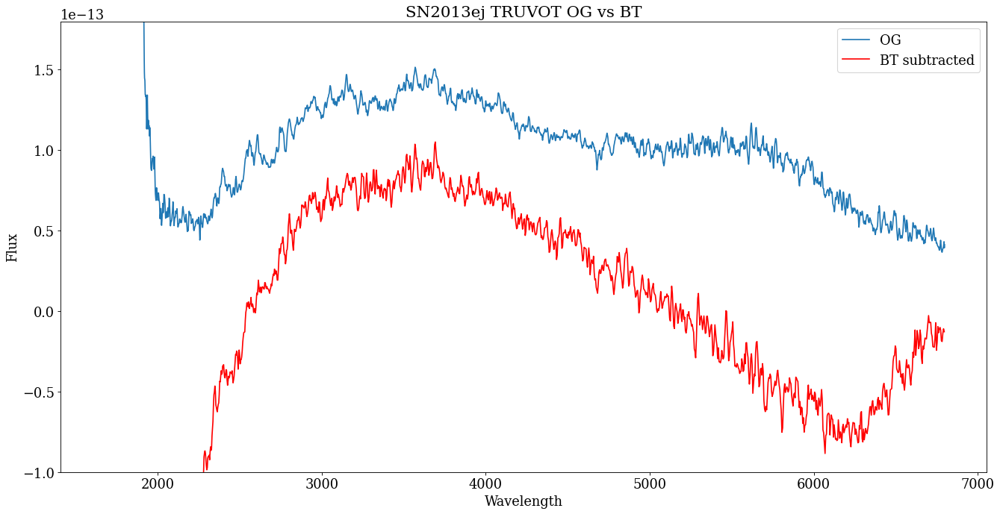

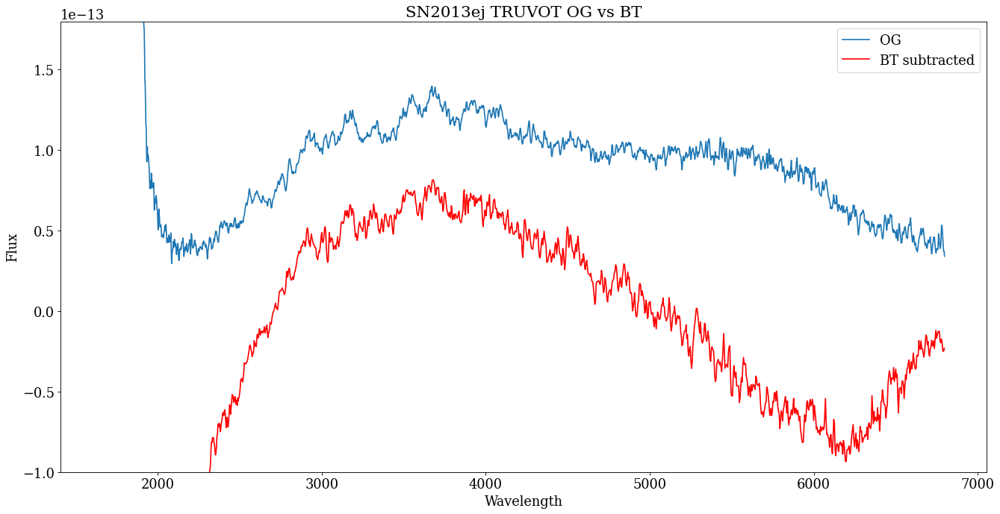

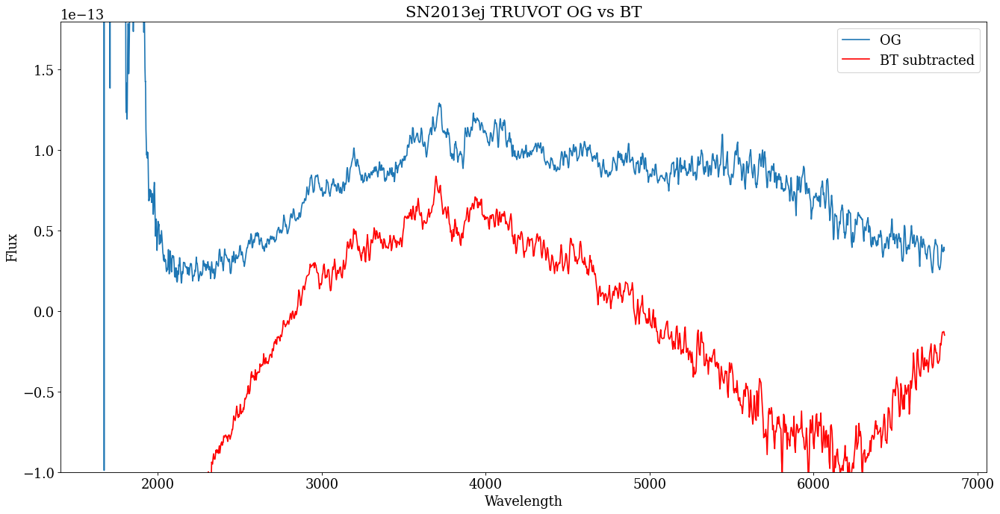

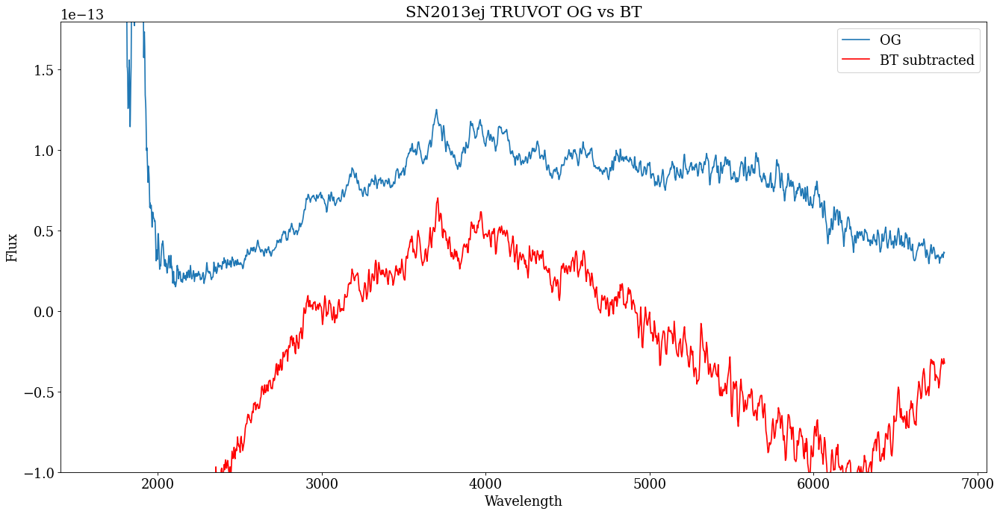

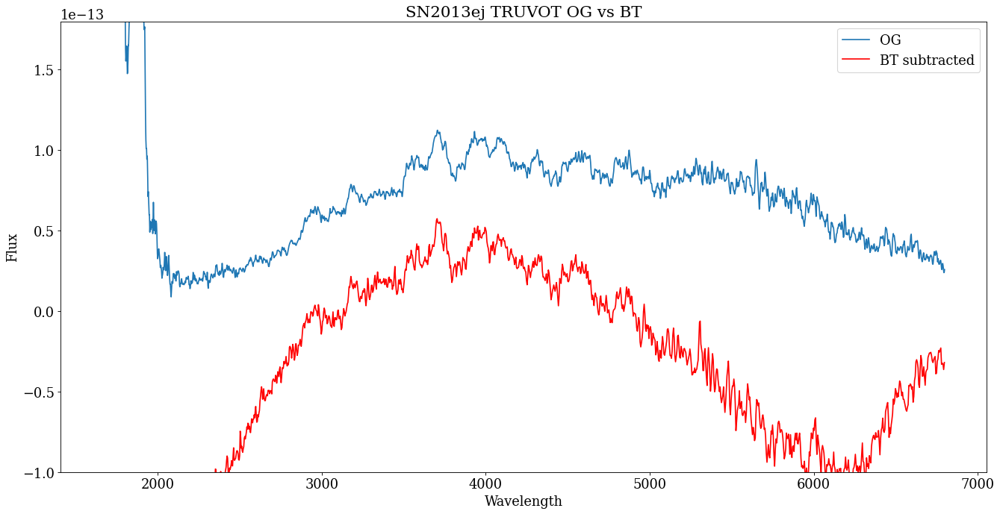

In [115]:
# import the data
SN13ej_7_wave_o, SN13ej_7_flux_o, SN13ej_7_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891003sumspectrum.txt', unpack=True)
SN13ej_9_wave_o, SN13ej_9_flux_o, SN13ej_9_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891006sumspectrum.txt', unpack=True)
SN13ej_11_wave_o, SN13ej_11_flux_o, SN13ej_11_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891009sumspectrum.txt', unpack=True)
SN13ej_14_wave_o, SN13ej_14_flux_o, SN13ej_14_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891011sumspectrum.txt', unpack=True)
SN13ej_15_wave_o, SN13ej_15_flux_o, SN13ej_15_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891014sumspectrum.txt', unpack=True)
SN13ej_16_wave_o, SN13ej_16_flux_o, SN13ej_16_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/7SN2013ej/00032891016sumspectrum.txt', unpack=True)
SN13ej_7_bt = "./TypeII/7SN2013ej/00032891003/uvot/image/sw00032891003ugu_1ord_final.dat"
SN13ej_7_wave_bt, SN13ej_7_flux_bt, SN13ej_7_fluxerr_bt = np.loadtxt(SN13ej_7_bt, unpack=True)
SN13ej_9_bt = "./TypeII/7SN2013ej/00032891006/uvot/image/sw00032891006ugu_1ord_final.dat"
SN13ej_9_wave_bt, SN13ej_9_flux_bt, SN13ej_9_fluxerr_bt = np.loadtxt(SN13ej_9_bt, unpack=True)
SN13ej_11_bt = "./TypeII/7SN2013ej/00032891009/uvot/image/sw00032891009ugu_1ord_final.dat"
SN13ej_11_wave_bt, SN13ej_11_flux_bt, SN13ej_11_fluxerr_bt = np.loadtxt(SN13ej_11_bt, unpack=True)
SN13ej_14_bt = "./TypeII/7SN2013ej/00032891011/uvot/image/sw00032891011ugu_1ord_final.dat"
SN13ej_14_wave_bt, SN13ej_14_flux_bt, SN13ej_14_fluxerr_bt = np.loadtxt(SN13ej_14_bt, unpack=True)
SN13ej_15_bt = "./TypeII/7SN2013ej/00032891014/uvot/image/sw00032891014ugu_1ord_final.dat"
SN13ej_15_wave_bt, SN13ej_15_flux_bt, SN13ej_15_fluxerr_bt = np.loadtxt(SN13ej_15_bt, unpack=True)
SN13ej_16_bt = "./TypeII/7SN2013ej/00032891016/uvot/image/sw00032891016ugu_1ord_final.dat"
SN13ej_16_wave_bt, SN13ej_16_flux_bt, SN13ej_16_fluxerr_bt = np.loadtxt(SN13ej_16_bt, unpack=True)

# 00032891003
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2013ej TRUVOT OG vs BT')
plt.plot(SN13ej_7_wave_o,SN13ej_7_flux_o,label='OG',linewidth=1.5)
plt.plot(SN13ej_7_wave_bt,SN13ej_7_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.0000000000001,0.00000000000018)
plt.show()

# 00032891006
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2013ej TRUVOT OG vs BT')
plt.plot(SN13ej_9_wave_o,SN13ej_9_flux_o,label='OG',linewidth=1.5)
plt.plot(SN13ej_9_wave_bt,SN13ej_9_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.0000000000001,0.00000000000018)
plt.show()

# 00032891009
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2013ej TRUVOT OG vs BT')
plt.plot(SN13ej_11_wave_o,SN13ej_11_flux_o,label='OG',linewidth=1.5)
plt.plot(SN13ej_11_wave_bt,SN13ej_11_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.0000000000001,0.00000000000018)
plt.show()

# 00032891011
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2013ej TRUVOT OG vs BT')
plt.plot(SN13ej_14_wave_o,SN13ej_14_flux_o,label='OG',linewidth=1.5)
plt.plot(SN13ej_14_wave_bt,SN13ej_14_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.0000000000001,0.00000000000018)
plt.show()

# 00032891014
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2013ej TRUVOT OG vs BT')
plt.plot(SN13ej_15_wave_o,SN13ej_15_flux_o,label='OG',linewidth=1.5)
plt.plot(SN13ej_15_wave_bt,SN13ej_15_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.0000000000001,0.00000000000018)
plt.show()

# 00032891016
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2013ej TRUVOT OG vs BT')
plt.plot(SN13ej_16_wave_o,SN13ej_16_flux_o,label='OG',linewidth=1.5)
plt.plot(SN13ej_16_wave_bt,SN13ej_16_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.0000000000001,0.00000000000018)
plt.show()

### SN2016gkg

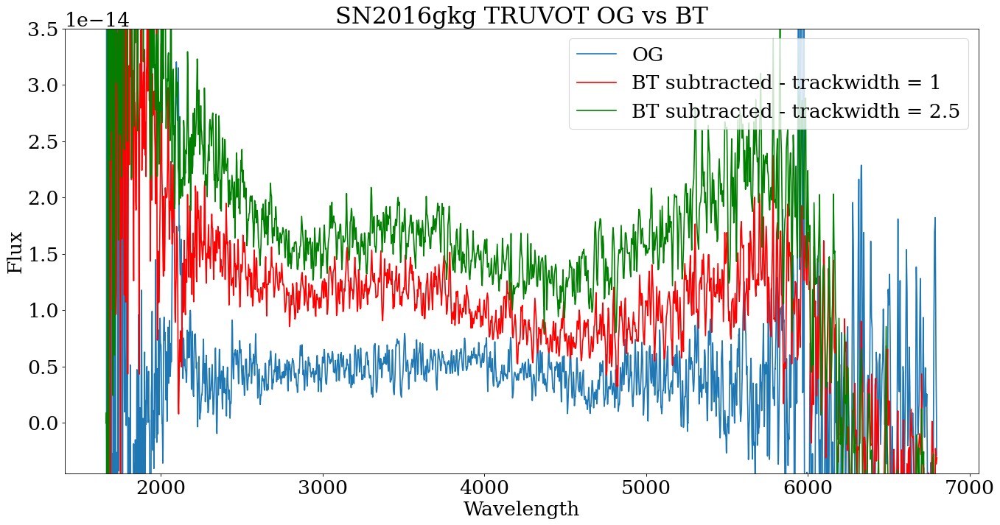

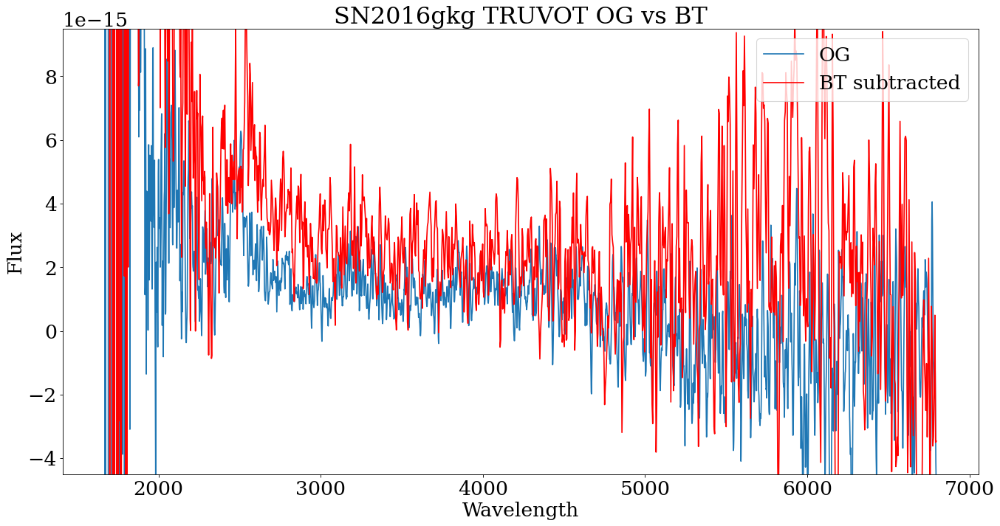

In [17]:
# import the data
SN16gkg_2_wave_o, SN16gkg_2_flux_o, SN16gkg_2_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/8SN2016gkg/00034737001sumspectrum.txt', unpack=True)
SN16gkg_5_wave_o, SN16gkg_5_flux_o, SN16gkg_5_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/8SN2016gkg/00034737003sumspectrum.txt', unpack=True)
SN16gkg_2_bt_tw1 = "./TypeII/8SN2016gkg/00034737001/uvot/image/sw00034737001ugu_1ord_final.dat"
SN16gkg_2_wave_bt_tw1, SN16gkg_2_flux_bt_tw1, SN16gkg_2_fluxerr_bt_tw1 = np.loadtxt(SN16gkg_2_bt_tw1, unpack=True)
SN16gkg_2_bt_tw25 = "./TypeII/8SN2016gkg/00034737001/uvot/sw00034737001ugu_1ord_final_ogbg.dat"
SN16gkg_2_wave_bt_tw25, SN16gkg_2_flux_bt_tw25, SN16gkg_2_fluxerr_bt_tw25 = np.loadtxt(SN16gkg_2_bt_tw25, unpack=True)
#SN16gkg_2_bt_test = "./TypeII/8SN2016gkg/00034737001/uvot/sw00034737001ugu_1ord_final_bgchanged.dat"
#SN16gkg_2_wave_bt_test, SN16gkg_2_flux_bt_test, SN16gkg_2_fluxerr_bt_test = np.loadtxt(SN16gkg_2_bt_test, unpack=True)
#SN16gkg_2_bt_testa = "./TypeII/8SN2016gkg/00034737001/uvot/sw00034737001ugu_1ord_final_minus1ext.dat"
#SN16gkg_2_wave_bt_testa, SN16gkg_2_flux_bt_testa, SN16gkg_2_fluxerr_bt_testa = np.loadtxt(SN16gkg_2_bt_testa, unpack=True)
#SN16gkg_2_bt_testb = "./TypeII/8SN2016gkg/00034737001/uvot/image/sw00034737001ugu_1ord_final.dat"
#SN16gkg_2_wave_bt_testb, SN16gkg_2_flux_bt_testb, SN16gkg_2_fluxerr_bt_testb = np.loadtxt(SN16gkg_2_bt_testb, unpack=True)

SN16gkg_5_bt = "./TypeII/8SN2016gkg/00034737003/uvot/image/sw00034737003ugu_1ord_final.dat"
SN16gkg_5_wave_bt, SN16gkg_5_flux_bt, SN16gkg_5_fluxerr_bt = np.loadtxt(SN16gkg_5_bt, unpack=True)

# 00034737001
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2016gkg TRUVOT OG vs BT')
plt.plot(SN16gkg_2_wave_o,SN16gkg_2_flux_o,label='OG',linewidth=1.5)
plt.plot(SN16gkg_2_wave_bt_tw1,SN16gkg_2_flux_bt_tw1,label='BT subtracted - trackwidth = 1',linewidth=1.5,c='r')
plt.plot(SN16gkg_2_wave_bt_tw25,SN16gkg_2_flux_bt_tw25,label='BT subtracted - trackwidth = 2.5',linewidth=1.5,c='g')
#plt.plot(SN16gkg_2_wave_bt_test,SN16gkg_2_flux_bt_test,label='BT subtracted changed bg value',linewidth=1.5,c='green')
#plt.plot(SN16gkg_2_wave_bt_testa,SN16gkg_2_flux_bt_testa,label='BT subtracted took away one extension',linewidth=1.5,c='black')
#plt.plot(SN16gkg_2_wave_bt_testb,SN16gkg_2_flux_bt_testb,label='BT subtracted back to square one',linewidth=1.5,c='blue')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.0000000000000045,0.000000000000035)
plt.show()

# 00034737003
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2016gkg TRUVOT OG vs BT')
plt.plot(SN16gkg_5_wave_o,SN16gkg_5_flux_o,label='OG',linewidth=1.5)
plt.plot(SN16gkg_5_wave_bt,SN16gkg_5_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.0000000000000045,0.0000000000000095)
plt.show()

### SN2017eaw

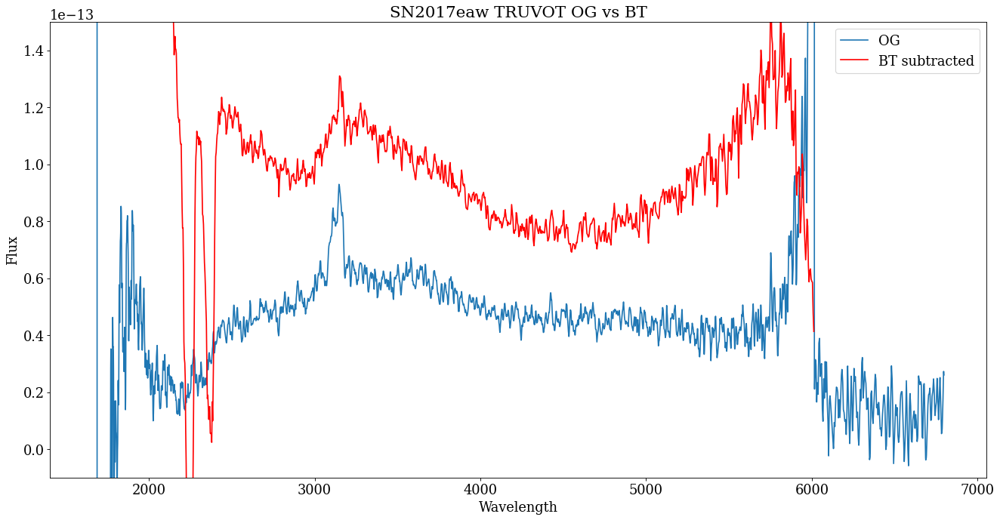

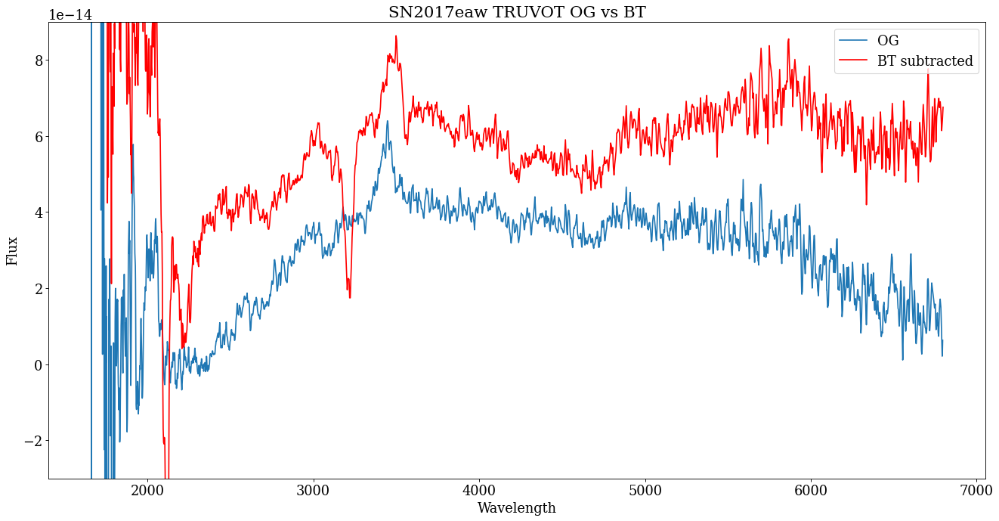

In [11]:
# import the data
SN17eaw_2_wave_o, SN17eaw_2_flux_o, SN17eaw_2_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/9SN2017eaw/00010130004sumspectrum.txt', unpack=True)
SN17eaw_9_wave_o, SN17eaw_9_flux_o, SN17eaw_9_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/9SN2017eaw/00010130008sumspectrum.txt', unpack=True)
SN17eaw_2_bt = "./TypeII/9SN2017eaw/00010130004/uvot/image/sw00010130004ugu_1ord_final.dat"
SN17eaw_2_wave_bt, SN17eaw_2_flux_bt, SN17eaw_2_fluxerr_bt = np.loadtxt(SN17eaw_2_bt, unpack=True)
SN17eaw_9_bt = "./TypeII/9SN2017eaw/00010130008/uvot/image/sw00010130008ugu_1ord_final.dat"
SN17eaw_9_wave_bt, SN17eaw_9_flux_bt, SN17eaw_9_fluxerr_bt = np.loadtxt(SN17eaw_9_bt, unpack=True)

# 00010130004
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2017eaw TRUVOT OG vs BT')
plt.plot(SN17eaw_2_wave_o,SN17eaw_2_flux_o,label='OG',linewidth=1.5)
plt.plot(SN17eaw_2_wave_bt,SN17eaw_2_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000001,0.00000000000015)
plt.show()

# 00010130008
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2017eaw TRUVOT OG vs BT')
plt.plot(SN17eaw_9_wave_o,SN17eaw_9_flux_o,label='OG',linewidth=1.5)
plt.plot(SN17eaw_9_wave_bt,SN17eaw_9_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000003,0.00000000000009)
plt.show()

### SN2017egm

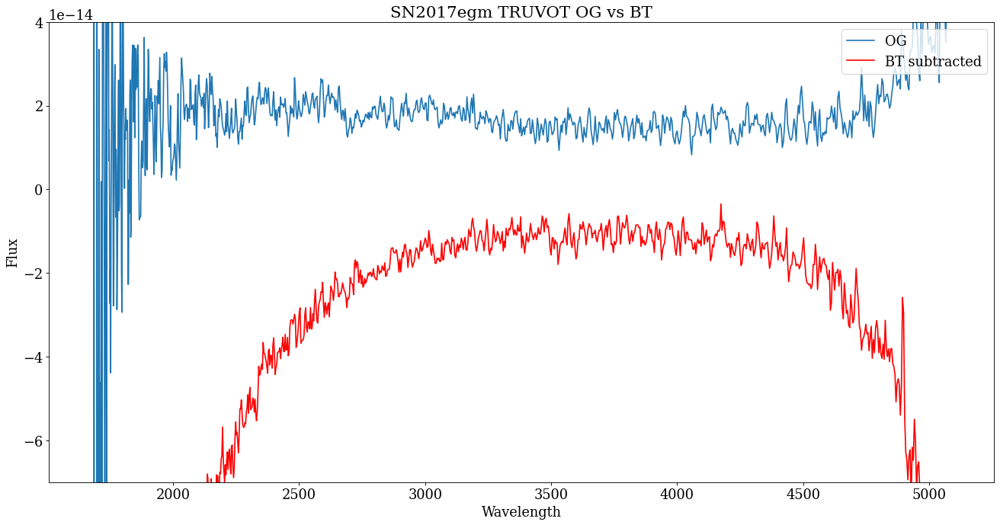

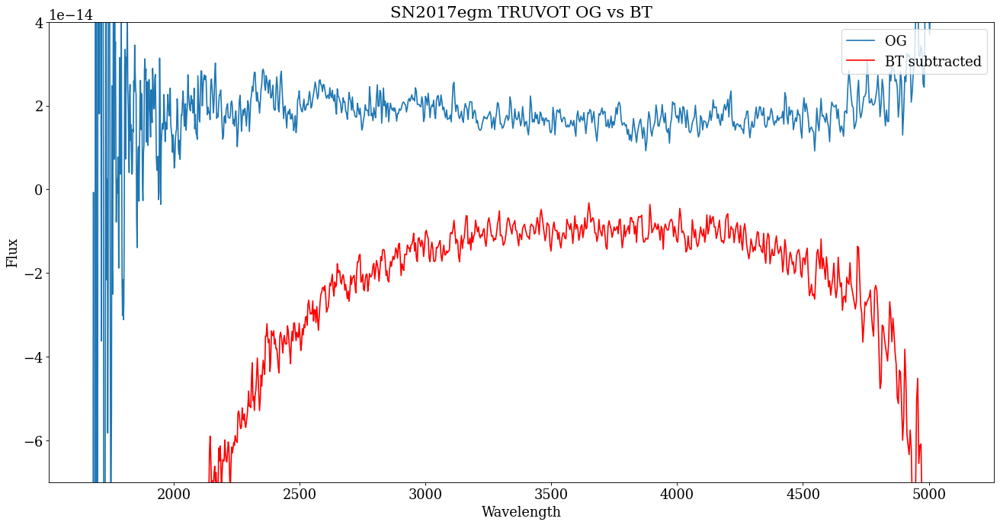

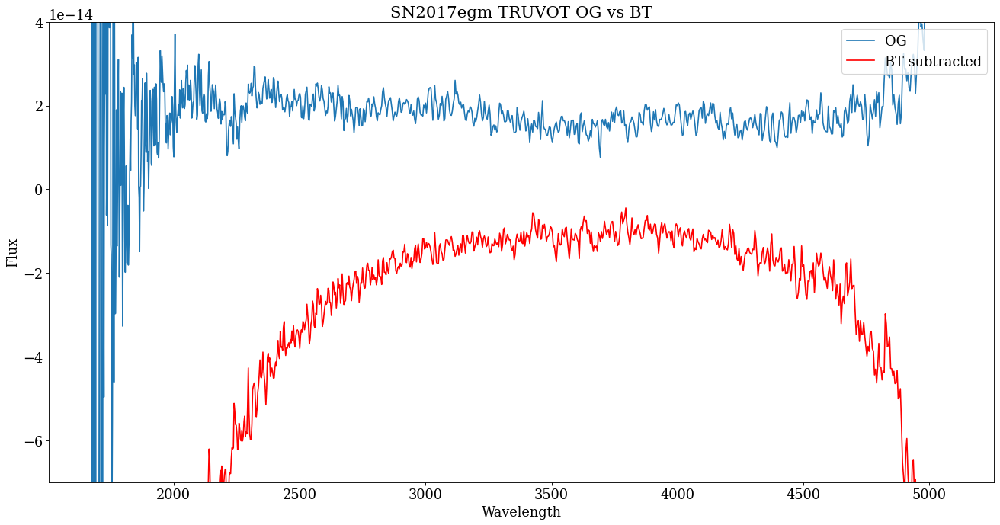

In [17]:
# import the data
# since there was only data 1 extension, the output file is formatted like: pixel_number, wavelength, something, something, flux, flux_error
SN17egm_23one_wave_o, SN17egm_23one_flux_o, SN17egm_23one_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/10SN2017egm/00010154001e1spectrum.txt', unpack=True)
SN17egm_23two_wave_o, SN17egm_23two_flux_o, SN17egm_23two_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/10SN2017egm/00010154002e1spectrum.txt', unpack=True)
SN17egm_23three_wave_o, SN17egm_23three_flux_o, SN17egm_23three_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeII/10SN2017egm/00010154003e1spectrum.txt', unpack=True)
SN17egm_23one_bt = "./TypeII/10SN2017egm/00010154001/uvot/image/sw00010154001ugu_1ord_final.dat"
SN17egm_23one_wave_bt, SN17egm_23one_flux_bt, SN17egm_23one_fluxerr_bt = np.loadtxt(SN17egm_23one_bt, usecols=(1,4,5), unpack=True)
SN17egm_23two_bt = "./TypeII/10SN2017egm/00010154002/uvot/image/sw00010154002ugu_1ord_final.dat"
SN17egm_23two_wave_bt, SN17egm_23two_flux_bt, SN17egm_23two_fluxerr_bt = np.loadtxt(SN17egm_23two_bt, usecols=(1,4,5), unpack=True)
SN17egm_23three_bt = "./TypeII/10SN2017egm/00010154003/uvot/image/sw00010154003ugu_1ord_final.dat"
SN17egm_23three_wave_bt, SN17egm_23three_flux_bt, SN17egm_23three_fluxerr_bt = np.loadtxt(SN17egm_23three_bt, usecols=(1,4,5), unpack=True)

# 00010154001
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2017egm TRUVOT OG vs BT')
plt.plot(SN17egm_23one_wave_o,SN17egm_23one_flux_o,label='OG',linewidth=1.5)
plt.plot(SN17egm_23one_wave_bt,SN17egm_23one_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000007,0.00000000000004)
plt.show()

# 00010154002
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2017egm TRUVOT OG vs BT')
plt.plot(SN17egm_23two_wave_o,SN17egm_23two_flux_o,label='OG',linewidth=1.5)
plt.plot(SN17egm_23two_wave_bt,SN17egm_23two_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000007,0.00000000000004)
plt.show()

# 00010154003
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2017egm TRUVOT OG vs BT')
plt.plot(SN17egm_23three_wave_o,SN17egm_23three_flux_o,label='OG',linewidth=1.5)
plt.plot(SN17egm_23three_wave_bt,SN17egm_23three_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=1)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000007,0.00000000000004)
plt.show()

## <a id='15e'>Type Ibns</a> 
[Table of Contents](#0)

### SN2006jc

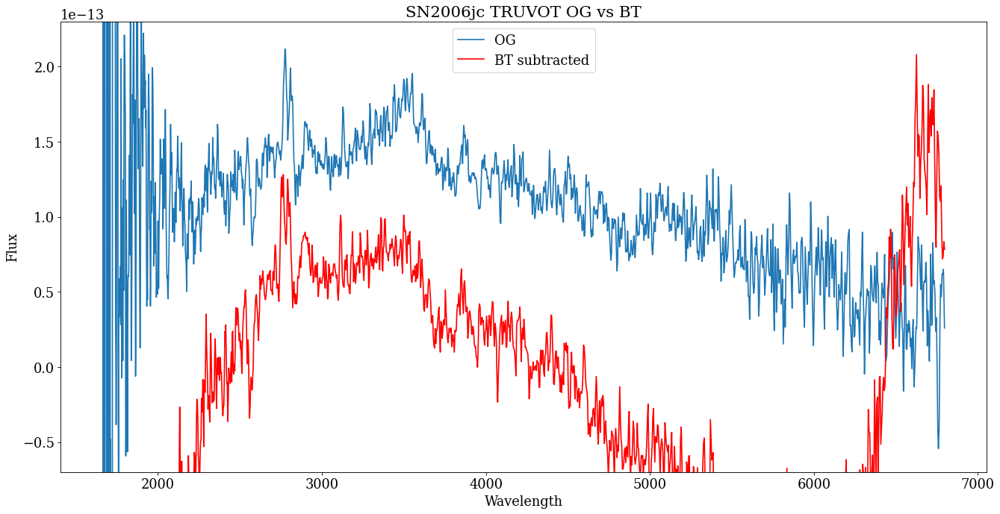

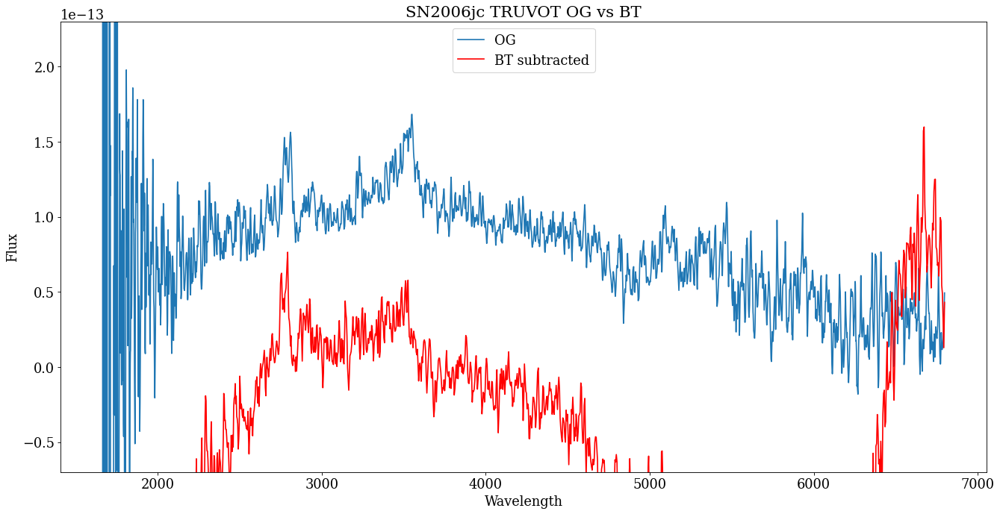

In [108]:
# import the data
SN06jc_22_wave_o, SN06jc_22_flux_o, SN06jc_22_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIbn/1SN2006jc/00030810004sumspectrum.txt', unpack=True)
SN06jc_25_wave_o, SN06jc_25_flux_o, SN06jc_25_fluxerr_o = np.loadtxt('/Users/micalynrowe/Desktop/TAMU/3SUMMER2020/TypeIbn/1SN2006jc/00030810007sumspectrum.txt', unpack=True)
SN06jc_22_bt = "./TypeIbn/1SN2006jc/00030810004/uvot/image/sw00030810004ugu_1ord_final.dat"
SN06jc_22_wave_bt, SN06jc_22_flux_bt, SN06jc_22_fluxerr_bt = np.loadtxt(SN06jc_22_bt, unpack=True)
SN06jc_25_bt = "./TypeIbn/1SN2006jc/00030810007/uvot/image/sw00030810007ugu_1ord_final.dat"
SN06jc_25_wave_bt, SN06jc_25_flux_bt, SN06jc_25_fluxerr_bt = np.loadtxt(SN06jc_25_bt, unpack=True)


# 00030810004
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2006jc TRUVOT OG vs BT')
plt.plot(SN06jc_22_wave_o,SN06jc_22_flux_o,label='OG',linewidth=1.5)
plt.plot(SN06jc_22_wave_bt,SN06jc_22_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000007,0.00000000000023)
plt.show()

# 00030810007
fig=plt.figure(figsize=(20, 10), dpi= 80, facecolor='w', edgecolor='k')
plt.title('SN2006jc TRUVOT OG vs BT')
plt.plot(SN06jc_25_wave_o,SN06jc_25_flux_o,label='OG',linewidth=1.5)
plt.plot(SN06jc_25_wave_bt,SN06jc_25_flux_bt,label='BT subtracted',linewidth=1.5,c='r')
plt.legend(loc=9)
plt.xlabel("Wavelength")
plt.ylabel("Flux")
plt.ylim(-0.00000000000007,0.00000000000023)
plt.show()

# <a id='19'>Spectrophotometry</a> 
[Table of Contents](#0)

In [9]:
# defining column names and data types to pass to read_csv function
names = ['filter', 'mjd', 'mag', 'magerr', 'exposure', 'elapse']
types = {'filter': str, 'mjd': float, 'mag': float, 'magerr': float, 'exposure': float, 'elapse': float}

## <a id='19a'>Type IIbs</a> 
[Table of Contents](#0)

### <a id='19a1'>SN2011dh</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

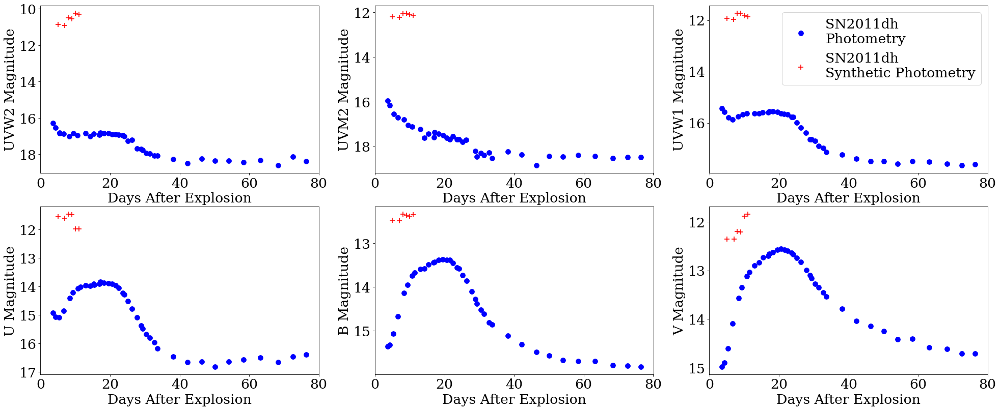

In [111]:
SN11dh_obsdata = [SN11dh_5_o,SN11dh_7_o,SN11dh_8_o,SN11dh_9_o,
                   SN11dh_10_o,SN11dh_11_o]

# turning spectra into magnitudes for SN11dh obs
SN11dh_o_mag = []
for sp in range(len(SN11dh_obsdata)):
    SN11dh_o_mag.append(specphot_filters(SN11dh_obsdata[sp]))
SN11dh_o_mag = np.array(SN11dh_o_mag)
SN11dh_o_shape = (len(SN11dh_obsdata),6)
SN11dh_o_mag = SN11dh_o_mag.reshape(SN11dh_o_shape)
SN11dh_o_mag = np.matrix(SN11dh_o_mag)

SN11dh_o_magerr = []
for sp in range(len(SN11dh_obsdata)):
    SN11dh_o_magerr.append(specphoterr_filters(SN11dh_obsdata[sp]))
SN11dh_o_magerr = np.array(SN11dh_o_magerr)
SN11dh_o_magerr = SN11dh_o_magerr.reshape(SN11dh_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN11dh_o_date = [5,7,8,9,10,11]
SN11dh_o_date = np.array(SN11dh_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN11dh_o_data = np.c_[SN11dh_o_mag,SN11dh_o_date]

# import dat file to dataframe
SN11dh_phot_d = pd.read_csv(SN2011dh_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN11dh_phot_time_w2, SN11dh_phot_w2, SN11dh_phot_mag_w2 = create_lc(SN11dh_phot_d, 'UVW2')
SN11dh_phot_time_m2, SN11dh_phot_m2, SN11dh_phot_mag_m2 = create_lc(SN11dh_phot_d, 'UVM2')
SN11dh_phot_time_w1, SN11dh_phot_w1, SN11dh_phot_mag_w1 = create_lc(SN11dh_phot_d, 'UVW1')
SN11dh_phot_time_u, SN11dh_phot_u, SN11dh_phot_mag_u = create_lc(SN11dh_phot_d, 'U')
SN11dh_phot_time_b, SN11dh_phot_b, SN11dh_phot_mag_b = create_lc(SN11dh_phot_d, 'B')
SN11dh_phot_time_v, SN11dh_phot_v, SN11dh_phot_mag_v = create_lc(SN11dh_phot_d, 'V')

mjdexplosion = 55712

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2011dh',fontsize=font,y=0.92)
axs[0,0].scatter(SN11dh_phot_time_w2-mjdexplosion,SN11dh_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN11dh_o_data[:,6].tolist(),SN11dh_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN11dh_phot_time_m2-mjdexplosion,SN11dh_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN11dh_o_data[:,6].tolist(),SN11dh_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN11dh_phot_time_w1-mjdexplosion,SN11dh_phot_mag_w1,marker='o',s=75,color='blue',label='SN2011dh \nPhotometry')
axs[0,2].scatter(SN11dh_o_data[:,6].tolist(),SN11dh_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2011dh \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN11dh_phot_time_u-mjdexplosion,SN11dh_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN11dh_o_data[:,6].tolist(),SN11dh_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN11dh_phot_time_b-mjdexplosion,SN11dh_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN11dh_o_data[:,6].tolist(),SN11dh_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN11dh_phot_time_v-mjdexplosion,SN11dh_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN11dh_o_data[:,6].tolist(),SN11dh_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
# forcing last figure to do integers on y axis because it was inconsistent
axs[1,2].yaxis.set_major_locator(MaxNLocator(integer=True))
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2011dh_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19a2'>SN2013df</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

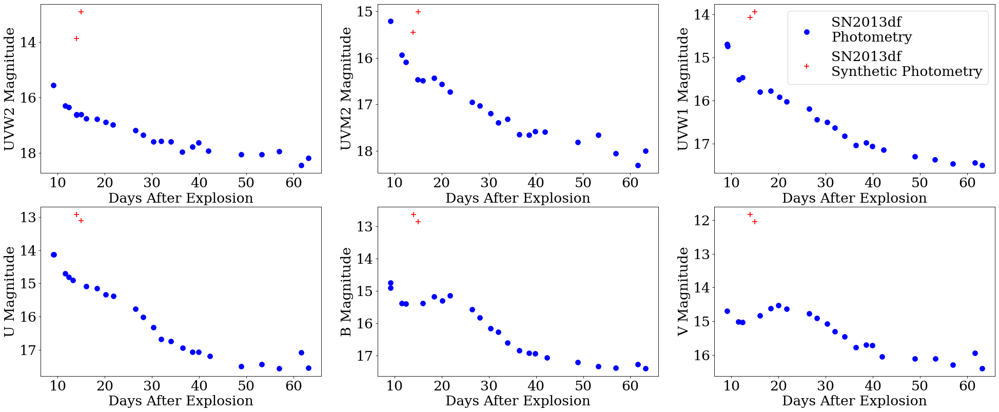

In [115]:
SN13df_obsdata = [SN13df_14_o,SN13df_15_o]

# # turning spectra into magnitudes for SN13df obs
SN13df_o_mag = []
for sp in range(len(SN13df_obsdata)):
    SN13df_o_mag.append(specphot_filters(SN13df_obsdata[sp]))
SN13df_o_mag = np.array(SN13df_o_mag)
SN13df_o_shape = (len(SN13df_obsdata),6)
SN13df_o_mag = SN13df_o_mag.reshape(SN13df_o_shape)
SN13df_o_mag = np.matrix(SN13df_o_mag)

SN13df_o_magerr = []
for sp in range(len(SN13df_obsdata)):
    SN13df_o_magerr.append(specphoterr_filters(SN13df_obsdata[sp]))
SN13df_o_magerr = np.array(SN13df_o_magerr)
SN13df_o_magerr = SN13df_o_magerr.reshape(SN13df_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN13df_o_date = [14,15]
SN13df_o_date = np.array(SN13df_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN13df_o_data = np.c_[SN13df_o_mag,SN13df_o_date]

# import dat file to dataframe
SN13df_phot_d = pd.read_csv(SN2013df_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN13df_phot_time_w2, SN13df_phot_w2, SN13df_phot_mag_w2 = create_lc(SN13df_phot_d, 'UVW2')
SN13df_phot_time_m2, SN13df_phot_m2, SN13df_phot_mag_m2 = create_lc(SN13df_phot_d, 'UVM2')
SN13df_phot_time_w1, SN13df_phot_w1, SN13df_phot_mag_w1 = create_lc(SN13df_phot_d, 'UVW1')
SN13df_phot_time_u, SN13df_phot_u, SN13df_phot_mag_u = create_lc(SN13df_phot_d, 'U')
SN13df_phot_time_b, SN13df_phot_b, SN13df_phot_mag_b = create_lc(SN13df_phot_d, 'B')
SN13df_phot_time_v, SN13df_phot_v, SN13df_phot_mag_v = create_lc(SN13df_phot_d, 'V')

mjdexplosion = 56447.3

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2013df',fontsize=font,y=0.92)
axs[0,0].scatter(SN13df_phot_time_w2-mjdexplosion,SN13df_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN13df_o_data[:,6].tolist(),SN13df_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN13df_phot_time_m2-mjdexplosion,SN13df_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN13df_o_data[:,6].tolist(),SN13df_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN13df_phot_time_w1-mjdexplosion,SN13df_phot_mag_w1,marker='o',s=75,color='blue',label='SN2013df \nPhotometry')
axs[0,2].scatter(SN13df_o_data[:,6].tolist(),SN13df_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2013df \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN13df_phot_time_u-mjdexplosion,SN13df_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN13df_o_data[:,6].tolist(),SN13df_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN13df_phot_time_b-mjdexplosion,SN13df_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN13df_o_data[:,6].tolist(),SN13df_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN13df_phot_time_v-mjdexplosion,SN13df_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN13df_o_data[:,6].tolist(),SN13df_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2013df_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19a3'>SN2016gkg</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-5-a967b78e086f>:53: RuntimeWarning: invalid value encountered in log10
  mag_array[x] = -2.5*np.log10(counts_array[x])+zeropoints[x] ### Calculated magnitudes
<ipython-input-6-

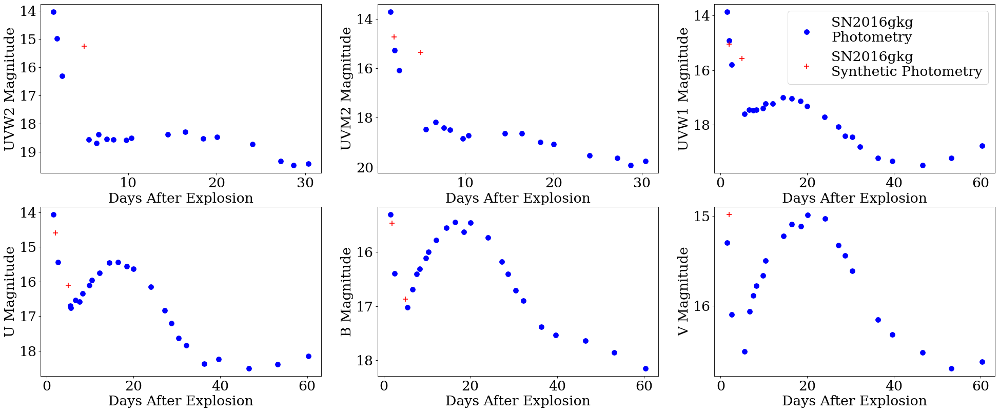

In [116]:
SN16gkg_obsdata = [SN16gkg_2_o,SN16gkg_5_o]

# # turning spectra into magnitudes for SN16gkg obs
SN16gkg_o_mag = []
for sp in range(len(SN16gkg_obsdata)):
    SN16gkg_o_mag.append(specphot_filters(SN16gkg_obsdata[sp]))
SN16gkg_o_mag = np.array(SN16gkg_o_mag)
SN16gkg_o_shape = (len(SN16gkg_obsdata),6)
SN16gkg_o_mag = SN16gkg_o_mag.reshape(SN16gkg_o_shape)
SN16gkg_o_mag = np.matrix(SN16gkg_o_mag)

SN16gkg_o_magerr = []
for sp in range(len(SN16gkg_obsdata)):
    SN16gkg_o_magerr.append(specphoterr_filters(SN16gkg_obsdata[sp]))
SN16gkg_o_magerr = np.array(SN16gkg_o_magerr)
SN16gkg_o_magerr = SN16gkg_o_magerr.reshape(SN16gkg_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN16gkg_o_date = [2,5]
SN16gkg_o_date = np.array(SN16gkg_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN16gkg_o_data = np.c_[SN16gkg_o_mag,SN16gkg_o_date]

# import dat file to dataframe
SN16gkg_phot_d = pd.read_csv(SN2016gkg_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN16gkg_phot_time_w2, SN16gkg_phot_w2, SN16gkg_phot_mag_w2 = create_lc(SN16gkg_phot_d, 'UVW2')
SN16gkg_phot_time_m2, SN16gkg_phot_m2, SN16gkg_phot_mag_m2 = create_lc(SN16gkg_phot_d, 'UVM2')
SN16gkg_phot_time_w1, SN16gkg_phot_w1, SN16gkg_phot_mag_w1 = create_lc(SN16gkg_phot_d, 'UVW1')
SN16gkg_phot_time_u, SN16gkg_phot_u, SN16gkg_phot_mag_u = create_lc(SN16gkg_phot_d, 'U')
SN16gkg_phot_time_b, SN16gkg_phot_b, SN16gkg_phot_mag_b = create_lc(SN16gkg_phot_d, 'B')
SN16gkg_phot_time_v, SN16gkg_phot_v, SN16gkg_phot_mag_v = create_lc(SN16gkg_phot_d, 'V')

mjdexplosion = 	57651.1902

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2016gkg',fontsize=font,y=0.92)
axs[0,0].scatter(SN16gkg_phot_time_w2-mjdexplosion,SN16gkg_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN16gkg_o_data[:,6].tolist(),SN16gkg_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN16gkg_phot_time_m2-mjdexplosion,SN16gkg_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN16gkg_o_data[:,6].tolist(),SN16gkg_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN16gkg_phot_time_w1-mjdexplosion,SN16gkg_phot_mag_w1,marker='o',s=75,color='blue',label='SN2016gkg \nPhotometry')
axs[0,2].scatter(SN16gkg_o_data[:,6].tolist(),SN16gkg_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2016gkg \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN16gkg_phot_time_u-mjdexplosion,SN16gkg_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN16gkg_o_data[:,6].tolist(),SN16gkg_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN16gkg_phot_time_b-mjdexplosion,SN16gkg_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN16gkg_o_data[:,6].tolist(),SN16gkg_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN16gkg_phot_time_v-mjdexplosion,SN16gkg_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN16gkg_o_data[:,6].tolist(),SN16gkg_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
# forcing last 2 figures to do integers on y axis because it was inconsistent
axs[1,1].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,2].yaxis.set_major_locator(MaxNLocator(integer=True))
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2016gkg_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

## <a id='19b'>Type IIns</a> 
[Table of Contents](#0)

### <a id='19b1'>SN2007pk</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

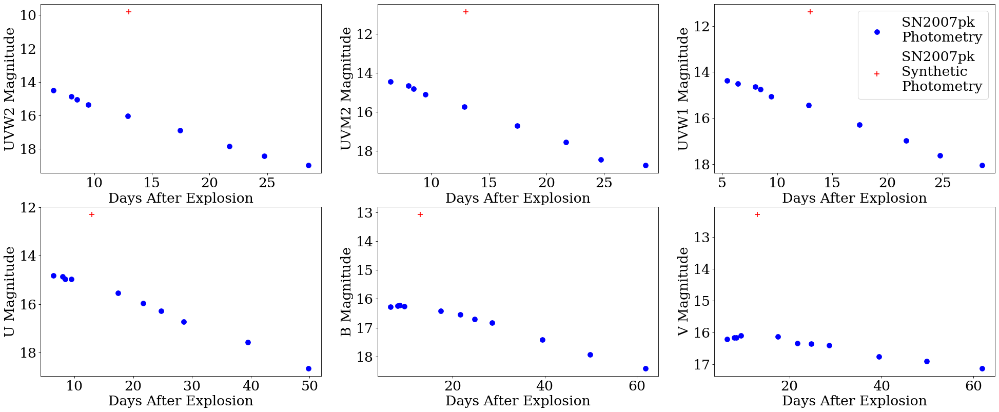

In [117]:
SN07pk_obsdata = [SN07pk_13_o]

# # turning spectra into magnitudes for SN07pk obs
SN07pk_o_mag = []
for sp in range(len(SN07pk_obsdata)):
    SN07pk_o_mag.append(specphot_filters(SN07pk_obsdata[sp]))
SN07pk_o_mag = np.array(SN07pk_o_mag)
SN07pk_o_shape = (len(SN07pk_obsdata),6)
SN07pk_o_mag = SN07pk_o_mag.reshape(SN07pk_o_shape)
SN07pk_o_mag = np.matrix(SN07pk_o_mag)

SN07pk_o_magerr = []
for sp in range(len(SN07pk_obsdata)):
    SN07pk_o_magerr.append(specphoterr_filters(SN07pk_obsdata[sp]))
SN07pk_o_magerr = np.array(SN07pk_o_magerr)
SN07pk_o_magerr = SN07pk_o_magerr.reshape(SN07pk_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN07pk_o_date = [13]
SN07pk_o_date = np.array(SN07pk_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN07pk_o_data = np.c_[SN07pk_o_mag,SN07pk_o_date]

# import dat file to dataframe
SN07pk_phot_d = pd.read_csv(SN2007pk_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN07pk_phot_time_w2, SN07pk_phot_w2, SN07pk_phot_mag_w2 = create_lc(SN07pk_phot_d, 'UVW2')
SN07pk_phot_time_m2, SN07pk_phot_m2, SN07pk_phot_mag_m2 = create_lc(SN07pk_phot_d, 'UVM2')
SN07pk_phot_time_w1, SN07pk_phot_w1, SN07pk_phot_mag_w1 = create_lc(SN07pk_phot_d, 'UVW1')
SN07pk_phot_time_u, SN07pk_phot_u, SN07pk_phot_mag_u = create_lc(SN07pk_phot_d, 'U')
SN07pk_phot_time_b, SN07pk_phot_b, SN07pk_phot_mag_b = create_lc(SN07pk_phot_d, 'B')
SN07pk_phot_time_v, SN07pk_phot_v, SN07pk_phot_mag_v = create_lc(SN07pk_phot_d, 'V')

mjdexplosion = 54411.7

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2007pk',fontsize=font,y=0.92)
axs[0,0].scatter(SN07pk_phot_time_w2-mjdexplosion,SN07pk_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN07pk_o_data[:,6].tolist(),SN07pk_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN07pk_phot_time_m2-mjdexplosion,SN07pk_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN07pk_o_data[:,6].tolist(),SN07pk_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN07pk_phot_time_w1-mjdexplosion,SN07pk_phot_mag_w1,marker='o',s=75,color='blue',label='SN2007pk \nPhotometry')
axs[0,2].scatter(SN07pk_o_data[:,6].tolist(),SN07pk_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2007pk \nSynthetic \nPhotometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN07pk_phot_time_u-mjdexplosion,SN07pk_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN07pk_o_data[:,6].tolist(),SN07pk_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN07pk_phot_time_b-mjdexplosion,SN07pk_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN07pk_o_data[:,6].tolist(),SN07pk_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN07pk_phot_time_v-mjdexplosion,SN07pk_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN07pk_o_data[:,6].tolist(),SN07pk_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2007pk_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19b2'>SN2010jl</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

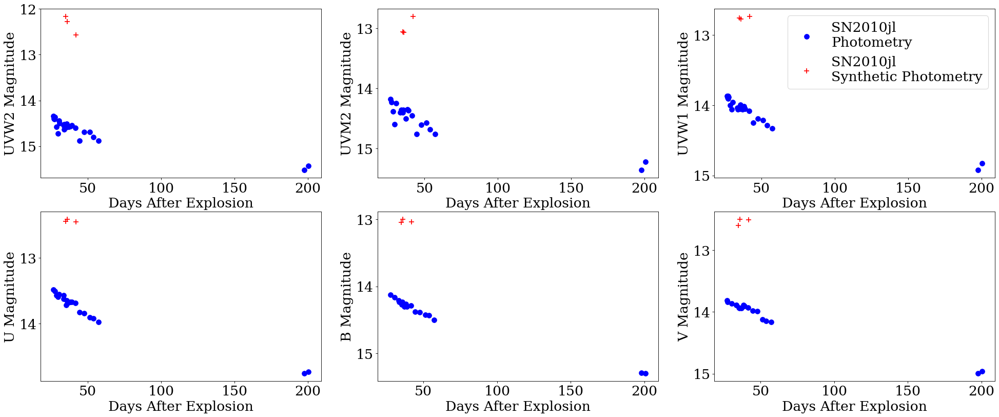

In [118]:
SN10jl_obsdata = [SN10jl_35_o,SN10jl_36_o,SN10jl_42_o]

# # turning spectra into magnitudes for SN10jl obs
SN10jl_o_mag = []
for sp in range(len(SN10jl_obsdata)):
    SN10jl_o_mag.append(specphot_filters(SN10jl_obsdata[sp]))
SN10jl_o_mag = np.array(SN10jl_o_mag)
SN10jl_o_shape = (len(SN10jl_obsdata),6)
SN10jl_o_mag = SN10jl_o_mag.reshape(SN10jl_o_shape)
SN10jl_o_mag = np.matrix(SN10jl_o_mag)

SN10jl_o_magerr = []
for sp in range(len(SN10jl_obsdata)):
    SN10jl_o_magerr.append(specphoterr_filters(SN10jl_obsdata[sp]))
SN10jl_o_magerr = np.array(SN10jl_o_magerr)
SN10jl_o_magerr = SN10jl_o_magerr.reshape(SN10jl_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN10jl_o_date = [35,36,42]
SN10jl_o_date = np.array(SN10jl_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN10jl_o_data = np.c_[SN10jl_o_mag,SN10jl_o_date]

# import dat file to dataframe
SN10jl_phot_d = pd.read_csv(SN2010jl_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN10jl_phot_time_w2, SN10jl_phot_w2, SN10jl_phot_mag_w2 = create_lc(SN10jl_phot_d, 'UVW2')
SN10jl_phot_time_m2, SN10jl_phot_m2, SN10jl_phot_mag_m2 = create_lc(SN10jl_phot_d, 'UVM2')
SN10jl_phot_time_w1, SN10jl_phot_w1, SN10jl_phot_mag_w1 = create_lc(SN10jl_phot_d, 'UVW1')
SN10jl_phot_time_u, SN10jl_phot_u, SN10jl_phot_mag_u = create_lc(SN10jl_phot_d, 'U')
SN10jl_phot_time_b, SN10jl_phot_b, SN10jl_phot_mag_b = create_lc(SN10jl_phot_d, 'B')
SN10jl_phot_time_v, SN10jl_phot_v, SN10jl_phot_mag_v = create_lc(SN10jl_phot_d, 'V')

mjdexplosion = 55478.5

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2010jl',fontsize=font,y=0.92)
axs[0,0].scatter(SN10jl_phot_time_w2-mjdexplosion,SN10jl_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN10jl_o_data[:,6].tolist(),SN10jl_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN10jl_phot_time_m2-mjdexplosion,SN10jl_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN10jl_o_data[:,6].tolist(),SN10jl_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN10jl_phot_time_w1-mjdexplosion,SN10jl_phot_mag_w1,marker='o',s=75,color='blue',label='SN2010jl \nPhotometry')
axs[0,2].scatter(SN10jl_o_data[:,6].tolist(),SN10jl_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2010jl \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN10jl_phot_time_u-mjdexplosion,SN10jl_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN10jl_o_data[:,6].tolist(),SN10jl_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN10jl_phot_time_b-mjdexplosion,SN10jl_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN10jl_o_data[:,6].tolist(),SN10jl_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN10jl_phot_time_v-mjdexplosion,SN10jl_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN10jl_o_data[:,6].tolist(),SN10jl_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
# forcing last 5 figures to do integers on y axis because it was inconsistent
axs[0,1].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[0,2].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,0].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,1].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,2].yaxis.set_major_locator(MaxNLocator(integer=True))
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2010jl_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19b3'>SN2011ht</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

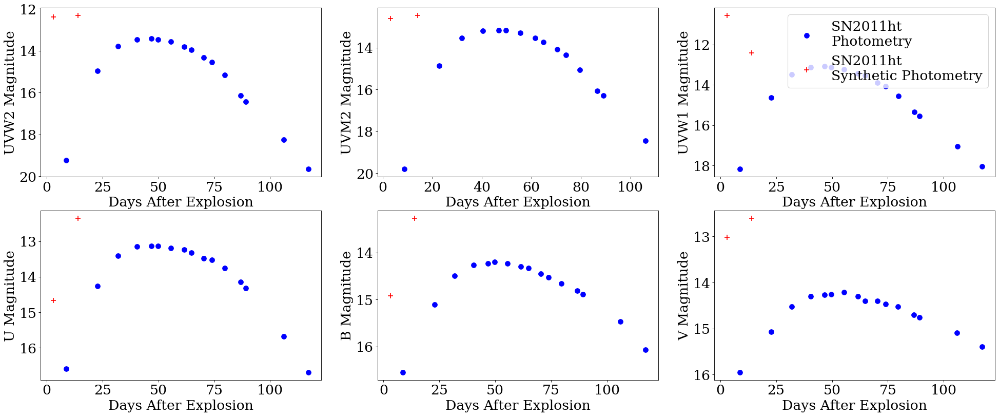

In [119]:
SN11ht_obsdata = [SN11ht_3_o,SN11ht_14_o]

# # turning spectra into magnitudes for SN11ht obs
SN11ht_o_mag = []
for sp in range(len(SN11ht_obsdata)):
    SN11ht_o_mag.append(specphot_filters(SN11ht_obsdata[sp]))
SN11ht_o_mag = np.array(SN11ht_o_mag)
SN11ht_o_shape = (len(SN11ht_obsdata),6)
SN11ht_o_mag = SN11ht_o_mag.reshape(SN11ht_o_shape)
SN11ht_o_mag = np.matrix(SN11ht_o_mag)

SN11ht_o_magerr = []
for sp in range(len(SN11ht_obsdata)):
    SN11ht_o_magerr.append(specphoterr_filters(SN11ht_obsdata[sp]))
SN11ht_o_magerr = np.array(SN11ht_o_magerr)
SN11ht_o_magerr = SN11ht_o_magerr.reshape(SN11ht_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN11ht_o_date = [3,14]
SN11ht_o_date = np.array(SN11ht_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN11ht_o_data = np.c_[SN11ht_o_mag,SN11ht_o_date]

# import dat file to dataframe
SN11ht_phot_d = pd.read_csv(SN2011ht_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN11ht_phot_time_w2, SN11ht_phot_w2, SN11ht_phot_mag_w2 = create_lc(SN11ht_phot_d, 'UVW2')
SN11ht_phot_time_m2, SN11ht_phot_m2, SN11ht_phot_mag_m2 = create_lc(SN11ht_phot_d, 'UVM2')
SN11ht_phot_time_w1, SN11ht_phot_w1, SN11ht_phot_mag_w1 = create_lc(SN11ht_phot_d, 'UVW1')
SN11ht_phot_time_u, SN11ht_phot_u, SN11ht_phot_mag_u = create_lc(SN11ht_phot_d, 'U')
SN11ht_phot_time_b, SN11ht_phot_b, SN11ht_phot_mag_b = create_lc(SN11ht_phot_d, 'B')
SN11ht_phot_time_v, SN11ht_phot_v, SN11ht_phot_mag_v = create_lc(SN11ht_phot_d, 'V')

mjdexplosion = 55833

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2011ht',fontsize=font,y=0.92)
axs[0,0].scatter(SN11ht_phot_time_w2-mjdexplosion,SN11ht_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN11ht_o_data[:,6].tolist(),SN11ht_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN11ht_phot_time_m2-mjdexplosion,SN11ht_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN11ht_o_data[:,6].tolist(),SN11ht_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN11ht_phot_time_w1-mjdexplosion,SN11ht_phot_mag_w1,marker='o',s=75,color='blue',label='SN2011ht \nPhotometry')
axs[0,2].scatter(SN11ht_o_data[:,6].tolist(),SN11ht_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2011ht \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN11ht_phot_time_u-mjdexplosion,SN11ht_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN11ht_o_data[:,6].tolist(),SN11ht_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN11ht_phot_time_b-mjdexplosion,SN11ht_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN11ht_o_data[:,6].tolist(),SN11ht_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN11ht_phot_time_v-mjdexplosion,SN11ht_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN11ht_o_data[:,6].tolist(),SN11ht_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2011ht_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19b4'>SN2013L</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

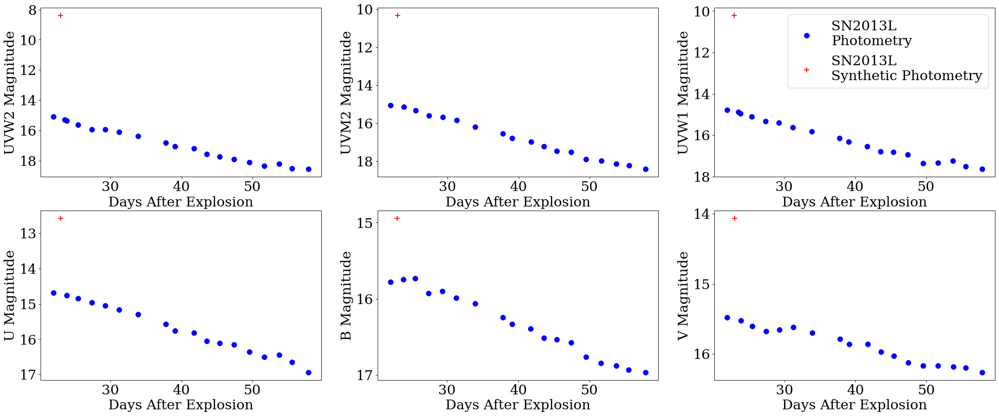

In [120]:
SN13L_obsdata = [SN13L_23_o]

# # turning spectra into magnitudes for SN13L obs
SN13L_o_mag = []
for sp in range(len(SN13L_obsdata)):
    SN13L_o_mag.append(specphot_filters(SN13L_obsdata[sp]))
SN13L_o_mag = np.array(SN13L_o_mag)
SN13L_o_shape = (len(SN13L_obsdata),6)
SN13L_o_mag = SN13L_o_mag.reshape(SN13L_o_shape)
SN13L_o_mag = np.matrix(SN13L_o_mag)

SN13L_o_magerr = []
for sp in range(len(SN13L_obsdata)):
    SN13L_o_magerr.append(specphoterr_filters(SN13L_obsdata[sp]))
SN13L_o_magerr = np.array(SN13L_o_magerr)
SN13L_o_magerr = SN13L_o_magerr.reshape(SN13L_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN13L_o_date = [23]
SN13L_o_date = np.array(SN13L_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN13L_o_data = np.c_[SN13L_o_mag,SN13L_o_date]

# import dat file to dataframe
SN13L_phot_d = pd.read_csv(SN2013L_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN13L_phot_time_w2, SN13L_phot_w2, SN13L_phot_mag_w2 = create_lc(SN13L_phot_d, 'UVW2')
SN13L_phot_time_m2, SN13L_phot_m2, SN13L_phot_mag_m2 = create_lc(SN13L_phot_d, 'UVM2')
SN13L_phot_time_w1, SN13L_phot_w1, SN13L_phot_mag_w1 = create_lc(SN13L_phot_d, 'UVW1')
SN13L_phot_time_u, SN13L_phot_u, SN13L_phot_mag_u = create_lc(SN13L_phot_d, 'U')
SN13L_phot_time_b, SN13L_phot_b, SN13L_phot_mag_b = create_lc(SN13L_phot_d, 'B')
SN13L_phot_time_v, SN13L_phot_v, SN13L_phot_mag_v = create_lc(SN13L_phot_d, 'V')

mjdexplosion = 56299

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2013L',fontsize=font,y=0.92)
axs[0,0].scatter(SN13L_phot_time_w2-mjdexplosion,SN13L_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN13L_o_data[:,6].tolist(),SN13L_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN13L_phot_time_m2-mjdexplosion,SN13L_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN13L_o_data[:,6].tolist(),SN13L_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN13L_phot_time_w1-mjdexplosion,SN13L_phot_mag_w1,marker='o',s=75,color='blue',label='SN2013L \nPhotometry')
axs[0,2].scatter(SN13L_o_data[:,6].tolist(),SN13L_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2013L \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN13L_phot_time_u-mjdexplosion,SN13L_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN13L_o_data[:,6].tolist(),SN13L_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN13L_phot_time_b-mjdexplosion,SN13L_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN13L_o_data[:,6].tolist(),SN13L_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN13L_phot_time_v-mjdexplosion,SN13L_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN13L_o_data[:,6].tolist(),SN13L_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
# forcing last 2 figures to do integers on y axis because it was inconsistent
axs[1,1].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,2].yaxis.set_major_locator(MaxNLocator(integer=True))
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2013L_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19b5'>SN2015bf</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-5-a967b78e086f>:53: RuntimeWarning: invalid value encountered in log10
  mag_array[x] = -2.5*np.log10(counts_array[x])+zeropoints[x] ### Calculated magnitudes
<ipython-input-6-

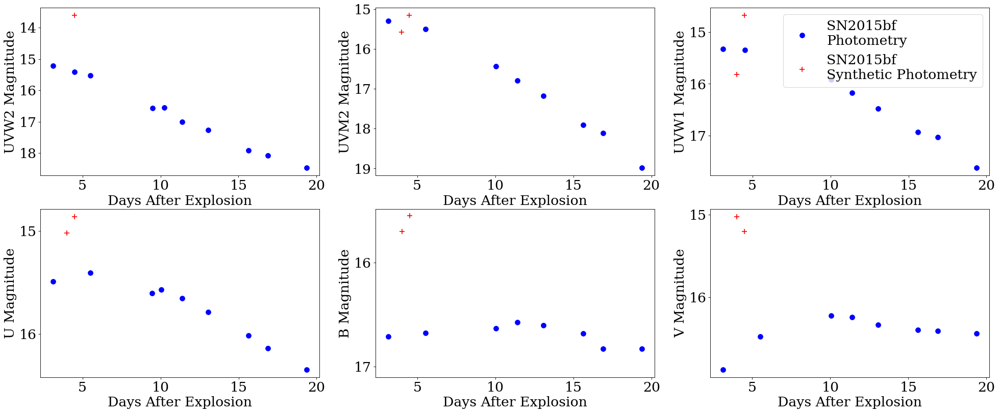

In [121]:
SN15bf_obsdata = [SN15bf_4_o,SN15bf_4half_o]

# # turning spectra into magnitudes for SN15bf obs
SN15bf_o_mag = []
for sp in range(len(SN15bf_obsdata)):
    SN15bf_o_mag.append(specphot_filters(SN15bf_obsdata[sp]))
SN15bf_o_mag = np.array(SN15bf_o_mag)
SN15bf_o_shape = (len(SN15bf_obsdata),6)
SN15bf_o_mag = SN15bf_o_mag.reshape(SN15bf_o_shape)
SN15bf_o_mag = np.matrix(SN15bf_o_mag)

SN15bf_o_magerr = []
for sp in range(len(SN15bf_obsdata)):
    SN15bf_o_magerr.append(specphoterr_filters(SN15bf_obsdata[sp]))
SN15bf_o_magerr = np.array(SN15bf_o_magerr)
SN15bf_o_magerr = SN15bf_o_magerr.reshape(SN15bf_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN15bf_o_date = [4,4.5]
SN15bf_o_date = np.array(SN15bf_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN15bf_o_data = np.c_[SN15bf_o_mag,SN15bf_o_date]

# import dat file to dataframe
SN15bf_phot_d = pd.read_csv(SN2015bf_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN15bf_phot_time_w2, SN15bf_phot_w2, SN15bf_phot_mag_w2 = create_lc(SN15bf_phot_d, 'UVW2')
SN15bf_phot_time_m2, SN15bf_phot_m2, SN15bf_phot_mag_m2 = create_lc(SN15bf_phot_d, 'UVM2')
SN15bf_phot_time_w1, SN15bf_phot_w1, SN15bf_phot_mag_w1 = create_lc(SN15bf_phot_d, 'UVW1')
SN15bf_phot_time_u, SN15bf_phot_u, SN15bf_phot_mag_u = create_lc(SN15bf_phot_d, 'U')
SN15bf_phot_time_b, SN15bf_phot_b, SN15bf_phot_mag_b = create_lc(SN15bf_phot_d, 'B')
SN15bf_phot_time_v, SN15bf_phot_v, SN15bf_phot_mag_v = create_lc(SN15bf_phot_d, 'V')

mjdexplosion = 57367.2

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2015bf',fontsize=font,y=0.92)
axs[0,0].scatter(SN15bf_phot_time_w2-mjdexplosion,SN15bf_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN15bf_o_data[:,6].tolist(),SN15bf_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN15bf_phot_time_m2-mjdexplosion,SN15bf_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN15bf_o_data[:,6].tolist(),SN15bf_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN15bf_phot_time_w1-mjdexplosion,SN15bf_phot_mag_w1,marker='o',s=75,color='blue',label='SN2015bf \nPhotometry')
axs[0,2].scatter(SN15bf_o_data[:,6].tolist(),SN15bf_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2015bf \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN15bf_phot_time_u-mjdexplosion,SN15bf_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN15bf_o_data[:,6].tolist(),SN15bf_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN15bf_phot_time_b-mjdexplosion,SN15bf_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN15bf_o_data[:,6].tolist(),SN15bf_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN15bf_phot_time_v-mjdexplosion,SN15bf_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN15bf_o_data[:,6].tolist(),SN15bf_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
# forcing last 4 figures to do integers on y axis because it was inconsistent
axs[0,2].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,0].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,1].set_ylim(bottom=17.1,top=None) #had to include so more than one tick would exist otherwise it messes up, and integer=True, min_n_ticks=1 didn't look good
axs[1,1].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,2].yaxis.set_major_locator(MaxNLocator(integer=True))
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2015bf_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19b6'>SN2016cvk</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

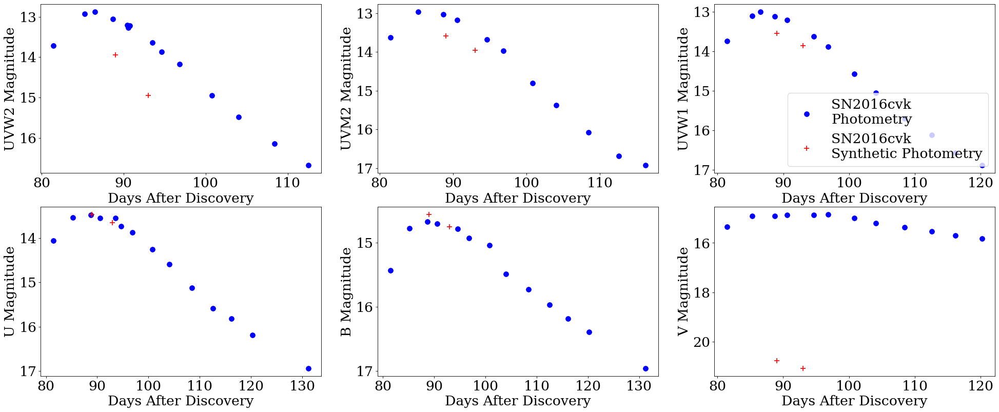

In [122]:
SN16cvk_obsdata = [SN16cvk_89d_o,SN16cvk_93d_o]

# # turning spectra into magnitudes for SN16cvk obs
SN16cvk_o_mag = []
for sp in range(len(SN16cvk_obsdata)):
    SN16cvk_o_mag.append(specphot_filters(SN16cvk_obsdata[sp]))
SN16cvk_o_mag = np.array(SN16cvk_o_mag)
SN16cvk_o_shape = (len(SN16cvk_obsdata),6)
SN16cvk_o_mag = SN16cvk_o_mag.reshape(SN16cvk_o_shape)
SN16cvk_o_mag = np.matrix(SN16cvk_o_mag)

SN16cvk_o_magerr = []
for sp in range(len(SN16cvk_obsdata)):
    SN16cvk_o_magerr.append(specphoterr_filters(SN16cvk_obsdata[sp]))
SN16cvk_o_magerr = np.array(SN16cvk_o_magerr)
SN16cvk_o_magerr = SN16cvk_o_magerr.reshape(SN16cvk_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN16cvk_o_date = [89,93]
SN16cvk_o_date = np.array(SN16cvk_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN16cvk_o_data = np.c_[SN16cvk_o_mag,SN16cvk_o_date]

# import dat file to dataframe
SN16cvk_phot_d = pd.read_csv(SN2016cvk_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN16cvk_phot_time_w2, SN16cvk_phot_w2, SN16cvk_phot_mag_w2 = create_lc(SN16cvk_phot_d, 'UVW2')
SN16cvk_phot_time_m2, SN16cvk_phot_m2, SN16cvk_phot_mag_m2 = create_lc(SN16cvk_phot_d, 'UVM2')
SN16cvk_phot_time_w1, SN16cvk_phot_w1, SN16cvk_phot_mag_w1 = create_lc(SN16cvk_phot_d, 'UVW1')
SN16cvk_phot_time_u, SN16cvk_phot_u, SN16cvk_phot_mag_u = create_lc(SN16cvk_phot_d, 'U')
SN16cvk_phot_time_b, SN16cvk_phot_b, SN16cvk_phot_mag_b = create_lc(SN16cvk_phot_d, 'B')
SN16cvk_phot_time_v, SN16cvk_phot_v, SN16cvk_phot_mag_v = create_lc(SN16cvk_phot_d, 'V')

mjdexplosion = 57551

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2016cvk',fontsize=font,y=0.92)
axs[0,0].scatter(SN16cvk_phot_time_w2-mjdexplosion,SN16cvk_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN16cvk_o_data[:,6].tolist(),SN16cvk_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN16cvk_phot_time_m2-mjdexplosion,SN16cvk_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN16cvk_o_data[:,6].tolist(),SN16cvk_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN16cvk_phot_time_w1-mjdexplosion,SN16cvk_phot_mag_w1,marker='o',s=75,color='blue',label='SN2016cvk \nPhotometry')
axs[0,2].scatter(SN16cvk_o_data[:,6].tolist(),SN16cvk_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2016cvk \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=4,fontsize=font)
axs[1,0].scatter(SN16cvk_phot_time_u-mjdexplosion,SN16cvk_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN16cvk_o_data[:,6].tolist(),SN16cvk_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN16cvk_phot_time_b-mjdexplosion,SN16cvk_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN16cvk_o_data[:,6].tolist(),SN16cvk_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN16cvk_phot_time_v-mjdexplosion,SN16cvk_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN16cvk_o_data[:,6].tolist(),SN16cvk_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Discovery',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Discovery',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Discovery',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Discovery',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Discovery',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Discovery',ylabel='V Magnitude')
# forcing 2nd to last figure to do integers on y axis because it was inconsistent
axs[1,1].yaxis.set_major_locator(MaxNLocator(integer=True))
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2016cvk_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

## <a id='19c'>Type IIP/Ls</a> 
[Table of Contents](#0)

### <a id='19c1'>SN2005cs</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

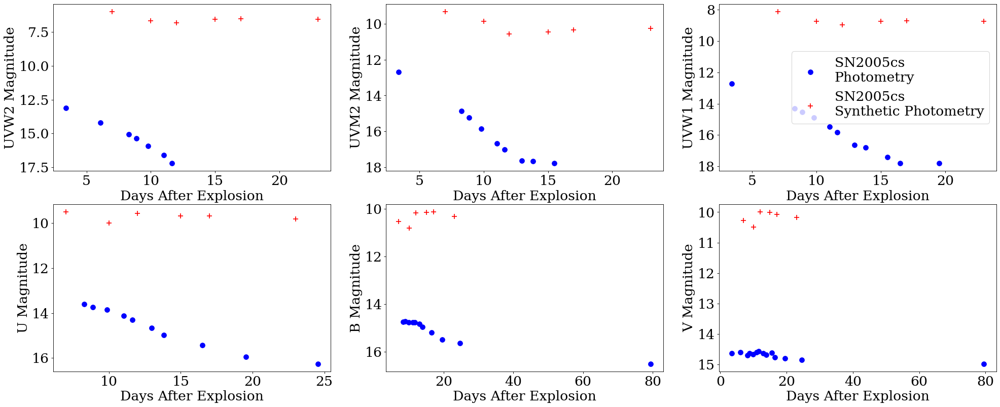

In [123]:
SN05cs_obsdata = [SN05cs_7_o,SN05cs_10_o,SN05cs_12_o,SN05cs_15_o,SN05cs_17_o,SN05cs_23_o]

# # turning spectra into magnitudes for SN05cs obs
SN05cs_o_mag = []
for sp in range(len(SN05cs_obsdata)):
    SN05cs_o_mag.append(specphot_filters(SN05cs_obsdata[sp]))
SN05cs_o_mag = np.array(SN05cs_o_mag)
SN05cs_o_shape = (len(SN05cs_obsdata),6)
SN05cs_o_mag = SN05cs_o_mag.reshape(SN05cs_o_shape)
SN05cs_o_mag = np.matrix(SN05cs_o_mag)

SN05cs_o_magerr = []
for sp in range(len(SN05cs_obsdata)):
    SN05cs_o_magerr.append(specphoterr_filters(SN05cs_obsdata[sp]))
SN05cs_o_magerr = np.array(SN05cs_o_magerr)
SN05cs_o_magerr = SN05cs_o_magerr.reshape(SN05cs_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN05cs_o_date = [7,10,12,15,17,23]
SN05cs_o_date = np.array(SN05cs_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN05cs_o_data = np.c_[SN05cs_o_mag,SN05cs_o_date]

# import dat file to dataframe
SN05cs_phot_d = pd.read_csv(SN2005cs_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN05cs_phot_time_w2, SN05cs_phot_w2, SN05cs_phot_mag_w2 = create_lc(SN05cs_phot_d, 'UVW2')
SN05cs_phot_time_m2, SN05cs_phot_m2, SN05cs_phot_mag_m2 = create_lc(SN05cs_phot_d, 'UVM2')
SN05cs_phot_time_w1, SN05cs_phot_w1, SN05cs_phot_mag_w1 = create_lc(SN05cs_phot_d, 'UVW1')
SN05cs_phot_time_u, SN05cs_phot_u, SN05cs_phot_mag_u = create_lc(SN05cs_phot_d, 'U')
SN05cs_phot_time_b, SN05cs_phot_b, SN05cs_phot_mag_b = create_lc(SN05cs_phot_d, 'B')
SN05cs_phot_time_v, SN05cs_phot_v, SN05cs_phot_mag_v = create_lc(SN05cs_phot_d, 'V')

mjdexplosion = 53548.5

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2005cs',fontsize=font,y=0.92)
axs[0,0].scatter(SN05cs_phot_time_w2-mjdexplosion,SN05cs_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN05cs_o_data[:,6].tolist(),SN05cs_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN05cs_phot_time_m2-mjdexplosion,SN05cs_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN05cs_o_data[:,6].tolist(),SN05cs_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN05cs_phot_time_w1-mjdexplosion,SN05cs_phot_mag_w1,marker='o',s=75,color='blue',label='SN2005cs \nPhotometry')
axs[0,2].scatter(SN05cs_o_data[:,6].tolist(),SN05cs_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2005cs \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=7,fontsize=font)
axs[1,0].scatter(SN05cs_phot_time_u-mjdexplosion,SN05cs_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN05cs_o_data[:,6].tolist(),SN05cs_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN05cs_phot_time_b-mjdexplosion,SN05cs_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN05cs_o_data[:,6].tolist(),SN05cs_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN05cs_phot_time_v-mjdexplosion,SN05cs_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN05cs_o_data[:,6].tolist(),SN05cs_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2005cs_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19c2'>SN2006bp</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-5-a967b78e086f>:53: RuntimeWarning: invalid value encountered in log10
  mag_array[x] = -2.5*np.log10(counts_array[x])+zeropoints[x] ### Calculated magnitudes
<ipython-input-6-

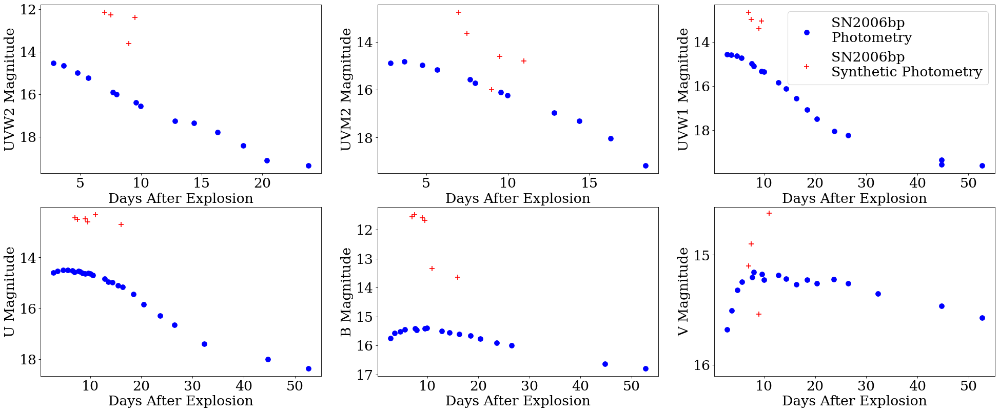

In [124]:
SN06bp_obsdata = [SN06bp_7_o,SN06bp_7half_o,SN06bp_9_o,SN06bp_9half_o,SN06bp_11_o,SN06bp_16_o]

# # turning spectra into magnitudes for SN06bp obs
SN06bp_o_mag = []
for sp in range(len(SN06bp_obsdata)):
    SN06bp_o_mag.append(specphot_filters(SN06bp_obsdata[sp]))
SN06bp_o_mag = np.array(SN06bp_o_mag)
SN06bp_o_shape = (len(SN06bp_obsdata),6)
SN06bp_o_mag = SN06bp_o_mag.reshape(SN06bp_o_shape)
SN06bp_o_mag = np.matrix(SN06bp_o_mag)

SN06bp_o_magerr = []
for sp in range(len(SN06bp_obsdata)):
    SN06bp_o_magerr.append(specphoterr_filters(SN06bp_obsdata[sp]))
SN06bp_o_magerr = np.array(SN06bp_o_magerr)
SN06bp_o_magerr = SN06bp_o_magerr.reshape(SN06bp_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN06bp_o_date = [7,7.5,9,9.5,11,16]
SN06bp_o_date = np.array(SN06bp_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN06bp_o_data = np.c_[SN06bp_o_mag,SN06bp_o_date]

# import dat file to dataframe
SN06bp_phot_d = pd.read_csv(SN2006bp_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN06bp_phot_time_w2, SN06bp_phot_w2, SN06bp_phot_mag_w2 = create_lc(SN06bp_phot_d, 'UVW2')
SN06bp_phot_time_m2, SN06bp_phot_m2, SN06bp_phot_mag_m2 = create_lc(SN06bp_phot_d, 'UVM2')
SN06bp_phot_time_w1, SN06bp_phot_w1, SN06bp_phot_mag_w1 = create_lc(SN06bp_phot_d, 'UVW1')
SN06bp_phot_time_u, SN06bp_phot_u, SN06bp_phot_mag_u = create_lc(SN06bp_phot_d, 'U')
SN06bp_phot_time_b, SN06bp_phot_b, SN06bp_phot_mag_b = create_lc(SN06bp_phot_d, 'B')
SN06bp_phot_time_v, SN06bp_phot_v, SN06bp_phot_mag_v = create_lc(SN06bp_phot_d, 'V')

mjdexplosion = 53832.8

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2006bp',fontsize=font,y=0.92)
axs[0,0].scatter(SN06bp_phot_time_w2-mjdexplosion,SN06bp_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN06bp_o_data[:,6].tolist(),SN06bp_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN06bp_phot_time_m2-mjdexplosion,SN06bp_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN06bp_o_data[:,6].tolist(),SN06bp_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN06bp_phot_time_w1-mjdexplosion,SN06bp_phot_mag_w1,marker='o',s=75,color='blue',label='SN2006bp \nPhotometry')
axs[0,2].scatter(SN06bp_o_data[:,6].tolist(),SN06bp_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2006bp \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN06bp_phot_time_u-mjdexplosion,SN06bp_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN06bp_o_data[:,6].tolist(),SN06bp_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN06bp_phot_time_b-mjdexplosion,SN06bp_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN06bp_o_data[:,6].tolist(),SN06bp_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN06bp_phot_time_v-mjdexplosion,SN06bp_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN06bp_o_data[:,6].tolist(),SN06bp_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
# forcing last figure to do integers on y axis because it was inconsistent
axs[1,2].set_ylim(bottom=16.1,top=None) #had to include so more than one tick would exist otherwise it messes up, and integer=True, min_n_ticks=1 didn't look good
axs[1,2].yaxis.set_major_locator(MaxNLocator(integer=True))
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2006bp_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19c3'>SN2007od</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

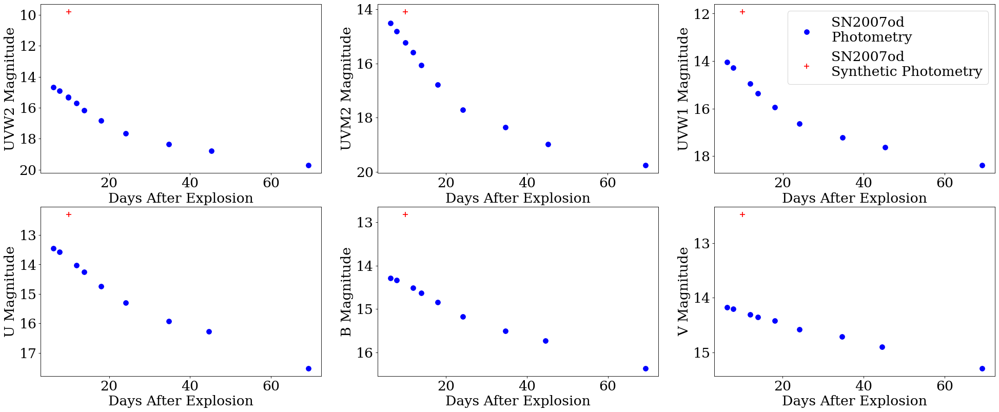

In [125]:
SN07od_obsdata = [SN07od_10_o]

# # turning spectra into magnitudes for SN07od obs
SN07od_o_mag = []
for sp in range(len(SN07od_obsdata)):
    SN07od_o_mag.append(specphot_filters(SN07od_obsdata[sp]))
SN07od_o_mag = np.array(SN07od_o_mag)
SN07od_o_shape = (len(SN07od_obsdata),6)
SN07od_o_mag = SN07od_o_mag.reshape(SN07od_o_shape)
SN07od_o_mag = np.matrix(SN07od_o_mag)

SN07od_o_magerr = []
for sp in range(len(SN07od_obsdata)):
    SN07od_o_magerr.append(specphoterr_filters(SN07od_obsdata[sp]))
SN07od_o_magerr = np.array(SN07od_o_magerr)
SN07od_o_magerr = SN07od_o_magerr.reshape(SN07od_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN07od_o_date = [10]
SN07od_o_date = np.array(SN07od_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN07od_o_data = np.c_[SN07od_o_mag,SN07od_o_date]

# import dat file to dataframe
SN07od_phot_d = pd.read_csv(SN2007od_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN07od_phot_time_w2, SN07od_phot_w2, SN07od_phot_mag_w2 = create_lc(SN07od_phot_d, 'UVW2')
SN07od_phot_time_m2, SN07od_phot_m2, SN07od_phot_mag_m2 = create_lc(SN07od_phot_d, 'UVM2')
SN07od_phot_time_w1, SN07od_phot_w1, SN07od_phot_mag_w1 = create_lc(SN07od_phot_d, 'UVW1')
SN07od_phot_time_u, SN07od_phot_u, SN07od_phot_mag_u = create_lc(SN07od_phot_d, 'U')
SN07od_phot_time_b, SN07od_phot_b, SN07od_phot_mag_b = create_lc(SN07od_phot_d, 'B')
SN07od_phot_time_v, SN07od_phot_v, SN07od_phot_mag_v = create_lc(SN07od_phot_d, 'V')

mjdexplosion = 54403.5

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2007od',fontsize=font,y=0.92)
axs[0,0].scatter(SN07od_phot_time_w2-mjdexplosion,SN07od_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN07od_o_data[:,6].tolist(),SN07od_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN07od_phot_time_m2-mjdexplosion,SN07od_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN07od_o_data[:,6].tolist(),SN07od_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN07od_phot_time_w1-mjdexplosion,SN07od_phot_mag_w1,marker='o',s=75,color='blue',label='SN2007od \nPhotometry')
axs[0,2].scatter(SN07od_o_data[:,6].tolist(),SN07od_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2007od \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN07od_phot_time_u-mjdexplosion,SN07od_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN07od_o_data[:,6].tolist(),SN07od_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN07od_phot_time_b-mjdexplosion,SN07od_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN07od_o_data[:,6].tolist(),SN07od_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN07od_phot_time_v-mjdexplosion,SN07od_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN07od_o_data[:,6].tolist(),SN07od_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
# forcing last figure to do integers on y axis because it was inconsistent
axs[1,2].yaxis.set_major_locator(MaxNLocator(integer=True))
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2007od_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19c4'>SN2008aw</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-5-a967b78e086f>:53: RuntimeWarning: invalid value encountered in log10
  mag_array[x] = -2.5*np.log10(counts_array[x])+zeropoints[x] ### Calculated magnitudes
<ipython-input-6-

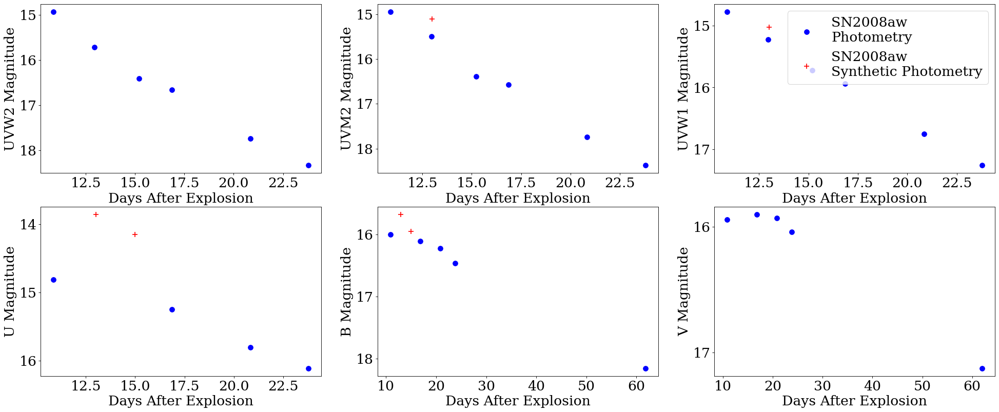

In [126]:
SN08aw_obsdata = [SN08aw_13_o,SN08aw_15_o]

# # turning spectra into magnitudes for SN08aw obs
SN08aw_o_mag = []
for sp in range(len(SN08aw_obsdata)):
    SN08aw_o_mag.append(specphot_filters(SN08aw_obsdata[sp]))
SN08aw_o_mag = np.array(SN08aw_o_mag)
SN08aw_o_shape = (len(SN08aw_obsdata),6)
SN08aw_o_mag = SN08aw_o_mag.reshape(SN08aw_o_shape)
SN08aw_o_mag = np.matrix(SN08aw_o_mag)

SN08aw_o_magerr = []
for sp in range(len(SN08aw_obsdata)):
    SN08aw_o_magerr.append(specphoterr_filters(SN08aw_obsdata[sp]))
SN08aw_o_magerr = np.array(SN08aw_o_magerr)
SN08aw_o_magerr = SN08aw_o_magerr.reshape(SN08aw_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN08aw_o_date = [13,15]
SN08aw_o_date = np.array(SN08aw_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN08aw_o_data = np.c_[SN08aw_o_mag,SN08aw_o_date]

# import dat file to dataframe
SN08aw_phot_d = pd.read_csv(SN2008aw_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN08aw_phot_time_w2, SN08aw_phot_w2, SN08aw_phot_mag_w2 = create_lc(SN08aw_phot_d, 'UVW2')
SN08aw_phot_time_m2, SN08aw_phot_m2, SN08aw_phot_mag_m2 = create_lc(SN08aw_phot_d, 'UVM2')
SN08aw_phot_time_w1, SN08aw_phot_w1, SN08aw_phot_mag_w1 = create_lc(SN08aw_phot_d, 'UVW1')
SN08aw_phot_time_u, SN08aw_phot_u, SN08aw_phot_mag_u = create_lc(SN08aw_phot_d, 'U')
SN08aw_phot_time_b, SN08aw_phot_b, SN08aw_phot_mag_b = create_lc(SN08aw_phot_d, 'B')
SN08aw_phot_time_v, SN08aw_phot_v, SN08aw_phot_mag_v = create_lc(SN08aw_phot_d, 'V')

mjdexplosion = 54517.8

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2008aw',fontsize=font,y=0.92)
axs[0,0].scatter(SN08aw_phot_time_w2-mjdexplosion,SN08aw_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN08aw_o_data[:,6].tolist(),SN08aw_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN08aw_phot_time_m2-mjdexplosion,SN08aw_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN08aw_o_data[:,6].tolist(),SN08aw_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN08aw_phot_time_w1-mjdexplosion,SN08aw_phot_mag_w1,marker='o',s=75,color='blue',label='SN2008aw \nPhotometry')
axs[0,2].scatter(SN08aw_o_data[:,6].tolist(),SN08aw_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2008aw \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN08aw_phot_time_u-mjdexplosion,SN08aw_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN08aw_o_data[:,6].tolist(),SN08aw_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN08aw_phot_time_b-mjdexplosion,SN08aw_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN08aw_o_data[:,6].tolist(),SN08aw_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN08aw_phot_time_v-mjdexplosion,SN08aw_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN08aw_o_data[:,6].tolist(),SN08aw_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
# forcing last 4 figures to do integers on y axis because it was inconsistent
axs[0,2].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,0].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,1].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,2].yaxis.set_major_locator(MaxNLocator(integer=True))
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2008aw_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19c5'>SN2008M</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

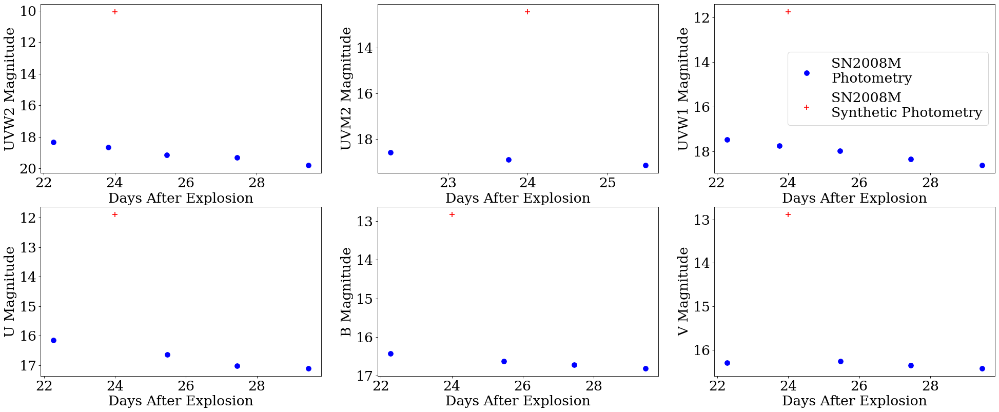

In [127]:
SN08M_obsdata = [SN08M_24_o]

# # turning spectra into magnitudes for SN08M obs
SN08M_o_mag = []
for sp in range(len(SN08M_obsdata)):
    SN08M_o_mag.append(specphot_filters(SN08M_obsdata[sp]))
SN08M_o_mag = np.array(SN08M_o_mag)
SN08M_o_shape = (len(SN08M_obsdata),6)
SN08M_o_mag = SN08M_o_mag.reshape(SN08M_o_shape)
SN08M_o_mag = np.matrix(SN08M_o_mag)

SN08M_o_magerr = []
for sp in range(len(SN08M_obsdata)):
    SN08M_o_magerr.append(specphoterr_filters(SN08M_obsdata[sp]))
SN08M_o_magerr = np.array(SN08M_o_magerr)
SN08M_o_magerr = SN08M_o_magerr.reshape(SN08M_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN08M_o_date = [24]
SN08M_o_date = np.array(SN08M_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN08M_o_data = np.c_[SN08M_o_mag,SN08M_o_date]

# import dat file to dataframe
SN08M_phot_d = pd.read_csv(SN2008M_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN08M_phot_time_w2, SN08M_phot_w2, SN08M_phot_mag_w2 = create_lc(SN08M_phot_d, 'UVW2')
SN08M_phot_time_m2, SN08M_phot_m2, SN08M_phot_mag_m2 = create_lc(SN08M_phot_d, 'UVM2')
SN08M_phot_time_w1, SN08M_phot_w1, SN08M_phot_mag_w1 = create_lc(SN08M_phot_d, 'UVW1')
SN08M_phot_time_u, SN08M_phot_u, SN08M_phot_mag_u = create_lc(SN08M_phot_d, 'U')
SN08M_phot_time_b, SN08M_phot_b, SN08M_phot_mag_b = create_lc(SN08M_phot_d, 'B')
SN08M_phot_time_v, SN08M_phot_v, SN08M_phot_mag_v = create_lc(SN08M_phot_d, 'V')

mjdexplosion = 54471.7

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2008M',fontsize=font,y=0.92)
axs[0,0].scatter(SN08M_phot_time_w2-mjdexplosion,SN08M_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN08M_o_data[:,6].tolist(),SN08M_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN08M_phot_time_m2-mjdexplosion,SN08M_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN08M_o_data[:,6].tolist(),SN08M_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN08M_phot_time_w1-mjdexplosion,SN08M_phot_mag_w1,marker='o',s=75,color='blue',label='SN2008M \nPhotometry')
axs[0,2].scatter(SN08M_o_data[:,6].tolist(),SN08M_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2008M \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=7,fontsize=font)
axs[1,0].scatter(SN08M_phot_time_u-mjdexplosion,SN08M_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN08M_o_data[:,6].tolist(),SN08M_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN08M_phot_time_b-mjdexplosion,SN08M_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN08M_o_data[:,6].tolist(),SN08M_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN08M_phot_time_v-mjdexplosion,SN08M_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN08M_o_data[:,6].tolist(),SN08M_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2008M_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19c6'>SN2012aw</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-5-a967b78e086f>:53: RuntimeWarning: invalid value encountered in log10
  mag_array[x] = -2.5*np.log10(counts_array[x])+zeropoints[x] ### Calculated magnitudes
<ipython-input-6-

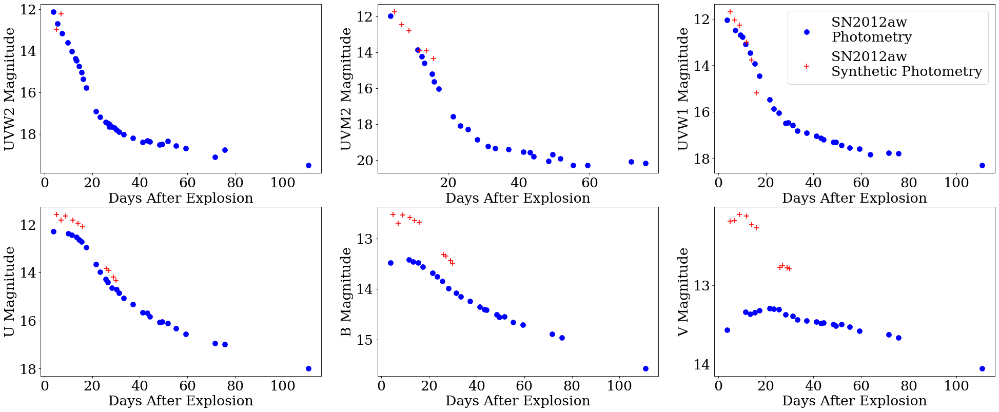

In [128]:
SN12aw_obsdata = [SN12aw_5_o,SN12aw_7_o,SN12aw_9_o,SN12aw_12_o,
                  SN12aw_14_o,SN12aw_16_o,SN12aw_26_o,SN12aw_27_o,
                  SN12aw_29_o,SN12aw_30_o]

# # turning spectra into magnitudes for SN12aw obs
SN12aw_o_mag = []
for sp in range(len(SN12aw_obsdata)):
    SN12aw_o_mag.append(specphot_filters(SN12aw_obsdata[sp]))
SN12aw_o_mag = np.array(SN12aw_o_mag)
SN12aw_o_shape = (len(SN12aw_obsdata),6)
SN12aw_o_mag = SN12aw_o_mag.reshape(SN12aw_o_shape)
SN12aw_o_mag = np.matrix(SN12aw_o_mag)

SN12aw_o_magerr = []
for sp in range(len(SN12aw_obsdata)):
    SN12aw_o_magerr.append(specphoterr_filters(SN12aw_obsdata[sp]))
SN12aw_o_magerr = np.array(SN12aw_o_magerr)
SN12aw_o_magerr = SN12aw_o_magerr.reshape(SN12aw_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN12aw_o_date = [5,7,9,12,14,16,26,27,29,30]
SN12aw_o_date = np.array(SN12aw_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN12aw_o_data = np.c_[SN12aw_o_mag,SN12aw_o_date]

# import dat file to dataframe
SN12aw_phot_d = pd.read_csv(SN2012aw_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN12aw_phot_time_w2, SN12aw_phot_w2, SN12aw_phot_mag_w2 = create_lc(SN12aw_phot_d, 'UVW2')
SN12aw_phot_time_m2, SN12aw_phot_m2, SN12aw_phot_mag_m2 = create_lc(SN12aw_phot_d, 'UVM2')
SN12aw_phot_time_w1, SN12aw_phot_w1, SN12aw_phot_mag_w1 = create_lc(SN12aw_phot_d, 'UVW1')
SN12aw_phot_time_u, SN12aw_phot_u, SN12aw_phot_mag_u = create_lc(SN12aw_phot_d, 'U')
SN12aw_phot_time_b, SN12aw_phot_b, SN12aw_phot_mag_b = create_lc(SN12aw_phot_d, 'B')
SN12aw_phot_time_v, SN12aw_phot_v, SN12aw_phot_mag_v = create_lc(SN12aw_phot_d, 'V')

mjdexplosion = 56002

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2012aw',fontsize=font,y=0.92)
axs[0,0].scatter(SN12aw_phot_time_w2-mjdexplosion,SN12aw_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN12aw_o_data[:,6].tolist(),SN12aw_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN12aw_phot_time_m2-mjdexplosion,SN12aw_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN12aw_o_data[:,6].tolist(),SN12aw_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN12aw_phot_time_w1-mjdexplosion,SN12aw_phot_mag_w1,marker='o',s=75,color='blue',label='SN2012aw \nPhotometry')
axs[0,2].scatter(SN12aw_o_data[:,6].tolist(),SN12aw_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2012aw \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN12aw_phot_time_u-mjdexplosion,SN12aw_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN12aw_o_data[:,6].tolist(),SN12aw_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN12aw_phot_time_b-mjdexplosion,SN12aw_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN12aw_o_data[:,6].tolist(),SN12aw_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN12aw_phot_time_v-mjdexplosion,SN12aw_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN12aw_o_data[:,6].tolist(),SN12aw_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
# forcing last 2 figures to do integers on y axis because it was inconsistent
axs[1,1].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,2].yaxis.set_major_locator(MaxNLocator(integer=True))
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2012aw_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19c7'>SN2013ab</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

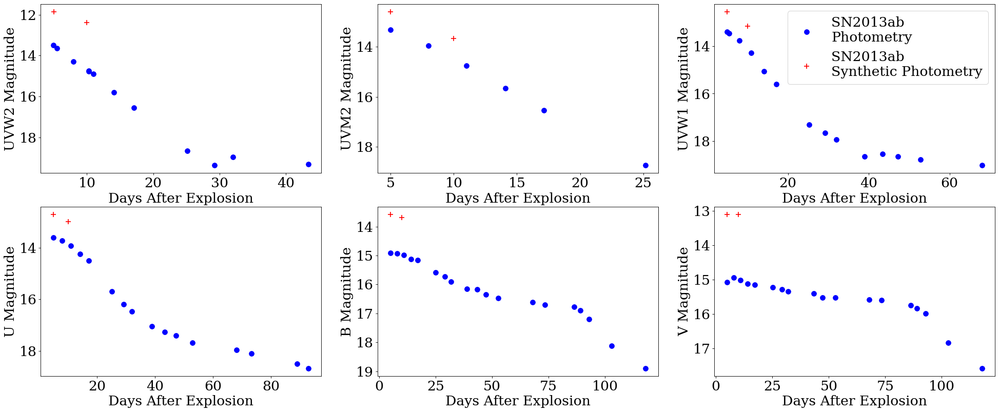

In [129]:
SN13ab_obsdata = [SN13ab_5_o,SN13ab_10_o]

# # turning spectra into magnitudes for SN13ab obs
SN13ab_o_mag = []
for sp in range(len(SN13ab_obsdata)):
    SN13ab_o_mag.append(specphot_filters(SN13ab_obsdata[sp]))
SN13ab_o_mag = np.array(SN13ab_o_mag)
SN13ab_o_shape = (len(SN13ab_obsdata),6)
SN13ab_o_mag = SN13ab_o_mag.reshape(SN13ab_o_shape)
SN13ab_o_mag = np.matrix(SN13ab_o_mag)

SN13ab_o_magerr = []
for sp in range(len(SN13ab_obsdata)):
    SN13ab_o_magerr.append(specphoterr_filters(SN13ab_obsdata[sp]))
SN13ab_o_magerr = np.array(SN13ab_o_magerr)
SN13ab_o_magerr = SN13ab_o_magerr.reshape(SN13ab_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN13ab_o_date = [5,10]
SN13ab_o_date = np.array(SN13ab_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN13ab_o_data = np.c_[SN13ab_o_mag,SN13ab_o_date]

# import dat file to dataframe
SN13ab_phot_d = pd.read_csv(SN2013ab_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN13ab_phot_time_w2, SN13ab_phot_w2, SN13ab_phot_mag_w2 = create_lc(SN13ab_phot_d, 'UVW2')
SN13ab_phot_time_m2, SN13ab_phot_m2, SN13ab_phot_mag_m2 = create_lc(SN13ab_phot_d, 'UVM2')
SN13ab_phot_time_w1, SN13ab_phot_w1, SN13ab_phot_mag_w1 = create_lc(SN13ab_phot_d, 'UVW1')
SN13ab_phot_time_u, SN13ab_phot_u, SN13ab_phot_mag_u = create_lc(SN13ab_phot_d, 'U')
SN13ab_phot_time_b, SN13ab_phot_b, SN13ab_phot_mag_b = create_lc(SN13ab_phot_d, 'B')
SN13ab_phot_time_v, SN13ab_phot_v, SN13ab_phot_mag_v = create_lc(SN13ab_phot_d, 'V')

mjdexplosion = 56339.5

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2013ab',fontsize=font,y=0.92)
axs[0,0].scatter(SN13ab_phot_time_w2-mjdexplosion,SN13ab_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN13ab_o_data[:,6].tolist(),SN13ab_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN13ab_phot_time_m2-mjdexplosion,SN13ab_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN13ab_o_data[:,6].tolist(),SN13ab_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN13ab_phot_time_w1-mjdexplosion,SN13ab_phot_mag_w1,marker='o',s=75,color='blue',label='SN2013ab \nPhotometry')
axs[0,2].scatter(SN13ab_o_data[:,6].tolist(),SN13ab_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2013ab \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN13ab_phot_time_u-mjdexplosion,SN13ab_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN13ab_o_data[:,6].tolist(),SN13ab_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN13ab_phot_time_b-mjdexplosion,SN13ab_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN13ab_o_data[:,6].tolist(),SN13ab_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN13ab_phot_time_v-mjdexplosion,SN13ab_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN13ab_o_data[:,6].tolist(),SN13ab_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2013ab_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19c8'>SN2013ej</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

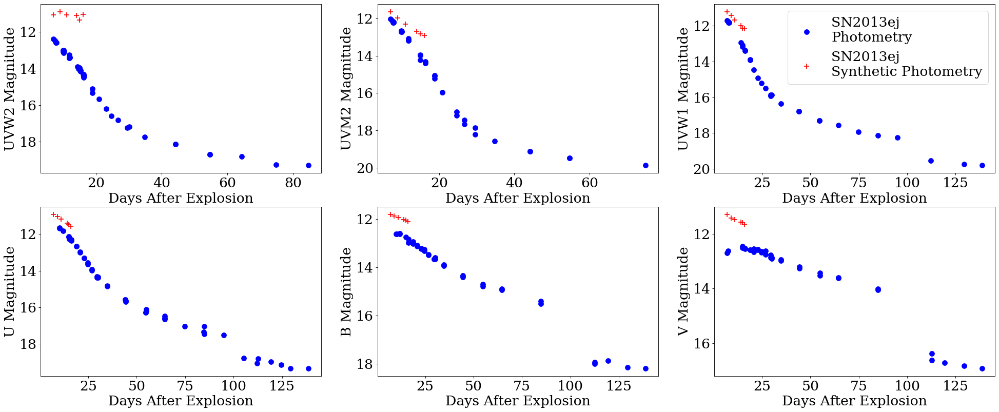

In [130]:
SN13ej_obsdata = [SN13ej_7_o,SN13ej_9_o,SN13ej_11_o,SN13ej_14_o,
                  SN13ej_15_o,SN13ej_16_o]

# # turning spectra into magnitudes for SN13ej obs
SN13ej_o_mag = []
for sp in range(len(SN13ej_obsdata)):
    SN13ej_o_mag.append(specphot_filters(SN13ej_obsdata[sp]))
SN13ej_o_mag = np.array(SN13ej_o_mag)
SN13ej_o_shape = (len(SN13ej_obsdata),6)
SN13ej_o_mag = SN13ej_o_mag.reshape(SN13ej_o_shape)
SN13ej_o_mag = np.matrix(SN13ej_o_mag)

SN13ej_o_magerr = []
for sp in range(len(SN13ej_obsdata)):
    SN13ej_o_magerr.append(specphoterr_filters(SN13ej_obsdata[sp]))
SN13ej_o_magerr = np.array(SN13ej_o_magerr)
SN13ej_o_magerr = SN13ej_o_magerr.reshape(SN13ej_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN13ej_o_date = [7,9,11,14,15,16]
SN13ej_o_date = np.array(SN13ej_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN13ej_o_data = np.c_[SN13ej_o_mag,SN13ej_o_date]

# import dat file to dataframe
SN13ej_phot_d = pd.read_csv(SN2013ej_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN13ej_phot_time_w2, SN13ej_phot_w2, SN13ej_phot_mag_w2 = create_lc(SN13ej_phot_d, 'UVW2')
SN13ej_phot_time_m2, SN13ej_phot_m2, SN13ej_phot_mag_m2 = create_lc(SN13ej_phot_d, 'UVM2')
SN13ej_phot_time_w1, SN13ej_phot_w1, SN13ej_phot_mag_w1 = create_lc(SN13ej_phot_d, 'UVW1')
SN13ej_phot_time_u, SN13ej_phot_u, SN13ej_phot_mag_u = create_lc(SN13ej_phot_d, 'U')
SN13ej_phot_time_b, SN13ej_phot_b, SN13ej_phot_mag_b = create_lc(SN13ej_phot_d, 'B')
SN13ej_phot_time_v, SN13ej_phot_v, SN13ej_phot_mag_v = create_lc(SN13ej_phot_d, 'V')

mjdexplosion = 56497

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2013ej',fontsize=font,y=0.92)
axs[0,0].scatter(SN13ej_phot_time_w2-mjdexplosion,SN13ej_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN13ej_o_data[:,6].tolist(),SN13ej_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN13ej_phot_time_m2-mjdexplosion,SN13ej_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN13ej_o_data[:,6].tolist(),SN13ej_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN13ej_phot_time_w1-mjdexplosion,SN13ej_phot_mag_w1,marker='o',s=75,color='blue',label='SN2013ej \nPhotometry')
axs[0,2].scatter(SN13ej_o_data[:,6].tolist(),SN13ej_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2013ej \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN13ej_phot_time_u-mjdexplosion,SN13ej_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN13ej_o_data[:,6].tolist(),SN13ej_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN13ej_phot_time_b-mjdexplosion,SN13ej_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN13ej_o_data[:,6].tolist(),SN13ej_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN13ej_phot_time_v-mjdexplosion,SN13ej_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN13ej_o_data[:,6].tolist(),SN13ej_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2013ej_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19c9'>ASASSN-14ha</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

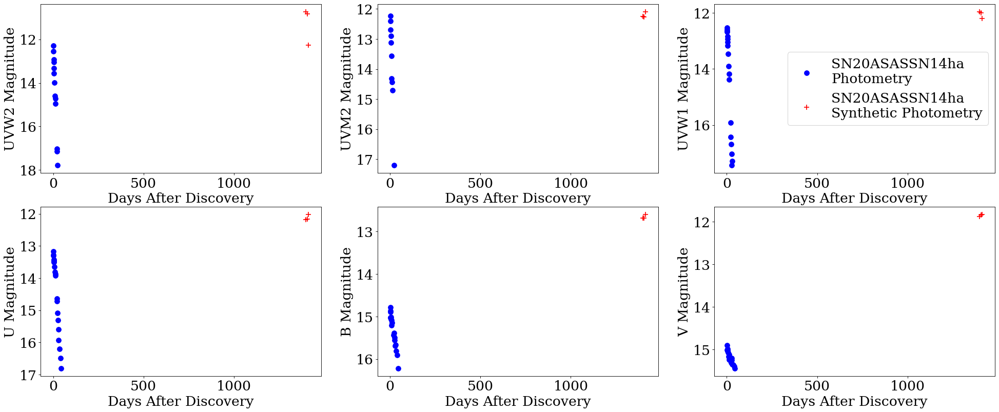

In [131]:
ASASSN14ha_obsdata = [ASASSN14ha_1399d_o,ASASSN14ha_1406d_o,ASASSN14ha_1413d_o]

# # turning spectra into magnitudes for ASASSN14ha obs
ASASSN14ha_o_mag = []
for sp in range(len(ASASSN14ha_obsdata)):
    ASASSN14ha_o_mag.append(specphot_filters(ASASSN14ha_obsdata[sp]))
ASASSN14ha_o_mag = np.array(ASASSN14ha_o_mag)
ASASSN14ha_o_shape = (len(ASASSN14ha_obsdata),6)
ASASSN14ha_o_mag = ASASSN14ha_o_mag.reshape(ASASSN14ha_o_shape)
ASASSN14ha_o_mag = np.matrix(ASASSN14ha_o_mag)

ASASSN14ha_o_magerr = []
for sp in range(len(ASASSN14ha_obsdata)):
    ASASSN14ha_o_magerr.append(specphoterr_filters(ASASSN14ha_obsdata[sp]))
ASASSN14ha_o_magerr = np.array(ASASSN14ha_o_magerr)
ASASSN14ha_o_magerr = ASASSN14ha_o_magerr.reshape(ASASSN14ha_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
ASASSN14ha_o_date = [1399,1406,1413]
ASASSN14ha_o_date = np.array(ASASSN14ha_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
ASASSN14ha_o_data = np.c_[ASASSN14ha_o_mag,ASASSN14ha_o_date]

# import dat file to dataframe
ASASSN14ha_phot_d = pd.read_csv(ASASSN14ha_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
ASASSN14ha_phot_time_w2, ASASSN14ha_phot_w2, ASASSN14ha_phot_mag_w2 = create_lc(ASASSN14ha_phot_d, 'UVW2')
ASASSN14ha_phot_time_m2, ASASSN14ha_phot_m2, ASASSN14ha_phot_mag_m2 = create_lc(ASASSN14ha_phot_d, 'UVM2')
ASASSN14ha_phot_time_w1, ASASSN14ha_phot_w1, ASASSN14ha_phot_mag_w1 = create_lc(ASASSN14ha_phot_d, 'UVW1')
ASASSN14ha_phot_time_u, ASASSN14ha_phot_u, ASASSN14ha_phot_mag_u = create_lc(ASASSN14ha_phot_d, 'U')
ASASSN14ha_phot_time_b, ASASSN14ha_phot_b, ASASSN14ha_phot_mag_b = create_lc(ASASSN14ha_phot_d, 'B')
ASASSN14ha_phot_time_v, ASASSN14ha_phot_v, ASASSN14ha_phot_mag_v = create_lc(ASASSN14ha_phot_d, 'V')

mjdexplosion = 56910.29

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN20ASASSN14ha',fontsize=font,y=0.92)
axs[0,0].scatter(ASASSN14ha_phot_time_w2-mjdexplosion,ASASSN14ha_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(ASASSN14ha_o_data[:,6].tolist(),ASASSN14ha_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(ASASSN14ha_phot_time_m2-mjdexplosion,ASASSN14ha_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(ASASSN14ha_o_data[:,6].tolist(),ASASSN14ha_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(ASASSN14ha_phot_time_w1-mjdexplosion,ASASSN14ha_phot_mag_w1,marker='o',s=75,color='blue',label='SN20ASASSN14ha \nPhotometry')
axs[0,2].scatter(ASASSN14ha_o_data[:,6].tolist(),ASASSN14ha_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN20ASASSN14ha \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=7,fontsize=font)
axs[1,0].scatter(ASASSN14ha_phot_time_u-mjdexplosion,ASASSN14ha_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(ASASSN14ha_o_data[:,6].tolist(),ASASSN14ha_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(ASASSN14ha_phot_time_b-mjdexplosion,ASASSN14ha_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(ASASSN14ha_o_data[:,6].tolist(),ASASSN14ha_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(ASASSN14ha_phot_time_v-mjdexplosion,ASASSN14ha_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(ASASSN14ha_o_data[:,6].tolist(),ASASSN14ha_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Discovery',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Discovery',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Discovery',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Discovery',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Discovery',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Discovery',ylabel='V Magnitude')
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_ASASSN14ha_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19c10'>SN2017eaw</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

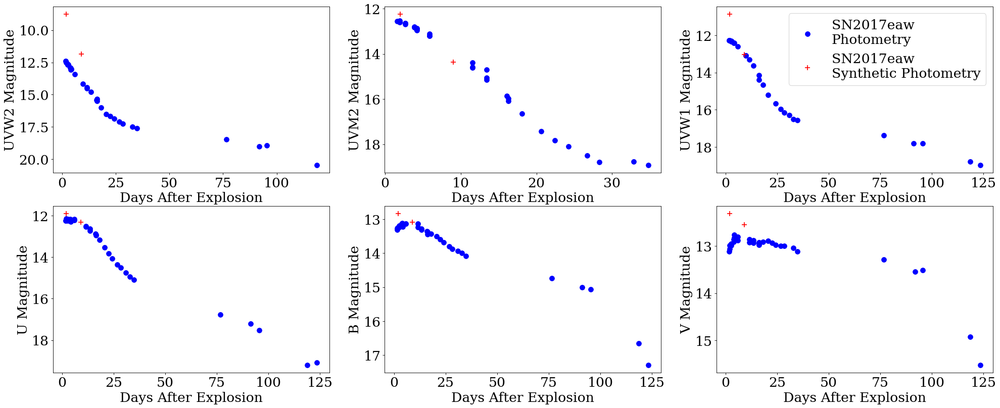

In [133]:
SN17eaw_obsdata = [SN17eaw_2_o,SN17eaw_9_o]

# # turning spectra into magnitudes for SN17eaw obs
SN17eaw_o_mag = []
for sp in range(len(SN17eaw_obsdata)):
    SN17eaw_o_mag.append(specphot_filters(SN17eaw_obsdata[sp]))
SN17eaw_o_mag = np.array(SN17eaw_o_mag)
SN17eaw_o_shape = (len(SN17eaw_obsdata),6)
SN17eaw_o_mag = SN17eaw_o_mag.reshape(SN17eaw_o_shape)
SN17eaw_o_mag = np.matrix(SN17eaw_o_mag)

SN17eaw_o_magerr = []
for sp in range(len(SN17eaw_obsdata)):
    SN17eaw_o_magerr.append(specphoterr_filters(SN17eaw_obsdata[sp]))
SN17eaw_o_magerr = np.array(SN17eaw_o_magerr)
SN17eaw_o_magerr = SN17eaw_o_magerr.reshape(SN17eaw_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN17eaw_o_date = [2,9]
SN17eaw_o_date = np.array(SN17eaw_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN17eaw_o_data = np.c_[SN17eaw_o_mag,SN17eaw_o_date]

# import dat file to dataframe
SN17eaw_phot_d = pd.read_csv(SN2017eaw_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN17eaw_phot_time_w2, SN17eaw_phot_w2, SN17eaw_phot_mag_w2 = create_lc(SN17eaw_phot_d, 'UVW2')
SN17eaw_phot_time_m2, SN17eaw_phot_m2, SN17eaw_phot_mag_m2 = create_lc(SN17eaw_phot_d, 'UVM2')
SN17eaw_phot_time_w1, SN17eaw_phot_w1, SN17eaw_phot_mag_w1 = create_lc(SN17eaw_phot_d, 'UVW1')
SN17eaw_phot_time_u, SN17eaw_phot_u, SN17eaw_phot_mag_u = create_lc(SN17eaw_phot_d, 'U')
SN17eaw_phot_time_b, SN17eaw_phot_b, SN17eaw_phot_mag_b = create_lc(SN17eaw_phot_d, 'B')
SN17eaw_phot_time_v, SN17eaw_phot_v, SN17eaw_phot_mag_v = create_lc(SN17eaw_phot_d, 'V')

mjdexplosion = 57886

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2017eaw',fontsize=font,y=0.92)
axs[0,0].scatter(SN17eaw_phot_time_w2-mjdexplosion,SN17eaw_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN17eaw_o_data[:,6].tolist(),SN17eaw_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN17eaw_phot_time_m2-mjdexplosion,SN17eaw_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN17eaw_o_data[:,6].tolist(),SN17eaw_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN17eaw_phot_time_w1-mjdexplosion,SN17eaw_phot_mag_w1,marker='o',s=75,color='blue',label='SN2017eaw \nPhotometry')
axs[0,2].scatter(SN17eaw_o_data[:,6].tolist(),SN17eaw_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2017eaw \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN17eaw_phot_time_u-mjdexplosion,SN17eaw_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN17eaw_o_data[:,6].tolist(),SN17eaw_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN17eaw_phot_time_b-mjdexplosion,SN17eaw_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN17eaw_o_data[:,6].tolist(),SN17eaw_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN17eaw_phot_time_v-mjdexplosion,SN17eaw_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN17eaw_o_data[:,6].tolist(),SN17eaw_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2017eaw_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

## <a id='19d'>Misc CC SNe</a> 
[Table of Contents](#0)

### <a id='19d1'>SN2006jc: Type Ibn</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

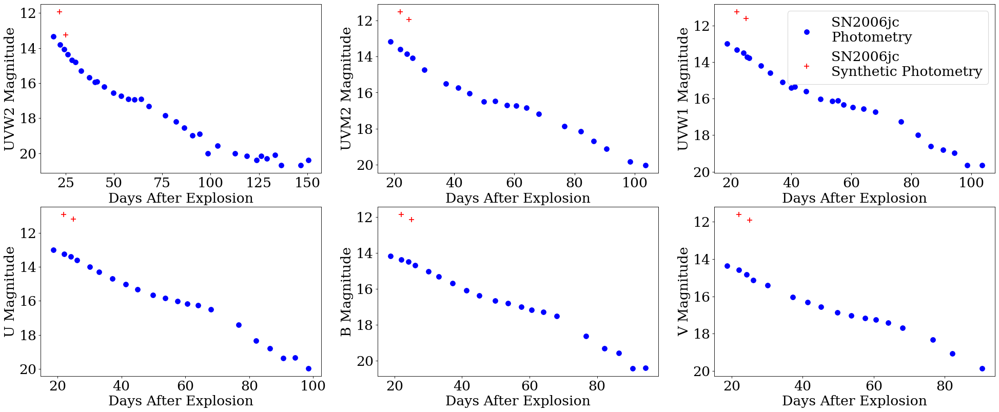

In [134]:
SN06jc_obsdata = [SN06jc_22_o,SN06jc_25_o]

# # turning spectra into magnitudes for SN06jc obs
SN06jc_o_mag = []
for sp in range(len(SN06jc_obsdata)):
    SN06jc_o_mag.append(specphot_filters(SN06jc_obsdata[sp]))
SN06jc_o_mag = np.array(SN06jc_o_mag)
SN06jc_o_shape = (len(SN06jc_obsdata),6)
SN06jc_o_mag = SN06jc_o_mag.reshape(SN06jc_o_shape)
SN06jc_o_mag = np.matrix(SN06jc_o_mag)

SN06jc_o_magerr = []
for sp in range(len(SN06jc_obsdata)):
    SN06jc_o_magerr.append(specphoterr_filters(SN06jc_obsdata[sp]))
SN06jc_o_magerr = np.array(SN06jc_o_magerr)
SN06jc_o_magerr = SN06jc_o_magerr.reshape(SN06jc_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN06jc_o_date = [22,25]
SN06jc_o_date = np.array(SN06jc_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN06jc_o_data = np.c_[SN06jc_o_mag,SN06jc_o_date]

# import dat file to dataframe
SN06jc_phot_d = pd.read_csv(SN2006jc_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN06jc_phot_time_w2, SN06jc_phot_w2, SN06jc_phot_mag_w2 = create_lc(SN06jc_phot_d, 'UVW2')
SN06jc_phot_time_m2, SN06jc_phot_m2, SN06jc_phot_mag_m2 = create_lc(SN06jc_phot_d, 'UVM2')
SN06jc_phot_time_w1, SN06jc_phot_w1, SN06jc_phot_mag_w1 = create_lc(SN06jc_phot_d, 'UVW1')
SN06jc_phot_time_u, SN06jc_phot_u, SN06jc_phot_mag_u = create_lc(SN06jc_phot_d, 'U')
SN06jc_phot_time_b, SN06jc_phot_b, SN06jc_phot_mag_b = create_lc(SN06jc_phot_d, 'B')
SN06jc_phot_time_v, SN06jc_phot_v, SN06jc_phot_mag_v = create_lc(SN06jc_phot_d, 'V')

mjdexplosion = 54003

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2006jc',fontsize=font,y=0.92)
axs[0,0].scatter(SN06jc_phot_time_w2-mjdexplosion,SN06jc_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN06jc_o_data[:,6].tolist(),SN06jc_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN06jc_phot_time_m2-mjdexplosion,SN06jc_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN06jc_o_data[:,6].tolist(),SN06jc_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN06jc_phot_time_w1-mjdexplosion,SN06jc_phot_mag_w1,marker='o',s=75,color='blue',label='SN2006jc \nPhotometry')
axs[0,2].scatter(SN06jc_o_data[:,6].tolist(),SN06jc_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2006jc \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=1,fontsize=font)
axs[1,0].scatter(SN06jc_phot_time_u-mjdexplosion,SN06jc_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN06jc_o_data[:,6].tolist(),SN06jc_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN06jc_phot_time_b-mjdexplosion,SN06jc_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN06jc_o_data[:,6].tolist(),SN06jc_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN06jc_phot_time_v-mjdexplosion,SN06jc_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN06jc_o_data[:,6].tolist(),SN06jc_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2006jc_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

### <a id='19d2'>SN2017egm: Type SLSN-I</a> 
[Table of Contents](#0)

<ipython-input-5-a967b78e086f>:47: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_array = np.array([filter_A[0],filter_A[1],filter_A[2],filter_A[3],filter_A[4],filter_A[5]])
<ipython-input-5-a967b78e086f>:48: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  filter_wave = np.array([filter_WL[0],filter_WL[1],filter_WL[2],filter_WL[3],filter_WL[4],filter_WL[5]])
<ipython-input-6-65b11001ecfb>:45: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths 

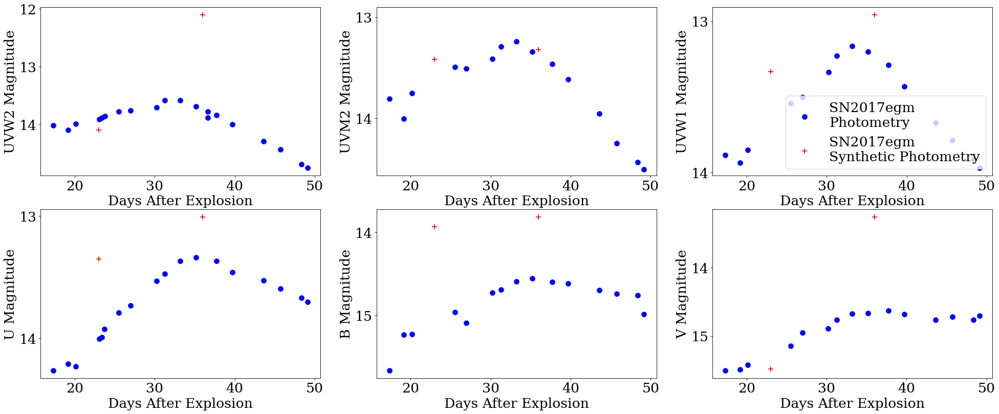

In [135]:
SN17egm_obsdata = [SN17egm_23_o,SN17egm_36_o]

# # turning spectra into magnitudes for SN17egm obs
SN17egm_o_mag = []
for sp in range(len(SN17egm_obsdata)):
    SN17egm_o_mag.append(specphot_filters(SN17egm_obsdata[sp]))
SN17egm_o_mag = np.array(SN17egm_o_mag)
SN17egm_o_shape = (len(SN17egm_obsdata),6)
SN17egm_o_mag = SN17egm_o_mag.reshape(SN17egm_o_shape)
SN17egm_o_mag = np.matrix(SN17egm_o_mag)

SN17egm_o_magerr = []
for sp in range(len(SN17egm_obsdata)):
    SN17egm_o_magerr.append(specphoterr_filters(SN17egm_obsdata[sp]))
SN17egm_o_magerr = np.array(SN17egm_o_magerr)
SN17egm_o_magerr = SN17egm_o_magerr.reshape(SN17egm_o_shape)
############### order of mag is w2,m2,w1,u,b,v

# getting days after explosion
SN17egm_o_date = [23,36]
SN17egm_o_date = np.array(SN17egm_o_date)

############### appending dates to the magnitudes matrix for ease of access for plotting
SN17egm_o_data = np.c_[SN17egm_o_mag,SN17egm_o_date]

# import dat file to dataframe
SN17egm_phot_d = pd.read_csv(SN2017egm_phot, names=names,
                 header=None, delim_whitespace=True,
                 usecols=(0, 1, 2, 3, 10, 11),
                 dtype=types, comment='#')

# putting different filter data into the appropriate arrays
SN17egm_phot_time_w2, SN17egm_phot_w2, SN17egm_phot_mag_w2 = create_lc(SN17egm_phot_d, 'UVW2')
SN17egm_phot_time_m2, SN17egm_phot_m2, SN17egm_phot_mag_m2 = create_lc(SN17egm_phot_d, 'UVM2')
SN17egm_phot_time_w1, SN17egm_phot_w1, SN17egm_phot_mag_w1 = create_lc(SN17egm_phot_d, 'UVW1')
SN17egm_phot_time_u, SN17egm_phot_u, SN17egm_phot_mag_u = create_lc(SN17egm_phot_d, 'U')
SN17egm_phot_time_b, SN17egm_phot_b, SN17egm_phot_mag_b = create_lc(SN17egm_phot_d, 'B')
SN17egm_phot_time_v, SN17egm_phot_v, SN17egm_phot_mag_v = create_lc(SN17egm_phot_d, 'V')

mjdexplosion = 57889

fig = plt.figure(figsize=(30, 12), dpi= 80, facecolor='w', edgecolor='k')
gs = fig.add_gridspec(2, 3)
axs = gs.subplots(sharex=False, sharey=False)
#fig.suptitle('Synthetic Photometry vs. Photometry: SN2017egm',fontsize=font,y=0.92)
axs[0,0].scatter(SN17egm_phot_time_w2-mjdexplosion,SN17egm_phot_mag_w2,marker='o',s=75,color='blue',label='Photometry')
axs[0,0].scatter(SN17egm_o_data[:,6].tolist(),SN17egm_o_data[:,0].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,0].set_title('UVW2',fontsize=font)
axs[0,1].scatter(SN17egm_phot_time_m2-mjdexplosion,SN17egm_phot_mag_m2,marker='o',s=75,color='blue',label='Photometry')
axs[0,1].scatter(SN17egm_o_data[:,6].tolist(),SN17egm_o_data[:,1].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[0,1].set_title('UVM2',fontsize=font)
axs[0,2].scatter(SN17egm_phot_time_w1-mjdexplosion,SN17egm_phot_mag_w1,marker='o',s=75,color='blue',label='SN2017egm \nPhotometry')
axs[0,2].scatter(SN17egm_o_data[:,6].tolist(),SN17egm_o_data[:,2].tolist(),marker='+',s=75,color='red',label='SN2017egm \nSynthetic Photometry')
#axs[0,2].set_title('UVW1',fontsize=font)
axs[0,2].legend(loc=4,fontsize=font)
axs[1,0].scatter(SN17egm_phot_time_u-mjdexplosion,SN17egm_phot_mag_u,marker='o',s=75,color='blue',label='Photometry')
axs[1,0].scatter(SN17egm_o_data[:,6].tolist(),SN17egm_o_data[:,3].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,0].set_title('U',fontsize=font)
axs[1,1].scatter(SN17egm_phot_time_b-mjdexplosion,SN17egm_phot_mag_b,marker='o',s=75,color='blue',label='Photometry')
axs[1,1].scatter(SN17egm_o_data[:,6].tolist(),SN17egm_o_data[:,4].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,1].set_title('B',fontsize=font)
axs[1,2].scatter(SN17egm_phot_time_v-mjdexplosion,SN17egm_phot_mag_v,marker='o',s=75,color='blue',label='Photometry')
axs[1,2].scatter(SN17egm_o_data[:,6].tolist(),SN17egm_o_data[:,5].tolist(),marker='+',s=75,color='red',label='Synthetic Photometry')
#axs[1,2].set_title('V',fontsize=font)
# invert the y axes
axs[0,0].invert_yaxis()
axs[0,1].invert_yaxis()
axs[0,2].invert_yaxis()
axs[1,0].invert_yaxis()
axs[1,1].invert_yaxis()
axs[1,2].invert_yaxis()
# set axes labels
axs[0,0].set(xlabel='Days After Explosion',ylabel='UVW2 Magnitude')
axs[0,1].set(xlabel='Days After Explosion',ylabel='UVM2 Magnitude')
axs[0,2].set(xlabel='Days After Explosion',ylabel='UVW1 Magnitude')
axs[1,0].set(xlabel='Days After Explosion',ylabel='U Magnitude')
axs[1,1].set(xlabel='Days After Explosion',ylabel='B Magnitude')
axs[1,2].set(xlabel='Days After Explosion',ylabel='V Magnitude')
# forcing all figures to do integers on y axis because it was inconsistent
axs[0,0].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[0,1].set_ylim(bottom=None,top=12.9) #had to include so more than one tick would exist otherwise it messes up, and integer=True, min_n_ticks=1 didn't look good
axs[0,1].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[0,2].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,0].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,1].yaxis.set_major_locator(MaxNLocator(integer=True))
axs[1,2].yaxis.set_major_locator(MaxNLocator(integer=True))
#plt.xticks(fontsize=16)
#plt.yticks(fontsize=16)
plt.savefig("SP_SN2017egm_paperplot.jpg",dpi=300,bbox_inches='tight') # save as jpg
plt.show()

# <a id='17'>Extra Code</a> 
[Table of Contents](#0)

In [ ]:
From normalized stuff trying to get the average
#for m in range(len(SN06bp_modeldata_norm)):
#    SN06bp_modeldata_norm[n] = np.array(SN06bp_modeldata_norm[n]).flatten()
#    SN06bp_modeldata_norm[n] = SN06bp_modeldata_norm[n].reshape(-1, 1)
#    SN06bp_modeldata_norm[n] = SN06bp_modeldata_norm[n].squeeze()

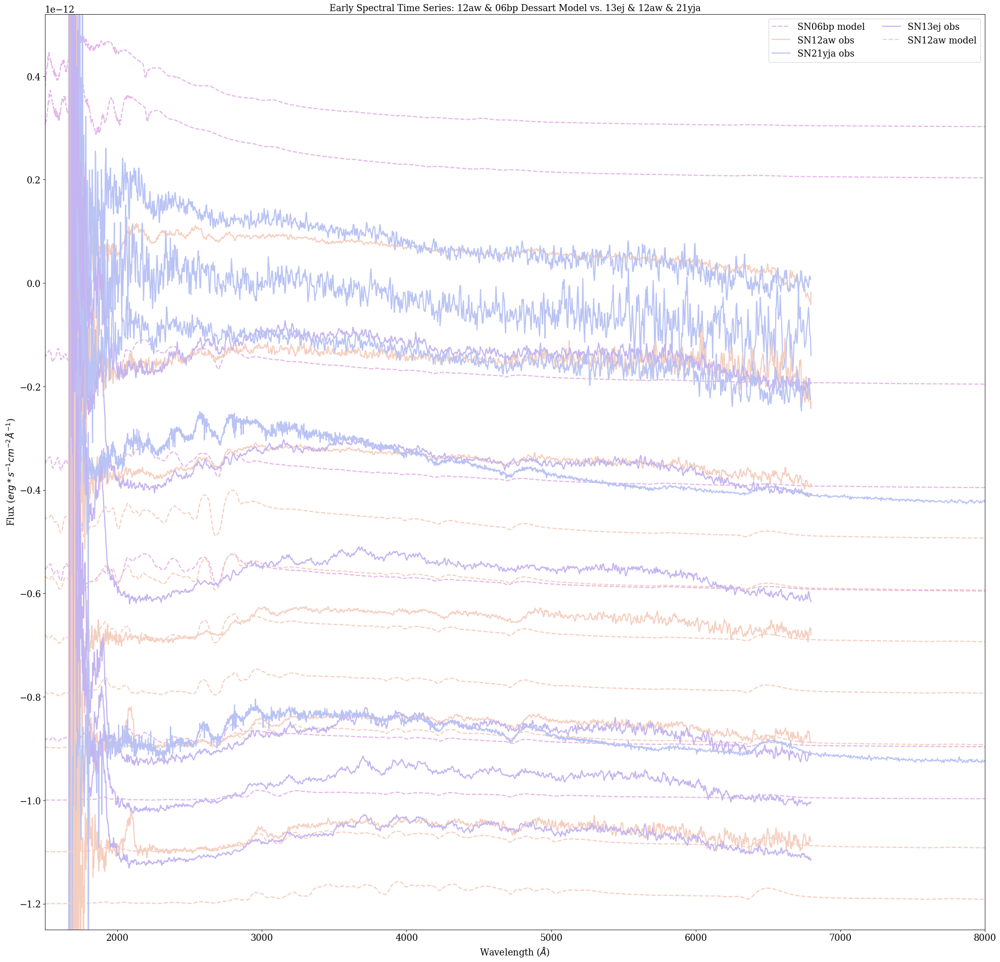

In [77]:
####### Astrosymposium plot
# general plot formatting
#plt.rcParams.update({
#    "lines.color": "black",
#    "patch.edgecolor": "black",
#    "text.color": "black",
#    "axes.facecolor": "black",
#    "axes.edgecolor": "black",
#    "axes.labelcolor": "black",
#    "xtick.color": "black",
#    "ytick.color": "black",
#    "grid.color": "black",
#    "figure.facecolor": "black",
#    "figure.edgecolor": "black",
#    "savefig.facecolor": "white",
#    "savefig.edgecolor": "black"})
#font = 25
#plt.rcParams["font.family"] = "arial"
#plt.rcParams.update({'font.size': font})
# every -0.00000000000010 is 1 day for 12aw and I am matching flux level for 13ej as best as possible from there (subtract additional 0.00000000000005 it seems)
# excluding last four days of 12aw for ease of view
fig = plt.figure(figsize=(30, 30), dpi= 80, facecolor='w', edgecolor='k')
plt.title('Early Spectral Time Series: 12aw & 06bp Dessart Model vs. 13ej & 12aw & 21yja',fontsize=font)
plt.plot(SN06bp_1half_wave_m,(0.00000001*SN06bp_1half_flux_m)+0.00000000000030,linewidth=2,linestyle='--',c='#e4b5e8',label='SN06bp model')
plt.plot(SN06bp_2half_wave_m,(0.00000001*SN06bp_2half_flux_m)+0.00000000000020,linewidth=2,linestyle='--',c='#e4b5e8')
plt.plot(SN12aw_5_wave_o,SN12aw_5_flux_o,linewidth=2,c='#f4cebf',label='SN12aw obs')
plt.plot(SN21yja_5_wave_o,(SN21yja_5_flux_o*10)-0.00000000000005,linewidth=2,c='#b9c3f4',label='SN21yja obs')
plt.plot(SN21yja_6_wave_o,(SN21yja_6_flux_o*10)-0.00000000000015,linewidth=2,c='#b9c3f4')
plt.plot(SN06bp_7half_wave_m,(0.00000001*SN06bp_7half_flux_m)-0.00000000000020,linewidth=2,linestyle='--',c='#e4b5e8')
plt.plot(SN12aw_7_wave_o,SN12aw_7_flux_o-0.00000000000020,linewidth=2,c='#f4cebf')
plt.plot(SN13ej_7_wave_o,SN13ej_7_flux_o-0.00000000000025,linewidth=2,c='#c4b4f0',label='SN13ej obs')
plt.plot(SN21yja_7_wave_o,(SN21yja_7_flux_o*10)-0.00000000000025,linewidth=2,c='#b9c3f4')
plt.plot(SN06bp_9half_wave_m,(0.00000001*SN06bp_9half_flux_m)-0.00000000000040,linewidth=2,linestyle='--',c='#e4b5e8')
plt.plot(SN12aw_9_wave_o,SN12aw_9_flux_o-0.00000000000040,linewidth=2,c='#f4cebf')
plt.plot(SN13ej_9_wave_o,SN13ej_9_flux_o-0.00000000000045,linewidth=2,c='#c4b4f0')
plt.plot(SN21yja_9_wave_o,(SN21yja_9_flux_o*10)-0.00000000000045,linewidth=2,c='#b9c3f4')
plt.plot(SN12aw_10_wave_m,(0.00000001*SN12aw_10_flux_m)-0.00000000000050,linewidth=2,linestyle='--',c='#f4cebf',label='SN12aw model')
plt.plot(SN06bp_11_wave_m,(0.00000001*SN06bp_11_flux_m)-0.00000000000060,linewidth=2,linestyle='--',c='#e4b5e8')
plt.plot(SN12aw_11_wave_m,(0.00000001*SN12aw_11_flux_m)-0.00000000000060,linewidth=2,linestyle='--',c='#f4cebf')
plt.plot(SN13ej_11_wave_o,SN13ej_11_flux_o-0.00000000000065,linewidth=2,c='#c4b4f0')
plt.plot(SN12aw_12_wave_m,(0.00000001*SN12aw_12_flux_m)-0.00000000000070,linewidth=2,linestyle='--',c='#f4cebf')
plt.plot(SN12aw_12_wave_o,SN12aw_12_flux_o-0.00000000000070,linewidth=2,c='#f4cebf')
plt.plot(SN12aw_13_wave_m,(0.00000001*SN12aw_13_flux_m)-0.00000000000080,linewidth=2,linestyle='--',c='#f4cebf')
plt.plot(SN06bp_14half_wave_m,(0.00000001*SN06bp_14half_flux_m)-0.00000000000090,linewidth=2,linestyle='--',c='#e4b5e8')
plt.plot(SN12aw_14_wave_m,(0.00000001*SN12aw_14_flux_m)-0.00000000000090,linewidth=2,linestyle='--',c='#f4cebf')
plt.plot(SN12aw_14_wave_o,SN12aw_14_flux_o-0.00000000000090,linewidth=2,c='#f4cebf')
plt.plot(SN13ej_14_wave_o,SN13ej_14_flux_o-0.00000000000095,linewidth=2,c='#c4b4f0')
plt.plot(SN21yja_14_wave_o,(SN21yja_14_flux_o*10)-0.00000000000095,linewidth=2,c='#b9c3f4')
plt.plot(SN06bp_15half_wave_m,(0.00000001*SN06bp_15half_flux_m)-0.00000000000100,linewidth=2,linestyle='--',c='#e4b5e8')
plt.plot(SN13ej_15_wave_o,SN13ej_15_flux_o-0.00000000000104,linewidth=2,c='#c4b4f0')
plt.plot(SN12aw_16_wave_m,(0.00000001*SN12aw_16_flux_m)-0.00000000000110,linewidth=2,linestyle='--',c='#f4cebf')
plt.plot(SN12aw_16_wave_o,SN12aw_16_flux_o-0.00000000000110,linewidth=2,c='#f4cebf')
plt.plot(SN13ej_16_wave_o,SN13ej_16_flux_o-0.00000000000114,linewidth=2,c='#c4b4f0')
plt.plot(SN12aw_17_wave_m,(0.00000001*SN12aw_17_flux_m)-0.00000000000120,linewidth=2,linestyle='--',c='#f4cebf')
plt.plot(SN21yja_21_wave_o,(SN21yja_21_flux_o*10)-0.00000000000165,linewidth=2,c='#b9c3f4')
plt.legend(loc=1,fontsize=font,ncol=2,labelcolor='black')
plt.xlabel("Wavelength " r'($ \AA $)',fontsize=font)
plt.ylabel("Flux " r'($ erg*s^{-1} cm^{-2} \AA^{-1} $)',fontsize=font)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(1500,8000)
plt.ylim(-0.00000000000125,0.00000000000052)
plt.savefig("astrosymposium2022.png",dpi=300)
plt.show()



In [ ]:
# from someone elses color color code

snname = 'SN2015F'
filename = snname + '_uvotB15.1.dat'
data = open(filename, 'r')
# importing data in rowwise style
for line in data:
    if not line[0]== '#':
        continue
    lines = np.genfromtxt(data, dtype=[('filter','S20'),('mjd',float),('mag',None),('magerr',None),('exposure',float),('elapse',float)], usecols=(0,1,2,3,10,11))

# sorting data into groups based on MJD +/- dt
mjdsorted = sorted(lines, key=itemgetter(1)) # sorts data by data instead of by date and filter
dt = 0.1500
ends = mjdsorted[0][1] # this lines gives you the first date; 0 row index, and 1st column index, aka earliest mjd
mjdgrouped = []
start = 0 
count = 1
filter1 ='UVW1'
filter2 = 'UVW2'

# getting only mjds into an array
mjds = []
for j in mjdsorted:
    mjds.append(j[1])

# groups the data by separating closest date
for i in range(len(mjdsorted)):
    if i==0:
        start=0 # at 1st index, sets start to zero
    else:
        if mjdsorted[i][1] < mjdsorted[i-1][1] + dt:
            count +=1 # if date is less that previous date plus 0.15, then it adds one to count
        else:
            mjdgrouped.append(mjdsorted[start:i]) # grabs the 2 that you are comparing
            start = i
mjdgrouped.append(mjdsorted[start:])

def colorseries(filter1, filter2):
    mag1s = []
    mag2s = []
    error1temp = []
    error2temp = []
    errors = []
    dates = []
    for j in mjdgrouped:

        for m in range(len(j)):
            dates.append(j[m][0])
    
        if filter1 in dates and filter2 in dates:
                
            for k in range(len(j)):
                if j[k][0] == filter1:
                    mag1s.append(j[k][2])
                    error1temp.append(j[k][3])
                    
                if j[k][0] == filter2:
                    mag2s.append(j[k][2])
                    error2temp.append(j[k][3])
        if filter1 not in dates:
            mag1s.append(np.nan)
            error1temp.append(np.nan)
            for k in range(len(j)):
                if j[k][0] == filter2:
                    mag2s.append(j[k][2])
                    error2temp.append(j[k][3])
        if filter2 not in dates:
            mag2s.append(np.nan)
            error2temp.append(np.nan)
            for k in range(len(j)):
                if j[k][0] == filter1:
                    mag1s.append(j[k][2])
                    error1temp.append(j[k][3])
        del dates[:]
    maga = np.asarray(mag1s)
    magb = np.asarray(mag2s)
    error1temps = np.asarray(error1temp)
    error2temps = np.asarray(error2temp)
    errors = np.sqrt(error1temps**2 + (error2temps)**2)
    color = maga-magb
    return color, mag1s, mag2s, errors
colorseries, mag1, mag2, errorseries= colorseries(filter1,filter2)

def epochseries(unavg, checkfilter1, checkfilter2):
    sum = 0
    skip = 0
    num = 0	
    avgepoch = []
    temp=[]
    
    for k in unavg:
        sum = 0
        num = 0	
        for j in range(len(k)):
            if k[j][0] not in temp:	
                temp.append(k[j][0])
        
            
        for step in range(len(k)):
            
            if checkfilter1 not in temp and checkfilter2 not in temp:
                skip += 1
                avgepoch.append(np.nan)

            else:

                #print k[step][0]
                sum += k[step][1]
                num += 1.0
                
        del temp[:]
        
        
        if num != 0:
            avgt = sum/num
            avgepoch.append(avgt)
        
    return avgepoch
timeseries = epochseries(mjdgrouped,filter1, filter2)


print(timeseries)
print(colorseries)


plt.ion()
plt.figure()
plt.plot(timeseries,colorseries, 'o', linestyle = 'None', c = 'r')
plt.errorbar(timeseries, colorseries, yerr = errorseries, c='r', fmt='o')
plt.xlabel('MJD')
ylabel = filter1 + '-'+filter2
plt.ylabel(ylabel)
plt.title(snname)
plt.gca().get_xaxis().get_major_formatter().set_useOffset(False)

plt.show()





data.close()


##### IS THIS PORTION WITHIN THE APOSTROPHES RUNNING LIKE REGULAR CODE????
'''
bins = np.arange(mjds[0],mjds[-1],dt)
grouped = np.digitize(mjds,bins)
groups = []
for i in range(len(grouped)):
    groups.append(grouped[i])
'''

In [98]:
# Code for photometry that ended up being useless :)))))
##### load in data for SN06bp
SN06bp_fil, SN06bp_mjd, SN06bp_mag, SN06bp_magerr = np.loadtxt(SN2006bp, comments='#', dtype=str, usecols = (0,1,2,3), unpack=True)
##### replacing NULL with float value "nan" for SN06bp
for m in range(len(SN06bp_mag)):
    if SN06bp_mag[m] == "NULL":
        SN06bp_mag[m] = "nan"
for me in range(len(SN06bp_magerr)):
    if SN06bp_magerr[me] == "NULL":
        SN06bp_magerr[me] = "nan"
##### turning lists into floats for appropriate data using list comprehension for SN06bp
SN06bp_mjd1 = [float(date) for date in SN06bp_mjd]
SN06bp_mag1 = [float(magnitude) for magnitude in SN06bp_mag]
SN06bp_magerr1 = [float(magnitudeerr) for magnitudeerr in SN06bp_magerr]
SN06bp_filters1 = SN06bp_fil
##### making sure program doesn't shut down bc of NULL values for SN06bp
SN06bp_filterslist = []
SN06bp_mjdlist  = []
SN06bp_maglist = []
SN06bp_magerrlist = []
for ii in range(len(SN06bp_filters1)):
    if not np.isnan(SN06bp_mag1[ii]):
        SN06bp_filterslist.append(SN06bp_filters1[ii])
        SN06bp_maglist.append(SN06bp_mag1[ii])
        SN06bp_mjdlist.append(SN06bp_mjd1[ii])
        SN06bp_magerrlist.append(SN06bp_magerr1[ii])
SN06bp_filters = np.array(SN06bp_filterslist)
SN06bp_mjd = np.array(SN06bp_mjdlist)
SN06bp_mag = np.array(SN06bp_maglist)
SN06bp_magerr = np.array(SN06bp_magerrlist)
##### breaking up the filters, mjd, mag, and magerr arrays into separate arrays to make plotting easier for SN06bp
SN06bp_uvw2mjd = []
SN06bp_uvw2mag = []
SN06bp_uvw2magerr = []
SN06bp_uvm2mjd = []
SN06bp_uvm2mag = []
SN06bp_uvm2magerr = []
SN06bp_uvw1mjd = []
SN06bp_uvw1mag = []
SN06bp_uvw1magerr = []
SN06bp_umjd = []
SN06bp_umag = []
SN06bp_umagerr = []
SN06bp_bmjd = []
SN06bp_bmag = []
SN06bp_bmagerr = []
SN06bp_vmjd = []
SN06bp_vmag = []
SN06bp_vmagerr = []
for i in range(len(SN06bp_filters)):
    if SN06bp_filters[i] == 'UVW2':
        SN06bp_uvw2mjd.append(SN06bp_mjd[i])
        SN06bp_uvw2mag.append(SN06bp_mag[i])
        SN06bp_uvw2magerr.append(SN06bp_magerr[i])
    if SN06bp_filters[i] == 'UVM2':
        SN06bp_uvm2mjd.append(SN06bp_mjd[i])
        SN06bp_uvm2mag.append(SN06bp_mag[i])
        SN06bp_uvm2magerr.append(SN06bp_magerr[i])
    if SN06bp_filters[i] == 'UVW1':
        SN06bp_uvw1mjd.append(SN06bp_mjd[i])
        SN06bp_uvw1mag.append(SN06bp_mag[i])
        SN06bp_uvw1magerr.append(SN06bp_magerr[i])
    if SN06bp_filters[i] == 'U':
        SN06bp_umjd.append(SN06bp_mjd[i])
        SN06bp_umag.append(SN06bp_mag[i])
        SN06bp_umagerr.append(SN06bp_magerr[i])
    if SN06bp_filters[i] == 'B':
        SN06bp_bmjd.append(SN06bp_mjd[i])
        SN06bp_bmag.append(SN06bp_mag[i])
        SN06bp_bmagerr.append(SN06bp_magerr[i])
    if SN06bp_filters[i] == 'V':
        SN06bp_vmjd.append(SN06bp_mjd[i])
        SN06bp_vmag.append(SN06bp_mag[i])
        SN06bp_vmagerr.append(SN06bp_magerr[i])
##### getting days since explosion from mjd for SN06bp
SN06bp_uvw2dse = []
SN06bp_uvm2dse = []
SN06bp_uvw1dse = []
SN06bp_udse = []
SN06bp_bdse = []
SN06bp_vdse = []
for d in range(len(SN06bp_uvw2mjd)):
    SN06bp_uvw2dse.append(SN06bp_uvw2mjd[d]-53834)
for d in range(len(SN06bp_uvm2mjd)):
    SN06bp_uvm2dse.append(SN06bp_uvm2mjd[d]-53834)
for d in range(len(SN06bp_uvw1mjd)):
    SN06bp_uvw1dse.append(SN06bp_uvw1mjd[d]-53834)
for d in range(len(SN06bp_umjd)):
    SN06bp_udse.append(SN06bp_umjd[d]-53834)
for d in range(len(SN06bp_bmjd)):
    SN06bp_bdse.append(SN06bp_bmjd[d]-53834)
for d in range(len(SN06bp_vmjd)):
    SN06bp_vdse.append(SN06bp_vmjd[d]-53834)